# Preprocess data

In [1]:
# Import dependencies
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler,OneHotEncoder
import pandas as pd
import tensorflow as tf
import os
from tensorflow.keras.callbacks import ModelCheckpoint

# Load and read the data
import pandas as pd 
application_df = pd.read_csv("charity_data.csv")
application_df.head()

,EIN,NAME,APPLICATION_TYPE,AFFILIATION,CLASSIFICATION,USE_CASE,ORGANIZATION,STATUS,INCOME_AMT,SPECIAL_CONSIDERATIONS,ASK_AMT,IS_SUCCESSFUL
0,10520599,BLUE KNIGHTS MOTORCYCLE CLUB,T10,Independent,C1000,ProductDev,Association,1,0,N,5000,1
1,10531628,AMERICAN CHESAPEAKE CLUB CHARITABLE TR,T3,Independent,C2000,Preservation,Co-operative,1,1-9999,N,108590,1
2,10547893,ST CLOUD PROFESSIONAL FIREFIGHTERS,T5,CompanySponsored,C3000,ProductDev,Association,1,0,N,5000,0
3,10553066,SOUTHSIDE ATHLETIC ASSOCIATION,T3,CompanySponsored,C2000,Preservation,Trust,1,10000-24999,N,6692,1
4,10556103,GENETIC RESEARCH INSTITUTE OF THE DESERT,T3,Independent,C1000,Heathcare,Trust,1,100000-499999,N,142590,1


In [2]:
# Drop the non-beneficial ID columns, 'EIN' and 'NAME'.
application_df = application_df.drop(['EIN', 'NAME'], axis =1)
application_df.head()

,APPLICATION_TYPE,AFFILIATION,CLASSIFICATION,USE_CASE,ORGANIZATION,STATUS,INCOME_AMT,SPECIAL_CONSIDERATIONS,ASK_AMT,IS_SUCCESSFUL
0,T10,Independent,C1000,ProductDev,Association,1,0,N,5000,1
1,T3,Independent,C2000,Preservation,Co-operative,1,1-9999,N,108590,1
2,T5,CompanySponsored,C3000,ProductDev,Association,1,0,N,5000,0
3,T3,CompanySponsored,C2000,Preservation,Trust,1,10000-24999,N,6692,1
4,T3,Independent,C1000,Heathcare,Trust,1,100000-499999,N,142590,1


In [3]:
application_df.nunique()

APPLICATION_TYPE            17
AFFILIATION                  6
CLASSIFICATION              71
USE_CASE                     5
ORGANIZATION                 4
STATUS                       2
INCOME_AMT                   9
SPECIAL_CONSIDERATIONS       2
ASK_AMT                   8747
IS_SUCCESSFUL                2
dtype: int64

In [4]:
application_counts = application_df.APPLICATION_TYPE.value_counts()
application_counts

T3     27037
T4      1542
T6      1216
T5      1173
T19     1065
T8       737
T7       725
T10      528
T9       156
T13       66
T12       27
T2        16
T25        3
T14        3
T29        2
T15        2
T17        1
Name: APPLICATION_TYPE, dtype: int64

<AxesSubplot:ylabel='Density'>

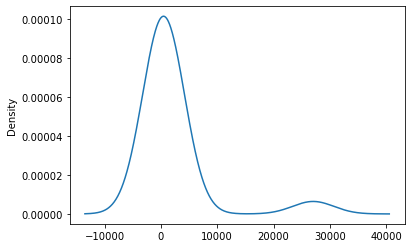

In [5]:
application_counts.plot.density()

In [6]:
# Replace values
replace_application = list(application_counts[application_counts < 500].index)

for app in replace_application:
    application_df.APPLICATION_TYPE = application_df.APPLICATION_TYPE.replace(app,"Other")
    
application_df.APPLICATION_TYPE.value_counts()

T3       27037
T4        1542
T6        1216
T5        1173
T19       1065
T8         737
T7         725
T10        528
Other      276
Name: APPLICATION_TYPE, dtype: int64

In [7]:
classification_counts = application_df.CLASSIFICATION.value_counts()
classification_counts

C1000    17326
C2000     6074
C1200     4837
C3000     1918
C2100     1883
         ...  
C4120        1
C8210        1
C2561        1
C4500        1
C2150        1
Name: CLASSIFICATION, Length: 71, dtype: int64

<AxesSubplot:ylabel='Density'>

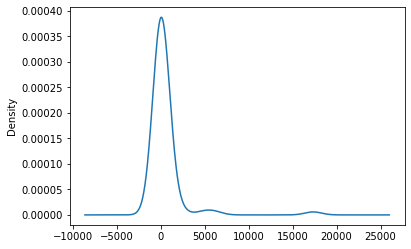

In [8]:
classification_counts.plot.density()

In [9]:
replace_class = list(classification_counts[classification_counts < 1000].index)

for cls in replace_class:
    application_df.CLASSIFICATION = application_df.CLASSIFICATION.replace(cls,"Other")
    
application_df.CLASSIFICATION.value_counts()

C1000    17326
C2000     6074
C1200     4837
Other     2261
C3000     1918
C2100     1883
Name: CLASSIFICATION, dtype: int64

In [10]:
application_cat = application_df.dtypes[application_df.dtypes == "object"].index.tolist()
application_cat

['APPLICATION_TYPE',
 'AFFILIATION',
 'CLASSIFICATION',
 'USE_CASE',
 'ORGANIZATION',
 'INCOME_AMT',
 'SPECIAL_CONSIDERATIONS']

In [11]:
# One Hot Encoding
enc = OneHotEncoder(sparse=False)

encode_df = pd.DataFrame(enc.fit_transform(application_df[application_cat]))

encode_df.columns = enc.get_feature_names(application_cat)
encode_df.head()

/Users/nova/opt/anaconda3/envs/mlenv/lib/python3.7/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,APPLICATION_TYPE_Other,APPLICATION_TYPE_T10,APPLICATION_TYPE_T19,APPLICATION_TYPE_T3,APPLICATION_TYPE_T4,APPLICATION_TYPE_T5,APPLICATION_TYPE_T6,APPLICATION_TYPE_T7,APPLICATION_TYPE_T8,AFFILIATION_CompanySponsored,...,INCOME_AMT_1-9999,INCOME_AMT_10000-24999,INCOME_AMT_100000-499999,INCOME_AMT_10M-50M,INCOME_AMT_1M-5M,INCOME_AMT_25000-99999,INCOME_AMT_50M+,INCOME_AMT_5M-10M,SPECIAL_CONSIDERATIONS_N,SPECIAL_CONSIDERATIONS_Y
0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [12]:
# Merge One Hot Encoding and drop originals
application_df = application_df.merge(encode_df,left_index=True, right_index=True)
application_df = application_df.drop(application_cat,1)
application_df.head()

/Users/nova/opt/anaconda3/envs/mlenv/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  


,STATUS,ASK_AMT,IS_SUCCESSFUL,APPLICATION_TYPE_Other,APPLICATION_TYPE_T10,APPLICATION_TYPE_T19,APPLICATION_TYPE_T3,APPLICATION_TYPE_T4,APPLICATION_TYPE_T5,APPLICATION_TYPE_T6,...,INCOME_AMT_1-9999,INCOME_AMT_10000-24999,INCOME_AMT_100000-499999,INCOME_AMT_10M-50M,INCOME_AMT_1M-5M,INCOME_AMT_25000-99999,INCOME_AMT_50M+,INCOME_AMT_5M-10M,SPECIAL_CONSIDERATIONS_N,SPECIAL_CONSIDERATIONS_Y
0,1,5000,1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,1,108590,1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,1,5000,0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,1,6692,1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,1,142590,1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [13]:
# Split our preprocessed data into our features and target arrays
y = application_df["IS_SUCCESSFUL"].values
X = application_df.drop(["IS_SUCCESSFUL"],1).values

# Split the preprocessed data into a training and testing dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=78)

/Users/nova/opt/anaconda3/envs/mlenv/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  This is separate from the ipykernel package so we can avoid doing imports until


In [14]:
# Create, fit, and scale a StandardScaler instances
scaler = StandardScaler()

X_scaler = scaler.fit(X_train)

X_train_scaled = X_scaler.transform(X_train)
X_test_scaled = X_scaler.transform(X_test)

# Optimize Deep Neural Network Model for >75% Accuracy

Attempt #1 

In [23]:
# Define the model - deep neural net
number_input_features = len(X_train[0])
hidden_nodes_layer1 = 80
hidden_nodes_layer2 = 50

nn = tf.keras.models.Sequential()

# First hidden layer
nn.add(
    tf.keras.layers.Dense(units=hidden_nodes_layer1, input_dim=number_input_features, activation="relu")
)

# Second hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer2, activation="relu"))

# Output layer
nn.add(tf.keras.layers.Dense(units=1, activation="sigmoid"))

# Check the structure of the model
nn.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 80)                3520      
_________________________________________________________________
dense_7 (Dense)              (None, 50)                4050      
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 51        
Total params: 7,621
Trainable params: 7,621
Non-trainable params: 0
_________________________________________________________________


# Compile the model
nn.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

In [27]:
path = "AlphabetSoupCharity_Optimization.hdf5"
cp_callback = ModelCheckpoint(
    filepath= path,
    verbose=1,
    save_weights_only=True,
    save_freq=5)

In [28]:
# Train the model
fit_model = nn.fit(X_train,y_train,epochs=100,callbacks=[cp_callback])

Train on 25724 samples
Epoch 1/100

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 6:45 - loss: 331.1170 - accuracy: 0.5312
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
  224/25724 [..............................] - ETA: 1:03 - loss: 665.2452 - accuracy: 0.5089
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to Alp

 3136/25724 [==>...........................] - ETA: 9s - loss: 14991.3777 - accuracy: 0.4869 
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
 3328/25724 [==>...........................] - ETA: 9s - loss: 14234.5251 - accuracy: 0.4856
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

 6304/25724 [======>.......................] - ETA: 6s - loss: 179272.2472 - accuracy: 0.4933
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
 6496/25724 [======>.......................] - ETA: 6s - loss: 174340.7942 - accuracy: 0.4938
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf


Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
 9536/25724 [==========>...................] - ETA: 5s - loss: 119930.2868 - accuracy: 0.4907
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
 9728/25724 [==========>...................] - ETA: 5s - loss: 117564.0295 - accuracy: 0.4921
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf

12608/25724 [=============>................] - ETA: 4s - loss: 94397.4365 - accuracy: 0.4976
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
12800/25724 [=============>................] - ETA: 3s - loss: 93217.8823 - accuracy: 0.4981
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5


15744/25724 [=================>............] - ETA: 3s - loss: 78287.7870 - accuracy: 0.4964
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
15936/25724 [=================>............] - ETA: 2s - loss: 77352.8345 - accuracy: 0.4979
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
19008/25724 [=====================>........] - ETA: 1s - loss: 65481.4845 - accuracy: 0.4962
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 64851.1940 - accuracy: 0.4959
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 67662.4166 - accuracy: 0.4972
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
22368/25724 [=========================>....] - ETA: 0s - loss: 68682.9343 - accuracy: 0.4975
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 69613.9572 - accuracy: 0.4965
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 70455.6112 - accuracy: 0.4967
Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
 2784/25724 [==>...........................] - ETA: 6s - loss: 95065.4338 - accuracy: 0.4573 
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
 2976/25724 [==>...........................] - ETA: 6s - loss: 97523.8705 - accuracy: 0.4553
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5


Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
 5952/25724 [=====>........................] - ETA: 5s - loss: 101378.9593 - accuracy: 0.4850
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
 6144/25724 [======>.......................] - ETA: 5s - loss: 98840.4158 - accuracy: 0.4860 
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf


Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
 9120/25724 [=========>....................] - ETA: 4s - loss: 74233.3705 - accuracy: 0.5046
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
 9312/25724 [=========>....................] - ETA: 4s - loss: 72727.8657 - accuracy: 0.5058
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
12320/25724 [=============>................] - ETA: 3s - loss: 56077.4576 - accuracy: 0.4998
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
12544/25724 [=============>................] - ETA: 3s - loss: 55209.3978 - accuracy: 0.4997
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
15552/25724 [=================>............] - ETA: 2s - loss: 46077.4450 - accuracy: 0.4952
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 45526.0004 - accuracy: 0.4954
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
18592/25724 [====================>.........] - ETA: 1s - loss: 39906.5543 - accuracy: 0.4939
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
18816/25724 [====================>.........] - ETA: 1s - loss: 39439.1844 - accuracy: 0.4941
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 84976.4324 - accuracy: 0.4955
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
22048/25724 [========================>.....] - ETA: 0s - loss: 84308.7499 - accuracy: 0.4954
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 78656.1453 - accuracy: 0.4975
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 78058.1985 - accuracy: 0.4977
Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
 2432/25724 [=>............................] - ETA: 6s - loss: 9103.6628 - accuracy: 0.4807
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
 2624/25724 [==>...........................] - ETA: 6s - loss: 9029.4595 - accuracy: 0.4760
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

E

 5504/25724 [=====>........................] - ETA: 5s - loss: 8324.5685 - accuracy: 0.4682
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
 5696/25724 [=====>........................] - ETA: 5s - loss: 8093.0266 - accuracy: 0.4672
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
 5


Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
 8768/25724 [=========>....................] - ETA: 4s - loss: 6578.5186 - accuracy: 0.4822
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
 8960/25724 [=========>....................] - ETA: 4s - loss: 6439.8457 - accuracy: 0.4807
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

E

11872/25724 [============>.................] - ETA: 3s - loss: 16256.9377 - accuracy: 0.4807
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
12064/25724 [=============>................] - ETA: 3s - loss: 17244.8269 - accuracy: 0.4811
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
15072/25724 [================>.............] - ETA: 2s - loss: 22675.9868 - accuracy: 0.4934
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
15296/25724 [================>.............] - ETA: 2s - loss: 22632.0311 - accuracy: 0.4942
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 25919.8341 - accuracy: 0.5009
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
18464/25724 [====================>.........] - ETA: 1s - loss: 25653.7635 - accuracy: 0.5010
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 30834.1306 - accuracy: 0.5014
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 30569.8251 - accuracy: 0.5008
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5


24512/25724 [===========================>..] - ETA: 0s - loss: 27655.4839 - accuracy: 0.5002
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 27448.8222 - accuracy: 0.4996
Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
 1984/25724 [=>............................] - ETA: 6s - loss: 60834.1007 - accuracy: 0.5197
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
 2176/25724 [=>............................] - ETA: 6s - loss: 55633.3862 - accuracy: 0.5193
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
 5056/25724 [====>.........................] - ETA: 5s - loss: 41972.7247 - accuracy: 0.5047
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
 5248/25724 [=====>........................] - ETA: 5s - loss: 40446.6294 - accuracy: 0.5046
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5


 8160/25724 [========>.....................] - ETA: 4s - loss: 43681.2263 - accuracy: 0.5151
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
 8352/25724 [========>.....................] - ETA: 4s - loss: 42710.2094 - accuracy: 0.5151
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
11456/25724 [============>.................] - ETA: 3s - loss: 39706.9129 - accuracy: 0.5163
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
11648/25724 [============>.................] - ETA: 3s - loss: 39054.6068 - accuracy: 0.5147
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
14528/25724 [===============>..............] - ETA: 3s - loss: 31705.6043 - accuracy: 0.5150
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
14720/25724 [================>.............] - ETA: 3s - loss: 31306.7026 - accuracy: 0.5155
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5


17632/25724 [===================>..........] - ETA: 2s - loss: 26270.6563 - accuracy: 0.5161
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
17824/25724 [===================>..........] - ETA: 2s - loss: 26002.6578 - accuracy: 0.5159
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 38283.9163 - accuracy: 0.5114
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 37967.0022 - accuracy: 0.5112
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 34772.3548 - accuracy: 0.5053
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 34540.8239 - accuracy: 0.5052
Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
 1408/25724 [>.............................] - ETA: 6s - loss: 6169.4711 - accuracy: 0.5241
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
 1600/25724 [>.............................] - ETA: 6s - loss: 5453.5919 - accuracy: 0.5250
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
 4640/25724 [====>.........................] - ETA: 5s - loss: 30921.9113 - accuracy: 0.5136
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 29713.1325 - accuracy: 0.5103
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5


 7712/25724 [=======>......................] - ETA: 4s - loss: 20776.8515 - accuracy: 0.5074
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
 7904/25724 [========>.....................] - ETA: 4s - loss: 20293.9472 - accuracy: 0.5086
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
10944/25724 [===========>..................] - ETA: 3s - loss: 14901.0530 - accuracy: 0.5178
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
11136/25724 [===========>..................] - ETA: 3s - loss: 17788.1161 - accuracy: 0.5180
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
14080/25724 [===============>..............] - ETA: 3s - loss: 31235.3153 - accuracy: 0.5203
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 31380.4740 - accuracy: 0.5207
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5


17216/25724 [===================>..........] - ETA: 2s - loss: 38400.7262 - accuracy: 0.5210
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
17408/25724 [===================>..........] - ETA: 2s - loss: 37979.2948 - accuracy: 0.5209
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5


20352/25724 [======================>.......] - ETA: 1s - loss: 32767.5136 - accuracy: 0.5142
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 32463.8782 - accuracy: 0.5136
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 32809.1770 - accuracy: 0.5108
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5
23840/25724 [==========================>...] - ETA: 0s - loss: 32622.0109 - accuracy: 0.5098
Epoch 00005: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
  992/25724 [>.............................] - ETA: 6s - loss: 10415.7692 - accuracy: 0.4385
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
 1184/25724 [>.............................] - ETA: 6s - loss: 9549.3713 - accuracy: 0.4358 
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
 4128/25724 [===>..........................] - ETA: 5s - loss: 9605.3685 - accuracy: 0.4506
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
 4352/25724 [====>.........................] - ETA: 5s - loss: 9128.1267 - accuracy: 0.4515
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
 7296/25724 [=======>......................] - ETA: 4s - loss: 32519.1895 - accuracy: 0.4768
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
 7488/25724 [=======>......................] - ETA: 4s - loss: 31690.7561 - accuracy: 0.4762
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
10496/25724 [===========>..................] - ETA: 4s - loss: 23089.4540 - accuracy: 0.4839
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
10688/25724 [===========>..................] - ETA: 4s - loss: 22676.5142 - accuracy: 0.4835
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5


13632/25724 [==============>...............] - ETA: 3s - loss: 17840.1491 - accuracy: 0.4925
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
13824/25724 [===============>..............] - ETA: 3s - loss: 17593.0868 - accuracy: 0.4932
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5


16800/25724 [==================>...........] - ETA: 2s - loss: 14798.6635 - accuracy: 0.4954
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
16992/25724 [==================>...........] - ETA: 2s - loss: 14646.7116 - accuracy: 0.4956
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 12799.2259 - accuracy: 0.5041
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 12658.2890 - accuracy: 0.5042
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 11369.0012 - accuracy: 0.5044
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 11278.7550 - accuracy: 0.5047
Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization.hdf5


  608/25724 [..............................] - ETA: 7s - loss: 2173.8481 - accuracy: 0.4490
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
  800/25724 [..............................] - ETA: 7s - loss: 1894.0403 - accuracy: 0.4437
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
  


Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
 3904/25724 [===>..........................] - ETA: 6s - loss: 654.0427 - accuracy: 0.5238
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
 4096/25724 [===>..........................] - ETA: 6s - loss: 623.5987 - accuracy: 0.5247
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
 7008/25724 [=======>......................] - ETA: 5s - loss: 6567.3652 - accuracy: 0.5141
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
 7200/25724 [=======>......................] - ETA: 5s - loss: 6473.6748 - accuracy: 0.5158
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
10176/25724 [==========>...................] - ETA: 4s - loss: 18105.7350 - accuracy: 0.5071
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
10368/25724 [===========>..................] - ETA: 4s - loss: 18066.9777 - accuracy: 0.5066
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
13440/25724 [==============>...............] - ETA: 3s - loss: 19339.3044 - accuracy: 0.4990
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
13664/25724 [==============>...............] - ETA: 3s - loss: 19068.2421 - accuracy: 0.4995


Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
16576/25724 [==================>...........] - ETA: 2s - loss: 18565.8042 - accuracy: 0.5031
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
16768/25724 [==================>...........] - ETA: 2s - loss: 18364.0839 - accuracy: 0.5022
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
19712/25724 [=====================>........] - ETA: 1s - loss: 16138.0633 - accuracy: 0.5011
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
19904/25724 [======================>.......] - ETA: 1s - loss: 15989.0926 - accuracy: 0.5011
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5


22784/25724 [=========================>....] - ETA: 0s - loss: 14013.8917 - accuracy: 0.5096
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
22944/25724 [=========================>....] - ETA: 0s - loss: 13917.4718 - accuracy: 0.5100
Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 13802


Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
  256/25724 [..............................] - ETA: 6s - loss: 1592.0855 - accuracy: 0.5156
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
  448/25724 [..............................] - ETA: 6s - loss: 8468.9882 - accuracy: 0.5335
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
 3456/25724 [===>..........................] - ETA: 5s - loss: 25846.6152 - accuracy: 0.5237
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
 3648/25724 [===>..........................] - ETA: 5s - loss: 24518.5961 - accuracy: 0.5214
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
 6624/25724 [======>.......................] - ETA: 5s - loss: 16024.2819 - accuracy: 0.5177
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
 6816/25724 [======>.......................] - ETA: 5s - loss: 15577.4780 - accuracy: 0.5191
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
 9824/25724 [==========>...................] - ETA: 4s - loss: 11263.8085 - accuracy: 0.5111
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
10048/25724 [==========>...................] - ETA: 4s - loss: 11023.2307 - accuracy: 0.5099

12896/25724 [==============>...............] - ETA: 3s - loss: 11912.7189 - accuracy: 0.5032
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
13088/25724 [==============>...............] - ETA: 3s - loss: 18966.3973 - accuracy: 0.5033
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5


16064/25724 [=================>............] - ETA: 2s - loss: 19183.0211 - accuracy: 0.4999
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 18959.5153 - accuracy: 0.5004
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
19296/25724 [=====================>........] - ETA: 1s - loss: 16340.4452 - accuracy: 0.4956
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
19520/25724 [=====================>........] - ETA: 1s - loss: 16162.9855 - accuracy: 0.4958
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
22400/25724 [=========================>....] - ETA: 0s - loss: 14197.9044 - accuracy: 0.5008
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
22592/25724 [=========================>....] - ETA: 0s - loss: 14181.0361 - accuracy: 0.5006
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5


25536/25724 [============================>.] - ETA: 0s - loss: 24744.1035 - accuracy: 0.5038
Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25724 [==============================] - 7s 273us/sample - loss: 24581.8057 - accuracy: 0.5041
Epoch 9/100

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 267.1748 - accuracy: 0.6875
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving mode

 2912/25724 [==>...........................] - ETA: 6s - loss: 9057.2103 - accuracy: 0.5182
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 9332.9426 - accuracy: 0.5151
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
 3

 6048/25724 [======>.......................] - ETA: 5s - loss: 8680.6515 - accuracy: 0.4936
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
 6240/25724 [======>.......................] - ETA: 5s - loss: 8438.3266 - accuracy: 0.4934
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
 9248/25724 [=========>....................] - ETA: 4s - loss: 9813.1071 - accuracy: 0.4922 
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
 9472/25724 [==========>...................] - ETA: 4s - loss: 9612.7845 - accuracy: 0.4907
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5




Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 7631.0091 - accuracy: 0.4963
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
12704/25724 [=============>................] - ETA: 3s - loss: 7500.8778 - accuracy: 0.4974
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
15680/25724 [=================>............] - ETA: 2s - loss: 9044.8616 - accuracy: 0.4998
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
15872/25724 [=================>............] - ETA: 2s - loss: 8962.3497 - accuracy: 0.5001
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

E

18784/25724 [====================>.........] - ETA: 1s - loss: 8088.3387 - accuracy: 0.5033
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
18976/25724 [=====================>........] - ETA: 1s - loss: 8021.9830 - accuracy: 0.5033
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
19

21952/25724 [========================>.....] - ETA: 1s - loss: 7340.0997 - accuracy: 0.5019
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
22144/25724 [========================>.....] - ETA: 0s - loss: 7276.8924 - accuracy: 0.5027
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
22

25152/25724 [============================>.] - ETA: 0s - loss: 6717.9749 - accuracy: 0.5007
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 6909.5588 - accuracy: 0.5007
Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
 2656/25724 [==>...........................] - ETA: 6s - loss: 79672.5205 - accuracy: 0.5237
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
 2848/25724 [==>...........................] - ETA: 6s - loss: 74582.5244 - accuracy: 0.5263
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
 5856/25724 [=====>........................] - ETA: 5s - loss: 38421.2350 - accuracy: 0.5343
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
 6080/25724 [======>.......................] - ETA: 5s - loss: 37020.5748 - accuracy: 0.5372
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
 9024/25724 [=========>....................] - ETA: 4s - loss: 27340.5855 - accuracy: 0.5314
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
 9216/25724 [=========>....................] - ETA: 4s - loss: 26868.3368 - accuracy: 0.5310
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
12256/25724 [=============>................] - ETA: 3s - loss: 21538.9838 - accuracy: 0.5267
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
12448/25724 [=============>................] - ETA: 3s - loss: 21442.4282 - accuracy: 0.5273
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5


15296/25724 [================>.............] - ETA: 2s - loss: 18058.6151 - accuracy: 0.5250
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
15488/25724 [=================>............] - ETA: 2s - loss: 17835.4451 - accuracy: 0.5258
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
18496/25724 [====================>.........] - ETA: 1s - loss: 15470.7698 - accuracy: 0.5231
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
18720/25724 [====================>.........] - ETA: 1s - loss: 16232.7713 - accuracy: 0.5220
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 15531.0559 - accuracy: 0.5149
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
21952/25724 [========================>.....] - ETA: 0s - loss: 15383.3141 - accuracy: 0.5145
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 13957.9051 - accuracy: 0.5106
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 13858.2445 - accuracy: 0.5099
Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization.hdf5


 2176/25724 [=>............................] - ETA: 6s - loss: 599.1462 - accuracy: 0.5046
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
 2368/25724 [=>............................] - ETA: 6s - loss: 559.8454 - accuracy: 0.5101
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
 256

 5376/25724 [=====>........................] - ETA: 5s - loss: 790.9495 - accuracy: 0.5047
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
 5472/25724 [=====>........................] - ETA: 5s - loss: 824.4121 - accuracy: 0.5051
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
 5664/25724 [=====>........................] - ETA: 5s - loss: 805.3785 - accuracy: 0.5034
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_

 8480/25724 [========>.....................] - ETA: 4s - loss: 662.2328 - accuracy: 0.5075
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
 8704/25724 [=========>....................] - ETA: 4s - loss: 645.4426 - accuracy: 0.5085
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
11840/25724 [============>.................] - ETA: 3s - loss: 1206.0175 - accuracy: 0.5052
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
12064/25724 [=============>................] - ETA: 3s - loss: 1187.5082 - accuracy: 0.5050
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
15072/25724 [================>.............] - ETA: 2s - loss: 2250.1576 - accuracy: 0.5102
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
15296/25724 [================>.............] - ETA: 2s - loss: 2234.8323 - accuracy: 0.5106
E


Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 1992.4583 - accuracy: 0.5047
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
18432/25724 [====================>.........] - ETA: 1s - loss: 1974.6056 - accuracy: 0.5049
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 1888.6363 - accuracy: 0.5136
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 1872.7443 - accuracy: 0.5137
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 2161.4489 - accuracy: 0.5179
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 2146.2573 - accuracy: 0.5190
Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
 1984/25724 [=>............................] - ETA: 6s - loss: 127716.5125 - accuracy: 0.5439
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
 2208/25724 [=>............................] - ETA: 6s - loss: 115513.0868 - accuracy: 0.5362
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf


Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
 5184/25724 [=====>........................] - ETA: 5s - loss: 50766.0482 - accuracy: 0.5006
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
 5376/25724 [=====>........................] - ETA: 5s - loss: 48978.0151 - accuracy: 0.4993
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
 8320/25724 [========>.....................] - ETA: 4s - loss: 33355.9001 - accuracy: 0.5010
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
 8512/25724 [========>.....................] - ETA: 4s - loss: 32603.8068 - accuracy: 0.5016
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
11488/25724 [============>.................] - ETA: 3s - loss: 24167.1193 - accuracy: 0.5126
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
11680/25724 [============>.................] - ETA: 3s - loss: 23770.6023 - accuracy: 0.5134
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
14752/25724 [================>.............] - ETA: 2s - loss: 19009.5592 - accuracy: 0.5178
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
14944/25724 [================>.............] - ETA: 2s - loss: 18772.6325 - accuracy: 0.5182
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
17984/25724 [===================>..........] - ETA: 2s - loss: 17362.8747 - accuracy: 0.5195
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
18176/25724 [====================>.........] - ETA: 2s - loss: 18276.5714 - accuracy: 0.5196
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5


21024/25724 [=======================>......] - ETA: 1s - loss: 16622.7183 - accuracy: 0.5217
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 16486.7685 - accuracy: 0.5219
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 14562.7332 - accuracy: 0.5203
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 14467.8314 - accuracy: 0.5202
Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization.hdf5



Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 1670.7924 - accuracy: 0.4642
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 1520.7697 - accuracy: 0.4657
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
 4928/25724 [====>.........................] - ETA: 5s - loss: 1173.3650 - accuracy: 0.4945
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
 5120/25724 [====>.........................] - ETA: 5s - loss: 1133.9198 - accuracy: 0.4945
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
 8256/25724 [========>.....................] - ETA: 4s - loss: 1201.8733 - accuracy: 0.5033
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
 8480/25724 [========>...


Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
11424/25724 [============>.................] - ETA: 3s - loss: 1216.3685 - accuracy: 0.5078
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
11648/25724 [============>.................] - ETA: 3s - loss: 1193.3322 - accuracy: 0.5107
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 1006.1968 - accuracy: 0.5231
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
14912/25724 [================>.............] - ETA: 2s - loss: 993.0836 - accuracy: 0.5218 
E


Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
17888/25724 [===================>..........] - ETA: 2s - loss: 889.7219 - accuracy: 0.5239
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
18080/25724 [====================>.........] - ETA: 1s - loss: 884.5243 - accuracy: 0.5231
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
21056/25724 [=======================>......] - ETA: 1s - loss: 951.4251 - accuracy: 0.5216
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 943.4060 - accuracy: 0.5219
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 1133.1647 - accuracy: 0.5193
Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 1136.7885 - accuracy: 0.5192
E


Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
 1696/25724 [>.............................] - ETA: 6s - loss: 581.1204 - accuracy: 0.5000
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
 1888/25724 [=>............................] - ETA: 6s - loss: 650.4937 - accuracy: 0.5064
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
 4992/25724 [====>.........................] - ETA: 5s - loss: 713.3141 - accuracy: 0.5250
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
 5216/25724 [=====>........................] - ETA: 5s - loss: 688.7378 - accuracy: 0.5255
Epo

 8032/25724 [========>.....................] - ETA: 4s - loss: 481.9804 - accuracy: 0.5345
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
 8224/25724 [========>.....................] - ETA: 4s - loss: 471.1368 - accuracy: 0.5332
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
11328/25724 [============>.................] - ETA: 3s - loss: 359.4074 - accuracy: 0.5385
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
11552/25724 [============>.................] - ETA: 3s - loss: 355.1326 - accuracy: 0.5408
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo

14464/25724 [===============>..............] - ETA: 2s - loss: 682.3788 - accuracy: 0.5500
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 673.9912 - accuracy: 0.5498
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
17792/25724 [===================>..........] - ETA: 2s - loss: 792.1994 - accuracy: 0.5404
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
18016/25724 [====================>.........] - ETA: 1s - loss: 793.4984 - accuracy: 0.5397
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 1142.5079 - accuracy: 0.5376
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 1171.9127 - accuracy: 0.5380
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

E

24128/25724 [===========================>..] - ETA: 0s - loss: 1512.4257 - accuracy: 0.5411
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 1498.5492 - accuracy: 0.5407
Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
 1600/25724 [>.............................] - ETA: 6s - loss: 4201.6280 - accuracy: 0.4994
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
 1824/25724 [=>............................] - ETA: 5s - loss: 3942.9016 - accuracy: 0.5011
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

E

 4800/25724 [====>.........................] - ETA: 5s - loss: 1544.5430 - accuracy: 0.5312
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
 4992/25724 [====>.........................] - ETA: 5s - loss: 1498.3577 - accuracy: 0.5300
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
 8160/25724 [========>.....................] - ETA: 4s - loss: 1562.9857 - accuracy: 0.5321
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
 8384/25724 [========>.....................] - ETA: 4s - loss: 1523.0991 - accuracy: 0.5328
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
11424/25724 [============>.................] - ETA: 3s - loss: 2040.8130 - accuracy: 0.5383
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
11648/25724 [============>.................] - ETA: 3s - loss: 2064.7879 - accuracy: 0.5379
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 4061.5606 - accuracy: 0.5351
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
14912/25724 [================>.............] - ETA: 2s - loss: 4042.1379 - accuracy: 0.5350
E


Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 3476.8284 - accuracy: 0.5242
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
18176/25724 [============


Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
21056/25724 [=======================>......] - ETA: 1s - loss: 3311.0864 - accuracy: 0.5252
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 3295.3605 - accuracy: 0.5241
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

E

24192/25724 [===========================>..] - ETA: 0s - loss: 2991.4139 - accuracy: 0.5222
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 2965.4296 - accuracy: 0.5230
Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
 1792/25724 [=>............................] - ETA: 6s - loss: 3114.5602 - accuracy: 0.4816
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
 2016/25724 [=>............................] - ETA: 5s - loss: 4680.1336 - accuracy: 0.4797
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

E

 4928/25724 [====>.........................] - ETA: 5s - loss: 7397.5913 - accuracy: 0.4858
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
 5152/25724 [=====>........................] - ETA: 5s - loss: 7090.5560 - accuracy: 0.4872
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
 8224/25724 [========>.....................] - ETA: 4s - loss: 7490.2033 - accuracy: 0.5049
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
 8448/25724 [========>.....................] - ETA: 4s - loss: 7294.4090 - accuracy: 0.5053
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
11424/25724 [============>.................] - ETA: 3s - loss: 8741.4546 - accuracy: 0.5088
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
11648/25724 [============>.................] - ETA: 3s - loss: 8573.7125 - accuracy: 0.5082
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 6867.9747 - accuracy: 0.5023
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
14912/25724 [================>.............] - ETA: 2s - loss: 6765.2181 - accuracy: 0.5031
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
17920/25724 [===================>..........] - ETA: 1s - loss: 6048.4477 - accuracy: 0.4985
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
18144/25724 [====================>.........] - ETA: 1s - loss: 5981.0890 - accuracy: 0.4977
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

E

21088/25724 [=======================>......] - ETA: 1s - loss: 5217.2964 - accuracy: 0.4963
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 5170.3774 - accuracy: 0.4963
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 4531.6135 - accuracy: 0.5013
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 4501.1360 - accuracy: 0.5009
Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization.hdf5

E

 1760/25724 [=>............................] - ETA: 6s - loss: 165.7504 - accuracy: 0.5324
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
 1984/25724 [=>............................] - ETA: 6s - loss: 172.6454 - accuracy: 0.5247
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
 5088/25724 [====>.........................] - ETA: 5s - loss: 1760.4801 - accuracy: 0.5055
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
 5280/25724 [=====>........................] - ETA: 5s - loss: 1776.8629 - accuracy: 0.5042
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
 8288/25724 [========>.....................] - ETA: 4s - loss: 10710.1836 - accuracy: 0.4964
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
 8512/25724 [========>.....................] - ETA: 4s - loss: 10441.5386 - accuracy: 0.4965


Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
11392/25724 [============>.................] - ETA: 3s - loss: 8205.6681 - accuracy: 0.5049
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
11616/25724 [============>.................] - ETA: 3s - loss: 8053.1834 - accuracy: 0.5049
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

E

14528/25724 [===============>..............] - ETA: 3s - loss: 6642.4218 - accuracy: 0.5006
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
14720/25724 [================>.............] - ETA: 2s - loss: 6556.0756 - accuracy: 0.4989
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
14

17728/25724 [===================>..........] - ETA: 2s - loss: 5650.5730 - accuracy: 0.4976
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
17920/25724 [===================>..........] - ETA: 2s - loss: 5603.6184 - accuracy: 0.4980
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
18


Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
21120/25724 [=======================>......] - ETA: 1s - loss: 4934.2066 - accuracy: 0.5029
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
21344/25724 [============


Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 4328.4768 - accuracy: 0.5083
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 4309.8088 - accuracy: 0.5090
Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
 1792/25724 [=>............................] - ETA: 6s - loss: 284.2953 - accuracy: 0.5670
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
 2016/25724 [=>............................] - ETA: 5s - loss: 263.3198 - accuracy: 0.5680
Epo

 4864/25724 [====>.........................] - ETA: 5s - loss: 149.9059 - accuracy: 0.5530
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
 5024/25724 [====>.........................] - ETA: 5s - loss: 145.2784 - accuracy: 0.5516
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
 5216/25724 [=====>........................] - ETA: 5s - loss: 140.2855 


Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
 8128/25724 [========>.....................] - ETA: 4s - loss: 208.3141 - accuracy: 0.5492
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
 8352/25724 [========>.....................] - ETA: 4s - loss: 220.1853 - accuracy: 0.5487
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
11360/25724 [============>.................] - ETA: 3s - loss: 322.1271 - accuracy: 0.5401
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
11584/25724 [============>.................] - ETA: 3s - loss: 328.5143 - accuracy: 0.5378
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
14592/25724 [================>.............] - ETA: 2s - loss: 283.1543 - accuracy: 0.5269
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
14784/25724 [================>.............] - ETA: 2s - loss: 279.7097 - accuracy: 0.5265
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
17856/25724 [===================>..........] - ETA: 2s - loss: 434.7832 - accuracy: 0.5172
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
18080/25724 [=============

20928/25724 [=======================>......] - ETA: 1s - loss: 379.6081 - accuracy: 0.5148
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 376.7986 - accuracy: 0.5143
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo

24160/25724 [===========================>..] - ETA: 0s - loss: 377.8453 - accuracy: 0.5162
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 375.2130 - accuracy: 0.5153
Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
 1664/25724 [>.............................] - ETA: 6s - loss: 1191.1824 - accuracy: 0.4880
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
 1888/25724 [=>............................] - ETA: 6s - loss: 1058.9395 - accuracy: 0.4989
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

E


Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
 4992/25724 [====>.........................] - ETA: 5s - loss: 502.6482 - accuracy: 0.4940
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
 5216/25724 [=====>.......


Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
 8064/25724 [========>.....................] - ETA: 4s - loss: 330.0195 - accuracy: 0.4896
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
 8288/25724 [========>.....................] - ETA: 4s - loss: 331.8986 - accuracy: 0.4891
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
11328/25724 [============>.................] - ETA: 3s - loss: 495.6358 - accuracy: 0.4973
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
11552/25724 [============>.................] - ETA: 3s - loss: 487.3073 - accuracy: 0.4971
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
14624/25724 [================>.............] - ETA: 2s - loss: 583.2124 - accuracy: 0.4973
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
14848/25724 [================>.............] - ETA: 2s - loss: 575.9229 - accuracy: 0.4981
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo

17728/25724 [===================>..........] - ETA: 2s - loss: 514.3140 - accuracy: 0.4987
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
17952/25724 [===================>..........] - ETA: 1s - loss: 507.9128 - accuracy: 0.4989
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 459.7358 - accuracy: 0.4919
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 455.0657 - accuracy: 0.4896
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 403.0525 - accuracy: 0.4896
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 399.8898 - accuracy: 0.4900
Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization.hdf5

Epo


Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
 1824/25724 [=>............................] - ETA: 6s - loss: 0.8095 - accuracy: 0.5302
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
 2016/25724 [=>............................] - ETA: 6s - loss: 0.7996 - accuracy: 0.5377
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
 4960/25724 [====>.........................] - ETA: 5s - loss: 0.7768 - accuracy: 0.5357
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
 5184/25724 [=====>........................] - ETA: 5s - loss: 0.7742 - accuracy: 0.5370
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
 8256/25724 [========>.....................] - ETA: 4s - loss: 0.7587 - accuracy: 0.5343
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
 8416/25724 [========>.....................] - ETA: 4s - loss: 0.7583 - accuracy: 0.5337
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
 8448/25724 [========>.....................] - ETA: 4s - loss: 0.7584 - accuracy: 0.5334
Epoch 00020: saving model to AlphabetSoupCharity_Optimi

11360/25724 [============>.................] - ETA: 3s - loss: 0.7471 - accuracy: 0.5322
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
11584/25724 [============>.................] - ETA: 3s - loss: 0.7460 - accuracy: 0.5328
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

14560/25724 [===============>..............] - ETA: 2s - loss: 0.7382 - accuracy: 0.5300
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
14784/25724 [================>.............] - ETA: 2s - loss: 0.7376 - accuracy: 0.5302
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
17920/25724 [===================>..........] - ETA: 2s - loss: 0.7299 - accuracy: 0.5319
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
18144/25724 [====================>.........] - ETA: 1s - loss: 0.7296 - accuracy: 0.5317
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

21056/25724 [=======================>......] - ETA: 1s - loss: 0.7247 - accuracy: 0.5313
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.7245 - accuracy: 0.5311
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
21440/25


Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 0.7202 - accuracy: 0.5319
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 0.7200 - accuracy: 0.5316
Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 1792/25724 [=>............................] - ETA: 6s - loss: 0.6938 - accuracy: 0.5173
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
 2016/25724 [=>............................] - ETA: 5s - loss: 0.6930 - accuracy: 0.5223
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
 5152/25724 [=====>........................] - ETA: 5s - loss: 0.6940 - accuracy: 0.5130
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
 5376/25724 [=====>........................] - ETA: 5s - loss: 0.6938 - accuracy: 0.5143
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
 8512/25724 [========>.....................] - ETA: 4s - loss: 0.6925 - accuracy: 0.5217
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
 8736/25724 [=========>....................] - ETA: 4s - loss: 0.6923 - accuracy: 0.5231
Epoch 0

11648/25724 [============>.................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5235
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
11872/25724 [============>.................] - ETA: 3s - loss: 0.6917 - accuracy: 0.5238
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
15008/25724 [================>.............] - ETA: 2s - loss: 0.6905 - accuracy: 0.5297
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
15232/25724 [================>.............] - ETA: 2s - loss: 0.6904 - accuracy: 0.5304
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
18240/25724 [====================>.........] - ETA: 1s - loss: 0.6899 - accuracy: 0.5294
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
18432/25724 [====================>.........] - ETA: 1s - loss: 0.6900 - accuracy: 0.5287
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.6877 - accuracy: 0.5316
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 0.6876 - accuracy: 0.5314
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.6838 - accuracy: 0.5332
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 0.6836 - accuracy: 0.5333
Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
 2208/25724 [=>............................] - ETA: 5s - loss: 0.6457 - accuracy: 0.5516
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
 2432/25724 [=>............................] - ETA: 5s - loss: 0.6486 - accuracy: 0.5547
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
 5440/25724 [=====>........................] - ETA: 5s - loss: 0.6424 - accuracy: 0.6059
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
 5632/25724 [=====>........................] - ETA: 5s - loss: 0.6422 - accuracy: 0.6072
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 8608/25724 [=========>....................] - ETA: 4s - loss: 0.6399 - accuracy: 0.6197
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
 8832/25724 [=========>....................] - ETA: 4s - loss: 0.6400 - accuracy: 0.6212
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
11936/25724 [============>.................] - ETA: 3s - loss: 0.6422 - accuracy: 0.6240
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
12160/25724 [=============>................] - ETA: 3s - loss: 0.6422 - accuracy: 0.6243
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
15296/25724 [================>.............] - ETA: 2s - loss: 0.6413 - accuracy: 0.6332
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
15520/25724 [=================>............] - ETA: 2s - loss: 0.6424 - accuracy: 0.6304
Epoch 0

18400/25724 [====================>.........] - ETA: 1s - loss: 0.6516 - accuracy: 0.6052
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
18624/25724 [====================>.........] - ETA: 1s - loss: 0.6520 - accuracy: 0.6037
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

21632/25724 [========================>.....] - ETA: 1s - loss: 0.6574 - accuracy: 0.5915
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
21856/25724 [========================>.....] - ETA: 0s - loss: 0.6578 - accuracy: 0.5909
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 0.6616 - accuracy: 0.5829
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.6619 - accuracy: 0.5825
Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
 2496/25724 [=>............................] - ETA: 5s - loss: 0.6864 - accuracy: 0.5389
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
 2720/25724 [==>...........................] - ETA: 5s - loss: 0.6865 - accuracy: 0.5371
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 5632/25724 [=====>........................] - ETA: 4s - loss: 0.6861 - accuracy: 0.5405
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
 5856/25724 [=====>........................] - ETA: 4s - loss: 0.6862 - accuracy: 0.5400
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
 8992/25724 [=========>....................] - ETA: 4s - loss: 0.6865 - accuracy: 0.5386
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
 9216/25724 [=========>....................] - ETA: 4s - loss: 0.6866 - accuracy: 0.5375
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
12352/25724 [=============>................] - ETA: 3s - loss: 0.6862 - accuracy: 0.5393
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
12576/25724 [=============>................] - ETA: 3s - loss: 0.6863 - accuracy: 0.5389
Epoch 0

15488/25724 [=================>............] - ETA: 2s - loss: 0.6864 - accuracy: 0.5359
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
15712/25724 [=================>............] - ETA: 2s - loss: 0.6865 - accuracy: 0.5348
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
18816/25724 [====================>.........] - ETA: 1s - loss: 0.6858 - accuracy: 0.5337
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
19040/25724 [=====================>........] - ETA: 1s - loss: 0.6858 - accuracy: 0.5334
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
22176/25724 [========================>.....] - ETA: 0s - loss: 0.6848 - accuracy: 0.5318
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
22400/25724 [=========================>....] - ETA: 0s - loss: 0.6846 - accuracy: 0.5321
Epoch 0


Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 0.6834 - accuracy: 0.5320
Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization.hdf5
25696/25724 [===============


Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
 2912/25724 [==>...........................] - ETA: 5s - loss: 0.6686 - accuracy: 0.5405
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
 3136/25724 [==>...........................] - ETA: 5s - loss: 0.6689 - accuracy: 0.5344
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
 6240/25724 [======>.......................] - ETA: 4s - loss: 0.6681 - accuracy: 0.5362
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
 6464/25724 [======>........


Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
 9376/25724 [=========>....................] - ETA: 3s - loss: 0.6653 - accuracy: 0.5429
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
 9600/25724 [==========>...................] - ETA: 3s - loss: 0.6652 - accuracy: 0.5428
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
12736/25724 [=============>................] - ETA: 3s - loss: 0.6654 - accuracy: 0.5557
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
12960/25724 [==============>...............] - ETA: 3s - loss: 0.6653 - accuracy: 0.5575
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
16064/25724 [=================>............] - ETA: 2s - loss: 0.6641 - accuracy: 0.5751
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
16288/25724 [=================>............] - ETA: 2s - loss: 0.6639 - accuracy: 0.5765
Epoch 0


Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 0.6630 - accuracy: 0.5889
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
19392/25724 [=====================>........] - ETA: 1s - loss: 0.6628 - accuracy: 0.5897
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
22560/25724 [=========================>....] - ETA: 0s - loss: 0.6621 - accuracy: 0.5978
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
22784/25724 [===============


Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 0.6612 - accuracy: 0.6065
Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25724 [==============================] - 6s 250us/sample - loss: 0.6611 - accuracy: 0.6066
Epoch 25/100

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 0.6291 - accuracy: 0.7188
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to Alph

 3008/25724 [==>...........................] - ETA: 6s - loss: 0.6464 - accuracy: 0.6745
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
 3200/25724 [==>...........................] - ETA: 6s - loss: 0.6461 - accuracy: 0.6769
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
 3392/25

 6240/25724 [======>.......................] - ETA: 5s - loss: 0.6443 - accuracy: 0.6756
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
 6432/25724 [======>.......................] - ETA: 5s - loss: 0.6448 - accuracy: 0.6746
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 9472/25724 [==========>...................] - ETA: 4s - loss: 0.6469 - accuracy: 0.6697
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
 9664/25724 [==========>...................] - ETA: 4s - loss: 0.6472 - accuracy: 0.6691
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
 9856/25

12672/25724 [=============>................] - ETA: 3s - loss: 0.6467 - accuracy: 0.6705
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
12864/25724 [==============>...............] - ETA: 3s - loss: 0.6467 - accuracy: 0.6705
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
15968/25724 [=================>............] - ETA: 2s - loss: 0.6459 - accuracy: 0.6705
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
16160/25724 [=================>............] - ETA: 2s - loss: 0.6458 - accuracy: 0.6708
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

19040/25724 [=====================>........] - ETA: 1s - loss: 0.6458 - accuracy: 0.6703
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
19232/25724 [=====================>........] - ETA: 1s - loss: 0.6458 - accuracy: 0.6702
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
19424/25

22240/25724 [========================>.....] - ETA: 0s - loss: 0.6454 - accuracy: 0.6698
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
22464/25724 [=========================>....] - ETA: 0s - loss: 0.6453 - accuracy: 0.6701
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.6455 - accuracy: 0.6683
Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25724 [==============================] - 7s 265us/sample - loss: 0.6454 - accuracy: 0.6682
Epoch 26/100

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6071 - accuracy: 0.6875
Epoch 00026: saving model to Alph

 2848/25724 [==>...........................] - ETA: 8s - loss: 0.6440 - accuracy: 0.6584
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
 3072/25724 [==>...........................] - ETA: 8s - loss: 0.6473 - accuracy: 0.6615
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 5984/25724 [=====>........................] - ETA: 7s - loss: 0.6609 - accuracy: 0.6424
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
 6176/25724 [======>.......................] - ETA: 7s - loss: 0.6610 - accuracy: 0.6433
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
 6368/25


Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
 9312/25724 [=========>....................] - ETA: 5s - loss: 0.6608 - accuracy: 0.6324
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
 9504/25724 [==========>...................] - ETA: 5s - loss: 0.6606 - accuracy: 0.6336
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12384/25724 [=============>................] - ETA: 4s - loss: 0.6587 - accuracy: 0.6361
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
12576/25724 [=============>................] - ETA: 4s - loss: 0.6583 - accuracy: 0.6367
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

15552/25724 [=================>............] - ETA: 3s - loss: 0.6552 - accuracy: 0.6382
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
15744/25724 [=================>............] - ETA: 3s - loss: 0.6551 - accuracy: 0.6387
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
15936/25


Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
18912/25724 [=====================>........] - ETA: 2s - loss: 0.6537 - accuracy: 0.6417
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
19104/25724 [=====================>........] - ETA: 1s - loss: 0.6536 - accuracy: 0.6422
Epoch 0


Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.6524 - accuracy: 0.6449
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
22208/25724 [========================>.....] - ETA: 1s - loss: 0.6525 - accuracy: 0.6448
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

25088/25724 [============================>.] - ETA: 0s - loss: 0.6512 - accuracy: 0.6470
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.6511 - accuracy: 0.6470
Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization.hdf5
25472/25


Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
 2560/25724 [=>............................] - ETA: 6s - loss: 0.6392 - accuracy: 0.6582
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
 2752/25724 [==>...........................] - ETA: 6s - loss: 0.6398 - accuracy: 0.6548
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
 5792/25724 [=====>........................] - ETA: 5s - loss: 0.6424 - accuracy: 0.6540
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
 5984/25724 [=====>........................] - ETA: 5s - loss: 0.6415 - accuracy: 0.6564
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
 8928/25724 [=========>....................] - ETA: 4s - loss: 0.6420 - accuracy: 0.6562
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
 9120/25724 [=========>....................] - ETA: 4s - loss: 0.6416 - accuracy: 0.6572
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12032/25724 [=============>................] - ETA: 3s - loss: 0.6416 - accuracy: 0.6550
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
12224/25724 [=============>................] - ETA: 3s - loss: 0.6414 - accuracy: 0.6558
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
12416/25


Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
15296/25724 [================>.............] - ETA: 2s - loss: 0.6409 - accuracy: 0.6559
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
15488/25724 [=================>............] - ETA: 2s - loss: 0.6406 - accuracy: 0.6562
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
18560/25724 [====================>.........] - ETA: 1s - loss: 0.6406 - accuracy: 0.6561
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 0.6406 - accuracy: 0.6560
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.6405 - accuracy: 0.6558
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
21856/25724 [========================>.....] - ETA: 1s - loss: 0.6403 - accuracy: 0.6559
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

24800/25724 [===========================>..] - ETA: 0s - loss: 0.6398 - accuracy: 0.6568
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.6397 - accuracy: 0.6571
Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
 2272/25724 [=>............................] - ETA: 6s - loss: 0.6266 - accuracy: 0.6774
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
 2464/25724 [=>............................] - ETA: 6s - loss: 0.6259 - accuracy: 0.6774
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
 5472/25724 [=====>........................] - ETA: 5s - loss: 0.6327 - accuracy: 0.6659
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
 5664/25724 [=====>........................] - ETA: 5s - loss: 0.6327 - accuracy: 0.6668
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 8608/25724 [=========>....................] - ETA: 4s - loss: 0.6318 - accuracy: 0.6690
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
 8800/25724 [=========>....................] - ETA: 4s - loss: 0.6317 - accuracy: 0.6697
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
 8992/25


Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
11904/25724 [============>.................] - ETA: 3s - loss: 0.6328 - accuracy: 0.6686
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
12096/25724 [=============>................] - ETA: 3s - loss: 0.6319 - accuracy: 0.6700
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
15072/25724 [================>.............] - ETA: 2s - loss: 0.6312 - accuracy: 0.6722
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
15264/25724 [================>.............] - ETA: 2s - loss: 0.6314 - accuracy: 0.6717
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
18240/25724 [====================>.........] - ETA: 1s - loss: 0.6405 - accuracy: 0.6574
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
18432/25724 [====================>.........] - ETA: 1s - loss: 0.6413 - accuracy: 0.6550
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
21472/25724 [========================>.....] - ETA: 1s - loss: 0.6489 - accuracy: 0.6322
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.6494 - accuracy: 0.6305
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

24608/25724 [===========================>..] - ETA: 0s - loss: 0.6543 - accuracy: 0.6194
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 0.6546 - accuracy: 0.6188
Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization.hdf5
24992/25


Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
 2144/25724 [=>............................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5247
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
 2336/25724 [=>............................] - ETA: 6s - loss: 0.6918 - accuracy: 0.5270
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
 5280/25724 [=====>........................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5242
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
 5472/25724 [=====>........................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5239
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
 8544/25724 [========>.....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5296
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
 8736/25724 [=========>....................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5292
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
11712/25724 [============>.................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5329
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
11904/25724 [============>.................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5326
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
14976/25724 [================>.............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5331
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
15168/25724 [================>.............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5329
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18048/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5335
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5334
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
18432/25


Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5334
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5334
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

24416/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5337
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5333
Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization.hdf5
24800/25


Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 0.6886 - accuracy: 0.5538
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
 2144/25724 [=>............................] - ETA: 6s - loss: 0.6893 - accuracy: 0.5485
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
 5024/25724 [====>.........................] - ETA: 5s - loss: 0.6897 - accuracy: 0.5442
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
 5216/25724 [=====>........................] - ETA: 5s - loss: 0.6896 - accuracy: 0.5443
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 8160/25724 [========>.....................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5346
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
 8352/25724 [========>.....................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5340
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
 8544/25

11296/25724 [============>.................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5380
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
11488/25724 [============>.................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5381
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
11680/25


Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
14496/25724 [===============>..............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5363
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
14688/25724 [================>.............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5366
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
17760/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5337
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5334
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5354
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
21056/25724 [=======================>......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5358
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
24096/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5329
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5326
Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
 1504/25724 [>.............................] - ETA: 6s - loss: 0.6926 - accuracy: 0.5193
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
 1696/25724 [>.............................] - ETA: 6s - loss: 0.6926 - accuracy: 0.5183
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 4640/25724 [====>.........................] - ETA: 5s - loss: 0.6925 - accuracy: 0.5200
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 0.6924 - accuracy: 0.5203
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
 5024/25


Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
 7936/25724 [========>.....................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5267
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
 8128/25724 [========>.....................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5282
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

11008/25724 [===========>..................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5285
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
11200/25724 [============>.................] - ETA: 3s - loss: 0.6916 - accuracy: 0.5287
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
14336/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5297
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
14528/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5299
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
17408/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5310
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
17600/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5321
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
20704/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5311
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5309
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
23840/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5326
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5330
Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 1184/25724 [>.............................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5296
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
 1376/25724 [>.............................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5262
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
 1568/25

 4352/25724 [====>.........................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5340
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
 4544/25724 [====>.........................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5357
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
 4736/25


Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
 7648/25724 [=======>......................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5379
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
 7840/25724 [========>.....................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5364
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

10720/25724 [===========>..................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5354
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
10912/25724 [===========>..................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5354
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
11104/25


Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
13984/25724 [===============>..............] - ETA: 3s - loss: 0.6906 - accuracy: 0.5368
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
14208/25724 [===============>..............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5361
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

17120/25724 [==================>...........] - ETA: 2s - loss: 0.6904 - accuracy: 0.5374
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
17312/25724 [===================>..........] - ETA: 2s - loss: 0.6905 - accuracy: 0.5371
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
17504/25


Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6903 - accuracy: 0.5384
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 0.6904 - accuracy: 0.5379
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

23520/25724 [==========================>...] - ETA: 0s - loss: 0.6908 - accuracy: 0.5346
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.6908 - accuracy: 0.5344
Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization.hdf5
23904/25


Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
 1024/25724 [>.............................] - ETA: 6s - loss: 0.6930 - accuracy: 0.5098
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
 1216/25724 [>.............................] - ETA: 6s - loss: 0.6932 - accuracy: 0.5058
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
 4160/25724 [===>..........................] - ETA: 5s - loss: 0.6924 - accuracy: 0.5221
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
 4352/25724 [====>.........................] - ETA: 5s - loss: 0.6923 - accuracy: 0.5241
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 7296/25724 [=======>......................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5284
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
 7488/25724 [=======>......................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5294
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
 7680/25


Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
10592/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5315
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
10784/25724 [===========>..................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5326
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

13632/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5347
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
13824/25724 [===============>..............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5354
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
14016/25

16800/25724 [==================>...........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5346
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
16992/25724 [==================>...........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5348
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
17184/25


Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
20064/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5344
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
20256/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5343
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

23136/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5326
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization.hdf5
23520/25


Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
  608/25724 [..............................] - ETA: 6s - loss: 0.6894 - accuracy: 0.5493
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
  800/25724 [..............................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5350
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 3712/25724 [===>..........................] - ETA: 5s - loss: 0.6891 - accuracy: 0.5477
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
 3904/25724 [===>..........................] - ETA: 5s - loss: 0.6890 - accuracy: 0.5479
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
 4096/25


Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
 6976/25724 [=======>......................] - ETA: 5s - loss: 0.6900 - accuracy: 0.5411
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
 7168/25724 [=======>......................] - ETA: 5s - loss: 0.6900 - accuracy: 0.5410
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
10240/25724 [==========>...................] - ETA: 4s - loss: 0.6900 - accuracy: 0.5410
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
10464/25724 [===========>..................] - ETA: 4s - loss: 0.6902 - accuracy: 0.5399
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
13408/25724 [==============>...............] - ETA: 3s - loss: 0.6906 - accuracy: 0.5365
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
13600/25724 [==============>...............] - ETA: 3s - loss: 0.6906 - accuracy: 0.5371
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
16672/25724 [==================>...........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5361
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
16864/25724 [==================>...........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5360
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
19808/25724 [======================>.......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5355
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5349
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5
23264/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
  448/25724 [..............................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5246
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
  640/25724 [..............................] - ETA: 6s - loss: 0.6918 - accuracy: 0.5266
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 3584/25724 [===>..........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5220
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
 3776/25724 [===>..........................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5249
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
 3968/25


Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
 6880/25724 [=======>......................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5256
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
 7072/25724 [=======>......................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5260
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
10016/25724 [==========>...................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5245
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
10208/25724 [==========>...................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5248
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
13280/25724 [==============>...............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5281
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
13472/25724 [==============>...............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5279
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

16352/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5293
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
16544/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5297
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
16736/25


Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5290
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 0.6916 - accuracy: 0.5286
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

22720/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5312
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5311
Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization.hdf5
23104/25


Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.6968 - accuracy: 0.4955
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
  416/25724 [..............................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5264
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 3296/25724 [==>...........................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5331
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
 3488/25724 [===>..........................] - ETA: 6s - loss: 0.6907 - accuracy: 0.5356
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
 3680/25


Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
 6592/25724 [======>.......................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5319
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
 6784/25724 [======>.......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5330
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 9696/25724 [==========>...................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5371
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
 9888/25724 [==========>...................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5373
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
10080/25


Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
12960/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5339
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
13152/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5334
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

16032/25724 [=================>............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5334
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5330
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
16416/25


Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
19296/25724 [=====================>........] - ETA: 1s - loss: 0.6914 - accuracy: 0.5297
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
19488/25724 [=====================>........] - ETA: 1s - loss: 0.6914 - accuracy: 0.5298
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

22368/25724 [=========================>....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5301
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
22560/25724 [=========================>....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5302
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
22752/25


Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5320
Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25724 [==============================] - 7s 277us/sample - loss: 0.6912 - accuracy: 0.5321
Epoch 37/100

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.7277 - accuracy: 0.2812
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to Alph


Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 0.6920 - accuracy: 0.5261
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
 3296/25724 [==>...........................] - ETA: 6s - loss: 0.6918 - accuracy: 0.5282
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 6176/25724 [======>.......................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5272
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
 6400/25724 [======>.......................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5263
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
 9472/25724 [==========>...................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5324
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
 9664/25724 [==========>...................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5326
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12544/25724 [=============>................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5295
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
12736/25724 [=============>................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5295
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
12928/25


Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
15808/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5331
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
16000/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5331
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18880/25724 [=====================>........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5350
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
19072/25724 [=====================>........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5347
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
19264/25

22048/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5317
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
22240/25724 [========================>.....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
22432/25

25248/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5320
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5321
Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization.hdf5
25632/25


Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
 2784/25724 [==>...........................] - ETA: 6s - loss: 0.6928 - accuracy: 0.5190
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
 2976/25724 [==>...........................] - ETA: 6s - loss: 0.6928 - accuracy: 0.5188
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 5856/25724 [=====>........................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5309
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
 6048/25724 [======>.......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5327
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
 6240/25


Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
 9152/25724 [=========>....................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5351
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
 9344/25724 [=========>....................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5364
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12224/25724 [=============>................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5331
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
12416/25724 [=============>................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5336
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
12608/25


Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
15520/25724 [=================>............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5345
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
15712/25724 [=================>............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5346
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18592/25724 [====================>.........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5325
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
18784/25724 [====================>.........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5325
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
18976/25


Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
21856/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5333
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
22048/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5329
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

24928/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5323
Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization.hdf5
25312/25


Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
 2336/25724 [=>............................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5385
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
 2528/25724 [=>............................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5376
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
 5632/25724 [=====>........................] - ETA: 5s - loss: 0.6896 - accuracy: 0.5437
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
 5824/25724 [=====>........................] - ETA: 5s - loss: 0.6900 - accuracy: 0.5412
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
 8768/25724 [=========>....................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5384
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
 8960/25724 [=========>....................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5378
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
12064/25724 [=============>................] - ETA: 3s - loss: 0.6903 - accuracy: 0.5388
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
12256/25724 [=============>................] - ETA: 3s - loss: 0.6903 - accuracy: 0.5388
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
15168/25724 [================>.............] - ETA: 2s - loss: 0.6905 - accuracy: 0.5378
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
15360/25724 [================>.............] - ETA: 2s - loss: 0.6905 - accuracy: 0.5378
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 0.6908 - accuracy: 0.5354
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
18624/25724 [====================>.........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5355
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.6908 - accuracy: 0.5349
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5347
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5339
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.6910 - accuracy: 0.5335
Epoch 00039: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
 2144/25724 [=>............................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5271
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
 2336/25724 [=>............................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5270
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
 5376/25724 [=====>........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5318
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
 5568/25724 [=====>........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5318
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 8448/25724 [========>.....................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5330
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
 8640/25724 [=========>....................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5332
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
 8832/25


Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
11744/25724 [============>.................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5341
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
11936/25724 [============>.................] - ETA: 3s - loss: 0.6912 - accuracy: 0.5335
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

14816/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5332
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
15008/25724 [================>.............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5328
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
15200/25


Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5334
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5328
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

21184/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5319
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5315
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
21568/25


Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5315
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5317
Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 1760/25724 [=>............................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5295
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5297
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
 2144/25


Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
 5024/25724 [====>.........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5318
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
 5216/25724 [=====>........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5297
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 8128/25724 [========>.....................] - ETA: 4s - loss: 0.6907 - accuracy: 0.5354
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
 8320/25724 [========>.....................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5338
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
11424/25724 [============>.................] - ETA: 4s - loss: 0.6907 - accuracy: 0.5359
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
11616/25724 [============>.................] - ETA: 3s - loss: 0.6907 - accuracy: 0.5357
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

14496/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5342
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
14688/25724 [================>.............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5343
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
14880/25


Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
17792/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5334
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
17984/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5334
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5330
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5331
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

24032/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5322
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5325
Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization.hdf5
24416/25


Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
 1568/25724 [>.............................] - ETA: 6s - loss: 0.6936 - accuracy: 0.5096
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 0.6934 - accuracy: 0.5119
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
 4640/25724 [====>.........................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5274
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5284
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
 7904/25724 [========>.....................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5287
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5301
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
11040/25724 [===========>..................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5292
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
11232/25724 [============>.................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5293
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

14144/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5302
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
14336/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5303
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
14528/25


Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
17408/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5317
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
17600/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5322
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5334
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5338
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
23776/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5328
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5332
Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
 1184/25724 [>.............................] - ETA: 6s - loss: 0.6941 - accuracy: 0.4966
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
 1376/25724 [>.............................] - ETA: 6s - loss: 0.6936 - accuracy: 0.5044
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
 4448/25724 [====>.........................] - ETA: 5s - loss: 0.6929 - accuracy: 0.5153
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
 4640/25724 [====>.........................] - ETA: 5s - loss: 0.6928 - accuracy: 0.5164
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 7520/25724 [=======>......................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5277
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
 7712/25724 [=======>......................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5283
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
 7904/25


Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
10848/25724 [===========>..................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5280
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
11040/25724 [===========>..................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5288
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
13920/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5299
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
14112/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5296
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
17184/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5309
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5306
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

20256/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5337
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
20448/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5338
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
20640/25


Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
23552/25724 [==========================>...] - ETA: 0s - loss: 0.6909 - accuracy: 0.5340
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.6909 - accuracy: 0.5337
Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

  800/25724 [..............................] - ETA: 6s - loss: 0.6903 - accuracy: 0.5450
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
  992/25724 [>.............................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5383
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
 1184/25


Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
 4064/25724 [===>..........................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5386
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
 4256/25724 [===>..........................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5385
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
 7296/25724 [=======>......................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5396
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
 7488/25724 [=======>......................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5401
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
10400/25724 [===========>..................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5385
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
10624/25724 [===========>..................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5391
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

13504/25724 [==============>...............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5330
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
13696/25724 [==============>...............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5326
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
13888/25


Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
16800/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5326
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5331
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

19904/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5311
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5317
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
20288/25


Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5322
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5326
Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
  672/25724 [..............................] - ETA: 6s - loss: 0.6893 - accuracy: 0.5476
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
  864/25724 [>.............................] - ETA: 6s - loss: 0.6897 - accuracy: 0.5440
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
 3808/25724 [===>..........................] - ETA: 5s - loss: 0.6890 - accuracy: 0.5470
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
 4032/25724 [===>..........................] - ETA: 5s - loss: 0.6892 - accuracy: 0.5459
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
 7072/25724 [=======>......................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5370
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
 7296/25724 [=======>......................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5363
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
10304/25724 [===========>..................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5332
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
10496/25724 [===========>..................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5337
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
13472/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5317
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
13696/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5319
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
16704/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5337
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5337
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
19968/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5317
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
20192/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5314
Epoch 0

23008/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5318
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5319
Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

  416/25724 [..............................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5337
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
  608/25724 [..............................] - ETA: 6s - loss: 0.6900 - accuracy: 0.5428
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
  800/25


Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
 3744/25724 [===>..........................] - ETA: 5s - loss: 0.6926 - accuracy: 0.5192
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
 3936/25724 [===>..........................] - ETA: 5s - loss: 0.6926 - accuracy: 0.5180
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
 6880/25724 [=======>......................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5266
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
 7072/25724 [=======>......................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5247
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
10016/25724 [==========>...................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5333
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
10208/25724 [==========>...................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5334
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
13280/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5312
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
13504/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5315
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
16512/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5316
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5315
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

19584/25724 [=====================>........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5333
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
19776/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5327
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
19968/25

22752/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5316
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
22944/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5316
Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization.hdf5
23136/25


Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.6877 - accuracy: 0.5580
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
  416/25724 [..............................] - ETA: 6s - loss: 0.6877 - accuracy: 0.5577
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 3296/25724 [==>...........................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5379
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
 3488/25724 [===>..........................] - ETA: 6s - loss: 0.6898 - accuracy: 0.5416
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
 6528/25724 [======>.......................] - ETA: 5s - loss: 0.6895 - accuracy: 0.5435
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
 6720/25724 [======>.......................] - ETA: 5s - loss: 0.6896 - accuracy: 0.5429
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
 9728/25724 [==========>...................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5335
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
 9920/25724 [==========>...................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5339
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
12928/25724 [==============>...............] - ETA: 3s - loss: 0.6905 - accuracy: 0.5375
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
13152/25724 [==============>...............] - ETA: 3s - loss: 0.6905 - accuracy: 0.5376
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5344
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
16480/25724 [==================>...........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5344
Epoch 0


Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
19456/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5328
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5327
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

22560/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5328
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5
22784/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5327
Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

   32/25724 [..............................] - ETA: 6s - loss: 0.7067 - accuracy: 0.3750
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
  224/25724 [..............................] - ETA: 6s - loss: 0.6894 - accuracy: 0.5491
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
 3264/25724 [==>...........................] - ETA: 5s - loss: 0.6902 - accuracy: 0.5398
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
 3456/25724 [===>..........................] - ETA: 5s - loss: 0.6900 - accuracy: 0.5411
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
 6592/25724 [======>.......................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5358
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
 6784/25724 [======>.......................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5355
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
 9760/25724 [==========>...................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5365
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
 9952/25724 [==========>...................] - ETA: 4s - loss: 0.6907 - accuracy: 0.5360
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
12992/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5343
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
13120/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5346
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

16064/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5328
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5327
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
19360/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5311
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
19552/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5306
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
22560/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5321
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
22752/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5325
Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25724 [==============================] - 7s 264us/sample - loss: 0.6913 - accuracy: 0.5321
Epoch 49/100

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.7127 - accuracy: 0.3750
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
  256/25724 [..............................] - ETA: 6s - loss: 0.6935 - accuracy: 0.5156
Epoch 00049: saving model to Alph

 3104/25724 [==>...........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5335
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
 3328/25724 [==>...........................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5358
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
 6368/25724 [======>.......................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5367
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
 6560/25724 [======>.......................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5361
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
 9568/25724 [==========>...................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5307
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
 9792/25724 [==========>...................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5311
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
12864/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5326
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
13056/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5326
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
16064/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5332
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
16288/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5335
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5325
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
19392/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5316
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
22464/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5319
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
22656/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5323
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5323
Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25724 [==============================] - 7s 267us/sample - loss: 0.6913 - accuracy: 0.5321
Epoch 50/100

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6983 - accuracy: 0.4688
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to Alph

 2912/25724 [==>...........................] - ETA: 6s - loss: 0.6895 - accuracy: 0.5443
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
 3136/25724 [==>...........................] - ETA: 6s - loss: 0.6896 - accuracy: 0.5440
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
 6176/25724 [======>.......................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5361
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
 6400/25724 [======>.......................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5364
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 9312/25724 [=========>....................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5315
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
 9504/25724 [==========>...................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5315
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12512/25724 [=============>................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5338
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
12736/25724 [=============>................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5337
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5321
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
15936/25724 [=================>............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5314
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
18976/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5325
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
19168/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5322
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

22080/25724 [========================>.....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5319
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
22272/25724 [========================>.....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5316
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
22464/25


Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5329
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5322
Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
 2720/25724 [==>...........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5250
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
 2912/25724 [==>...........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5244
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 5856/25724 [=====>........................] - ETA: 5s - loss: 0.6923 - accuracy: 0.5237
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
 6048/25724 [======>.......................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5250
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
 6240/25


Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
 9184/25724 [=========>....................] - ETA: 4s - loss: 0.6923 - accuracy: 0.5245
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
 9408/25724 [=========>....................] - ETA: 4s - loss: 0.6922 - accuracy: 0.5250
Epoch 0


Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
12384/25724 [=============>................] - ETA: 3s - loss: 0.6923 - accuracy: 0.5246
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
12608/25724 [=============>................] - ETA: 3s - loss: 0.6923 - accuracy: 0.5245
Epoch 0


Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
15552/25724 [=================>............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5293
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
15776/25724 [=================>............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5292
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
18688/25724 [====================>.........] - ETA: 1s - loss: 0.6914 - accuracy: 0.5309
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
18880/25724 [=====================>........] - ETA: 1s - loss: 0.6914 - accuracy: 0.5309
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5319
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
22080/25724 [========================>.....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5321
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5321
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5323
Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
 2592/25724 [==>...........................] - ETA: 6s - loss: 0.6929 - accuracy: 0.5204
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
 2784/25724 [==>...........................] - ETA: 6s - loss: 0.6930 - accuracy: 0.5190
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 5664/25724 [=====>........................] - ETA: 5s - loss: 0.6929 - accuracy: 0.5189
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
 5856/25724 [=====>........................] - ETA: 5s - loss: 0.6928 - accuracy: 0.5191
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
 6048/25


Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
 8960/25724 [=========>....................] - ETA: 4s - loss: 0.6924 - accuracy: 0.5233
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
 9152/25724 [=========>....................] - ETA: 4s - loss: 0.6925 - accuracy: 0.5222
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12032/25724 [=============>................] - ETA: 3s - loss: 0.6923 - accuracy: 0.5241
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
12224/25724 [=============>................] - ETA: 3s - loss: 0.6923 - accuracy: 0.5240
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
12416/25


Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
15328/25724 [================>.............] - ETA: 2s - loss: 0.6919 - accuracy: 0.5267
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
15520/25724 [=================>............] - ETA: 2s - loss: 0.6920 - accuracy: 0.5267
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18432/25724 [====================>.........] - ETA: 1s - loss: 0.6918 - accuracy: 0.5282
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
18624/25724 [====================>.........] - ETA: 1s - loss: 0.6918 - accuracy: 0.5282
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
18816/25


Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.6915 - accuracy: 0.5304
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5310
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5326
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 2208/25724 [=>............................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5285
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
 2400/25724 [=>............................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5325
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
 2592/25


Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
 5504/25724 [=====>........................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5347
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
 5696/25724 [=====>........................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5356
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 8576/25724 [=========>....................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5319
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
 8768/25724 [=========>....................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5318
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
 8960/25


Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
11872/25724 [============>.................] - ETA: 3s - loss: 0.6914 - accuracy: 0.5310
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
12096/25724 [=============>................] - ETA: 3s - loss: 0.6912 - accuracy: 0.5330
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
15136/25724 [================>.............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5348
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
15360/25724 [================>.............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5343
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
18304/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5344
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
18528/25724 [====================>.........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5338
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

21408/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5326
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
21600/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5327
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
21792/25

24576/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5338
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5335
Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization.hdf5
24960/25


Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
 2112/25724 [=>............................] - ETA: 6s - loss: 0.6929 - accuracy: 0.5142
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
 2304/25724 [=>............................] - ETA: 6s - loss: 0.6928 - accuracy: 0.5152
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 5216/25724 [=====>........................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5357
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
 5408/25724 [=====>........................] - ETA: 5s - loss: 0.6905 - accuracy: 0.5353
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
 5600/25


Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
 8480/25724 [========>.....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5298
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
 8704/25724 [=========>....................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5293
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

11584/25724 [============>.................] - ETA: 3s - loss: 0.6917 - accuracy: 0.5284
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
11776/25724 [============>.................] - ETA: 3s - loss: 0.6916 - accuracy: 0.5291
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
11968/25


Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
14880/25724 [================>.............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5329
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
15104/25724 [================>.............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5328
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
18016/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5309
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5310
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5309
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
21536/25724 [========================>.....] - ETA: 1s - loss: 0.6914 - accuracy: 0.5308
Epoch 0

24384/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5321
Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization.hdf5
24768/25

 1760/25724 [=>............................] - ETA: 6s - loss: 0.6878 - accuracy: 0.5523
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 0.6890 - accuracy: 0.5461
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
 2144/25

 4960/25724 [====>.........................] - ETA: 5s - loss: 0.6896 - accuracy: 0.5440
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
 5152/25724 [=====>........................] - ETA: 5s - loss: 0.6897 - accuracy: 0.5437
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 8160/25724 [========>.....................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5380
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
 8384/25724 [========>.....................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5378
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
11456/25724 [============>.................] - ETA: 3s - loss: 0.6912 - accuracy: 0.5334
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
11648/25724 [============>.................] - ETA: 3s - loss: 0.6912 - accuracy: 0.5331
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

14528/25724 [===============>..............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5345
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
14720/25724 [================>.............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5344
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
14912/25


Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
17792/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5333
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
17984/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5332
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

20864/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5334
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5331
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

24096/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5325
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5324
Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
 1568/25724 [>.............................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5325
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5369
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 4672/25724 [====>.........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5334
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
 4864/25724 [====>.........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5329
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
 5056/25


Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
 7936/25724 [========>.....................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5348
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
 8128/25724 [========>.....................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5341
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

11008/25724 [===========>..................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5332
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
11200/25724 [============>.................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5335
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
11392/25


Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5345
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
14464/25724 [===============>..............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5338
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

17344/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5327
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5332
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
17728/25


Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5327
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
20800/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5327
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

23680/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5326
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 0.6914 - accuracy: 0.5318
Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization.hdf5
24064/25


Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
 1184/25724 [>.............................] - ETA: 6s - loss: 0.6926 - accuracy: 0.5203
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
 1376/25724 [>.............................] - ETA: 6s - loss: 0.6932 - accuracy: 0.5145
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 4256/25724 [===>..........................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5327
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
 4448/25724 [====>.........................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5333
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
 4640/25


Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
 7520/25724 [=======>......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5294
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
 7712/25724 [=======>......................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5288
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
10688/25724 [===========>..................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5310
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
10880/25724 [===========>..................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5308
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

13856/25724 [===============>..............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5326
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
14048/25724 [===============>..............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5331
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
14240/25

17024/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5340
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
17216/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5337
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
17408/25


Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5321
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5318
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

23424/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5321
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5322
Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization.hdf5
23808/25

  800/25724 [..............................] - ETA: 7s - loss: 0.6949 - accuracy: 0.4963
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
  992/25724 [>.............................] - ETA: 7s - loss: 0.6942 - accuracy: 0.5071
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
 1184/25


Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
 4064/25724 [===>..........................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5335
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
 4256/25724 [===>..........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5338
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
 7328/25724 [=======>......................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5317
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
 7520/25724 [=======>......................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5307
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

10368/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5322
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
10560/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5326
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

13600/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5329
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
13792/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5328
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
13984/25


Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
16928/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5327
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
17120/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5322
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5324
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
20192/25724 [======================>.......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5322
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

23136/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5338
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5340
Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization.hdf5
23520/25


Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
  640/25724 [..............................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5547
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
  832/25724 [..............................] - ETA: 6s - loss: 0.6899 - accuracy: 0.5625
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
 3936/25724 [===>..........................] - ETA: 5s - loss: 0.6923 - accuracy: 0.5274
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
 4128/25724 [===>..........................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5291
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
 7008/25724 [=======>......................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5274
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
 7200/25724 [=======>......................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5267
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
10304/25724 [===========>..................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5285
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
10496/25724 [===========>..................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5278
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

13376/25724 [==============>...............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5311
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
13568/25724 [==============>...............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5313
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
13760/25


Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
16704/25724 [==================>...........] - ETA: 2s - loss: 0.6917 - accuracy: 0.5302
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5307
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
19776/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5318
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
19968/25724 [======================>.......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5316
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5328
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5
23264/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5332
Epoch 00059: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
  416/25724 [..............................] - ETA: 6s - loss: 0.6897 - accuracy: 0.5481
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
  608/25724 [..............................] - ETA: 6s - loss: 0.6901 - accuracy: 0.5444
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
 3680/25724 [===>..........................] - ETA: 6s - loss: 0.6925 - accuracy: 0.5190
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
 3872/25724 [===>..........................] - ETA: 6s - loss: 0.6924 - accuracy: 0.5204
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
 6752/25724 [======>.......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5233
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
 6944/25724 [=======>......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5235
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 9888/25724 [==========>...................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5298
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
10080/25724 [==========>...................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5284
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
10272/25

13056/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5280
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
13248/25724 [==============>...............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5278
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

16224/25724 [=================>............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5303
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
16416/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5309
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
16608/25


Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
19488/25724 [=====================>........] - ETA: 1s - loss: 0.6914 - accuracy: 0.5305
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 0.6914 - accuracy: 0.5306
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

22560/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5311
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
22752/25724 [=========================>....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5308
Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization.hdf5
22944/25

Epoch 61/100

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.6944 - accuracy: 0.5000
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.6958 - accuracy: 0.4821
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.


Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
 3296/25724 [==>...........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5237
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
 3488/25724 [===>..........................] - ETA: 6s - loss: 0.6926 - accuracy: 0.5209
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 6368/25724 [======>.......................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5254
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
 6560/25724 [======>.......................] - ETA: 5s - loss: 0.6923 - accuracy: 0.5241
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
 6752/25


Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
 9632/25724 [==========>...................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5296
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
 9824/25724 [==========>...................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5287
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12736/25724 [=============>................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5309
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
12928/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5316
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
13120/25


Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
16000/25724 [=================>............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5310
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
16192/25724 [=================>............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5304
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
19232/25724 [=====================>........] - ETA: 1s - loss: 0.6915 - accuracy: 0.5307
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5303
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

22304/25724 [=========================>....] - ETA: 0s - loss: 0.6916 - accuracy: 0.5299
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
22496/25724 [=========================>....] - ETA: 0s - loss: 0.6917 - accuracy: 0.5295
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
22688/25


Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5323
Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25724 [==============================] - 7s 281us/sample - loss: 0.6913 - accuracy: 0.5321
Epoch 62/100

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6919 - accuracy: 0.5312
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to Alph

 2912/25724 [==>...........................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5391
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5390
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
 3296/25


Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
 6144/25724 [======>.......................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5326
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
 6336/25724 [======>.......................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5330
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
 9408/25724 [=========>....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5316
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
 9600/25724 [==========>...................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5298
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12448/25724 [=============>................] - ETA: 3s - loss: 0.6917 - accuracy: 0.5304
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
12640/25724 [=============>................] - ETA: 3s - loss: 0.6919 - accuracy: 0.5289
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
12832/25


Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
15712/25724 [=================>............] - ETA: 2s - loss: 0.6918 - accuracy: 0.5298
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
15904/25724 [=================>............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5301
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
18880/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5327
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
19104/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5330
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
22080/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5328
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
22272/25724 [========================>.....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5329
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 0.6914 - accuracy: 0.5323
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 0.6914 - accuracy: 0.5323
Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
 2816/25724 [==>...........................] - ETA: 6s - loss: 0.6920 - accuracy: 0.5288
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
 3040/25724 [==>............

 5856/25724 [=====>........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5352
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
 6048/25724 [======>.......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5364
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
 9152/25724 [=========>....................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5327
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
 9344/25724 [=========>....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5333
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
12352/25724 [=============>................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5296
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
12544/25724 [=============>................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5297
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
15584/25724 [=================>............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5302
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
15776/25724 [=================>............] - ETA: 2s - loss: 0.6918 - accuracy: 0.5300
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18624/25724 [====================>.........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5311
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
18816/25724 [====================>.........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5310
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
19008/25


Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 0.6916 - accuracy: 0.5312
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
22080/25724 [========================>.....] - ETA: 1s - loss: 0.6917 - accuracy: 0.5308
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

24960/25724 [============================>.] - ETA: 0s - loss: 0.6916 - accuracy: 0.5316
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.6916 - accuracy: 0.5317
Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization.hdf5
25344/25

 2368/25724 [=>............................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5317
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
 2560/25724 [=>............................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5305
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
 5664/25724 [=====>........................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5302
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
 5856/25724 [=====>........................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5282
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 8704/25724 [=========>....................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5299
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
 8896/25724 [=========>....................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5297
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

11904/25724 [============>.................] - ETA: 3s - loss: 0.6913 - accuracy: 0.5332
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
12096/25724 [=============>................] - ETA: 3s - loss: 0.6913 - accuracy: 0.5332
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
12288/25


Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
15200/25724 [================>.............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5320
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
15392/25724 [================>.............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5320
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
18368/25724 [====================>.........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5284
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
18592/25724 [====================>.........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5290
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 0.6915 - accuracy: 0.5294
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
21760/25724 [========================>.....] - ETA: 1s - loss: 0.6915 - accuracy: 0.5297
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.6915 - accuracy: 0.5300
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 0.6915 - accuracy: 0.5301
Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
 2208/25724 [=>............................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5322
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
 2400/25724 [=>............................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5304
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 5376/25724 [=====>........................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5324
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
 5568/25724 [=====>........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5330
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
 5760/25

 8544/25724 [========>.....................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5344
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
 8736/25724 [=========>....................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5346
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
 8928/25


Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
11840/25724 [============>.................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5347
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
12032/25724 [=============>................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5345
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

14944/25724 [================>.............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5355
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
15136/25724 [================>.............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5353
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
15328/25


Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5337
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
18432/25724 [====================>.........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5335
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

21312/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5347
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5344
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
21696/25

24448/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5340
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5341
Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization.hdf5
24832/25


Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
 1984/25724 [=>............................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5363
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
 2176/25724 [=>............................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5349
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
 5088/25724 [====>.........................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5369
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
 5280/25724 [=====>........................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5366
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
 8352/25724 [========>.....................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5398
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
 8544/25724 [========>.....................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5393
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

11392/25724 [============>.................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5376
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
11584/25724 [============>.................] - ETA: 3s - loss: 0.6907 - accuracy: 0.5378
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
11776/25


Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
14656/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5348
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
14848/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5349
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

17760/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5331
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5334
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
18144/25


Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5347
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5347
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5326
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5326
Epoch 00066: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
 1568/25724 [>.............................] - ETA: 6s - loss: 0.6907 - accuracy: 0.5370
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5364
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5300
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
 5024/25724 [====>.........................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5279
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
 7936/25724 [========>.....................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5315
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
 8128/25724 [========>.....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5312
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
11168/25724 [============>.................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5309
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
11360/25724 [============>.................] - ETA: 3s - loss: 0.6913 - accuracy: 0.5321
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
14432/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5311
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
14656/25724 [================>.............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5315
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
17568/25724 [===================>..........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5309
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
17760/25724 [===================>..........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5313
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5311
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5310
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

23872/25724 [==========================>...] - ETA: 0s - loss: 0.6914 - accuracy: 0.5319
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5317
Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization.hdf5
24256/25


Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
 1344/25724 [>.............................] - ETA: 7s - loss: 0.6894 - accuracy: 0.5439
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
 1536/25724 [>.............................] - ETA: 6s - loss: 0.6893 - accuracy: 0.5443
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
 4576/25724 [====>.........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5284
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
 4768/25724 [====>.........................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5287
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 7648/25724 [=======>......................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5248
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
 7840/25724 [========>.....................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5259
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
10944/25724 [===========>..................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5278
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
11136/25724 [===========>..................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5285
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

14016/25724 [===============>..............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5325
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
14208/25724 [===============>..............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5334
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
14400/25


Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
17280/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5321
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
17472/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5322
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

20384/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5304
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
20576/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5310
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
20768/25


Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5
23840/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5327
Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
 1024/25724 [>.............................] - ETA: 6s - loss: 0.6934 - accuracy: 0.5176
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
 1248/25724 [>.............................] - ETA: 6s - loss: 0.6927 - accuracy: 0.5248
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
 4320/25724 [====>.........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5343
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
 4512/25724 [====>.........................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5363
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
 7424/25724 [=======>......................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5356
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
 7616/25724 [=======>......................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5343
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

10528/25724 [===========>..................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5324
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
10720/25724 [===========>..................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5330
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
10912/25


Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
13856/25724 [===============>..............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5338
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
14048/25724 [===============>..............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5340
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
16992/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5313
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
17184/25724 [===================>..........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5309
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.6916 - accuracy: 0.5303
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5306
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

23296/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5322
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
23488/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5325
Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization.hdf5
23680/25


Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
  800/25724 [..............................] - ETA: 6s - loss: 0.6888 - accuracy: 0.5612
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
  992/25724 [>.............................] - ETA: 6s - loss: 0.6897 - accuracy: 0.5524
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
 3968/25724 [===>..........................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5368
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
 4192/25724 [===>..........................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5365
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
 7168/25724 [=======>......................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5352
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
 7360/25724 [=======>......................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5351
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

10240/25724 [==========>...................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5366
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
10432/25724 [===========>..................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5360
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

13440/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5367
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
13664/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5364
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

16640/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5356
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
16832/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5351
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
17024/25


Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
19968/25724 [======================>.......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5325
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5320
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
23104/25724 [=========================>....] - ETA: 0s - loss: 0.6916 - accuracy: 0.5312
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 0.6916 - accuracy: 0.5308
Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

  448/25724 [..............................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5290
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
  672/25724 [..............................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5387
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
 3776/25724 [===>..........................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5254
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
 3968/25724 [===>..........................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5247
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
 6944/25724 [=======>......................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5268
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
 7136/25724 [=======>......................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5256
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
10080/25724 [==========>...................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5320
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
10272/25724 [==========>...................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5327
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
13248/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5348
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
13440/25724 [==============>...............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5342
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

16448/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5308
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
16640/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5307
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
16832/25

19648/25724 [=====================>........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5302
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5308
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
20032/25

22816/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5339
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5338
Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization.hdf5
23200/25

  224/25724 [..............................] - ETA: 6s - loss: 0.6918 - accuracy: 0.5312
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
  448/25724 [..............................] - ETA: 6s - loss: 0.6920 - accuracy: 0.5290
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
 3584/25724 [===>..........................] - ETA: 5s - loss: 0.6923 - accuracy: 0.5234
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
 3776/25724 [===>..........................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5241
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
 6688/25724 [======>.......................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5311
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
 6880/25724 [=======>......................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5317
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
 9856/25724 [==========>...................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5328
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
10048/25724 [==========>...................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5330
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
13120/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5349
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
13312/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5343
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5321
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
16416/25724 [==================>...........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5322
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
19520/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5324
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
19712/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5324
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
22688/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5321
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5
22880/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5324
Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

   32/25724 [..............................] - ETA: 7s - loss: 0.6856 - accuracy: 0.5938
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
  224/25724 [..............................] - ETA: 6s - loss: 0.6895 - accuracy: 0.5491
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
 3328/25724 [==>...........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5288
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
 3520/25724 [===>..........................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5273
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
 6432/25724 [======>.......................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5253
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
 6624/25724 [======>.......................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5261
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 9600/25724 [==========>...................] - ETA: 4s - loss: 0.6923 - accuracy: 0.5238
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
 9792/25724 [==========>...................] - ETA: 4s - loss: 0.6923 - accuracy: 0.5240
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
 9984/25


Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
12864/25724 [==============>...............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5289
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
13056/25724 [==============>...............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5288
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
16032/25724 [=================>............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5288
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5290
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

19168/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5315
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
19360/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5316
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
19552/25

22400/25724 [=========================>....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5311
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
22592/25724 [=========================>....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5312
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
22784/25

25568/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5321
Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25724 [==============================] - 7s 269us/sample - loss: 0.6912 - accuracy: 0.5321
Epoch 74/100

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6918 - accuracy: 0.5312
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to Alph

 2976/25724 [==>...........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5309
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
 3168/25724 [==>...........................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5268
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
 3360/25


Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
 6240/25724 [======>.......................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5296
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
 6432/25724 [======>.......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5302
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 9376/25724 [=========>....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5316
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
 9600/25724 [==========>...................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5315
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12544/25724 [=============>................] - ETA: 3s - loss: 0.6916 - accuracy: 0.5306
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
12736/25724 [=============>................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5312
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
12928/25


Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5300
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
15936/25724 [=================>............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5297
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18880/25724 [=====================>........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5299
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
19072/25724 [=====================>........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5298
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
19264/25


Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
22144/25724 [========================>.....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5316
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
22336/25724 [=========================>....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5317
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

25248/25724 [============================>.] - ETA: 0s - loss: 0.6914 - accuracy: 0.5320
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.6914 - accuracy: 0.5321
Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 2656/25724 [==>...........................] - ETA: 6s - loss: 0.6925 - accuracy: 0.5207
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
 2848/25724 [==>...........................] - ETA: 6s - loss: 0.6928 - accuracy: 0.5172
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
 5984/25724 [=====>........................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5267
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
 6208/25724 [======>.......................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5259
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
 9216/25724 [=========>....................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5282
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
 9408/25724 [=========>....................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5286
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12288/25724 [=============>................] - ETA: 3s - loss: 0.6920 - accuracy: 0.5276
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.6920 - accuracy: 0.5270
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
12672/25


Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
15616/25724 [=================>............] - ETA: 2s - loss: 0.6919 - accuracy: 0.5287
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 0.6918 - accuracy: 0.5290
Epoch 0


Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
18720/25724 [====================>.........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5323
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
18912/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5326
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 0.6915 - accuracy: 0.5303
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
22080/25724 [========================>.....] - ETA: 0s - loss: 0.6916 - accuracy: 0.5299
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

25024/25724 [============================>.] - ETA: 0s - loss: 0.6914 - accuracy: 0.5314
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5321
Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accu


Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
 2528/25724 [=>............................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5348
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
 2720/25724 [==>...........................] - ETA: 6s - loss: 0.6903 - accuracy: 0.5393
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 5600/25724 [=====>........................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5364
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
 5792/25724 [=====>........................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5371
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
 5984/25


Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
 8928/25724 [=========>....................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5391
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
 9120/25724 [=========>....................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5388
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12000/25724 [============>.................] - ETA: 3s - loss: 0.6908 - accuracy: 0.5362
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
12192/25724 [=============>................] - ETA: 3s - loss: 0.6908 - accuracy: 0.5364
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
12384/25


Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
15296/25724 [================>.............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5345
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
15488/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5342
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18368/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5336
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
18560/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5334
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
18752/25


Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 0.6914 - accuracy: 0.5313
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
21760/25724 [========================>.....] - ETA: 1s - loss: 0.6914 - accuracy: 0.5314
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5317
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5322
Epoch 00076: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 2144/25724 [=>............................] - ETA: 6s - loss: 0.6931 - accuracy: 0.5177
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
 2304/25724 [=>............................] - ETA: 6s - loss: 0.6928 - accuracy: 0.5213
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
 2464/25724 [=>............................] - ETA: 6s - loss: 0.6926 - accuracy: 0.5227
Epoch 00077: saving model to AlphabetSoupCharity_Optimi


Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
 5344/25724 [=====>........................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5269
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
 5536/25724 [=====>........................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5291
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
 8608/25724 [=========>....................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5317
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
 8800/25724 [=========>....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5312
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

11680/25724 [============>.................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5323
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
11872/25724 [============>.................] - ETA: 3s - loss: 0.6913 - accuracy: 0.5326
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
12064/25


Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
14944/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5327
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
15136/25724 [================>.............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5322
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18016/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5334
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5332
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
18400/25


Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5328
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
21472/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5325
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

24352/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5311
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5313
Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization.hdf5
24736/25

 1696/25724 [>.............................] - ETA: 7s - loss: 0.6923 - accuracy: 0.5277
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
 1888/25724 [=>............................] - ETA: 6s - loss: 0.6928 - accuracy: 0.5233
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
 2080/25


Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
 4960/25724 [====>.........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5315
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
 5152/25724 [=====>........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5314
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
 8128/25724 [========>.....................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5301
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
 8320/25724 [========>.....................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5293
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

11264/25724 [============>.................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5280
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
11456/25724 [============>.................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5277
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
11648/25


Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
14528/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5315
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
14720/25724 [================>.............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5319
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

17600/25724 [===================>..........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5299
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
17792/25724 [===================>..........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5299
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
17984/25


Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.6916 - accuracy: 0.5298
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
21056/25724 [=======================>......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5306
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

23936/25724 [==========================>...] - ETA: 0s - loss: 0.6914 - accuracy: 0.5315
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5317
Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization.hdf5
24320/25


Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
 1376/25724 [>.............................] - ETA: 6s - loss: 0.6891 - accuracy: 0.5458
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
 1568/25724 [>.............................] - ETA: 6s - loss: 0.6893 - accuracy: 0.5446
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
 4640/25724 [====>.........................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5338
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5327
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
 7712/25724 [=======>......................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5341
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
 7904/25724 [========>.....................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5353
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
10944/25724 [===========>..................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5335
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
11136/25724 [===========>..................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5338
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
14176/25724 [===============>..............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5343
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
14368/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5346
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
17248/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5340
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
17440/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5341
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5340
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
20704/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5344
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5325
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
23776/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5324
Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization.hdf5
23968/25


Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
  992/25724 [>.............................] - ETA: 6s - loss: 0.6932 - accuracy: 0.5171
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
 1184/25724 [>.............................] - ETA: 6s - loss: 0.6932 - accuracy: 0.5160
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
 4224/25724 [===>..........................] - ETA: 6s - loss: 0.6912 - accuracy: 0.5320
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
 4416/25724 [====>.........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5301
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 7296/25724 [=======>......................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5365
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
 7488/25724 [=======>......................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5374
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
 7680/25


Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
10560/25724 [===========>..................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5367
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
10752/25724 [===========>..................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5373
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

13600/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5353
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
13792/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5351
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
13984/25


Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5340
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
17088/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5341
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5333
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5333
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

23200/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5332
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5331
Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization.hdf5
23584/25

  544/25724 [..............................] - ETA: 7s - loss: 0.6895 - accuracy: 0.5551
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
  736/25724 [..............................] - ETA: 7s - loss: 0.6900 - accuracy: 0.5489
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
  928/25


Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
 3808/25724 [===>..........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5360
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
 4000/25724 [===>..........................] - ETA: 6s - loss: 0.6912 - accuracy: 0.5335
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
 6944/25724 [=======>......................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5354
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
 7136/25724 [=======>......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5346
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
10240/25724 [==========>...................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5330
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
10432/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5325
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

13344/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5348
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
13536/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5354
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
13728/25


Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
16576/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5338
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
16768/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5343
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
19776/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5325
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5329
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5321
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5322
Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
  448/25724 [..............................] - ETA: 6s - loss: 0.6878 - accuracy: 0.5580
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
  672/25724 [..............................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5298
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
 3680/25724 [===>..........................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5359
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
 3904/25724 [===>..........................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5328
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
 6880/25724 [=======>......................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5323
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
 7104/25724 [=======>......................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5325
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
10144/25724 [==========>...................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5338
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
10368/25724 [===========>..................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5342
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
13312/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5348
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
13504/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5347
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
16512/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5342
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5348
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

19648/25724 [=====================>........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5345
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5347
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
22944/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5336
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5335
Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

  224/25724 [..............................] - ETA: 7s - loss: 0.6867 - accuracy: 0.5982
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.6896 - accuracy: 0.5601
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
  608/25


Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
 3552/25724 [===>..........................] - ETA: 5s - loss: 0.6902 - accuracy: 0.5425
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
 3744/25724 [===>..........................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5422
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 6560/25724 [======>.......................] - ETA: 5s - loss: 0.6883 - accuracy: 0.5509
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
 6752/25724 [======>.......................] - ETA: 5s - loss: 0.6887 - accuracy: 0.5492
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
 6944/25


Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
 9888/25724 [==========>...................] - ETA: 4s - loss: 0.6887 - accuracy: 0.5485
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
10080/25724 [==========>...................] - ETA: 4s - loss: 0.6889 - accuracy: 0.5472
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
12992/25724 [==============>...............] - ETA: 3s - loss: 0.6897 - accuracy: 0.5413
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
13184/25724 [==============>...............] - ETA: 3s - loss: 0.6898 - accuracy: 0.5413
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
16192/25724 [=================>............] - ETA: 2s - loss: 0.6902 - accuracy: 0.5385
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
16416/25724 [==================>...........] - ETA: 2s - loss: 0.6902 - accuracy: 0.5381
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
19392/25724 [=====================>........] - ETA: 1s - loss: 0.6904 - accuracy: 0.5374
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
19584/25724 [=====================>........] - ETA: 1s - loss: 0.6905 - accuracy: 0.5369
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
22592/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5340
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5
22784/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5336
Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

Epoch 84/100

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6883 - accuracy: 0.5625
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
  224/25724 [..............................] - ETA: 6s - loss: 0.6903 - accuracy: 0.5446
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.


Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
 3264/25724 [==>...........................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5386
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
 3488/25724 [===>..........................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5390
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
 6528/25724 [======>.......................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5320
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
 6752/25724 [======>.......................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5326
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
 9696/25724 [==========>...................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5359
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
 9888/25724 [==========>...................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5358
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
12928/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5350
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
13120/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5347
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
16096/25724 [=================>............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5314
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
16320/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5313
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
19328/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5328
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
19552/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5333
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
22496/25724 [=========================>....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5318
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
22688/25724 [=========================>....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5317
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

25600/25724 [============================>.] - ETA: 0s - loss: 0.6914 - accuracy: 0.5320
Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25724 [==============================] - 7s 265us/sample - loss: 0.6913 - accuracy: 0.5321
Epoch 85/100

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6913 - accuracy: 0.5312
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to Alph


Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5361
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
 3296/25724 [==>...........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5349
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
 6304/25724 [======>.......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5341
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
 6496/25724 [======>.......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5342
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
 9408/25724 [=========>....................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5350
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
 9600/25724 [==========>...................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5358
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
12672/25724 [=============>................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5344
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
12896/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5348
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

15776/25724 [=================>............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5352
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
16000/25724 [=================>............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5343
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18976/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5340
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
19168/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5338
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
19360/25


Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
22272/25724 [========================>.....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5330
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
22464/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5333
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

25344/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5319
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5321
Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25

 2720/25724 [==>...........................] - ETA: 6s - loss: 0.6918 - accuracy: 0.5287
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
 2912/25724 [==>...........................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5275
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
 3104/25


Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
 5952/25724 [=====>........................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5314
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
 6144/25724 [======>.......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5308
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
 9216/25724 [=========>....................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5288
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
 9408/25724 [=========>....................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5286
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12288/25724 [=============>................] - ETA: 3s - loss: 0.6917 - accuracy: 0.5303
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.6917 - accuracy: 0.5297
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
12672/25


Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
15552/25724 [=================>............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5310
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5311
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
18720/25724 [====================>.........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5331
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
18944/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5332
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.6914 - accuracy: 0.5323
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
22176/25724 [========================>.....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5324
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.6914 - accuracy: 0.5317
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.6914 - accuracy: 0.5320
Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
 2592/25724 [==>...........................] - ETA: 6s - loss: 0.6931 - accuracy: 0.5193
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
 2784/25724 [==>...........................] - ETA: 6s - loss: 0.6930 - accuracy: 0.5208
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 5728/25724 [=====>........................] - ETA: 5s - loss: 0.6927 - accuracy: 0.5213
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
 5920/25724 [=====>........................] - ETA: 5s - loss: 0.6926 - accuracy: 0.5221
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
 8992/25724 [=========>....................] - ETA: 4s - loss: 0.6923 - accuracy: 0.5244
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
 9184/25724 [=========>....................] - ETA: 4s - loss: 0.6922 - accuracy: 0.5249
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12128/25724 [=============>................] - ETA: 3s - loss: 0.6919 - accuracy: 0.5276
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
12320/25724 [=============>................] - ETA: 3s - loss: 0.6919 - accuracy: 0.5275
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

15328/25724 [================>.............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5288
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
15520/25724 [=================>............] - ETA: 2s - loss: 0.6918 - accuracy: 0.5287
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
15712/25


Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
18624/25724 [====================>.........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5314
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
18816/25724 [====================>.........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5317
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5340
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5336
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5329
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5328
Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
 2336/25724 [=>............................] - ETA: 6s - loss: 0.6931 - accuracy: 0.5163
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
 2528/25724 [=>............................] - ETA: 6s - loss: 0.6929 - accuracy: 0.5174
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
 5600/25724 [=====>........................] - ETA: 5s - loss: 0.6926 - accuracy: 0.5209
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
 5792/25724 [=====>........................] - ETA: 5s - loss: 0.6925 - accuracy: 0.5212
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
 8672/25724 [=========>....................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5261
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
 8864/25724 [=========>....................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5272
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

11840/25724 [============>.................] - ETA: 3s - loss: 0.6913 - accuracy: 0.5316
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
12032/25724 [=============>................] - ETA: 3s - loss: 0.6913 - accuracy: 0.5314
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
12224/25


Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
15072/25724 [================>.............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5337
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
15264/25724 [================>.............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5341
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
18336/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5344
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
18528/25724 [====================>.........] - ETA: 1s - loss: 0.6909 - accuracy: 0.5349
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

21440/25724 [========================>.....] - ETA: 1s - loss: 0.6908 - accuracy: 0.5354
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5351
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
21824/25


Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5323
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5325
Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
 2080/25724 [=>............................] - ETA: 7s - loss: 0.6926 - accuracy: 0.5202
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
 2304/25724 [=>............................] - ETA: 7s - loss: 0.6923 - accuracy: 0.5226
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
 5408/25724 [=====>........................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5274
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
 5600/25724 [=====>........................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5286
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
 8512/25724 [========>.....................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5285
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
 8704/25724 [=========>....................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5277
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

11680/25724 [============>.................] - ETA: 3s - loss: 0.6917 - accuracy: 0.5286
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
11904/25724 [============>.................] - ETA: 3s - loss: 0.6917 - accuracy: 0.5287
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
14912/25724 [================>.............] - ETA: 2s - loss: 0.6918 - accuracy: 0.5284
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
15104/25724 [================>.............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5297
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18080/25724 [====================>.........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5299
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 0.6917 - accuracy: 0.5296
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
18464/25


Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5310
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 0.6915 - accuracy: 0.5310
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5331
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5326
Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
 2048/25724 [=>............................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5332
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
 2240/25724 [=>............................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5290
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 5152/25724 [=====>........................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5363
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
 5344/25724 [=====>........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5341
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
 5536/25

 8320/25724 [========>.....................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5351
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
 8544/25724 [========>.....................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5364
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
11648/25724 [============>.................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5350
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
11840/25724 [============>.................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5349
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
14848/25724 [================>.............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5330
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
15040/25724 [================>.............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5330
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5351
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
18272/25724 [====================>.........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5345
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

21120/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5348
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5345
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5330
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5324
Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
 1824/25724 [=>............................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5356
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
 2016/25724 [=>............................] - ETA: 6s - loss: 0.6912 - accuracy: 0.5332
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 4960/25724 [====>.........................] - ETA: 5s - loss: 0.6901 - accuracy: 0.5407
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
 5152/25724 [=====>........................] - ETA: 5s - loss: 0.6898 - accuracy: 0.5419
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 8160/25724 [========>.....................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5363
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
 8352/25724 [========>.....................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5375
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
11424/25724 [============>.................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5346
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
11648/25724 [============>.................] - ETA: 3s - loss: 0.6909 - accuracy: 0.5355
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
14624/25724 [================>.............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5310
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
14816/25724 [================>.............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5308
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
17888/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5320
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5328
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5314
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5315
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

24096/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5316
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5318
Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization.hdf5
24480/25


Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
 1568/25724 [>.............................] - ETA: 6s - loss: 0.6903 - accuracy: 0.5395
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5386
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
 4768/25724 [====>.........................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5354
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
 4960/25724 [====>.........................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5361
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
 7904/25724 [========>.....................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5277
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5280
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
11168/25724 [============>.................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5286
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
11360/25724 [============>.................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5280
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5291
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
14464/25724 [===============>..............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5297
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

17440/25724 [===================>..........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5314
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
17632/25724 [===================>..........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5311
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5326
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
20928/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5324
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

23872/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5322
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5325
Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization.hdf5
24256/25

 1312/25724 [>.............................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5358
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
 1504/25724 [>.............................] - ETA: 6s - loss: 0.6902 - accuracy: 0.5406
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
 1696/25

 4480/25724 [====>.........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5333
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
 4672/25724 [====>.........................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5334
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
 7776/25724 [========>.....................] - ETA: 4s - loss: 0.6897 - accuracy: 0.5414
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
 7968/25724 [========>.....................] - ETA: 4s - loss: 0.6901 - accuracy: 0.5395
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
10944/25724 [===========>..................] - ETA: 3s - loss: 0.6906 - accuracy: 0.5363
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
11168/25724 [============>.................] - ETA: 3s - loss: 0.6904 - accuracy: 0.5379
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

14048/25724 [===============>..............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5359
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
14240/25724 [===============>..............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5358
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
14400/25724 [===============>..............] - ETA: 3s - loss: 0.6907 - accu


Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
17312/25724 [===================>..........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5345
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
17504/25724 [===================>..........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5343
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5359
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 0.6907 - accuracy: 0.5363
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5333
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5333
Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

  992/25724 [>.............................] - ETA: 6s - loss: 0.6912 - accuracy: 0.5353
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
 1184/25724 [>.............................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5380
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
 1376/25

 4160/25724 [===>..........................] - ETA: 5s - loss: 0.6894 - accuracy: 0.5454
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
 4352/25724 [====>.........................] - ETA: 5s - loss: 0.6894 - accuracy: 0.5453
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
 4544/25


Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
 7488/25724 [=======>......................] - ETA: 4s - loss: 0.6902 - accuracy: 0.5394
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
 7680/25724 [=======>......................] - ETA: 4s - loss: 0.6902 - accuracy: 0.5398
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
10752/25724 [===========>..................] - ETA: 4s - loss: 0.6901 - accuracy: 0.5400
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
10976/25724 [===========>..................] - ETA: 3s - loss: 0.6901 - accuracy: 0.5405
Epoch 0

13792/25724 [===============>..............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5361
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
13984/25724 [===============>..............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5363
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
14176/25


Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5336
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
17216/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5337
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
20224/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5326
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
20416/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5325
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5330
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5323
Epoch 00094: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

  832/25724 [..............................] - ETA: 6s - loss: 0.6929 - accuracy: 0.5180
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
 1024/25724 [>.............................] - ETA: 6s - loss: 0.6929 - accuracy: 0.5176
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
 4064/25724 [===>..........................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5239
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
 4256/25724 [===>..........................] - ETA: 5s - loss: 0.6924 - accuracy: 0.5214
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 7232/25724 [=======>......................] - ETA: 4s - loss: 0.6923 - accuracy: 0.5228
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
 7424/25724 [=======>......................] - ETA: 4s - loss: 0.6922 - accuracy: 0.5234
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
 7616/25


Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
10528/25724 [===========>..................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5269
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
10720/25724 [===========>..................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5273
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

13600/25724 [==============>...............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5282
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
13792/25724 [===============>..............] - ETA: 3s - loss: 0.6918 - accuracy: 0.5277
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
13984/25


Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5297
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
17088/25724 [==================>...........] - ETA: 2s - loss: 0.6917 - accuracy: 0.5293
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

19968/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5332
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5335
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
20352/25

23136/25724 [=========================>....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5315
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 0.6914 - accuracy: 0.5313
Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization.hdf5
23520/25


Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
  608/25724 [..............................] - ETA: 6s - loss: 0.6968 - accuracy: 0.4868
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
  832/25724 [..............................] - ETA: 6s - loss: 0.6951 - accuracy: 0.5024
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
 3840/25724 [===>..........................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5266
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
 4064/25724 [===>..........................] - ETA: 5s - loss: 0.6923 - accuracy: 0.5258
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
 7008/25724 [=======>......................] - ETA: 4s - loss: 0.6925 - accuracy: 0.5223
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
 7200/25724 [=======>......................] - ETA: 4s - loss: 0.6926 - accuracy: 0.5214
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
10272/25724 [==========>...................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5280
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
10464/25724 [===========>..................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5286
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
13440/25724 [==============>...............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5298
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
13632/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5304
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

16544/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5320
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5325
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
16928/25


Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5330
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
20032/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5338
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

22912/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5321
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5
23104/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5319
Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
  416/25724 [..............................] - ETA: 6s - loss: 0.6966 - accuracy: 0.4928
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
  640/25724 [..............................] - ETA: 6s - loss: 0.6946 - accuracy: 0.5078
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
 3616/25724 [===>..........................] - ETA: 5s - loss: 0.6931 - accuracy: 0.5149
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
 3808/25724 [===>..........................] - ETA: 5s - loss: 0.6932 - accuracy: 0.5129
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
 6784/25724 [======>.......................] - ETA: 5s - loss: 0.6924 - accuracy: 0.5234
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
 7008/25724 [=======>......................] - ETA: 4s - loss: 0.6924 - accuracy: 0.5233
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
 9984/25724 [==========>...................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5275
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
10176/25724 [==========>...................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5287
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
13120/25724 [==============>...............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5290
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
13312/25724 [==============>...............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5293
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
16384/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5302
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
16576/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5303
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

19424/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5320
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5323
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
22784/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5324
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5321
Epoch 00097: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
  256/25724 [..............................] - ETA: 6s - loss: 0.6965 - accuracy: 0.4961
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
  448/25724 [..............................] - ETA: 6s - loss: 0.6957 - accuracy: 0.5000
Epoch 0

 3264/25724 [==>...........................] - ETA: 6s - loss: 0.6938 - accuracy: 0.5126
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
 3456/25724 [===>..........................] - ETA: 6s - loss: 0.6936 - accuracy: 0.5145
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
 3648/25


Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
 6624/25724 [======>.......................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5248
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
 6816/25724 [======>.......................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5266
Epoch 0

 9632/25724 [==========>...................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5312
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
 9824/25724 [==========>...................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5312
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12800/25724 [=============>................] - ETA: 3s - loss: 0.6909 - accuracy: 0.5344
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
12992/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5336
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
13184/25


Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
16096/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5334
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
16288/25724 [=================>............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5323
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
19232/25724 [=====================>........] - ETA: 1s - loss: 0.6914 - accuracy: 0.5312
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5315
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
22528/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5329
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
22720/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5326
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5322
Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25724 [==============================] - 7s 271us/sample - loss: 0.6913 - accuracy: 0.5321
Epoch 99/100

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6673 - accuracy: 0.7188
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to Alph


Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
 3040/25724 [==>...........................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5283
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
 3232/25724 [==>...........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5291
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 6176/25724 [======>.......................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5233
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
 6368/25724 [======>.......................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5229
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
 6560/25


Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
 9472/25724 [==========>...................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5278
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
 9664/25724 [==========>...................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5290
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
12576/25724 [=============>................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5279
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
12768/25724 [=============>................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5273
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5298
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
16032/25724 [=================>............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5299
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18944/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5317
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
19136/25724 [=====================>........] - ETA: 1s - loss: 0.6914 - accuracy: 0.5312
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
19328/25


Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
22208/25724 [========================>.....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5322
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
22400/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5320
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0


Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5323
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
25696/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5322
Epoch 00099: saving model to AlphabetSoupCharity_Optimization.hdf5
25724/25

 2720/25724 [==>...........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5224
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
 2912/25724 [==>...........................] - ETA: 6s - loss: 0.6925 - accuracy: 0.5196
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
 3104/25


Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
 5984/25724 [=====>........................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5344
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
 6176/25724 [======>.......................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5348
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

 9120/25724 [=========>....................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5291
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
 9312/25724 [=========>....................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5303
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

12288/25724 [=============>................] - ETA: 3s - loss: 0.6917 - accuracy: 0.5296
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5293
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
12672/25


Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
15584/25724 [=================>............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5300
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
15776/25724 [=================>............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5300
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

18656/25724 [====================>.........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5306
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
18848/25724 [====================>.........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5303
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
19040/25

21824/25724 [========================>.....] - ETA: 1s - loss: 0.6914 - accuracy: 0.5318
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
22016/25724 [========================>.....] - ETA: 1s - loss: 0.6914 - accuracy: 0.5319
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
22208/25


Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5326
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.6914 - accuracy: 0.5322
Epoch 00100: saving model to AlphabetSoupCharity_Optimization.hdf5

Epoch 0

In [29]:
# Evaluate the model using the test data
model_loss, model_accuracy = nn.evaluate(X_test,y_test,verbose=2)
print(f"Loss: {model_loss}, Accuracy: {model_accuracy}")

8575/1 - 0s - loss: 0.6899 - accuracy: 0.5332
Loss: 0.6909563125535281, Accuracy: 0.5331778526306152


Attempt #2

In [30]:
# Define the model - deep neural net
number_input_features = len(X_train[0])
hidden_nodes_layer1 = 80
hidden_nodes_layer2 = 50
hidden_nodes_layer3 = 30


nn = tf.keras.models.Sequential()

# First hidden layer
nn.add(
    tf.keras.layers.Dense(units=hidden_nodes_layer1, input_dim=number_input_features, activation="relu")
)

# Second hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer2, activation="relu"))

# Third hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer3, activation="relu"))

# Output layer
nn.add(tf.keras.layers.Dense(units=1, activation="sigmoid"))

# Check the structure of the model
nn.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_9 (Dense)              (None, 80)                3520      
_________________________________________________________________
dense_10 (Dense)             (None, 50)                4050      
_________________________________________________________________
dense_11 (Dense)             (None, 30)                1530      
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 31        
Total params: 9,131
Trainable params: 9,131
Non-trainable params: 0
_________________________________________________________________


In [31]:
# Compile the model
nn.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

In [32]:
path = "AlphabetSoupCharity_Optimization1.hdf5"
cp_callback = ModelCheckpoint(
    filepath= path,
    verbose=1,
    save_weights_only=True,
    save_freq=5)

In [33]:
# Train the model
fit_model = nn.fit(X_train,y_train,epochs=100,callbacks=[cp_callback])

Train on 25724 samples
Epoch 1/100

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
   32/25724 [..............................] - ETA: 8:36 - loss: 105.5426 - accuracy: 0.5312
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
  224/25724 [..............................] - ETA: 1:19 - loss: 1096.6136 - accuracy: 0.5000
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving 


Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3168/25724 [==>...........................] - ETA: 11s - loss: 2751.5417 - accuracy: 0.4931
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3360/25724 [==>...........................] - ETA: 11s - loss: 2614.5504 - accuracy: 0.4911
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6272/25724 [======>.......................] - ETA: 8s - loss: 7729.4152 - accuracy: 0.5018
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6464/25724 [======>.......................] - ETA: 7s - loss: 15535.3344 - accuracy: 0.5045
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiza


Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9344/25724 [=========>....................] - ETA: 6s - loss: 17388.3935 - accuracy: 0.4976
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9536/25724 [==========>...................] - ETA: 6s - loss: 17078.6719 - accuracy: 0.4974
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz

12416/25724 [=============>................] - ETA: 4s - loss: 15786.6155 - accuracy: 0.4916
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
12608/25724 [=============>................] - ETA: 4s - loss: 15554.2420 - accuracy: 0.4910
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 13352.6605 - accuracy: 0.4967
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
15808/25724 [=================>............] - ETA: 3s - loss: 13231.9634 - accuracy: 0.4967
Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 12118.3577 - accuracy: 0.4910
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
18848/25724 [====================>.........] - ETA: 2s - loss: 12324.7762 - accuracy: 0.4916
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 12826.2519 - accuracy: 0.4905
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 12787.9922 - accuracy: 0.4897
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz

24800/25724 [===========================>..] - ETA: 0s - loss: 14883.9491 - accuracy: 0.4911
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 14838.9842 - accuracy: 0.4910
Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization1.hdf5
25152/25724 [============================>.] - ETA: 0s - 

 2112/25724 [=>............................] - ETA: 7s - loss: 3403.3555 - accuracy: 0.4915
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2304/25724 [=>............................] - ETA: 7s - loss: 5534.2000 - accuracy: 0.4939
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimizat


Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5344/25724 [=====>........................] - ETA: 6s - loss: 9626.2671 - accuracy: 0.4914
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5536/25724 [=====>........................] - ETA: 6s - loss: 9354.2485 - accuracy: 0.4944
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimizat

 8384/25724 [========>.....................] - ETA: 5s - loss: 80000.1923 - accuracy: 0.4946
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8576/25724 [=========>....................] - ETA: 5s - loss: 78637.7062 - accuracy: 0.4953
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz


Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
11552/25724 [============>.................] - ETA: 4s - loss: 69895.2324 - accuracy: 0.4900
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
11744/25724 [============>.................] - ETA: 4s - loss: 68857.0914 - accuracy: 0.4894
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz

14624/25724 [================>.............] - ETA: 3s - loss: 95463.3131 - accuracy: 0.4919
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
14816/25724 [================>.............] - ETA: 3s - loss: 94429.2188 - accuracy: 0.4909
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz


Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
17760/25724 [===================>..........] - ETA: 2s - loss: 86585.5953 - accuracy: 0.4923
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
17920/25724 [===================>..........] - ETA: 2s - loss: 85833.5327 - accuracy: 0.4919
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz


Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 81207.2397 - accuracy: 0.4947
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 80726.3477 - accuracy: 0.4948
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
21056/25724 [=======================>......] - ETA: 1s - 


Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
23840/25724 [==========================>...] - ETA: 0s - loss: 77687.5772 - accuracy: 0.4984
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 77161.3302 - accuracy: 0.4990
Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz

 1088/25724 [>.............................] - ETA: 7s - loss: 949.1256 - accuracy: 0.4853
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1280/25724 [>.............................] - ETA: 7s - loss: 1053.6790 - accuracy: 0.4812
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1440/25724 [>.............................] - ETA: 7s - los


Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4224/25724 [===>..........................] - ETA: 6s - loss: 14009.8473 - accuracy: 0.4818
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4384/25724 [====>.........................] - ETA: 6s - loss: 13682.7832 - accuracy: 0.4792
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz


Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7232/25724 [=======>......................] - ETA: 5s - loss: 10598.5449 - accuracy: 0.4838
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7424/25724 [=======>......................] - ETA: 5s - loss: 10432.6411 - accuracy: 0.4820
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz


Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
10368/25724 [===========>..................] - ETA: 4s - loss: 27332.5562 - accuracy: 0.4848
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
10528/25724 [===========>..................] - ETA: 4s - loss: 26963.5926 - accuracy: 0.4851
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz

13280/25724 [==============>...............] - ETA: 3s - loss: 39499.0537 - accuracy: 0.4833
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
13472/25724 [==============>...............] - ETA: 3s - loss: 39013.6771 - accuracy: 0.4841
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz


Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
16448/25724 [==================>...........] - ETA: 2s - loss: 34154.6069 - accuracy: 0.4861
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
16640/25724 [==================>...........] - ETA: 2s - loss: 33829.6540 - accuracy: 0.4859
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz


Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
19552/25724 [=====================>........] - ETA: 1s - loss: 30579.5773 - accuracy: 0.4882
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
19712/25724 [=====================>........] - ETA: 1s - loss: 32527.1123 - accuracy: 0.4880
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz

22496/25724 [=========================>....] - ETA: 1s - loss: 34255.2461 - accuracy: 0.4913
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
22656/25724 [=========================>....] - ETA: 0s - loss: 34149.8163 - accuracy: 0.4917
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
22848/25724 [=========================>....] - ETA: 0s - 

25504/25724 [============================>.] - ETA: 0s - loss: 36319.9913 - accuracy: 0.4951
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 36144.7820 - accuracy: 0.4948
Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization1.hdf5
25724/25724 [==============================] - 8s 316us/sample - loss: 36060.4843 - accuracy: 0.4948
Epoch 4/100

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 150.8240 - accuracy: 0.3438
Epoch 00004: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2944/25724 [==>...........................] - ETA: 7s - loss: 495.1692 - accuracy: 0.4918
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3136/25724 [==>...........................] - ETA: 6s - loss: 2359.5027 - accuracy: 0.4904
Epoch 00004: saving model to AlphabetSoupCharity_Optimizati


Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5952/25724 [=====>........................] - ETA: 6s - loss: 9005.0417 - accuracy: 0.4926
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6144/25724 [======>.......................] - ETA: 6s - loss: 9514.1296 - accuracy: 0.4907
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimizat

 8992/25724 [=========>....................] - ETA: 5s - loss: 9696.6957 - accuracy: 0.4990
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9184/25724 [=========>....................] - ETA: 5s - loss: 9505.1249 - accuracy: 0.4999
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimizat


Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
12128/25724 [=============>................] - ETA: 4s - loss: 7244.8455 - accuracy: 0.5027
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
12320/25724 [=============>................] - ETA: 4s - loss: 7135.9790 - accuracy: 0.5017
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimizat


Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
15328/25724 [================>.............] - ETA: 3s - loss: 5822.3306 - accuracy: 0.5074
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
15488/25724 [=================>............] - ETA: 3s - loss: 5762.2068 - accuracy: 0.5072
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimizat

18368/25724 [====================>.........] - ETA: 2s - loss: 5338.7929 - accuracy: 0.5039
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
18560/25724 [====================>.........] - ETA: 2s - loss: 5299.9546 - accuracy: 0.5036
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimizat


Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 6900.1039 - accuracy: 0.5002
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
21760/25724 [========================>.....] - ETA: 1s - loss: 6908.4182 - accuracy: 0.5002
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimizat

24608/25724 [===========================>..] - ETA: 0s - loss: 7520.9345 - accuracy: 0.4962
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 7576.0148 - accuracy: 0.4961
Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimizat


Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2016/25724 [=>............................] - ETA: 7s - loss: 888.0847 - accuracy: 0.4836
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2208/25724 [=>............................] - ETA: 7s - loss: 986.9742 - accuracy: 0.4887
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5088/25724 [====>.........................] - ETA: 6s - loss: 687.2289 - accuracy: 0.4754
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5280/25724 [=====>........................] - ETA: 6s - loss: 662.5524 - accuracy: 0.4780
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8128/25724 [========>.....................] - ETA: 5s - loss: 671.9403 - accuracy: 0.4844
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8288/25724 [========>.....................] - ETA: 5s - loss: 729.4979 - accuracy: 0.4836
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8448/25724 [========>.....................] - ETA: 5s - loss

11200/25724 [============>.................] - ETA: 4s - loss: 2296.3566 - accuracy: 0.4877
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
11392/25724 [============>.................] - ETA: 4s - loss: 4776.2829 - accuracy: 0.4880
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimizat

14336/25724 [===============>..............] - ETA: 3s - loss: 9820.8944 - accuracy: 0.4917
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
14528/25724 [===============>..............] - ETA: 3s - loss: 9783.1526 - accuracy: 0.4926
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimizat


Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
17600/25724 [===================>..........] - ETA: 2s - loss: 8916.5777 - accuracy: 0.4949
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
17792/25724 [===================>..........] - ETA: 2s - loss: 8823.3329 - accuracy: 0.4953
Epoch 00005: saving model to AlphabetSoupCharity_Optimizat


Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 7932.8514 - accuracy: 0.4984
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 7871.0937 - accuracy: 0.4980
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimizat

23712/25724 [==========================>...] - ETA: 0s - loss: 7187.9114 - accuracy: 0.4984
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 7171.3849 - accuracy: 0.4989
Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimizat


Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1056/25724 [>.............................] - ETA: 7s - loss: 1612.1737 - accuracy: 0.5360
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1248/25724 [>.............................] - ETA: 7s - loss: 1402.0755 - accuracy: 0.5329
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat


Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4256/25724 [===>..........................] - ETA: 6s - loss: 777.3312 - accuracy: 0.5059
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4448/25724 [====>.........................] - ETA: 6s - loss: 809.9734 - accuracy: 0.5036
Epoch 00006: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7296/25724 [=======>......................] - ETA: 5s - loss: 2551.5680 - accuracy: 0.4944
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7488/25724 [=======>......................] - ETA: 5s - loss: 2593.1602 - accuracy: 0.4937
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat

10336/25724 [===========>..................] - ETA: 4s - loss: 1970.0837 - accuracy: 0.4847
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
10528/25724 [===========>..................] - ETA: 4s - loss: 1939.5381 - accuracy: 0.4835
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat

13376/25724 [==============>...............] - ETA: 3s - loss: 3895.7705 - accuracy: 0.4830
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
13536/25724 [==============>...............] - ETA: 3s - loss: 3871.3701 - accuracy: 0.4837
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
13696/25724 [==============>...............] - ETA: 3s - loss: 3882.6559 - accuracy: 0.4842
Epoch 00006: saving model to Alphabe

16544/25724 [==================>...........] - ETA: 2s - loss: 5664.4986 - accuracy: 0.4922
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 5609.8918 - accuracy: 0.4918
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat


Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 5401.7494 - accuracy: 0.4913
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
19936/25724 [======================>.......] - ETA: 1s - loss: 5482.3470 - accuracy: 0.4911
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat


Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
22816/25724 [=========================>....] - ETA: 0s - loss: 13196.5548 - accuracy: 0.4905
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 13196.2082 - accuracy: 0.4900
Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 76.0336 - accuracy: 0.5134
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
  384/25724 [..............................] - ETA: 7s - loss: 60.7157 - accuracy: 0.5286
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1

 3264/25724 [==>...........................] - ETA: 6s - loss: 10338.5155 - accuracy: 0.5043
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3456/25724 [===>..........................] - ETA: 6s - loss: 9816.7937 - accuracy: 0.5017 
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6496/25724 [======>.......................] - ETA: 5s - loss: 13878.4703 - accuracy: 0.5029
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6688/25724 [======>.......................] - ETA: 5s - loss: 14112.2026 - accuracy: 0.5013
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimiz

 9504/25724 [==========>...................] - ETA: 4s - loss: 11855.6404 - accuracy: 0.4935
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9696/25724 [==========>...................] - ETA: 4s - loss: 11635.1835 - accuracy: 0.4932
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
12768/25724 [=============>................] - ETA: 3s - loss: 14313.7613 - accuracy: 0.4975
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
12960/25724 [==============>...............] - ETA: 3s - loss: 14109.8731 - accuracy: 0.4963
Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
15808/25724 [=================>............] - ETA: 2s - loss: 18781.2520 - accuracy: 0.5004
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
16000/25724 [=================>............] - ETA: 2s - loss: 18858.1518 - accuracy: 0.5001
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
18976/25724 [=====================>........] - ETA: 2s - loss: 16864.5487 - accuracy: 0.4940
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
19168/25724 [=====================>........] - ETA: 1s - loss: 16711.3291 - accuracy: 0.4937
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
22048/25724 [========================>.....] - ETA: 1s - loss: 14768.4319 - accuracy: 0.4930
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
22240/25724 [========================>.....] - ETA: 1s - loss: 15062.8245 - accuracy: 0.4926
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 13826.2730 - accuracy: 0.4922
Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization1.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 13727.2268 - accuracy: 0.4928
Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2528/25724 [=>............................] - ETA: 6s - loss: 10003.7542 - accuracy: 0.4862
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2720/25724 [==>...........................] - ETA: 6s - loss: 23569.2742 - accuracy: 0.4849
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5728/25724 [=====>........................] - ETA: 6s - loss: 51496.1071 - accuracy: 0.4892
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5920/25724 [=====>........................] - ETA: 5s - loss: 49873.4641 - accuracy: 0.4877
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8800/25724 [=========>....................] - ETA: 5s - loss: 34985.9099 - accuracy: 0.4831
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8992/25724 [=========>....................] - ETA: 5s - loss: 34239.0017 - accuracy: 0.4852
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz

11872/25724 [============>.................] - ETA: 4s - loss: 26099.2305 - accuracy: 0.4982
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
12064/25724 [=============>................] - ETA: 4s - loss: 25685.4271 - accuracy: 0.4976
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
15104/25724 [================>.............] - ETA: 3s - loss: 20694.8237 - accuracy: 0.5058
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
15296/25724 [================>.............] - ETA: 3s - loss: 20435.5640 - accuracy: 0.5062
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 17234.3366 - accuracy: 0.5073
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
18336/25724 [====================>.........] - ETA: 2s - loss: 17056.0381 - accuracy: 0.5077
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 14725.9385 - accuracy: 0.5070
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 14595.0200 - accuracy: 0.5069
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz

24416/25724 [===========================>..] - ETA: 0s - loss: 13601.4021 - accuracy: 0.5018
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 13504.2540 - accuracy: 0.5014
Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1760/25724 [=>............................] - ETA: 7s - loss: 12060.0069 - accuracy: 0.5165
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 10878.0556 - accuracy: 0.5149
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimiz

 4832/25724 [====>.........................] - ETA: 6s - loss: 5007.8836 - accuracy: 0.5139
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4992/25724 [====>.........................] - ETA: 6s - loss: 4850.6675 - accuracy: 0.5168
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5152/25724 [=====>........................] - ETA: 6s - loss: 4701.5779 - accuracy: 0.5188
Epoch 00009: saving model to Alphabe


Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8000/25724 [========>.....................] - ETA: 5s - loss: 3229.7352 - accuracy: 0.5238
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8192/25724 [========>.....................] - ETA: 5s - loss: 3193.4150 - accuracy: 0.5229
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimizat

10976/25724 [===========>..................] - ETA: 4s - loss: 2555.0349 - accuracy: 0.5180
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
11168/25724 [============>.................] - ETA: 4s - loss: 2513.1864 - accuracy: 0.5176
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
11328/25724 [============>.................] - ETA: 4s - lo


Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
14048/25724 [===============>..............] - ETA: 3s - loss: 2001.0224 - accuracy: 0.5194
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
14208/25724 [===============>..............] - ETA: 3s - loss: 1981.4020 - accuracy: 0.5196
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
14368/25724 [===============>..............] - ETA: 3s - lo

17056/25724 [==================>...........] - ETA: 2s - loss: 1652.7930 - accuracy: 0.5194
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
17216/25724 [===================>..........] - ETA: 2s - loss: 1637.5856 - accuracy: 0.5195
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
17408/25724 [===================>..........] - ETA: 2s - lo

20064/25724 [======================>.......] - ETA: 1s - loss: 1449.4081 - accuracy: 0.5186
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
20224/25724 [======================>.......] - ETA: 1s - loss: 1438.0365 - accuracy: 0.5195
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
20384/25724 [======================>.......] - ETA: 1s - loss: 1426.7903 - accuracy: 0.5199
Epoch 00009: saving model to Alphabe


Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 1279.6165 - accuracy: 0.5185
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 1269.8299 - accuracy: 0.5183
Epoch 00009: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimizat


Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 7464.7555 - accuracy: 0.4663 
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
  608/25724 [..............................] - ETA: 7s - loss: 6650.9925 - accuracy: 0.4737
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimiza

 3392/25724 [==>...........................] - ETA: 7s - loss: 3211.3624 - accuracy: 0.4758
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3552/25724 [===>..........................] - ETA: 7s - loss: 3067.0797 - accuracy: 0.4766
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3712/25724 [===>..........................] - ETA: 7s - loss: 2934.9677 - accuracy: 0.4811
Epoch 00010: saving model to Alphabe


Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6496/25724 [======>.......................] - ETA: 6s - loss: 1738.3561 - accuracy: 0.5042
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6688/25724 [======>.......................] - ETA: 6s - loss: 1688.5360 - accuracy: 0.5040
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizat

 9504/25724 [==========>...................] - ETA: 5s - loss: 1203.1736 - accuracy: 0.5112
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9664/25724 [==========>...................] - ETA: 5s - loss: 1183.4255 - accuracy: 0.5112
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9856/25724 [==========>...................] - ETA: 5s - lo

12544/25724 [=============>................] - ETA: 4s - loss: 914.3864 - accuracy: 0.5174
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
12736/25724 [=============>................] - ETA: 4s - loss: 900.6314 - accuracy: 0.5174
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizatio

15616/25724 [=================>............] - ETA: 3s - loss: 736.8210 - accuracy: 0.5159
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 729.4438 - accuracy: 0.5157
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
15936/25724 [=================>............] - ETA: 3s - loss: 722.1297 - accuracy: 0.5160
Epoch 00010: saving model to AlphabetSo

18720/25724 [====================>.........] - ETA: 2s - loss: 621.0607 - accuracy: 0.5162
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
18880/25724 [=====================>........] - ETA: 2s - loss: 615.8082 - accuracy: 0.5160
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
19040/25724 [=====================>........] - ETA: 2s - loss: 610.6423 - accuracy: 0.5159
Epoch 00010: saving model to AlphabetSo


Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
21792/25724 [========================>.....] - ETA: 1s - loss: 534.8533 - accuracy: 0.5167
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 530.3504 - accuracy: 0.5171
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizatio

24736/25724 [===========================>..] - ETA: 0s - loss: 473.1321 - accuracy: 0.5153
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 470.2106 - accuracy: 0.5155
Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization1.hdf5
25088/25724 [============================>.] - ETA: 0s - loss


Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2176/25724 [=>............................] - ETA: 7s - loss: 15.0350 - accuracy: 0.5483
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2336/25724 [=>............................] - ETA: 7s - loss: 15.1671 - accuracy: 0.5479
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1


Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5280/25724 [=====>........................] - ETA: 6s - loss: 67.9628 - accuracy: 0.5345
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5440/25724 [=====>........................] - ETA: 6s - loss: 66.2477 - accuracy: 0.5318
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1

 8224/25724 [========>.....................] - ETA: 5s - loss: 48.5882 - accuracy: 0.5253
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8384/25724 [========>.....................] - ETA: 5s - loss: 49.4900 - accuracy: 0.5242
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8544/25724 [========>.....................] - ETA: 5s - loss: 48.6997 - accuracy: 0.5240
Epoch 00011: saving model to AlphabetSoupC

11264/25724 [============>.................] - ETA: 4s - loss: 46.1262 - accuracy: 0.5227
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
11424/25724 [============>.................] - ETA: 4s - loss: 45.5524 - accuracy: 0.5218
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
11584/25724 [============>.................] - ETA: 4s - loss: 44.9482 - accuracy: 0.5218
Epoch 00011: saving model to AlphabetSoupC


Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
14496/25724 [===============>..............] - ETA: 3s - loss: 37.2125 - accuracy: 0.5212
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
14688/25724 [================>.............] - ETA: 3s - loss: 36.8885 - accuracy: 0.5209
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1


Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
17504/25724 [===================>..........] - ETA: 2s - loss: 32.6128 - accuracy: 0.5196
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
17664/25724 [===================>..........] - ETA: 2s - loss: 32.3365 - accuracy: 0.5199
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1


Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 31.1613 - accuracy: 0.5196
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 30.8995 - accuracy: 0.5193
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1


Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 28.2462 - accuracy: 0.5196
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 28.0284 - accuracy: 0.5198
Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization1

 1024/25724 [>.............................] - ETA: 7s - loss: 1.6644 - accuracy: 0.5244
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1184/25724 [>.............................] - ETA: 7s - loss: 1.5827 - accuracy: 0.5279
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1344/25724 [>.............................] - ETA: 7s - loss: 1.9646 - accuracy: 0.5357
Epoch 00012: saving model to AlphabetSoupChar


Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4192/25724 [===>..........................] - ETA: 6s - loss: 25.7923 - accuracy: 0.5425
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4352/25724 [====>.........................] - ETA: 6s - loss: 40.5644 - accuracy: 0.5427
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1


Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7264/25724 [=======>......................] - ETA: 5s - loss: 33.6300 - accuracy: 0.5281
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7424/25724 [=======>......................] - ETA: 5s - loss: 32.9640 - accuracy: 0.5287
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1


Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
10336/25724 [===========>..................] - ETA: 5s - loss: 43.0268 - accuracy: 0.5328
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
10496/25724 [===========>..................] - ETA: 4s - loss: 42.3817 - accuracy: 0.5334
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1


Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
13472/25724 [==============>...............] - ETA: 3s - loss: 33.1783 - accuracy: 0.5338
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
13664/25724 [==============>...............] - ETA: 3s - loss: 32.7221 - accuracy: 0.5337
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1


Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
16448/25724 [==================>...........] - ETA: 2s - loss: 27.3026 - accuracy: 0.5324
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
16640/25724 [==================>...........] - ETA: 2s - loss: 26.9956 - accuracy: 0.5325
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1


Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
19552/25724 [=====================>........] - ETA: 2s - loss: 23.0790 - accuracy: 0.5305
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 22.8612 - accuracy: 0.5311
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1


Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
22688/25724 [=========================>....] - ETA: 0s - loss: 19.9847 - accuracy: 0.5307
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
22880/25724 [=========================>....] - ETA: 0s - loss: 19.8229 - accuracy: 0.5305
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1

25600/25724 [============================>.] - ETA: 0s - loss: 17.7900 - accuracy: 0.5316
Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization1.hdf5
25724/25724 [==============================] - 8s 321us/sample - loss: 17.7076 - accuracy: 0.5314
Epoch 13/100

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.6858 - accuracy: 0.5625
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving m

 2976/25724 [==>...........................] - ETA: 7s - loss: 0.6932 - accuracy: 0.5218
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3168/25724 [==>...........................] - ETA: 7s - loss: 0.6933 - accuracy: 0.5205
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6208/25724 [======>.......................] - ETA: 6s - loss: 0.6924 - accuracy: 0.5250
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6400/25724 [======>.......................] - ETA: 6s - loss: 0.6925 - accuracy: 0.5248
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.h

 9248/25724 [=========>....................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5267
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9408/25724 [=========>....................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5269
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9600/25724 [==========>...................] - ETA: 5s - loss: 0.

12384/25724 [=============>................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5262
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
12544/25724 [=============>................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5259
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
12704/25724 [=============>................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5258
Epoch 00013: saving model to AlphabetSoupChar


Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
15552/25724 [=================>............] - ETA: 3s - loss: 0.6918 - accuracy: 0.5278
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
15744/25724 [=================>............] - ETA: 3s - loss: 0.6918 - accuracy: 0.5283
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.h

18624/25724 [====================>.........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5297
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
18816/25724 [====================>.........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5302
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5313
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
22080/25724 [========================>.....] - ETA: 1s - loss: 0.6914 - accuracy: 0.5311
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.h

24832/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5318
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5321
Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization1.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5319
Epoch 00013: saving model to AlphabetSoupChar


Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2208/25724 [=>............................] - ETA: 7s - loss: 0.6908 - accuracy: 0.5349
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2368/25724 [=>............................] - ETA: 7s - loss: 0.6906 - accuracy: 0.5363
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2528/25724 [=>............................] - ETA: 7s - loss: 0.


Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5312/25724 [=====>........................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5367
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5504/25724 [=====>........................] - ETA: 6s - loss: 0.6907 - accuracy: 0.5354
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8416/25724 [========>.....................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5311
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8576/25724 [=========>....................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5304
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
11456/25724 [============>.................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5345
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
11648/25724 [============>.................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5342
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.h

14432/25724 [===============>..............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5346
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
14592/25724 [================>.............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5345
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
14752/25724 [================>.............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5341
Epoch 00014: saving model to AlphabetSoupChar


Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5322
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5307
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5304
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.h

23584/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5306
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5311
Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization1.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.

  864/25724 [>.............................] - ETA: 8s - loss: 0.6917 - accuracy: 0.5278
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1024/25724 [>.............................] - ETA: 7s - loss: 0.6919 - accuracy: 0.5264
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1184/25724 [>.............................] - ETA: 7s - loss: 0.6910 - accuracy: 0.5329
Epoch 00015: saving model to AlphabetSoupChar


Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4032/25724 [===>..........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5305
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4224/25724 [===>..........................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5294
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7040/25724 [=======>......................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5338
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7168/25724 [=======>......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5328
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7328/25724 [=======>......................] - ETA: 5s - loss: 0.


Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
10048/25724 [==========>...................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5374
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
10240/25724 [==========>...................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5360
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
13216/25724 [==============>...............] - ETA: 3s - loss: 0.6904 - accuracy: 0.5376
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
13408/25724 [==============>...............] - ETA: 3s - loss: 0.6903 - accuracy: 0.5381
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
16448/25724 [==================>...........] - ETA: 2s - loss: 0.6905 - accuracy: 0.5370
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
16608/25724 [==================>...........] - ETA: 2s - loss: 0.6905 - accuracy: 0.5369
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.h

19424/25724 [=====================>........] - ETA: 1s - loss: 0.6907 - accuracy: 0.5356
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
19616/25724 [=====================>........] - ETA: 1s - loss: 0.6907 - accuracy: 0.5356
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
22624/25724 [=========================>....] - ETA: 0s - loss: 0.6908 - accuracy: 0.5347
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
22784/25724 [=========================>....] - ETA: 0s - loss: 0.6908 - accuracy: 0.5347
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.h

25664/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization1.hdf5
25724/25724 [==============================] - 8s 312us/sample - loss: 0.6911 - accuracy: 0.5321
Epoch 16/100

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.6913 - accuracy: 0.5312
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
  224/25724 [..............................] - ETA: 8s - loss: 0.6909 - accuracy: 0.5357
Epoc


Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3040/25724 [==>...........................] - ETA: 7s - loss: 0.6910 - accuracy: 0.5345
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3200/25724 [==>...........................] - ETA: 7s - loss: 0.6912 - accuracy: 0.5334
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6144/25724 [======>.......................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5334
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6336/25724 [======>.......................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5333
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9184/25724 [=========>....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5334
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9344/25724 [=========>....................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5342
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
12288/25724 [=============>................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5317
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
12448/25724 [=============>................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5308
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
15296/25724 [================>.............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5304
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
15488/25724 [=================>............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5298
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5316
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
18592/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5321
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.h

21376/25724 [=======================>......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5342
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
21536/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5344
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5342
Epoch 00016: saving model to AlphabetSoupChar


Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5315
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization1.h

 1760/25724 [=>............................] - ETA: 7s - loss: 0.6916 - accuracy: 0.5295
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1920/25724 [=>............................] - ETA: 7s - loss: 0.6912 - accuracy: 0.5328
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2112/25724 [=>............................] - ETA: 7s - loss: 0.


Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4896/25724 [====>.........................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5349
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5056/25724 [====>.........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5348
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5216/25724 [=====>........................] - ETA: 6s - loss: 0.

 7904/25724 [========>.....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5324
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8096/25724 [========>.....................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5312
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
11136/25724 [===========>..................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5295
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
11328/25724 [============>.................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5297
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
14240/25724 [===============>..............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5279
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
14432/25724 [===============>..............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5277
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.h

17184/25724 [===================>..........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5296
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
17344/25724 [===================>..........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5300
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.

20288/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5315
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5320
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
23488/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
  736/25724 [..............................] - ETA: 7s - loss: 0.6901 - accuracy: 0.5394
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
  896/25724 [>.............................] - ETA: 7s - loss: 0.6908 - accuracy: 0.5346
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3840/25724 [===>..........................] - ETA: 7s - loss: 0.6922 - accuracy: 0.5237
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4000/25724 [===>..........................] - ETA: 7s - loss: 0.6920 - accuracy: 0.5255
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.h

 6784/25724 [======>.......................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5259
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6944/25724 [=======>......................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5279
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7104/25724 [=======>......................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5280
Epoch 00018: saving model to AlphabetSoupChar


Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9888/25724 [==========>...................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5300
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
10080/25724 [==========>...................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5306
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.h

12960/25724 [==============>...............] - ETA: 4s - loss: 0.6916 - accuracy: 0.5289
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
13152/25724 [==============>...............] - ETA: 4s - loss: 0.6915 - accuracy: 0.5296
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
13312/25724 [==============>...............] - ETA: 4s - loss: 0.


Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
16064/25724 [=================>............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5329
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
16256/25724 [=================>............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5327
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.h

19072/25724 [=====================>........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5328
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
19232/25724 [=====================>........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
19392/25724 [=====================>........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5325
Epoch 00018: saving model to AlphabetSoupChar

22144/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5321
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
22336/25724 [=========================>....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5321
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5320
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2624/25724 [==>...........................] - ETA: 7s - loss: 0.6907 - accuracy: 0.5351
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2816/25724 [==>...........................] - ETA: 7s - loss: 0.6903 - accuracy: 0.5380
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.h

 5600/25724 [=====>........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5336
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5760/25724 [=====>........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5328
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5920/25724 [=====>........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5328
Epoch 00019: saving model to AlphabetSoupChar


Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8736/25724 [=========>....................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5300
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8896/25724 [=========>....................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5286
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.h

11680/25724 [============>.................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5277
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
11872/25724 [============>.................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5279
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
12032/25724 [=============>................] - ETA: 4s - loss: 0.


Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
14848/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5315
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
15008/25724 [================>.............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5321
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
17856/25724 [===================>..........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5337
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
18016/25724 [====================>.........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5335
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
18176/25724 [====================>.........] - ETA: 2s - loss: 0.


Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5325
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
21120/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5323
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5322
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1408/25724 [>.............................] - ETA: 7s - loss: 0.6878 - accuracy: 0.5568
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1568/25724 [>.............................] - ETA: 7s - loss: 0.6891 - accuracy: 0.5485
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.h

 4352/25724 [====>.........................] - ETA: 7s - loss: 0.6907 - accuracy: 0.5358
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4512/25724 [====>.........................] - ETA: 7s - loss: 0.6909 - accuracy: 0.5346
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4672/25724 [====>.........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5349
Epoch 00020: saving model to AlphabetSoupChar

 7392/25724 [=======>......................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5367
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7552/25724 [=======>......................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5377
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7712/25724 [=======>......................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5385
Epoch 00020: saving model to AlphabetSoupChar


Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
10528/25724 [===========>..................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5351
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
10720/25724 [===========>..................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5348
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
13600/25724 [==============>...............] - ETA: 4s - loss: 0.6912 - accuracy: 0.5316
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
13792/25724 [===============>..............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5313
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.h

16576/25724 [==================>...........] - ETA: 3s - loss: 0.6914 - accuracy: 0.5300
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
16768/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5301
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5311
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
19904/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5311
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
22816/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5320
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5320
Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization1.h

   32/25724 [..............................] - ETA: 8s - loss: 0.6732 - accuracy: 0.6562
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
  192/25724 [..............................] - ETA: 8s - loss: 0.6890 - accuracy: 0.5469
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
  384/25724 [..............................] - ETA: 7s - loss: 0.

 3104/25724 [==>...........................] - ETA: 7s - loss: 0.6904 - accuracy: 0.5377
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3264/25724 [==>...........................] - ETA: 7s - loss: 0.6909 - accuracy: 0.5340
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3424/25724 [==>...........................] - ETA: 7s - loss: 0.6908 - accuracy: 0.5348
Epoch 00021: saving model to AlphabetSoupChar


Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6208/25724 [======>.......................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5366
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6368/25724 [======>.......................] - ETA: 6s - loss: 0.6907 - accuracy: 0.5356
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9280/25724 [=========>....................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5270
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9440/25724 [==========>...................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5263
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.h

12256/25724 [=============>................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5278
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
12416/25724 [=============>................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5279
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
12576/25724 [=============>................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5277
Epoch 00021: saving model to AlphabetSoupChar

15328/25724 [================>.............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5285
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
15488/25724 [=================>............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5285
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
15648/25724 [=================>............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5289
Epoch 00021: saving model to AlphabetSoupChar


Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
18496/25724 [====================>.........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5308
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5304
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.h

21440/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5311
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
21600/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5312
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
21760/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5310
Epoch 00021: saving model to AlphabetSoupChar


Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5310
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5311
Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization1.h

 1760/25724 [=>............................] - ETA: 7s - loss: 0.6881 - accuracy: 0.5523
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1920/25724 [=>............................] - ETA: 7s - loss: 0.6876 - accuracy: 0.5552
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2080/25724 [=>............................] - ETA: 7s - loss: 0.6884 - accuracy: 0.5505
Epoch 00022: saving model to AlphabetSoupChar


Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4832/25724 [====>.........................] - ETA: 6s - loss: 0.6897 - accuracy: 0.5420
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4992/25724 [====>.........................] - ETA: 6s - loss: 0.6899 - accuracy: 0.5411
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5152/25724 [=====>........................] - ETA: 6s - loss: 0.

 7840/25724 [========>.....................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5379
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8000/25724 [========>.....................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5378
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8160/25724 [========>.....................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5373
Epoch 00022: saving model to AlphabetSoupChar

10880/25724 [===========>..................] - ETA: 4s - loss: 0.6900 - accuracy: 0.5400
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
11040/25724 [===========>..................] - ETA: 4s - loss: 0.6902 - accuracy: 0.5389
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
11232/25724 [============>.................] - ETA: 4s - loss: 0.

13920/25724 [===============>..............] - ETA: 3s - loss: 0.6904 - accuracy: 0.5371
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
14112/25724 [===============>..............] - ETA: 3s - loss: 0.6906 - accuracy: 0.5364
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 0.


Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.6908 - accuracy: 0.5342
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
17184/25724 [===================>..........] - ETA: 2s - loss: 0.6908 - accuracy: 0.5342
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5340
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
20288/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5341
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5334
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5
23360/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5334
Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization1.h

  352/25724 [..............................] - ETA: 8s - loss: 0.6919 - accuracy: 0.5256
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
  512/25724 [..............................] - ETA: 8s - loss: 0.6936 - accuracy: 0.5098
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
  672/25724 [..............................] - ETA: 8s - loss: 0.6929 - accuracy: 0.5164
Epoch 00023: saving model to AlphabetSoupChar


Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3488/25724 [===>..........................] - ETA: 7s - loss: 0.6913 - accuracy: 0.5307
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3648/25724 [===>..........................] - ETA: 7s - loss: 0.6911 - accuracy: 0.5326
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6624/25724 [======>.......................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5350
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6784/25724 [======>.......................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5343
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9664/25724 [==========>...................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5340
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9824/25724 [==========>...................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5351
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
12736/25724 [=============>................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5331
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
12864/25724 [==============>...............] - ETA: 4s - loss: 0.6911 - accuracy: 0.5325
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.h

15648/25724 [=================>............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5351
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
15808/25724 [=================>............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5353
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
15968/25724 [=================>............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5351
Epoch 00023: saving model to AlphabetSoupChar


Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
18784/25724 [====================>.........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5356
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
18944/25724 [=====================>........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5359
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.h

21760/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5344
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5342
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
22080/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5341
Epoch 00023: saving model to AlphabetSoupChar

24832/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization1.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.


Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2304/25724 [=>............................] - ETA: 7s - loss: 0.6901 - accuracy: 0.5425
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2464/25724 [=>............................] - ETA: 7s - loss: 0.6898 - accuracy: 0.5446
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5312/25724 [=====>........................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5390
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5504/25724 [=====>........................] - ETA: 6s - loss: 0.6903 - accuracy: 0.5400
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8352/25724 [========>.....................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5387
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8512/25724 [========>.....................] - ETA: 5s - loss: 0.6902 - accuracy: 0.5399
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
11424/25724 [============>.................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5353
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
11584/25724 [============>.................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5350
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
14464/25724 [===============>..............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5335
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
14624/25724 [================>.............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5339
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.h

17472/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5317
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
17632/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5320
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
17824/25724 [===================>..........] - ETA: 2s - loss: 0.


Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5305
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
20704/25724 [=======================>......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5305
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.


Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5315
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5313
Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization1.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 0.


Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
  864/25724 [>.............................] - ETA: 8s - loss: 0.6893 - accuracy: 0.5451
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1024/25724 [>.............................] - ETA: 8s - loss: 0.6897 - accuracy: 0.5420
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3968/25724 [===>..........................] - ETA: 7s - loss: 0.6916 - accuracy: 0.5287
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4128/25724 [===>..........................] - ETA: 7s - loss: 0.6916 - accuracy: 0.5283
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6976/25724 [=======>......................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5321
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7136/25724 [=======>......................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5312
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
10080/25724 [==========>...................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5300
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
10272/25724 [==========>...................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5309
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.h

12992/25724 [==============>...............] - ETA: 4s - loss: 0.6913 - accuracy: 0.5309
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
13152/25724 [==============>...............] - ETA: 4s - loss: 0.6912 - accuracy: 0.5315
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
13312/25724 [==============>...............] - ETA: 4s - loss: 0.6913 - accuracy: 0.5308
Epoch 00025: saving model to AlphabetSoupChar

16000/25724 [=================>............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5311
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
16160/25724 [=================>............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5312
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
16320/25724 [==================>...........] - ETA: 3s - loss: 0.6912 - accuracy: 0.5320
Epoch 00025: saving model to AlphabetSoupChar


Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
19104/25724 [=====================>........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5328
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
19264/25724 [=====================>........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5325
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
22144/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
22304/25724 [=========================>....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2464/25724 [=>............................] - ETA: 7s - loss: 0.6895 - accuracy: 0.5442
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2624/25724 [==>...........................] - ETA: 7s - loss: 0.6893 - accuracy: 0.5461
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2784/25724 [==>...........................] - ETA: 7s - loss: 0.


Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5600/25724 [=====>........................] - ETA: 6s - loss: 0.6907 - accuracy: 0.5354
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5760/25724 [=====>........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5340
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8640/25724 [=========>....................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5332
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8800/25724 [=========>....................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5340
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.h

11616/25724 [============>.................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5313
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
11776/25724 [============>.................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5303
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
11936/25724 [============>.................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5300
Epoch 00026: saving model to AlphabetSoupChar


Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
14720/25724 [================>.............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5279
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
14880/25724 [================>.............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5278
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.h

17696/25724 [===================>..........] - ETA: 2s - loss: 0.6918 - accuracy: 0.5261
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
17856/25724 [===================>..........] - ETA: 2s - loss: 0.6918 - accuracy: 0.5264
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
18016/25724 [====================>.........] - ETA: 2s - loss: 0.6918 - accuracy: 0.5266
Epoch 00026: saving model to AlphabetSoupChar


Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 0.6916 - accuracy: 0.5282
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
21056/25724 [=======================>......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5288
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5310
Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization1.h

 1216/25724 [>.............................] - ETA: 7s - loss: 0.6895 - accuracy: 0.5428
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1376/25724 [>.............................] - ETA: 7s - loss: 0.6893 - accuracy: 0.5443
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1536/25724 [>.............................] - ETA: 7s - loss: 0.6889 - accuracy: 0.5469
Epoch 00027: saving model to AlphabetSoupChar


Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4384/25724 [====>.........................] - ETA: 6s - loss: 0.6890 - accuracy: 0.5463
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4544/25724 [====>.........................] - ETA: 6s - loss: 0.6893 - accuracy: 0.5442
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.h

 7328/25724 [=======>......................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5348
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7488/25724 [=======>......................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5347
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7648/25724 [=======>......................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5353
Epoch 00027: saving model to AlphabetSoupChar

10368/25724 [===========>..................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5306
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
10528/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5290
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
10688/25724 [===========>..................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5300
Epoch 00027: saving model to AlphabetSoupChar

13408/25724 [==============>...............] - ETA: 4s - loss: 0.6916 - accuracy: 0.5274
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
13568/25724 [==============>...............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5274
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
13728/25724 [===============>..............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5276
Epoch 00027: saving model to AlphabetSoupChar


Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
16544/25724 [==================>...........] - ETA: 3s - loss: 0.6912 - accuracy: 0.5315
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5319
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5313
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
19936/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5308
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.h

22720/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5306
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
22880/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5307
Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization1.hdf5
23040/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5308
Epoch 00027: saving model to AlphabetSoupChar

   32/25724 [..............................] - ETA: 8s - loss: 0.6869 - accuracy: 0.5625
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
  192/25724 [..............................] - ETA: 8s - loss: 0.6920 - accuracy: 0.5260
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
  384/25724 [..............................] - ETA: 7s - loss: 0.


Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3200/25724 [==>...........................] - ETA: 7s - loss: 0.6915 - accuracy: 0.5297
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3360/25724 [==>...........................] - ETA: 7s - loss: 0.6914 - accuracy: 0.5304
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6240/25724 [======>.......................] - ETA: 6s - loss: 0.6920 - accuracy: 0.5256
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6400/25724 [======>.......................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5242
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9248/25724 [=========>....................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5255
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9408/25724 [=========>....................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5258
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.h

12288/25724 [=============>................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5325
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
12448/25724 [=============>................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5325
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
12608/25724 [=============>................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5323
Epoch 00028: saving model to AlphabetSoupChar

15328/25724 [================>.............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5310
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
15520/25724 [=================>............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5312
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.h

18464/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5327
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5332
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5327
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5325
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 0.


Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2080/25724 [=>............................] - ETA: 7s - loss: 0.6908 - accuracy: 0.5356
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2240/25724 [=>............................] - ETA: 7s - loss: 0.6915 - accuracy: 0.5299
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.h

 5056/25724 [====>.........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5344
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5248/25724 [=====>........................] - ETA: 6s - loss: 0.6912 - accuracy: 0.5324
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8320/25724 [========>.....................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5292
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8512/25724 [========>.....................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5290
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.h

11360/25724 [============>.................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5290
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
11552/25724 [============>.................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5286
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
14624/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5315
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
14816/25724 [================>.............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5315
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5302
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
17888/25724 [===================>..........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5304
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5306
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5305
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5310
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5315
Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1248/25724 [>.............................] - ETA: 7s - loss: 0.6924 - accuracy: 0.5232
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1408/25724 [>.............................] - ETA: 7s - loss: 0.6929 - accuracy: 0.5192
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4320/25724 [====>.........................] - ETA: 6s - loss: 0.6924 - accuracy: 0.5229
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4480/25724 [====>.........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5241
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4640/25724 [====>.........................] - ETA: 6s - loss: 0.

 7360/25724 [=======>......................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5279
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7520/25724 [=======>......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5286
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7680/25724 [=======>......................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5292
Epoch 00030: saving model to AlphabetSoupChar


Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
10464/25724 [===========>..................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5317
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
10624/25724 [===========>..................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5324
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
13600/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5341
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
13792/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5342
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
16864/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
17056/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5319
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.h

19808/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5318
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5321
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
23040/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5334
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5
23232/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5336
Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.6950 - accuracy: 0.5000
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
  608/25724 [..............................] - ETA: 7s - loss: 0.6925 - accuracy: 0.5214
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.h

 3488/25724 [===>..........................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5258
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3680/25724 [===>..........................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5293
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6592/25724 [======>.......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5325
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6752/25724 [======>.......................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5323
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6912/25724 [=======>......................] - ETA: 5s - loss: 0.


Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9760/25724 [==========>...................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5340
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9920/25724 [==========>...................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5340
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.h

12800/25724 [=============>................] - ETA: 3s - loss: 0.6913 - accuracy: 0.5309
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
12992/25724 [==============>...............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5311
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
16064/25724 [=================>............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5313
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5323
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.h

19072/25724 [=====================>........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5327
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
19232/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.


Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
22272/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5330
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
22464/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5330
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.h

25280/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5321
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization1.h

 2624/25724 [==>...........................] - ETA: 7s - loss: 0.6919 - accuracy: 0.5259
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2816/25724 [==>...........................] - ETA: 7s - loss: 0.6917 - accuracy: 0.5277
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.h

 5728/25724 [=====>........................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5300
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5888/25724 [=====>........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5304
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6048/25724 [======>.......................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5304
Epoch 00032: saving model to AlphabetSoupChar

 8800/25724 [=========>....................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5352
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8992/25724 [=========>....................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5346
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
11968/25724 [============>.................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5328
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
12160/25724 [=============>................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5319
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.h

15072/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5315
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5316
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5297
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
18464/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5297
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.h

21344/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5317
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
21536/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5315
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5326
Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 0.6928 - accuracy: 0.5195
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2144/25724 [=>............................] - ETA: 6s - loss: 0.6931 - accuracy: 0.5168
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5024/25724 [====>.........................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5247
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5216/25724 [=====>........................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5251
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8256/25724 [========>.....................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5305
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8448/25724 [========>.....................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5307
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.h

11328/25724 [============>.................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5302
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
11520/25724 [============>.................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5299
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
14592/25724 [================>.............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5302
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
14784/25724 [================>.............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5299
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.h

17632/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
17824/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5327
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.h

23936/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5327
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5329
Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1344/25724 [>.............................] - ETA: 7s - loss: 0.6915 - accuracy: 0.5290
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1536/25724 [>.............................] - ETA: 7s - loss: 0.6910 - accuracy: 0.5332
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.h

 4416/25724 [====>.........................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5306
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4608/25724 [====>.........................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5308
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7680/25724 [=======>......................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5257
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7872/25724 [========>.....................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5255
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
10752/25724 [===========>..................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5269
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
10944/25724 [===========>..................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5275
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
14016/25724 [===============>..............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5303
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
14208/25724 [===============>..............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5316
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.h

16992/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
17184/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5318
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5334
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5333
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.

23232/25724 [==========================>...] - ETA: 0s - loss: 0.6909 - accuracy: 0.5334
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5333
Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization1.h

  608/25724 [..............................] - ETA: 7s - loss: 0.6913 - accuracy: 0.5312
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
  800/25724 [..............................] - ETA: 7s - loss: 0.6911 - accuracy: 0.5325
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.h

 3744/25724 [===>..........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5302
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3936/25724 [===>..........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5343
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.h

 6848/25724 [======>.......................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5387
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7040/25724 [=======>......................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5378
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
10016/25724 [==========>...................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5374
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
10208/25724 [==========>...................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5377
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
13152/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5328
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
13344/25724 [==============>...............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5326
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5332
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
16416/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5328
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
19392/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5328
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
19552/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5323
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
22496/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
22688/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.h

25568/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization1.hdf5
25724/25724 [==============================] - 8s 308us/sample - loss: 0.6912 - accuracy: 0.5321
Epoch 36/100

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6794 - accuracy: 0.6250
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving mod


Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2944/25724 [==>...........................] - ETA: 6s - loss: 0.6899 - accuracy: 0.5414
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3136/25724 [==>...........................] - ETA: 6s - loss: 0.6900 - accuracy: 0.5408
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6208/25724 [======>.......................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5340
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6400/25724 [======>.......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5325
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9280/25724 [=========>....................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5329
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9440/25724 [==========>...................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5325
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
12416/25724 [=============>................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5358
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
12608/25724 [=============>................] - ETA: 3s - loss: 0.6907 - accuracy: 0.5355
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.h

15488/25724 [=================>............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5329
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
15680/25724 [=================>............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5334
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
18752/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5327
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
18944/25724 [=====================>........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5328
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5327
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
22016/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5329
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5316
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5320
Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization1.h

 2304/25724 [=>............................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5369
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2496/25724 [=>............................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5365
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2656/25724 [==>...........................] - ETA: 6s - loss: 0.

 5440/25724 [=====>........................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5329
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5632/25724 [=====>........................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5330
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5792/25724 [=====>........................] - ETA: 5s - loss: 0.


Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8672/25724 [=========>....................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5317
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8864/25724 [=========>....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5327
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.h

11712/25724 [============>.................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5346
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
11872/25724 [============>.................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5344
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
12032/25724 [=============>................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5337
Epoch 00037: saving model to AlphabetSoupChar


Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
14880/25724 [================>.............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5324
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
15072/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5322
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5327
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
18304/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5329
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.h

21184/25724 [=======================>......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5341
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5342
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5331
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5329
Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1760/25724 [=>............................] - ETA: 7s - loss: 0.6922 - accuracy: 0.5227
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1952/25724 [=>............................] - ETA: 7s - loss: 0.6922 - accuracy: 0.5225
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.h

 4800/25724 [====>.........................] - ETA: 6s - loss: 0.6922 - accuracy: 0.5227
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4960/25724 [====>.........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5214
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5120/25724 [====>.........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5217
Epoch 00038: saving model to AlphabetSoupChar

 7936/25724 [========>.....................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5267
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8128/25724 [========>.....................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5273
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
11168/25724 [============>.................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5264
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
11360/25724 [============>.................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5267
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.h

14208/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5298
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
14400/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5293
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
17440/25724 [===================>..........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5303
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
17632/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5309
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.h

20512/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5312
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5312
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.


Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5312
Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization1.h

  992/25724 [>.............................] - ETA: 7s - loss: 0.6900 - accuracy: 0.5403
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1152/25724 [>.............................] - ETA: 7s - loss: 0.6899 - accuracy: 0.5408
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1344/25724 [>.............................] - ETA: 7s - loss: 0.

 4064/25724 [===>..........................] - ETA: 6s - loss: 0.6920 - accuracy: 0.5258
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4224/25724 [===>..........................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5253
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4416/25724 [====>.........................] - ETA: 6s - loss: 0.

 7136/25724 [=======>......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5286
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7296/25724 [=======>......................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5293
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7456/25724 [=======>......................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5308
Epoch 00039: saving model to AlphabetSoupChar


Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
10272/25724 [==========>...................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5343
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
10464/25724 [===========>..................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5346
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
13408/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5302
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
13600/25724 [==============>...............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5309
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
16544/25724 [==================>...........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5341
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5337
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.h

19584/25724 [=====================>........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5351
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.6907 - accuracy: 0.5355
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
19936/25724 [======================>.......] - ETA: 1s - loss: 0.

22656/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5314
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
22816/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5316
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5314
Epoch 00039: saving model to AlphabetSoupChar

25664/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5323
Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization1.hdf5
25724/25724 [==============================] - 8s 313us/sample - loss: 0.6912 - accuracy: 0.5321
Epoch 40/100

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.6798 - accuracy: 0.6250
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
  192/25724 [..............................] - ETA: 8s - loss: 0.6899 - accuracy: 0.5417
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoc


Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3040/25724 [==>...........................] - ETA: 7s - loss: 0.6897 - accuracy: 0.5431
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3200/25724 [==>...........................] - ETA: 7s - loss: 0.6898 - accuracy: 0.5422
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6016/25724 [======>.......................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5299
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6176/25724 [======>.......................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5308
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6336/25724 [======>.......................] - ETA: 6s - loss: 0.


Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9152/25724 [=========>....................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5323
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9312/25724 [=========>....................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5319
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
12192/25724 [=============>................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5336
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
12352/25724 [=============>................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5334
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5343
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
15424/25724 [================>.............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5347
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
18400/25724 [====================>.........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5343
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
18592/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5339
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5332
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5333
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5325
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5323
Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1856/25724 [=>............................] - ETA: 7s - loss: 0.6900 - accuracy: 0.5415
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2016/25724 [=>............................] - ETA: 7s - loss: 0.6900 - accuracy: 0.5412
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4864/25724 [====>.........................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5331
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5056/25724 [====>.........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5309
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7936/25724 [========>.....................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5255
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8096/25724 [========>.....................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5246
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8256/25724 [========>.....................] - ETA: 5s - loss: 0.

10976/25724 [===========>..................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5282
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
11168/25724 [============>.................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5285
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
11328/25724 [============>.................] - ETA: 4s - loss: 0.

14016/25724 [===============>..............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5286
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
14176/25724 [===============>..............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5284
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
14336/25724 [===============>..............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5287
Epoch 00041: saving model to AlphabetSoupChar

17056/25724 [==================>...........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5311
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
17216/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5309
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5308
Epoch 00041: saving model to AlphabetSoupChar


Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5327
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.h

23200/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5322
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5323
Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
  608/25724 [..............................] - ETA: 7s - loss: 0.6885 - accuracy: 0.5526
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
  800/25724 [..............................] - ETA: 7s - loss: 0.6914 - accuracy: 0.5312
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3776/25724 [===>..........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5331
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3968/25724 [===>..........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5335
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.h

 6816/25724 [======>.......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5282
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7008/25724 [=======>......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5281
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
10016/25724 [==========>...................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5295
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
10208/25724 [==========>...................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5302
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
13184/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5339
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
13376/25724 [==============>...............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5345
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.h

16256/25724 [=================>............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5332
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
16416/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5328
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
16608/25724 [==================>...........] - ETA: 2s - loss: 0.


Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
19360/25724 [=====================>........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5349
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
19520/25724 [=====================>........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5349
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5352
Epoch 00042: saving model to AlphabetSoupChar


Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
22432/25724 [=========================>....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5337
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
22592/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5334
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
22752/25724 [=========================>....] - ETA: 0s - loss: 0.


Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
25696/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00042: saving model to AlphabetSoupCharity_Optimization1.hdf5
25724/25724 [==============================] - 8s 312us/sample - loss: 0.6912 - accuracy: 0.5321
Epoch 43/100

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.6912 - accuracy: 0.5312
Epoc

 2784/25724 [==>...........................] - ETA: 7s - loss: 0.6902 - accuracy: 0.5417
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2944/25724 [==>...........................] - ETA: 7s - loss: 0.6902 - accuracy: 0.5414
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3104/25724 [==>...........................] - ETA: 7s - loss: 0.6902 - accuracy: 0.5412
Epoch 00043: saving model to AlphabetSoupChar


Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5952/25724 [=====>........................] - ETA: 6s - loss: 0.6896 - accuracy: 0.5439
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6112/25724 [======>.......................] - ETA: 6s - loss: 0.6897 - accuracy: 0.5435
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8928/25724 [=========>....................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5358
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9088/25724 [=========>....................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5352
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9248/25724 [=========>....................] - ETA: 5s - loss: 0.


Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
12032/25724 [=============>................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5307
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
12192/25724 [=============>................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5308
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
15072/25724 [================>.............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5298
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
15232/25724 [================>.............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5291
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.h

18144/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5305
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
18336/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5301
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.h

21248/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5309
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5312
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
21600/25724 [========================>.....] - ETA: 1s - loss: 0.


Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5314
Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1664/25724 [>.............................] - ETA: 7s - loss: 0.6913 - accuracy: 0.5312
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1824/25724 [=>............................] - ETA: 7s - loss: 0.6906 - accuracy: 0.5367
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1984/25724 [=>............................] - ETA: 7s - loss: 0.


Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4736/25724 [====>.........................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5351
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4896/25724 [====>.........................] - ETA: 6s - loss: 0.6907 - accuracy: 0.5359
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7776/25724 [========>.....................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5292
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7936/25724 [========>.....................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5291
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8096/25724 [========>.....................] - ETA: 5s - loss: 0.


Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
10944/25724 [===========>..................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5338
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
11136/25724 [===========>..................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5351
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.h

13984/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5302
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
14176/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5295
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
17248/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5311
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
17440/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5313
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.h

20288/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5319
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5318
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization1.h

  800/25724 [..............................] - ETA: 7s - loss: 0.6914 - accuracy: 0.5300
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
  992/25724 [>.............................] - ETA: 7s - loss: 0.6914 - accuracy: 0.5302
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4032/25724 [===>..........................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5372
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4224/25724 [===>..........................] - ETA: 6s - loss: 0.6907 - accuracy: 0.5355
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7264/25724 [=======>......................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5377
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7456/25724 [=======>......................] - ETA: 5s - loss: 0.6905 - accuracy: 0.5367
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
10336/25724 [===========>..................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5369
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
10496/25724 [===========>..................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5367
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
13472/25724 [==============>...............] - ETA: 3s - loss: 0.6906 - accuracy: 0.5364
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
13664/25724 [==============>...............] - ETA: 3s - loss: 0.6906 - accuracy: 0.5363
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
16704/25724 [==================>...........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5359
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5359
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
19872/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5345
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
20064/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5339
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.h

22944/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5334
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5334
Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.6887 - accuracy: 0.5577
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
  608/25724 [..............................] - ETA: 7s - loss: 0.6905 - accuracy: 0.5411
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.h

 3488/25724 [===>..........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5292
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3680/25724 [===>..........................] - ETA: 6s - loss: 0.6918 - accuracy: 0.5274
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6656/25724 [======>.......................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5291
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6816/25724 [======>.......................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5299
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9856/25724 [==========>...................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5342
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
10016/25724 [==========>...................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5338
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.h

12864/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5309
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
13056/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5309
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
16128/25724 [=================>............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5293
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
16320/25724 [==================>...........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5289
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
19264/25724 [=====================>........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5288
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
19456/25724 [=====================>........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5295
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
22336/25724 [=========================>....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5310
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
22496/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5311
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2752/25724 [==>...........................] - ETA: 7s - loss: 0.6932 - accuracy: 0.5167
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2944/25724 [==>...........................] - ETA: 7s - loss: 0.6934 - accuracy: 0.5146
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.h

 5728/25724 [=====>........................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5267
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5920/25724 [=====>........................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5280
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8928/25724 [=========>....................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5278
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9120/25724 [=========>....................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5273
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.h

11968/25724 [============>.................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5292
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
12160/25724 [=============>................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5285
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
12320/25724 [=============>................] - ETA: 4s - loss: 0.

15104/25724 [================>.............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5293
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5295
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
15424/25724 [================>.............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5298
Epoch 00047: saving model to AlphabetSoupChar

18112/25724 [====================>.........] - ETA: 2s - loss: 0.6917 - accuracy: 0.5285
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 0.6917 - accuracy: 0.5288
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 0.6917 - accuracy: 0.5282
Epoch 00047: saving model to AlphabetSoupChar

21152/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5317
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5317
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
21472/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5313
Epoch 00047: saving model to AlphabetSoupChar


Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5308
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.6914 - accuracy: 0.5308
Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization1.h

 1472/25724 [>.............................] - ETA: 8s - loss: 0.6909 - accuracy: 0.5346
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1632/25724 [>.............................] - ETA: 8s - loss: 0.6910 - accuracy: 0.5343
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
 1792/25724 [=>............................] - ETA: 7s - loss: 0.6915 - accuracy: 0.5312
Epoch 00048: saving model to AlphabetSoupChar


Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4576/25724 [====>.........................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5306
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
 4736/25724 [====>.........................] - ETA: 6s - loss: 0.6912 - accuracy: 0.5323
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7712/25724 [=======>......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5287
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
 7872/25724 [========>.....................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5281
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
10784/25724 [===========>..................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5335
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
10944/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5318
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.h

13728/25724 [===============>..............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5323
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
13888/25724 [===============>..............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5330
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
14048/25724 [===============>..............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5328
Epoch 00048: saving model to AlphabetSoupChar

16800/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5302
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
16960/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5300
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
17152/25724 [===================>..........] - ETA: 2s - loss: 0.


Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
19936/25724 [======================>.......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5301
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
20128/25724 [======================>.......] - ETA: 1s - loss: 0.6915 - accuracy: 0.5303
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.6916 - accuracy: 0.5297
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.6916 - accuracy: 0.5297
Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization1.h

  192/25724 [..............................] - ETA: 8s - loss: 0.7060 - accuracy: 0.4531
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
  352/25724 [..............................] - ETA: 8s - loss: 0.7020 - accuracy: 0.4744
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
  512/25724 [..............................] - ETA: 8s - loss: 0.6957 - accuracy: 0.5098
Epoch 00049: saving model to AlphabetSoupChar


Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3296/25724 [==>...........................] - ETA: 7s - loss: 0.6905 - accuracy: 0.5379
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
 3456/25724 [===>..........................] - ETA: 7s - loss: 0.6903 - accuracy: 0.5388
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.h

 6336/25724 [======>.......................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5324
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6496/25724 [======>.......................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5314
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
 6656/25724 [======>.......................] - ETA: 6s - loss: 0.6912 - accuracy: 0.5325
Epoch 00049: saving model to AlphabetSoupChar


Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9504/25724 [==========>...................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5290
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
 9696/25724 [==========>...................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5301
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
12576/25724 [=============>................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5291
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
12768/25724 [=============>................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5298
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.h

15520/25724 [=================>............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5326
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
15680/25724 [=================>............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5332
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
15840/25724 [=================>............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5330
Epoch 00049: saving model to AlphabetSoupChar


Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
18592/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5337
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
18752/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5339
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
18912/25724 [=====================>........] - ETA: 2s - loss: 0.


Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5342
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5339
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5314
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization1.h


Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2016/25724 [=>............................] - ETA: 7s - loss: 0.6908 - accuracy: 0.5347
Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2176/25724 [=>............................] - ETA: 7s - loss: 0.6911 - accuracy: 0.5326
Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5
 2336/25724 [=>............................] - ETA: 7s - loss: 0.


Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5088/25724 [====>.........................] - ETA: 7s - loss: 0.6911 - accuracy: 0.5338
Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5
 5248/25724 [=====>........................] - ETA: 7s - loss: 0.6910 - accuracy: 0.5345
Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.h

 8064/25724 [========>.....................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5376
Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8224/25724 [========>.....................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5378
Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5
 8384/25724 [========>.....................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5379
Epoch 00050: saving model to AlphabetSoupChar

11104/25724 [===========>..................] - ETA: 4s - loss: 0.6901 - accuracy: 0.5398
Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5
11264/25724 [============>.................] - ETA: 4s - loss: 0.6901 - accuracy: 0.5397
Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization1.hdf5
11456/25724 [============>.................] - ETA: 4s - loss: 0.

KeyboardInterrupt: 

In [ ]:
# Evaluate the model using the test data
model_loss, model_accuracy = nn.evaluate(X_test,y_test,verbose=2)
print(f"Loss: {model_loss}, Accuracy: {model_accuracy}")

Attempt #3

In [34]:
# Define the model - deep neural net
number_input_features = len(X_train[0])
hidden_nodes_layer1 = 100
hidden_nodes_layer2 = 80
hidden_nodes_layer3 = 50
hidden_nodes_layer4 = 30


nn = tf.keras.models.Sequential()

# First hidden layer
nn.add(
    tf.keras.layers.Dense(units=hidden_nodes_layer1, input_dim=number_input_features, activation="relu")
)
# Second hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer2, activation="relu"))

# Third hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer3, activation="relu"))
# Fourth hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer4, activation="relu"))

# Output layer
nn.add(tf.keras.layers.Dense(units=1, activation="tanh"))

# Check the structure of the model
nn.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_13 (Dense)             (None, 100)               4400      
_________________________________________________________________
dense_14 (Dense)             (None, 80)                8080      
_________________________________________________________________
dense_15 (Dense)             (None, 50)                4050      
_________________________________________________________________
dense_16 (Dense)             (None, 30)                1530      
_________________________________________________________________
dense_17 (Dense)             (None, 1)                 31        
Total params: 18,091
Trainable params: 18,091
Non-trainable params: 0
_________________________________________________________________


In [35]:
# Compile the model
nn.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

In [36]:
path = "AlphabetSoupCharity_Optimization2.hdf5"
cp_callback = ModelCheckpoint(
    filepath= path,
    verbose=1,
    save_weights_only=True,
    save_freq=5)

In [37]:
# Train the model
fit_model = nn.fit(X_train,y_train,epochs=100,callbacks=[cp_callback])

Train on 25724 samples
Epoch 1/100

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 8:04 - loss: 7.6666 - accuracy: 0.5000
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
  192/25724 [..............................] - ETA: 1:27 - loss: 7.1076 - accuracy: 0.5365
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
  352/25724 [.............

 2944/25724 [==>...........................] - ETA: 13s - loss: 7.2968 - accuracy: 0.5241
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3072/25724 [==>...........................] - ETA: 13s - loss: 7.2723 - accuracy: 0.5257
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3232/25724 [==>...........................] - ETA: 12s - loss: 7.2491 - accuracy: 0.5272
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupC


Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5952/25724 [=====>........................] - ETA: 9s - loss: 7.1746 - accuracy: 0.5321
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6080/25724 [======>.......................] - ETA: 9s - loss: 7.1774 - accuracy: 0.5319
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6240/25724 [======>.......................] - ETA: 9s - loss: 7.


Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8992/25724 [=========>....................] - ETA: 7s - loss: 7.2284 - accuracy: 0.5286
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9152/25724 [=========>....................] - ETA: 7s - loss: 7.2193 - accuracy: 0.5292
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
12032/25724 [=============>................] - ETA: 5s - loss: 7.2066 - accuracy: 0.5300
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
12192/25724 [=============>................] - ETA: 5s - loss: 7.2088 - accuracy: 0.5299
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
15072/25724 [================>.............] - ETA: 4s - loss: 7.2383 - accuracy: 0.5279
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
15232/25724 [================>.............] - ETA: 4s - loss: 7.2479 - accuracy: 0.5273
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.h

17984/25724 [===================>..........] - ETA: 3s - loss: 7.2301 - accuracy: 0.5285
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
18112/25724 [====================>.........] - ETA: 3s - loss: 7.2340 - accuracy: 0.5282
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
18272/25724 [====================>.........] - ETA: 3s - loss: 7.2395 - accuracy: 0.5279
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupChar


Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
21056/25724 [=======================>......] - ETA: 1s - loss: 7.2224 - accuracy: 0.5290
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 7.2186 - accuracy: 0.5292
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.h

23904/25724 [==========================>...] - ETA: 0s - loss: 7.1772 - accuracy: 0.5319
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 7.1741 - accuracy: 0.5321
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 7.1709 - accuracy: 0.5323
Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00001: saving model to AlphabetSoupChar


Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1056/25724 [>.............................] - ETA: 10s - loss: 7.1584 - accuracy: 0.5331
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1184/25724 [>.............................] - ETA: 10s - loss: 7.1098 - accuracy: 0.5363
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1312/25724 [>.............................] - ETA: 10s - loss: 7.1641 - accuracy: 0.5328
Epoch 00002: saving model to AlphabetSoupC


Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3936/25724 [===>..........................] - ETA: 9s - loss: 7.0550 - accuracy: 0.5399
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4064/25724 [===>..........................] - ETA: 9s - loss: 7.0554 - accuracy: 0.5399
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4192/25724 [===>..........................] - ETA: 9s - loss: 7.0594 - accuracy: 0.5396
Epoch 00002: saving model to AlphabetSoupChar


Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6912/25724 [=======>......................] - ETA: 7s - loss: 7.1631 - accuracy: 0.5328
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7040/25724 [=======>......................] - ETA: 7s - loss: 7.1635 - accuracy: 0.5328
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7168/25724 [=======>......................] - ETA: 7s - loss: 7.


Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9856/25724 [==========>...................] - ETA: 6s - loss: 7.1486 - accuracy: 0.5338
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9984/25724 [==========>...................] - ETA: 6s - loss: 7.1398 - accuracy: 0.5344
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
10112/25724 [==========>...................] - ETA: 6s - loss: 7.1314 - accuracy: 0.5349
Epoch 00002: saving model to AlphabetSoupChar


Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
12832/25724 [=============>................] - ETA: 5s - loss: 7.1791 - accuracy: 0.5318
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
12992/25724 [==============>...............] - ETA: 5s - loss: 7.1863 - accuracy: 0.5313
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
15776/25724 [=================>............] - ETA: 4s - loss: 7.1884 - accuracy: 0.5312
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
15936/25724 [=================>............] - ETA: 3s - loss: 7.1923 - accuracy: 0.5309
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
16096/25724 [=================>............] - ETA: 3s - loss: 7.

18816/25724 [====================>.........] - ETA: 2s - loss: 7.1671 - accuracy: 0.5326
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
18976/25724 [=====================>........] - ETA: 2s - loss: 7.1640 - accuracy: 0.5328
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
19136/25724 [=====================>........] - ETA: 2s - loss: 7.1666 - accuracy: 0.5326
Epoch 00002: saving model to AlphabetSoupChar

21856/25724 [========================>.....] - ETA: 1s - loss: 7.1854 - accuracy: 0.5314
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
22016/25724 [========================>.....] - ETA: 1s - loss: 7.1895 - accuracy: 0.5311
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 7.1854 - accuracy: 0.5314
Epoch 00002: saving model to AlphabetSoupChar

24864/25724 [===========================>..] - ETA: 0s - loss: 7.1782 - accuracy: 0.5319
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 7.1783 - accuracy: 0.5319
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 7.1814 - accuracy: 0.5316
Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00002: saving model to AlphabetSoupChar

 2016/25724 [=>............................] - ETA: 9s - loss: 7.2103 - accuracy: 0.5298
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2144/25724 [=>............................] - ETA: 9s - loss: 7.1875 - accuracy: 0.5312
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2304/25724 [=>............................] - ETA: 9s - loss: 7.1808 - accuracy: 0.5317
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupChar

 5024/25724 [====>.........................] - ETA: 7s - loss: 7.2790 - accuracy: 0.5253
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5184/25724 [=====>........................] - ETA: 7s - loss: 7.2910 - accuracy: 0.5245
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5344/25724 [=====>........................] - ETA: 7s - loss: 7.2879 - accuracy: 0.5247
Epoch 00003: saving model to AlphabetSoupChar


Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8096/25724 [========>.....................] - ETA: 6s - loss: 7.3030 - accuracy: 0.5237
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8256/25724 [========>.....................] - ETA: 6s - loss: 7.2989 - accuracy: 0.5240
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8384/25724 [========>.....................] - ETA: 6s - loss: 7.2899 - accuracy: 0.5246
Epoch 00003: saving model to AlphabetSoupChar


Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
11104/25724 [===========>..................] - ETA: 5s - loss: 7.2441 - accuracy: 0.5276
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
11264/25724 [============>.................] - ETA: 5s - loss: 7.2446 - accuracy: 0.5275
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
11392/25724 [============>.................] - ETA: 5s - loss: 7.


Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
14016/25724 [===============>..............] - ETA: 4s - loss: 7.2301 - accuracy: 0.5285
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
14176/25724 [===============>..............] - ETA: 4s - loss: 7.2318 - accuracy: 0.5284
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
14336/25724 [===============>..............] - ETA: 4s - loss: 7.

17024/25724 [==================>...........] - ETA: 3s - loss: 7.1821 - accuracy: 0.5316
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
17184/25724 [===================>..........] - ETA: 3s - loss: 7.1794 - accuracy: 0.5318
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
17344/25724 [===================>..........] - ETA: 3s - loss: 7.1883 - accuracy: 0.5312
Epoch 00003: saving model to AlphabetSoupChar


Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
20160/25724 [======================>.......] - ETA: 2s - loss: 7.1867 - accuracy: 0.5313
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
20320/25724 [======================>.......] - ETA: 2s - loss: 7.1890 - accuracy: 0.5312
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 7.1702 - accuracy: 0.5324
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 7.1684 - accuracy: 0.5325
Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization2.h

  352/25724 [..............................] - ETA: 9s - loss: 6.8390 - accuracy: 0.5540
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
  512/25724 [..............................] - ETA: 9s - loss: 6.7981 - accuracy: 0.5566
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
  672/25724 [..............................] - ETA: 9s - loss: 7.0962 - accuracy: 0.5372
Epoch 00004: saving model to AlphabetSoupChar

 3392/25724 [==>...........................] - ETA: 8s - loss: 7.0247 - accuracy: 0.5419
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3552/25724 [===>..........................] - ETA: 8s - loss: 7.0105 - accuracy: 0.5428
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3712/25724 [===>..........................] - ETA: 8s - loss: 7.0016 - accuracy: 0.5434
Epoch 00004: saving model to AlphabetSoupChar

 6432/25724 [======>.......................] - ETA: 7s - loss: 7.0849 - accuracy: 0.5379
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6592/25724 [======>.......................] - ETA: 7s - loss: 7.0828 - accuracy: 0.5381
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6752/25724 [======>.......................] - ETA: 7s - loss: 7.0989 - accuracy: 0.5370
Epoch 00004: saving model to AlphabetSoupChar

 9440/25724 [==========>...................] - ETA: 6s - loss: 7.1192 - accuracy: 0.5357
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9600/25724 [==========>...................] - ETA: 5s - loss: 7.1076 - accuracy: 0.5365
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9760/25724 [==========>...................] - ETA: 5s - loss: 7.1152 - accuracy: 0.5360
Epoch 00004: saving model to AlphabetSoupChar

12480/25724 [=============>................] - ETA: 4s - loss: 7.0806 - accuracy: 0.5382
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
12640/25724 [=============>................] - ETA: 4s - loss: 7.0807 - accuracy: 0.5382
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
12800/25724 [=============>................] - ETA: 4s - loss: 7.0964 - accuracy: 0.5372
Epoch 00004: saving model to AlphabetSoupChar

15520/25724 [=================>............] - ETA: 3s - loss: 7.1311 - accuracy: 0.5349
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
15680/25724 [=================>............] - ETA: 3s - loss: 7.1288 - accuracy: 0.5351
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
15840/25724 [=================>............] - ETA: 3s - loss: 7.1245 - accuracy: 0.5354
Epoch 00004: saving model to AlphabetSoupChar

18560/25724 [====================>.........] - ETA: 2s - loss: 7.1726 - accuracy: 0.5322
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
18720/25724 [====================>.........] - ETA: 2s - loss: 7.1768 - accuracy: 0.5319
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
18880/25724 [=====================>........] - ETA: 2s - loss: 7.1753 - accuracy: 0.5320
Epoch 00004: saving model to AlphabetSoupChar

21600/25724 [========================>.....] - ETA: 1s - loss: 7.1733 - accuracy: 0.5322
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
21760/25724 [========================>.....] - ETA: 1s - loss: 7.1727 - accuracy: 0.5322
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 7.1714 - accuracy: 0.5323
Epoch 00004: saving model to AlphabetSoupChar

24640/25724 [===========================>..] - ETA: 0s - loss: 7.1962 - accuracy: 0.5307
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 7.1943 - accuracy: 0.5308
Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization2.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 7.1881 - accuracy: 0.5312
Epoch 00004: saving model to AlphabetSoupChar


Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1920/25724 [=>............................] - ETA: 8s - loss: 7.2274 - accuracy: 0.5286
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2080/25724 [=>............................] - ETA: 8s - loss: 7.2685 - accuracy: 0.5260
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2240/25724 [=>............................] - ETA: 8s - loss: 7.

 4928/25724 [====>.........................] - ETA: 7s - loss: 7.1657 - accuracy: 0.5327
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5088/25724 [====>.........................] - ETA: 7s - loss: 7.1875 - accuracy: 0.5312
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5248/25724 [=====>........................] - ETA: 7s - loss: 7.1466 - accuracy: 0.5339
Epoch 00005: saving model to AlphabetSoupChar

 7968/25724 [========>.....................] - ETA: 6s - loss: 7.1201 - accuracy: 0.5356
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8128/25724 [========>.....................] - ETA: 6s - loss: 7.1290 - accuracy: 0.5351
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8288/25724 [========>.....................] - ETA: 6s - loss: 7.1172 - accuracy: 0.5358
Epoch 00005: saving model to AlphabetSoupChar

10976/25724 [===========>..................] - ETA: 5s - loss: 7.1302 - accuracy: 0.5350
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
11136/25724 [===========>..................] - ETA: 5s - loss: 7.1241 - accuracy: 0.5354
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
11296/25724 [============>.................] - ETA: 5s - loss: 7.1128 - accuracy: 0.5361
Epoch 00005: saving model to AlphabetSoupChar


Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
14112/25724 [===============>..............] - ETA: 4s - loss: 7.1451 - accuracy: 0.5340
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
14272/25724 [===============>..............] - ETA: 4s - loss: 7.1542 - accuracy: 0.5334
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
17120/25724 [==================>...........] - ETA: 3s - loss: 7.1848 - accuracy: 0.5314
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
17280/25724 [===================>..........] - ETA: 3s - loss: 7.1892 - accuracy: 0.5311
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
20128/25724 [======================>.......] - ETA: 2s - loss: 7.2103 - accuracy: 0.5298
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
20288/25724 [======================>.......] - ETA: 2s - loss: 7.2033 - accuracy: 0.5302
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
20448/25724 [======================>.......] - ETA: 1s - loss: 7.

23104/25724 [=========================>....] - ETA: 0s - loss: 7.1722 - accuracy: 0.5322
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
23264/25724 [==========================>...] - ETA: 0s - loss: 7.1809 - accuracy: 0.5317
Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization2.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 7.1842 - accuracy: 0.5315
Epoch 00005: saving model to AlphabetSoupChar

  352/25724 [..............................] - ETA: 9s - loss: 7.4053 - accuracy: 0.5170
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
  512/25724 [..............................] - ETA: 9s - loss: 7.0677 - accuracy: 0.5391
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
  672/25724 [..............................] - ETA: 9s - loss: 7.0049 - accuracy: 0.5432
Epoch 00006: saving model to AlphabetSoupChar

 3392/25724 [==>...........................] - ETA: 8s - loss: 7.2281 - accuracy: 0.5286
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3552/25724 [===>..........................] - ETA: 8s - loss: 7.2436 - accuracy: 0.5276
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3712/25724 [===>..........................] - ETA: 8s - loss: 7.2618 - accuracy: 0.5264
Epoch 00006: saving model to AlphabetSoupChar

 6432/25724 [======>.......................] - ETA: 7s - loss: 7.3043 - accuracy: 0.5236
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6592/25724 [======>.......................] - ETA: 7s - loss: 7.2968 - accuracy: 0.5241
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6752/25724 [======>.......................] - ETA: 7s - loss: 7.2783 - accuracy: 0.5253
Epoch 00006: saving model to AlphabetSoupChar


Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9568/25724 [==========>...................] - ETA: 6s - loss: 7.2403 - accuracy: 0.5278
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9728/25724 [==========>...................] - ETA: 5s - loss: 7.2426 - accuracy: 0.5277
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
12576/25724 [=============>................] - ETA: 4s - loss: 7.2143 - accuracy: 0.5295
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
12736/25724 [=============>................] - ETA: 4s - loss: 7.2236 - accuracy: 0.5289
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 7.1894 - accuracy: 0.5311
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 7.1855 - accuracy: 0.5314
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
15936/25724 [=================>............] - ETA: 3s - loss: 7.


Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
18688/25724 [====================>.........] - ETA: 2s - loss: 7.1809 - accuracy: 0.5317
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
18848/25724 [====================>.........] - ETA: 2s - loss: 7.1793 - accuracy: 0.5318
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 7.1910 - accuracy: 0.5310
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 7.1861 - accuracy: 0.5313
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 7.1825 - accuracy: 0.5316
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 7.1819 - accuracy: 0.5316
Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization2.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 7.

 1952/25724 [=>............................] - ETA: 8s - loss: 7.3053 - accuracy: 0.5236
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2112/25724 [=>............................] - ETA: 8s - loss: 7.2964 - accuracy: 0.5241
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2272/25724 [=>............................] - ETA: 8s - loss: 7.2684 - accuracy: 0.5260
Epoch 00007: saving model to AlphabetSoupChar

 4960/25724 [====>.........................] - ETA: 7s - loss: 7.2740 - accuracy: 0.5256
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5120/25724 [====>.........................] - ETA: 7s - loss: 7.2773 - accuracy: 0.5254
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5280/25724 [=====>........................] - ETA: 7s - loss: 7.3152 - accuracy: 0.5229
Epoch 00007: saving model to AlphabetSoupChar

 7968/25724 [========>.....................] - ETA: 6s - loss: 7.2625 - accuracy: 0.5264
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8096/25724 [========>.....................] - ETA: 6s - loss: 7.2575 - accuracy: 0.5267
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8256/25724 [========>.....................] - ETA: 6s - loss: 7.2636 - accuracy: 0.5263
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupChar

10912/25724 [===========>..................] - ETA: 5s - loss: 7.2774 - accuracy: 0.5254
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
11072/25724 [===========>..................] - ETA: 5s - loss: 7.2650 - accuracy: 0.5262
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
11232/25724 [============>.................] - ETA: 5s - loss: 7.2639 - accuracy: 0.5263
Epoch 00007: saving model to AlphabetSoupChar

13920/25724 [===============>..............] - ETA: 4s - loss: 7.2282 - accuracy: 0.5286
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
14080/25724 [===============>..............] - ETA: 4s - loss: 7.2365 - accuracy: 0.5281
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
14240/25724 [===============>..............] - ETA: 4s - loss: 7.2391 - accuracy: 0.5279
Epoch 00007: saving model to AlphabetSoupChar

16960/25724 [==================>...........] - ETA: 3s - loss: 7.2164 - accuracy: 0.5294
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
17120/25724 [==================>...........] - ETA: 3s - loss: 7.2090 - accuracy: 0.5298
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
17280/25724 [===================>..........] - ETA: 3s - loss: 7.2070 - accuracy: 0.5300
Epoch 00007: saving model to AlphabetSoupChar

20000/25724 [======================>.......] - ETA: 2s - loss: 7.1852 - accuracy: 0.5314
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
20160/25724 [======================>.......] - ETA: 2s - loss: 7.1913 - accuracy: 0.5310
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
20320/25724 [======================>.......] - ETA: 2s - loss: 7.1958 - accuracy: 0.5307
Epoch 00007: saving model to AlphabetSoupChar

23008/25724 [=========================>....] - ETA: 1s - loss: 7.1821 - accuracy: 0.5316
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 7.1795 - accuracy: 0.5318
Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization2.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 7.1796 - accuracy: 0.5318
Epoch 00007: saving model to AlphabetSoupChar


Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
  320/25724 [..............................] - ETA: 9s - loss: 6.3250 - accuracy: 0.5875
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
  480/25724 [..............................] - ETA: 9s - loss: 6.5166 - accuracy: 0.5750
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3360/25724 [==>...........................] - ETA: 8s - loss: 6.9867 - accuracy: 0.5443
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3520/25724 [===>..........................] - ETA: 8s - loss: 7.0176 - accuracy: 0.5423
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6400/25724 [======>.......................] - ETA: 7s - loss: 7.1779 - accuracy: 0.5319
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6528/25724 [======>.......................] - ETA: 7s - loss: 7.1687 - accuracy: 0.5325
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9376/25724 [=========>....................] - ETA: 6s - loss: 7.1678 - accuracy: 0.5325
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9536/25724 [==========>...................] - ETA: 6s - loss: 7.1617 - accuracy: 0.5329
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9696/25724 [==========>...................] - ETA: 5s - loss: 7.


Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
12416/25724 [=============>................] - ETA: 4s - loss: 7.1689 - accuracy: 0.5325
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
12576/25724 [=============>................] - ETA: 4s - loss: 7.1716 - accuracy: 0.5323
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
12736/25724 [=============>................] - ETA: 4s - loss: 7.

15456/25724 [=================>............] - ETA: 3s - loss: 7.1597 - accuracy: 0.5331
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 7.1580 - accuracy: 0.5332
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 7.1641 - accuracy: 0.5328
Epoch 00008: saving model to AlphabetSoupChar


Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
18592/25724 [====================>.........] - ETA: 2s - loss: 7.1660 - accuracy: 0.5326
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
18752/25724 [====================>.........] - ETA: 2s - loss: 7.1695 - accuracy: 0.5324
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
21600/25724 [========================>.....] - ETA: 1s - loss: 7.1775 - accuracy: 0.5319
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
21760/25724 [========================>.....] - ETA: 1s - loss: 7.1769 - accuracy: 0.5319
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 7.1756 - accuracy: 0.5320
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 7.1714 - accuracy: 0.5323
Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1920/25724 [=>............................] - ETA: 8s - loss: 6.9718 - accuracy: 0.5453
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2080/25724 [=>............................] - ETA: 8s - loss: 6.9810 - accuracy: 0.5447
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4896/25724 [====>.........................] - ETA: 7s - loss: 7.1154 - accuracy: 0.5359
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5056/25724 [====>.........................] - ETA: 7s - loss: 7.0934 - accuracy: 0.5374
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7904/25724 [========>.....................] - ETA: 6s - loss: 7.1952 - accuracy: 0.5307
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8064/25724 [========>.....................] - ETA: 6s - loss: 7.1913 - accuracy: 0.5310
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8224/25724 [========>.....................] - ETA: 6s - loss: 7.

10944/25724 [===========>..................] - ETA: 5s - loss: 7.1692 - accuracy: 0.5324
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
11104/25724 [===========>..................] - ETA: 5s - loss: 7.1543 - accuracy: 0.5334
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
11264/25724 [============>.................] - ETA: 5s - loss: 7.1493 - accuracy: 0.5337
Epoch 00009: saving model to AlphabetSoupChar

13952/25724 [===============>..............] - ETA: 4s - loss: 7.0995 - accuracy: 0.5370
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
14112/25724 [===============>..............] - ETA: 4s - loss: 7.0951 - accuracy: 0.5373
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
14272/25724 [===============>..............] - ETA: 4s - loss: 7.1004 - accuracy: 0.5369
Epoch 00009: saving model to AlphabetSoupChar

16960/25724 [==================>...........] - ETA: 3s - loss: 7.1196 - accuracy: 0.5357
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
17120/25724 [==================>...........] - ETA: 3s - loss: 7.1212 - accuracy: 0.5356
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
17280/25724 [===================>..........] - ETA: 3s - loss: 7.1253 - accuracy: 0.5353
Epoch 00009: saving model to AlphabetSoupChar


Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
20064/25724 [======================>.......] - ETA: 2s - loss: 7.1829 - accuracy: 0.5315
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
20192/25724 [======================>.......] - ETA: 2s - loss: 7.1852 - accuracy: 0.5314
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
20320/25724 [======================>.......] - ETA: 2s - loss: 7.


Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
23008/25724 [=========================>....] - ETA: 1s - loss: 7.1575 - accuracy: 0.5332
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 7.1570 - accuracy: 0.5332
Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization2.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 7.


Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
  352/25724 [..............................] - ETA: 9s - loss: 6.7083 - accuracy: 0.5625
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
  512/25724 [..............................] - ETA: 9s - loss: 6.7682 - accuracy: 0.5586
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3360/25724 [==>...........................] - ETA: 8s - loss: 7.1783 - accuracy: 0.5318
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3520/25724 [===>..........................] - ETA: 8s - loss: 7.1744 - accuracy: 0.5321
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.h

 6400/25724 [======>.......................] - ETA: 7s - loss: 7.1611 - accuracy: 0.5330
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6560/25724 [======>.......................] - ETA: 7s - loss: 7.1430 - accuracy: 0.5341
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6720/25724 [======>.......................] - ETA: 7s - loss: 7.1373 - accuracy: 0.5345
Epoch 00010: saving model to AlphabetSoupChar

 9440/25724 [==========>...................] - ETA: 6s - loss: 7.1160 - accuracy: 0.5359
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9600/25724 [==========>...................] - ETA: 5s - loss: 7.1188 - accuracy: 0.5357
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9760/25724 [==========>...................] - ETA: 5s - loss: 7.1183 - accuracy: 0.5358
Epoch 00010: saving model to AlphabetSoupChar

12448/25724 [=============>................] - ETA: 4s - loss: 7.1628 - accuracy: 0.5329
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
12608/25724 [=============>................] - ETA: 4s - loss: 7.1704 - accuracy: 0.5324
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
12768/25724 [=============>................] - ETA: 4s - loss: 7.1778 - accuracy: 0.5319
Epoch 00010: saving model to AlphabetSoupChar


Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
15552/25724 [=================>............] - ETA: 3s - loss: 7.2003 - accuracy: 0.5304
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
15712/25724 [=================>............] - ETA: 3s - loss: 7.1992 - accuracy: 0.5305
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
18528/25724 [====================>.........] - ETA: 2s - loss: 7.1742 - accuracy: 0.5321
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 7.1644 - accuracy: 0.5328
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
18816/25724 [====================>.........] - ETA: 2s - loss: 7.1638 - accuracy: 0.5328
Epoch 00010: saving model to AlphabetSoupChar

21536/25724 [========================>.....] - ETA: 1s - loss: 7.1419 - accuracy: 0.5342
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 7.1451 - accuracy: 0.5340
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
21856/25724 [========================>.....] - ETA: 1s - loss: 7.1489 - accuracy: 0.5338
Epoch 00010: saving model to AlphabetSoupChar

24576/25724 [===========================>..] - ETA: 0s - loss: 7.1644 - accuracy: 0.5328
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 7.1676 - accuracy: 0.5325
Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization2.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 7.1634 - accuracy: 0.5328
Epoch 00010: saving model to AlphabetSoupChar

 1792/25724 [=>............................] - ETA: 8s - loss: 7.2730 - accuracy: 0.5257
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1952/25724 [=>............................] - ETA: 8s - loss: 7.2110 - accuracy: 0.5297
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2112/25724 [=>............................] - ETA: 8s - loss: 7.1802 - accuracy: 0.5317
Epoch 00011: saving model to AlphabetSoupChar

 4832/25724 [====>.........................] - ETA: 7s - loss: 7.0954 - accuracy: 0.5373
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4992/25724 [====>.........................] - ETA: 7s - loss: 7.0677 - accuracy: 0.5391
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5152/25724 [=====>........................] - ETA: 7s - loss: 7.0595 - accuracy: 0.5396
Epoch 00011: saving model to AlphabetSoupChar

 7872/25724 [========>.....................] - ETA: 6s - loss: 7.1251 - accuracy: 0.5353
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8032/25724 [========>.....................] - ETA: 6s - loss: 7.1264 - accuracy: 0.5352
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8192/25724 [========>.....................] - ETA: 6s - loss: 7.1070 - accuracy: 0.5365
Epoch 00011: saving model to AlphabetSoupChar

10912/25724 [===========>..................] - ETA: 5s - loss: 7.1242 - accuracy: 0.5354
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
11072/25724 [===========>..................] - ETA: 5s - loss: 7.1224 - accuracy: 0.5355
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
11232/25724 [============>.................] - ETA: 5s - loss: 7.1069 - accuracy: 0.5365
Epoch 00011: saving model to AlphabetSoupChar

13952/25724 [===============>..............] - ETA: 4s - loss: 7.1006 - accuracy: 0.5369
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
14112/25724 [===============>..............] - ETA: 4s - loss: 7.1081 - accuracy: 0.5364
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
14272/25724 [===============>..............] - ETA: 4s - loss: 7.1123 - accuracy: 0.5362
Epoch 00011: saving model to AlphabetSoupChar

16960/25724 [==================>...........] - ETA: 3s - loss: 7.1206 - accuracy: 0.5356
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
17120/25724 [==================>...........] - ETA: 3s - loss: 7.1292 - accuracy: 0.5350
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
17280/25724 [===================>..........] - ETA: 3s - loss: 7.1333 - accuracy: 0.5348
Epoch 00011: saving model to AlphabetSoupChar

19968/25724 [======================>.......] - ETA: 2s - loss: 7.1345 - accuracy: 0.5347
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
20128/25724 [======================>.......] - ETA: 2s - loss: 7.1364 - accuracy: 0.5346
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
20288/25724 [======================>.......] - ETA: 2s - loss: 7.1293 - accuracy: 0.5350
Epoch 00011: saving model to AlphabetSoupChar

23008/25724 [=========================>....] - ETA: 1s - loss: 7.1435 - accuracy: 0.5341
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 7.1477 - accuracy: 0.5338
Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization2.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 7.1513 - accuracy: 0.5336
Epoch 00011: saving model to AlphabetSoupChar


Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
  352/25724 [..............................] - ETA: 9s - loss: 7.1439 - accuracy: 0.5341
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
  512/25724 [..............................] - ETA: 9s - loss: 7.0377 - accuracy: 0.5410
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3392/25724 [==>...........................] - ETA: 8s - loss: 7.1287 - accuracy: 0.5351
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3552/25724 [===>..........................] - ETA: 8s - loss: 7.1270 - accuracy: 0.5352
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6400/25724 [======>.......................] - ETA: 7s - loss: 7.1084 - accuracy: 0.5364
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6560/25724 [======>.......................] - ETA: 7s - loss: 7.0823 - accuracy: 0.5381
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.h

 9440/25724 [==========>...................] - ETA: 6s - loss: 7.0867 - accuracy: 0.5378
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9600/25724 [==========>...................] - ETA: 5s - loss: 7.0916 - accuracy: 0.5375
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9728/25724 [==========>...................] - ETA: 5s - loss: 7.1023 - accuracy: 0.5368
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupChar


Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
12576/25724 [=============>................] - ETA: 4s - loss: 7.0899 - accuracy: 0.5376
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
12736/25724 [=============>................] - ETA: 4s - loss: 7.0899 - accuracy: 0.5376
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.h

15584/25724 [=================>............] - ETA: 3s - loss: 7.1156 - accuracy: 0.5359
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
15744/25724 [=================>............] - ETA: 3s - loss: 7.1261 - accuracy: 0.5353
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
15904/25724 [=================>............] - ETA: 3s - loss: 7.1103 - accuracy: 0.5363
Epoch 00012: saving model to AlphabetSoupChar


Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
18688/25724 [====================>.........] - ETA: 2s - loss: 7.1456 - accuracy: 0.5340
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
18848/25724 [====================>.........] - ETA: 2s - loss: 7.1435 - accuracy: 0.5341
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 7.1374 - accuracy: 0.5345
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 7.1447 - accuracy: 0.5340
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 7.1819 - accuracy: 0.5316
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 7.1795 - accuracy: 0.5318
Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization2.h

 1920/25724 [=>............................] - ETA: 8s - loss: 6.8600 - accuracy: 0.5526
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2080/25724 [=>............................] - ETA: 8s - loss: 6.8852 - accuracy: 0.5510
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2240/25724 [=>............................] - ETA: 8s - loss: 6.9068 - accuracy: 0.5496
Epoch 00013: saving model to AlphabetSoupChar

 4960/25724 [====>.........................] - ETA: 7s - loss: 7.1040 - accuracy: 0.5367
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5120/25724 [====>.........................] - ETA: 7s - loss: 7.1216 - accuracy: 0.5355
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5280/25724 [=====>........................] - ETA: 7s - loss: 7.1178 - accuracy: 0.5358
Epoch 00013: saving model to AlphabetSoupChar

 7968/25724 [========>.....................] - ETA: 6s - loss: 7.1605 - accuracy: 0.5330
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8128/25724 [========>.....................] - ETA: 6s - loss: 7.1516 - accuracy: 0.5336
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8288/25724 [========>.....................] - ETA: 6s - loss: 7.1412 - accuracy: 0.5343
Epoch 00013: saving model to AlphabetSoupChar

11008/25724 [===========>..................] - ETA: 5s - loss: 7.1847 - accuracy: 0.5314
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
11168/25724 [============>.................] - ETA: 5s - loss: 7.1751 - accuracy: 0.5321
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
11328/25724 [============>.................] - ETA: 5s - loss: 7.1888 - accuracy: 0.5312
Epoch 00013: saving model to AlphabetSoupChar

14048/25724 [===============>..............] - ETA: 4s - loss: 7.2104 - accuracy: 0.5298
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
14208/25724 [===============>..............] - ETA: 4s - loss: 7.2069 - accuracy: 0.5300
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
14368/25724 [===============>..............] - ETA: 4s - loss: 7.2141 - accuracy: 0.5295
Epoch 00013: saving model to AlphabetSoupChar


Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
17184/25724 [===================>..........] - ETA: 3s - loss: 7.1785 - accuracy: 0.5318
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
17344/25724 [===================>..........] - ETA: 3s - loss: 7.1768 - accuracy: 0.5319
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
20224/25724 [======================>.......] - ETA: 2s - loss: 7.1640 - accuracy: 0.5328
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
20384/25724 [======================>.......] - ETA: 1s - loss: 7.1694 - accuracy: 0.5324
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
23264/25724 [==========================>...] - ETA: 0s - loss: 7.1723 - accuracy: 0.5322
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 7.1803 - accuracy: 0.5317
Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
  512/25724 [..............................] - ETA: 9s - loss: 7.1575 - accuracy: 0.5332
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
  640/25724 [..............................] - ETA: 9s - loss: 7.1395 - accuracy: 0.5344
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
  800/25724 [..............................] - ETA: 9s - loss: 6.9958 - accuracy: 0.5437
Epoch 00014: saving model to AlphabetSoupChar

 3520/25724 [===>..........................] - ETA: 8s - loss: 7.0655 - accuracy: 0.5392
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3680/25724 [===>..........................] - ETA: 8s - loss: 7.0416 - accuracy: 0.5408
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3840/25724 [===>..........................] - ETA: 8s - loss: 7.0078 - accuracy: 0.5430
Epoch 00014: saving model to AlphabetSoupChar

 6560/25724 [======>.......................] - ETA: 7s - loss: 7.1384 - accuracy: 0.5345
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6720/25724 [======>.......................] - ETA: 7s - loss: 7.1258 - accuracy: 0.5353
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6880/25724 [=======>......................] - ETA: 7s - loss: 7.1317 - accuracy: 0.5349
Epoch 00014: saving model to AlphabetSoupChar

 9568/25724 [==========>...................] - ETA: 5s - loss: 7.1618 - accuracy: 0.5329
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9728/25724 [==========>...................] - ETA: 5s - loss: 7.1559 - accuracy: 0.5333
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9888/25724 [==========>...................] - ETA: 5s - loss: 7.1688 - accuracy: 0.5325
Epoch 00014: saving model to AlphabetSoupChar


Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
12640/25724 [=============>................] - ETA: 4s - loss: 7.2129 - accuracy: 0.5296
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
12800/25724 [=============>................] - ETA: 4s - loss: 7.2306 - accuracy: 0.5284
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
12928/25724 [==============>...............] - ETA: 4s - loss: 7.


Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
15648/25724 [=================>............] - ETA: 3s - loss: 7.2482 - accuracy: 0.5273
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
15808/25724 [=================>............] - ETA: 3s - loss: 7.2389 - accuracy: 0.5279
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.h

18528/25724 [====================>.........] - ETA: 2s - loss: 7.2239 - accuracy: 0.5289
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 7.2220 - accuracy: 0.5290
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
18784/25724 [====================>.........] - ETA: 2s - loss: 7.2250 - accuracy: 0.5288
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupChar

21600/25724 [========================>.....] - ETA: 1s - loss: 7.1995 - accuracy: 0.5305
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
21760/25724 [========================>.....] - ETA: 1s - loss: 7.1889 - accuracy: 0.5312
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 7.1889 - accuracy: 0.5312
Epoch 00014: saving model to AlphabetSoupChar

24640/25724 [===========================>..] - ETA: 0s - loss: 7.1675 - accuracy: 0.5325
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 7.1671 - accuracy: 0.5326
Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization2.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 7.1696 - accuracy: 0.5324
Epoch 00014: saving model to AlphabetSoupChar


Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1952/25724 [=>............................] - ETA: 8s - loss: 7.1482 - accuracy: 0.5338
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2112/25724 [=>............................] - ETA: 8s - loss: 7.1294 - accuracy: 0.5350
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4992/25724 [====>.........................] - ETA: 7s - loss: 7.2427 - accuracy: 0.5276
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5152/25724 [=====>........................] - ETA: 7s - loss: 7.2202 - accuracy: 0.5291
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8000/25724 [========>.....................] - ETA: 6s - loss: 7.2565 - accuracy: 0.5268
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8160/25724 [========>.....................] - ETA: 6s - loss: 7.2626 - accuracy: 0.5263
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8320/25724 [========>.....................] - ETA: 6s - loss: 7.

11008/25724 [===========>..................] - ETA: 5s - loss: 7.2432 - accuracy: 0.5276
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
11168/25724 [============>.................] - ETA: 5s - loss: 7.2396 - accuracy: 0.5278
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
11328/25724 [============>.................] - ETA: 5s - loss: 7.2375 - accuracy: 0.5280
Epoch 00015: saving model to AlphabetSoupChar

14048/25724 [===============>..............] - ETA: 4s - loss: 7.2060 - accuracy: 0.5300
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
14208/25724 [===============>..............] - ETA: 4s - loss: 7.2134 - accuracy: 0.5296
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
14368/25724 [===============>..............] - ETA: 4s - loss: 7.2152 - accuracy: 0.5294
Epoch 00015: saving model to AlphabetSoupChar

17088/25724 [==================>...........] - ETA: 3s - loss: 7.2027 - accuracy: 0.5303
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
17248/25724 [===================>..........] - ETA: 3s - loss: 7.2026 - accuracy: 0.5303
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
17376/25724 [===================>..........] - ETA: 3s - loss: 7.2007 - accuracy: 0.5304
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupChar

20096/25724 [======================>.......] - ETA: 2s - loss: 7.1806 - accuracy: 0.5317
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
20256/25724 [======================>.......] - ETA: 2s - loss: 7.1852 - accuracy: 0.5314
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
20416/25724 [======================>.......] - ETA: 1s - loss: 7.1912 - accuracy: 0.5310
Epoch 00015: saving model to AlphabetSoupChar

23136/25724 [=========================>....] - ETA: 0s - loss: 7.1722 - accuracy: 0.5322
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 7.1690 - accuracy: 0.5325
Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization2.hdf5
23456/25724 [==========================>...] - ETA: 0s - loss: 7.1633 - accuracy: 0.5328
Epoch 00015: saving model to AlphabetSoupChar

  352/25724 [..............................] - ETA: 9s - loss: 6.7083 - accuracy: 0.5625
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
  512/25724 [..............................] - ETA: 9s - loss: 6.8880 - accuracy: 0.5508
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
  672/25724 [..............................] - ETA: 9s - loss: 6.7767 - accuracy: 0.5580
Epoch 00016: saving model to AlphabetSoupChar

 3392/25724 [==>...........................] - ETA: 8s - loss: 7.0790 - accuracy: 0.5383
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3552/25724 [===>..........................] - ETA: 8s - loss: 7.1011 - accuracy: 0.5369
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3712/25724 [===>..........................] - ETA: 8s - loss: 7.0842 - accuracy: 0.5380
Epoch 00016: saving model to AlphabetSoupChar

 6432/25724 [======>.......................] - ETA: 7s - loss: 7.0849 - accuracy: 0.5379
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6592/25724 [======>.......................] - ETA: 7s - loss: 7.0781 - accuracy: 0.5384
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6752/25724 [======>.......................] - ETA: 7s - loss: 7.1125 - accuracy: 0.5361
Epoch 00016: saving model to AlphabetSoupChar

 9440/25724 [==========>...................] - ETA: 6s - loss: 7.1517 - accuracy: 0.5336
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9600/25724 [==========>...................] - ETA: 5s - loss: 7.1683 - accuracy: 0.5325
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9760/25724 [==========>...................] - ETA: 5s - loss: 7.1623 - accuracy: 0.5329
Epoch 00016: saving model to AlphabetSoupChar

12448/25724 [=============>................] - ETA: 4s - loss: 7.1948 - accuracy: 0.5308
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
12608/25724 [=============>................] - ETA: 4s - loss: 7.2081 - accuracy: 0.5299
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
12768/25724 [=============>................] - ETA: 4s - loss: 7.2091 - accuracy: 0.5298
Epoch 00016: saving model to AlphabetSoupChar

15456/25724 [=================>............] - ETA: 3s - loss: 7.1855 - accuracy: 0.5314
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 7.1914 - accuracy: 0.5310
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 7.1826 - accuracy: 0.5316
Epoch 00016: saving model to AlphabetSoupChar

18496/25724 [====================>.........] - ETA: 2s - loss: 7.1618 - accuracy: 0.5329
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 7.1677 - accuracy: 0.5325
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
18816/25724 [====================>.........] - ETA: 2s - loss: 7.1655 - accuracy: 0.5327
Epoch 00016: saving model to AlphabetSoupChar

21536/25724 [========================>.....] - ETA: 1s - loss: 7.1440 - accuracy: 0.5341
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 7.1451 - accuracy: 0.5340
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
21856/25724 [========================>.....] - ETA: 1s - loss: 7.1433 - accuracy: 0.5341
Epoch 00016: saving model to AlphabetSoupChar

24576/25724 [===========================>..] - ETA: 0s - loss: 7.1613 - accuracy: 0.5330
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 7.1645 - accuracy: 0.5327
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 7.1659 - accuracy: 0.5327
Epoch 00016: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00016: saving model to AlphabetSoupChar

 1792/25724 [=>............................] - ETA: 8s - loss: 7.2131 - accuracy: 0.5296
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1952/25724 [=>............................] - ETA: 8s - loss: 7.1403 - accuracy: 0.5343
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2112/25724 [=>............................] - ETA: 8s - loss: 7.1512 - accuracy: 0.5336
Epoch 00017: saving model to AlphabetSoupChar

 4832/25724 [====>.........................] - ETA: 7s - loss: 7.3112 - accuracy: 0.5232
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4992/25724 [====>.........................] - ETA: 7s - loss: 7.3287 - accuracy: 0.5220
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5152/25724 [=====>........................] - ETA: 7s - loss: 7.2827 - accuracy: 0.5250
Epoch 00017: saving model to AlphabetSoupChar

 7872/25724 [========>.....................] - ETA: 6s - loss: 7.1427 - accuracy: 0.5342
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8032/25724 [========>.....................] - ETA: 6s - loss: 7.1455 - accuracy: 0.5340
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8192/25724 [========>.....................] - ETA: 6s - loss: 7.1519 - accuracy: 0.5336
Epoch 00017: saving model to AlphabetSoupChar

10912/25724 [===========>..................] - ETA: 5s - loss: 7.1088 - accuracy: 0.5364
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
11072/25724 [===========>..................] - ETA: 5s - loss: 7.1251 - accuracy: 0.5353
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
11200/25724 [============>.................] - ETA: 5s - loss: 7.1327 - accuracy: 0.5348
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupChar

13920/25724 [===============>..............] - ETA: 4s - loss: 7.1390 - accuracy: 0.5344
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
14080/25724 [===============>..............] - ETA: 4s - loss: 7.1624 - accuracy: 0.5329
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
14240/25724 [===============>..............] - ETA: 4s - loss: 7.1627 - accuracy: 0.5329
Epoch 00017: saving model to AlphabetSoupChar


Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
17056/25724 [==================>...........] - ETA: 3s - loss: 7.1713 - accuracy: 0.5323
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
17216/25724 [===================>..........] - ETA: 3s - loss: 7.1652 - accuracy: 0.5327
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
20032/25724 [======================>.......] - ETA: 2s - loss: 7.1653 - accuracy: 0.5327
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
20192/25724 [======================>.......] - ETA: 2s - loss: 7.1647 - accuracy: 0.5327
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
23040/25724 [=========================>....] - ETA: 0s - loss: 7.1815 - accuracy: 0.5316
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
23104/25724 [=========================>....] - ETA: 0s - loss: 7.1821 - accuracy: 0.5316
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 7.1822 - accuracy: 0.5316
Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization2.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 7.1789 - accuracy: 0.5318
Epoch 00017: saving model 

  192/25724 [..............................] - ETA: 9s - loss: 6.4687 - accuracy: 0.5781 
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
  352/25724 [..............................] - ETA: 9s - loss: 7.2310 - accuracy: 0.5284
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
  512/25724 [..............................] - ETA: 9s - loss: 7.3671 - accuracy: 0.5195
Epoch 00018: saving model to AlphabetSoupCha

 3232/25724 [==>...........................] - ETA: 8s - loss: 7.3250 - accuracy: 0.5223
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3392/25724 [==>...........................] - ETA: 8s - loss: 7.3502 - accuracy: 0.5206
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3552/25724 [===>..........................] - ETA: 8s - loss: 7.3342 - accuracy: 0.5217
Epoch 00018: saving model to AlphabetSoupChar

 6240/25724 [======>.......................] - ETA: 7s - loss: 7.2882 - accuracy: 0.5247
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6400/25724 [======>.......................] - ETA: 7s - loss: 7.2833 - accuracy: 0.5250
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6560/25724 [======>.......................] - ETA: 7s - loss: 7.2669 - accuracy: 0.5261
Epoch 00018: saving model to AlphabetSoupChar


Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9376/25724 [=========>....................] - ETA: 6s - loss: 7.1875 - accuracy: 0.5312
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9536/25724 [==========>...................] - ETA: 6s - loss: 7.1939 - accuracy: 0.5308
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
12416/25724 [=============>................] - ETA: 4s - loss: 7.1405 - accuracy: 0.5343
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
12576/25724 [=============>................] - ETA: 4s - loss: 7.1423 - accuracy: 0.5342
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
15456/25724 [=================>............] - ETA: 3s - loss: 7.1369 - accuracy: 0.5345
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
15584/25724 [=================>............] - ETA: 3s - loss: 7.1284 - accuracy: 0.5351
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
15712/25724 [=================>............] - ETA: 3s - loss: 7.

18304/25724 [====================>.........] - ETA: 2s - loss: 7.1556 - accuracy: 0.5333
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 7.1550 - accuracy: 0.5334
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
18592/25724 [====================>.........] - ETA: 2s - loss: 7.1594 - accuracy: 0.5331
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupChar

21184/25724 [=======================>......] - ETA: 1s - loss: 7.1520 - accuracy: 0.5336
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 7.1580 - accuracy: 0.5332
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 7.1574 - accuracy: 0.5332
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupChar

24064/25724 [===========================>..] - ETA: 0s - loss: 7.1773 - accuracy: 0.5319
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 7.1767 - accuracy: 0.5320
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 7.1761 - accuracy: 0.5320
Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00018: saving model to AlphabetSoupChar


Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1248/25724 [>.............................] - ETA: 9s - loss: 7.1015 - accuracy: 0.5369 
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1408/25724 [>.............................] - ETA: 9s - loss: 7.1657 - accuracy: 0.5327
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1536/25724 [>.............................] - ETA: 9s - loss: 7


Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4192/25724 [===>..........................] - ETA: 8s - loss: 7.2021 - accuracy: 0.5303
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4352/25724 [====>.........................] - ETA: 8s - loss: 7.2156 - accuracy: 0.5294
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7136/25724 [=======>......................] - ETA: 7s - loss: 7.2562 - accuracy: 0.5268
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7264/25724 [=======>......................] - ETA: 7s - loss: 7.2698 - accuracy: 0.5259
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
10048/25724 [==========>...................] - ETA: 6s - loss: 7.2424 - accuracy: 0.5277
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
10208/25724 [==========>...................] - ETA: 6s - loss: 7.2310 - accuracy: 0.5284
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
10336/25724 [===========>..................] - ETA: 6s - loss: 7.


Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
12960/25724 [==============>...............] - ETA: 5s - loss: 7.1650 - accuracy: 0.5327
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
13120/25724 [==============>...............] - ETA: 5s - loss: 7.1594 - accuracy: 0.5331
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
13280/25724 [==============>...............] - ETA: 4s - loss: 7.


Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
15936/25724 [=================>............] - ETA: 3s - loss: 7.1461 - accuracy: 0.5339
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
16064/25724 [=================>............] - ETA: 3s - loss: 7.1416 - accuracy: 0.5342
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
16192/25724 [=================>............] - ETA: 3s - loss: 7.1467 - accuracy: 0.5339
Epoch 00019: saving model to AlphabetSoupChar


Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
18912/25724 [=====================>........] - ETA: 2s - loss: 7.1429 - accuracy: 0.5342
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
19072/25724 [=====================>........] - ETA: 2s - loss: 7.1521 - accuracy: 0.5336
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 7.1706 - accuracy: 0.5323
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
22048/25724 [========================>.....] - ETA: 1s - loss: 7.1722 - accuracy: 0.5322
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 7.1584 - accuracy: 0.5331
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 7.1610 - accuracy: 0.5330
Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization2.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 7.

 1952/25724 [=>............................] - ETA: 9s - loss: 7.0304 - accuracy: 0.5415
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2112/25724 [=>............................] - ETA: 9s - loss: 7.1076 - accuracy: 0.5365
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2272/25724 [=>............................] - ETA: 8s - loss: 7.0862 - accuracy: 0.5379
Epoch 00020: saving model to AlphabetSoupChar


Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4992/25724 [====>.........................] - ETA: 7s - loss: 7.1660 - accuracy: 0.5327
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5120/25724 [====>.........................] - ETA: 7s - loss: 7.1545 - accuracy: 0.5334
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5248/25724 [=====>........................] - ETA: 7s - loss: 7.1407 - accuracy: 0.5343
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupChar

 7936/25724 [========>.....................] - ETA: 6s - loss: 7.2068 - accuracy: 0.5300
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8064/25724 [========>.....................] - ETA: 6s - loss: 7.2084 - accuracy: 0.5299
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8224/25724 [========>.....................] - ETA: 6s - loss: 7.2098 - accuracy: 0.5298
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupChar


Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
11008/25724 [===========>..................] - ETA: 5s - loss: 7.1833 - accuracy: 0.5315
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
11168/25724 [============>.................] - ETA: 5s - loss: 7.1971 - accuracy: 0.5306
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
14016/25724 [===============>..............] - ETA: 4s - loss: 7.1656 - accuracy: 0.5327
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
14176/25724 [===============>..............] - ETA: 4s - loss: 7.1658 - accuracy: 0.5327
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
17056/25724 [==================>...........] - ETA: 3s - loss: 7.1848 - accuracy: 0.5314
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
17216/25724 [===================>..........] - ETA: 3s - loss: 7.1919 - accuracy: 0.5310
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
20096/25724 [======================>.......] - ETA: 2s - loss: 7.1897 - accuracy: 0.5311
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
20256/25724 [======================>.......] - ETA: 2s - loss: 7.1905 - accuracy: 0.5311
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 7.1861 - accuracy: 0.5313
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 7.1868 - accuracy: 0.5313
Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization2.hdf5
23456/25724 [==========================>...] - ETA: 0s - loss: 7.


Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
  352/25724 [..............................] - ETA: 8s - loss: 6.6212 - accuracy: 0.5682
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
  512/25724 [..............................] - ETA: 8s - loss: 6.5586 - accuracy: 0.5723
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
  640/25724 [..............................] - ETA: 9s - loss: 6.7323 - accuracy: 0.5609
Epoch 00021: saving model to AlphabetSoupChar


Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3424/25724 [==>...........................] - ETA: 8s - loss: 7.1158 - accuracy: 0.5359
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3584/25724 [===>..........................] - ETA: 8s - loss: 7.1019 - accuracy: 0.5368
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.h

 6368/25724 [======>.......................] - ETA: 7s - loss: 7.0406 - accuracy: 0.5408
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6528/25724 [======>.......................] - ETA: 7s - loss: 7.0348 - accuracy: 0.5412
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6688/25724 [======>.......................] - ETA: 7s - loss: 7.0545 - accuracy: 0.5399
Epoch 00021: saving model to AlphabetSoupChar

 9408/25724 [=========>....................] - ETA: 5s - loss: 7.0831 - accuracy: 0.5381
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9568/25724 [==========>...................] - ETA: 5s - loss: 7.0897 - accuracy: 0.5376
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9728/25724 [==========>...................] - ETA: 5s - loss: 7.0992 - accuracy: 0.5370
Epoch 00021: saving model to AlphabetSoupChar

12448/25724 [=============>................] - ETA: 4s - loss: 7.1111 - accuracy: 0.5362
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
12608/25724 [=============>................] - ETA: 4s - loss: 7.1157 - accuracy: 0.5359
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
12768/25724 [=============>................] - ETA: 4s - loss: 7.1262 - accuracy: 0.5352
Epoch 00021: saving model to AlphabetSoupChar

15488/25724 [=================>............] - ETA: 3s - loss: 7.1617 - accuracy: 0.5329
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
15648/25724 [=================>............] - ETA: 3s - loss: 7.1581 - accuracy: 0.5332
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
15808/25724 [=================>............] - ETA: 3s - loss: 7.1584 - accuracy: 0.5331
Epoch 00021: saving model to AlphabetSoupChar


Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
18560/25724 [====================>.........] - ETA: 2s - loss: 7.1784 - accuracy: 0.5318
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
18720/25724 [====================>.........] - ETA: 2s - loss: 7.1752 - accuracy: 0.5321
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 7.1761 - accuracy: 0.5320
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 7.1839 - accuracy: 0.5315
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 7.


Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 7.1632 - accuracy: 0.5328
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 7.1670 - accuracy: 0.5326
Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization2.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 7.

 1824/25724 [=>............................] - ETA: 8s - loss: 7.1286 - accuracy: 0.5351
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1984/25724 [=>............................] - ETA: 8s - loss: 7.1720 - accuracy: 0.5323
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2144/25724 [=>............................] - ETA: 8s - loss: 7.0945 - accuracy: 0.5373
Epoch 00022: saving model to AlphabetSoupChar


Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4800/25724 [====>.........................] - ETA: 7s - loss: 7.1555 - accuracy: 0.5333
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4928/25724 [====>.........................] - ETA: 7s - loss: 7.1439 - accuracy: 0.5341
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5056/25724 [====>.........................] - ETA: 7s - loss: 7.1450 - accuracy: 0.5340
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupChar


Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7904/25724 [========>.....................] - ETA: 6s - loss: 7.0555 - accuracy: 0.5399
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8064/25724 [========>.....................] - ETA: 6s - loss: 7.0410 - accuracy: 0.5408
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
10944/25724 [===========>..................] - ETA: 5s - loss: 7.0361 - accuracy: 0.5411
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
11104/25724 [===========>..................] - ETA: 5s - loss: 7.0328 - accuracy: 0.5413
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.h

13856/25724 [===============>..............] - ETA: 4s - loss: 7.0635 - accuracy: 0.5393
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
13984/25724 [===============>..............] - ETA: 4s - loss: 7.0668 - accuracy: 0.5391
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
14112/25724 [===============>..............] - ETA: 4s - loss: 7.0723 - accuracy: 0.5388
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupChar


Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
16928/25724 [==================>...........] - ETA: 3s - loss: 7.0824 - accuracy: 0.5381
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
17088/25724 [==================>...........] - ETA: 3s - loss: 7.0888 - accuracy: 0.5377
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.h

19936/25724 [======================>.......] - ETA: 2s - loss: 7.1113 - accuracy: 0.5362
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
20096/25724 [======================>.......] - ETA: 2s - loss: 7.1081 - accuracy: 0.5364
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
20256/25724 [======================>.......] - ETA: 2s - loss: 7.1034 - accuracy: 0.5367
Epoch 00022: saving model to AlphabetSoupChar

22976/25724 [=========================>....] - ETA: 1s - loss: 7.1381 - accuracy: 0.5345
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 7.1377 - accuracy: 0.5345
Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization2.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 7.1407 - accuracy: 0.5343
Epoch 00022: saving model to AlphabetSoupChar

  192/25724 [..............................] - ETA: 9s - loss: 7.2673 - accuracy: 0.5260 
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
  352/25724 [..............................] - ETA: 9s - loss: 7.3617 - accuracy: 0.5199
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
  512/25724 [..............................] - ETA: 9s - loss: 7.0677 - accuracy: 0.5391
Epoch 00023: saving model to AlphabetSoupCha

 3232/25724 [==>...........................] - ETA: 8s - loss: 7.0926 - accuracy: 0.5374
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3392/25724 [==>...........................] - ETA: 8s - loss: 7.0835 - accuracy: 0.5380
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3552/25724 [===>..........................] - ETA: 8s - loss: 7.0623 - accuracy: 0.5394
Epoch 00023: saving model to AlphabetSoupChar

 6272/25724 [======>.......................] - ETA: 7s - loss: 7.1092 - accuracy: 0.5364
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6432/25724 [======>.......................] - ETA: 7s - loss: 7.1064 - accuracy: 0.5365
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6592/25724 [======>.......................] - ETA: 6s - loss: 7.0967 - accuracy: 0.5372
Epoch 00023: saving model to AlphabetSoupChar

 9312/25724 [=========>....................] - ETA: 5s - loss: 7.1381 - accuracy: 0.5345
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9472/25724 [==========>...................] - ETA: 5s - loss: 7.1340 - accuracy: 0.5347
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9632/25724 [==========>...................] - ETA: 5s - loss: 7.1381 - accuracy: 0.5345
Epoch 00023: saving model to AlphabetSoupChar

12352/25724 [=============>................] - ETA: 4s - loss: 7.1552 - accuracy: 0.5334
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
12512/25724 [=============>................] - ETA: 4s - loss: 7.1544 - accuracy: 0.5334
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
12672/25724 [=============>................] - ETA: 4s - loss: 7.1536 - accuracy: 0.5335
Epoch 00023: saving model to AlphabetSoupChar


Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
15456/25724 [=================>............] - ETA: 3s - loss: 7.1418 - accuracy: 0.5342
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 7.1492 - accuracy: 0.5337
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
18496/25724 [====================>.........] - ETA: 2s - loss: 7.1734 - accuracy: 0.5322
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
18624/25724 [====================>.........] - ETA: 2s - loss: 7.1693 - accuracy: 0.5324
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
21536/25724 [========================>.....] - ETA: 1s - loss: 7.1839 - accuracy: 0.5315
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 7.1783 - accuracy: 0.5319
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
24512/25724 [===========================>..] - ETA: 0s - loss: 7.1762 - accuracy: 0.5320
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 7.1725 - accuracy: 0.5322
Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization2.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 7.


Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1792/25724 [=>............................] - ETA: 8s - loss: 7.3158 - accuracy: 0.5229
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1952/25724 [=>............................] - ETA: 8s - loss: 7.2817 - accuracy: 0.5251
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4736/25724 [====>.........................] - ETA: 8s - loss: 7.1972 - accuracy: 0.5306
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4896/25724 [====>.........................] - ETA: 7s - loss: 7.2156 - accuracy: 0.5294
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5056/25724 [====>.........................] - ETA: 7s - loss: 7.


Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7776/25724 [========>.....................] - ETA: 6s - loss: 7.2407 - accuracy: 0.5278
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7936/25724 [========>.....................] - ETA: 6s - loss: 7.2242 - accuracy: 0.5289
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8096/25724 [========>.....................] - ETA: 6s - loss: 7.


Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
10816/25724 [===========>..................] - ETA: 5s - loss: 7.2668 - accuracy: 0.5261
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
10976/25724 [===========>..................] - ETA: 5s - loss: 7.2797 - accuracy: 0.5252
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
13792/25724 [===============>..............] - ETA: 4s - loss: 7.2119 - accuracy: 0.5297
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
13952/25724 [===============>..............] - ETA: 4s - loss: 7.2127 - accuracy: 0.5296
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
16768/25724 [==================>...........] - ETA: 3s - loss: 7.1902 - accuracy: 0.5311
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
16928/25724 [==================>...........] - ETA: 3s - loss: 7.1784 - accuracy: 0.5318
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
17088/25724 [==================>...........] - ETA: 3s - loss: 7.

19744/25724 [======================>.......] - ETA: 2s - loss: 7.1781 - accuracy: 0.5319
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
19904/25724 [======================>.......] - ETA: 2s - loss: 7.1813 - accuracy: 0.5317
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
20064/25724 [======================>.......] - ETA: 2s - loss: 7.1844 - accuracy: 0.5314
Epoch 00024: saving model to AlphabetSoupChar


Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
22784/25724 [=========================>....] - ETA: 1s - loss: 7.1949 - accuracy: 0.5308
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
22944/25724 [=========================>....] - ETA: 1s - loss: 7.1935 - accuracy: 0.5309
Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization2.hdf5
23104/25724 [=========================>....] - ETA: 0s - loss: 7.

Epoch 25/100

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 9s - loss: 5.2708 - accuracy: 0.6562
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
  192/25724 [..............................] - ETA: 9s - loss: 6.7882 - accuracy: 0.5573
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
  352/25724 [..............................] - ETA: 

 2976/25724 [==>...........................] - ETA: 9s - loss: 7.1308 - accuracy: 0.5349
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3136/25724 [==>...........................] - ETA: 8s - loss: 7.1435 - accuracy: 0.5341
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3296/25724 [==>...........................] - ETA: 8s - loss: 7.0991 - accuracy: 0.5370
Epoch 00025: saving model to AlphabetSoupChar

 5984/25724 [=====>........................] - ETA: 7s - loss: 7.1311 - accuracy: 0.5349
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6144/25724 [======>.......................] - ETA: 7s - loss: 7.1625 - accuracy: 0.5329
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6304/25724 [======>.......................] - ETA: 7s - loss: 7.1680 - accuracy: 0.5325
Epoch 00025: saving model to AlphabetSoupChar

 9024/25724 [=========>....................] - ETA: 6s - loss: 7.2163 - accuracy: 0.5294
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9184/25724 [=========>....................] - ETA: 6s - loss: 7.1958 - accuracy: 0.5307
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9344/25724 [=========>....................] - ETA: 6s - loss: 7.1957 - accuracy: 0.5307
Epoch 00025: saving model to AlphabetSoupChar


Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
12160/25724 [=============>................] - ETA: 5s - loss: 7.1799 - accuracy: 0.5317
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
12320/25724 [=============>................] - ETA: 4s - loss: 7.1912 - accuracy: 0.5310
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
15200/25724 [================>.............] - ETA: 3s - loss: 7.1915 - accuracy: 0.5310
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
15360/25724 [================>.............] - ETA: 3s - loss: 7.1934 - accuracy: 0.5309
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 7.2093 - accuracy: 0.5298
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
18400/25724 [====================>.........] - ETA: 2s - loss: 7.2033 - accuracy: 0.5302
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.h

21248/25724 [=======================>......] - ETA: 1s - loss: 7.2055 - accuracy: 0.5301
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 7.2068 - accuracy: 0.5300
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 7.2067 - accuracy: 0.5300
Epoch 00025: saving model to AlphabetSoupChar


Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 7.1875 - accuracy: 0.5312
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 7.1818 - accuracy: 0.5316
Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization2.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 7.

 1472/25724 [>.............................] - ETA: 9s - loss: 7.9479 - accuracy: 0.4817
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1632/25724 [>.............................] - ETA: 9s - loss: 7.9015 - accuracy: 0.4847
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1792/25724 [=>............................] - ETA: 9s - loss: 7.8121 - accuracy: 0.4905
Epoch 00026: saving model to AlphabetSoupChar


Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4608/25724 [====>.........................] - ETA: 8s - loss: 7.5368 - accuracy: 0.5085
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4768/25724 [====>.........................] - ETA: 8s - loss: 7.5251 - accuracy: 0.5092
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7616/25724 [=======>......................] - ETA: 6s - loss: 7.2438 - accuracy: 0.5276
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7776/25724 [========>.....................] - ETA: 6s - loss: 7.2269 - accuracy: 0.5287
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.h

10560/25724 [===========>..................] - ETA: 5s - loss: 7.2136 - accuracy: 0.5295
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
10688/25724 [===========>..................] - ETA: 5s - loss: 7.2219 - accuracy: 0.5290
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
10848/25724 [===========>..................] - ETA: 5s - loss: 7.2242 - accuracy: 0.5289
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupChar


Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
13600/25724 [==============>...............] - ETA: 4s - loss: 7.1965 - accuracy: 0.5307
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
13728/25724 [===============>..............] - ETA: 4s - loss: 7.1997 - accuracy: 0.5304
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.h

16480/25724 [==================>...........] - ETA: 3s - loss: 7.1930 - accuracy: 0.5309
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
16608/25724 [==================>...........] - ETA: 3s - loss: 7.1911 - accuracy: 0.5310
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
16768/25724 [==================>...........] - ETA: 3s - loss: 7.1847 - accuracy: 0.5314
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupChar


Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
19520/25724 [=====================>........] - ETA: 2s - loss: 7.1804 - accuracy: 0.5317
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
19680/25724 [=====================>........] - ETA: 2s - loss: 7.1711 - accuracy: 0.5323
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
22560/25724 [=========================>....] - ETA: 1s - loss: 7.1582 - accuracy: 0.5332
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
22720/25724 [=========================>....] - ETA: 1s - loss: 7.1672 - accuracy: 0.5326
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.h

25472/25724 [============================>.] - ETA: 0s - loss: 7.1700 - accuracy: 0.5324
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 7.1707 - accuracy: 0.5323
Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 386us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 27/100

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 11s - loss: 6.7083 - accuracy: 0.5625
Ep

 2656/25724 [==>...........................] - ETA: 9s - loss: 7.2394 - accuracy: 0.5279
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2816/25724 [==>...........................] - ETA: 9s - loss: 7.2310 - accuracy: 0.5284
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2944/25724 [==>...........................] - ETA: 9s - loss: 7.2239 - accuracy: 0.5289
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupChar


Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5792/25724 [=====>........................] - ETA: 7s - loss: 7.1610 - accuracy: 0.5330
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5952/25724 [=====>........................] - ETA: 7s - loss: 7.1643 - accuracy: 0.5328
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8800/25724 [=========>....................] - ETA: 6s - loss: 7.1195 - accuracy: 0.5357
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8960/25724 [=========>....................] - ETA: 6s - loss: 7.1207 - accuracy: 0.5356
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9088/25724 [=========>....................] - ETA: 6s - loss: 7.

11808/25724 [============>.................] - ETA: 5s - loss: 7.1446 - accuracy: 0.5340
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
11936/25724 [============>.................] - ETA: 5s - loss: 7.1476 - accuracy: 0.5338
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
12096/25724 [=============>................] - ETA: 5s - loss: 7.1431 - accuracy: 0.5341
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupChar


Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
14944/25724 [================>.............] - ETA: 4s - loss: 7.0931 - accuracy: 0.5374
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
15104/25724 [================>.............] - ETA: 3s - loss: 7.0971 - accuracy: 0.5371
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 7.1089 - accuracy: 0.5364
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 7.1045 - accuracy: 0.5367
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 7.

20960/25724 [=======================>......] - ETA: 1s - loss: 7.1348 - accuracy: 0.5347
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
21120/25724 [=======================>......] - ETA: 1s - loss: 7.1388 - accuracy: 0.5344
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 7.1392 - accuracy: 0.5344
Epoch 00027: saving model to AlphabetSoupChar

24000/25724 [==========================>...] - ETA: 0s - loss: 7.1453 - accuracy: 0.5340
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 7.1468 - accuracy: 0.5339
Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization2.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 7.1559 - accuracy: 0.5333
Epoch 00027: saving model to AlphabetSoupChar

 1312/25724 [>.............................] - ETA: 9s - loss: 7.0589 - accuracy: 0.5396
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1472/25724 [>.............................] - ETA: 8s - loss: 7.1354 - accuracy: 0.5346
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1632/25724 [>.............................] - ETA: 8s - loss: 7.0465 - accuracy: 0.5404
Epoch 00028: saving model to AlphabetSoupChar

 4352/25724 [====>.........................] - ETA: 7s - loss: 7.1804 - accuracy: 0.5317
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4512/25724 [====>.........................] - ETA: 7s - loss: 7.1909 - accuracy: 0.5310
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4672/25724 [====>.........................] - ETA: 7s - loss: 7.2071 - accuracy: 0.5300
Epoch 00028: saving model to AlphabetSoupChar

 7392/25724 [=======>......................] - ETA: 6s - loss: 7.2414 - accuracy: 0.5277
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7552/25724 [=======>......................] - ETA: 6s - loss: 7.2342 - accuracy: 0.5282
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7712/25724 [=======>......................] - ETA: 6s - loss: 7.2252 - accuracy: 0.5288
Epoch 00028: saving model to AlphabetSoupChar

10432/25724 [===========>..................] - ETA: 5s - loss: 7.2022 - accuracy: 0.5303
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
10592/25724 [===========>..................] - ETA: 5s - loss: 7.1817 - accuracy: 0.5316
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
10752/25724 [===========>..................] - ETA: 5s - loss: 7.1689 - accuracy: 0.5325
Epoch 00028: saving model to AlphabetSoupChar


Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
13568/25724 [==============>...............] - ETA: 4s - loss: 7.1694 - accuracy: 0.5324
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
13728/25724 [===============>..............] - ETA: 4s - loss: 7.1685 - accuracy: 0.5325
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
16608/25724 [==================>...........] - ETA: 3s - loss: 7.1865 - accuracy: 0.5313
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
16768/25724 [==================>...........] - ETA: 3s - loss: 7.1783 - accuracy: 0.5318
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
19648/25724 [=====================>........] - ETA: 2s - loss: 7.1656 - accuracy: 0.5327
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
19808/25724 [======================>.......] - ETA: 2s - loss: 7.1619 - accuracy: 0.5329
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
22624/25724 [=========================>....] - ETA: 1s - loss: 7.1651 - accuracy: 0.5327
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
22752/25724 [=========================>....] - ETA: 1s - loss: 7.1645 - accuracy: 0.5327
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
22912/25724 [=========================>....] - ETA: 1s - loss: 7.1660 - accuracy: 0.5326
Epoch 00028: saving model to AlphabetSoupChar

25632/25724 [============================>.] - ETA: 0s - loss: 7.1737 - accuracy: 0.5321
Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 372us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 29/100

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 10s - loss: 9.5833 - accuracy: 0.3750
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
  192/25724 [..............................] - ETA: 9s - loss: 7.8263 - accuracy: 0.4896 
E


Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2912/25724 [==>...........................] - ETA: 8s - loss: 6.9242 - accuracy: 0.5484
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3072/25724 [==>...........................] - ETA: 8s - loss: 6.9079 - accuracy: 0.5495
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3232/25724 [==>...........................] - ETA: 8s - loss: 6.

 5920/25724 [=====>........................] - ETA: 7s - loss: 7.0968 - accuracy: 0.5372
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6080/25724 [======>.......................] - ETA: 7s - loss: 7.0740 - accuracy: 0.5387
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6240/25724 [======>.......................] - ETA: 7s - loss: 7.0818 - accuracy: 0.5381
Epoch 00029: saving model to AlphabetSoupChar

 8928/25724 [=========>....................] - ETA: 6s - loss: 7.0810 - accuracy: 0.5382
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9088/25724 [=========>....................] - ETA: 6s - loss: 7.0930 - accuracy: 0.5374
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9248/25724 [=========>....................] - ETA: 6s - loss: 7.0979 - accuracy: 0.5371
Epoch 00029: saving model to AlphabetSoupChar


Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
12064/25724 [=============>................] - ETA: 5s - loss: 7.1137 - accuracy: 0.5361
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
12224/25724 [=============>................] - ETA: 5s - loss: 7.1235 - accuracy: 0.5354
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
15104/25724 [================>.............] - ETA: 3s - loss: 7.1570 - accuracy: 0.5332
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 7.1644 - accuracy: 0.5328
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.h

18144/25724 [====================>.........] - ETA: 2s - loss: 7.1596 - accuracy: 0.5331
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
18304/25724 [====================>.........] - ETA: 2s - loss: 7.1665 - accuracy: 0.5326
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
18464/25724 [====================>.........] - ETA: 2s - loss: 7.1642 - accuracy: 0.5328
Epoch 00029: saving model to AlphabetSoupChar

21152/25724 [=======================>......] - ETA: 1s - loss: 7.1773 - accuracy: 0.5319
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 7.1781 - accuracy: 0.5319
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 7.1832 - accuracy: 0.5315
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupChar

24192/25724 [===========================>..] - ETA: 0s - loss: 7.1710 - accuracy: 0.5323
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 7.1660 - accuracy: 0.5326
Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization2.hdf5
24512/25724 [===========================>..] - ETA: 0s - loss: 7.1643 - accuracy: 0.5328
Epoch 00029: saving model to AlphabetSoupChar


Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1472/25724 [>.............................] - ETA: 9s - loss: 7.1041 - accuracy: 0.5367
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1632/25724 [>.............................] - ETA: 8s - loss: 7.1405 - accuracy: 0.5343
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1792/25724 [=>............................] - ETA: 8s - loss: 7.


Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4512/25724 [====>.........................] - ETA: 7s - loss: 7.2248 - accuracy: 0.5288
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4672/25724 [====>.........................] - ETA: 7s - loss: 7.2236 - accuracy: 0.5289
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4832/25724 [====>.........................] - ETA: 7s - loss: 7.

 7488/25724 [=======>......................] - ETA: 6s - loss: 7.2714 - accuracy: 0.5258
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7648/25724 [=======>......................] - ETA: 6s - loss: 7.2837 - accuracy: 0.5250
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7808/25724 [========>.....................] - ETA: 6s - loss: 7.2955 - accuracy: 0.5242
Epoch 00030: saving model to AlphabetSoupChar

10528/25724 [===========>..................] - ETA: 5s - loss: 7.2384 - accuracy: 0.5279
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
10688/25724 [===========>..................] - ETA: 5s - loss: 7.2420 - accuracy: 0.5277
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
10848/25724 [===========>..................] - ETA: 5s - loss: 7.2525 - accuracy: 0.5270
Epoch 00030: saving model to AlphabetSoupChar

13568/25724 [==============>...............] - ETA: 4s - loss: 7.1649 - accuracy: 0.5327
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
13728/25724 [===============>..............] - ETA: 4s - loss: 7.1685 - accuracy: 0.5325
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
13888/25724 [===============>..............] - ETA: 4s - loss: 7.1698 - accuracy: 0.5324
Epoch 00030: saving model to AlphabetSoupChar

16576/25724 [==================>...........] - ETA: 3s - loss: 7.1606 - accuracy: 0.5330
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
16736/25724 [==================>...........] - ETA: 3s - loss: 7.1591 - accuracy: 0.5331
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
16896/25724 [==================>...........] - ETA: 3s - loss: 7.1657 - accuracy: 0.5327
Epoch 00030: saving model to AlphabetSoupChar

19616/25724 [=====================>........] - ETA: 2s - loss: 7.1890 - accuracy: 0.5311
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
19776/25724 [======================>.......] - ETA: 2s - loss: 7.1774 - accuracy: 0.5319
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
19936/25724 [======================>.......] - ETA: 2s - loss: 7.1751 - accuracy: 0.5321
Epoch 00030: saving model to AlphabetSoupChar

22656/25724 [=========================>....] - ETA: 1s - loss: 7.1888 - accuracy: 0.5312
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
22816/25724 [=========================>....] - ETA: 1s - loss: 7.1888 - accuracy: 0.5312
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
22976/25724 [=========================>....] - ETA: 1s - loss: 7.1841 - accuracy: 0.5315
Epoch 00030: saving model to AlphabetSoupChar

25664/25724 [============================>.] - ETA: 0s - loss: 7.1731 - accuracy: 0.5322
Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 375us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 31/100

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 9s - loss: 9.1041 - accuracy: 0.4062
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
  192/25724 [..............................] - ETA: 9s - loss: 8.7048 - accuracy: 0.4323
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epo

 2880/25724 [==>...........................] - ETA: 8s - loss: 7.2780 - accuracy: 0.5253
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3040/25724 [==>...........................] - ETA: 8s - loss: 7.2329 - accuracy: 0.5283
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3200/25724 [==>...........................] - ETA: 8s - loss: 7.2593 - accuracy: 0.5266
Epoch 00031: saving model to AlphabetSoupChar

 5920/25724 [=====>........................] - ETA: 7s - loss: 7.2833 - accuracy: 0.5250
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6080/25724 [======>.......................] - ETA: 7s - loss: 7.2530 - accuracy: 0.5270
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6240/25724 [======>.......................] - ETA: 7s - loss: 7.2120 - accuracy: 0.5296
Epoch 00031: saving model to AlphabetSoupChar

 8928/25724 [=========>....................] - ETA: 6s - loss: 7.2098 - accuracy: 0.5298
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9088/25724 [=========>....................] - ETA: 6s - loss: 7.2094 - accuracy: 0.5298
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9248/25724 [=========>....................] - ETA: 6s - loss: 7.2074 - accuracy: 0.5300
Epoch 00031: saving model to AlphabetSoupChar

11968/25724 [============>.................] - ETA: 5s - loss: 7.2028 - accuracy: 0.5302
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
12128/25724 [=============>................] - ETA: 5s - loss: 7.2014 - accuracy: 0.5303
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
12288/25724 [=============>................] - ETA: 4s - loss: 7.2124 - accuracy: 0.5296
Epoch 00031: saving model to AlphabetSoupChar


Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
15104/25724 [================>.............] - ETA: 3s - loss: 7.1925 - accuracy: 0.5309
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 7.1915 - accuracy: 0.5310
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 7.1629 - accuracy: 0.5328
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
18304/25724 [====================>.........] - ETA: 2s - loss: 7.1632 - accuracy: 0.5328
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 7.1650 - accuracy: 0.5327
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
21344/25724 [=======================>......] - ETA: 1s - loss: 7.1781 - accuracy: 0.5319
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 7.1849 - accuracy: 0.5314
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 7.1761 - accuracy: 0.5320
Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1472/25724 [>.............................] - ETA: 9s - loss: 6.8854 - accuracy: 0.5510
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1632/25724 [>.............................] - ETA: 9s - loss: 6.8962 - accuracy: 0.5502
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4512/25724 [====>.........................] - ETA: 7s - loss: 7.0787 - accuracy: 0.5383
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4672/25724 [====>.........................] - ETA: 7s - loss: 7.0595 - accuracy: 0.5396
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7488/25724 [=======>......................] - ETA: 6s - loss: 7.1055 - accuracy: 0.5366
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7648/25724 [=======>......................] - ETA: 6s - loss: 7.0972 - accuracy: 0.5371
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7808/25724 [========>.....................] - ETA: 6s - loss: 7.

10464/25724 [===========>..................] - ETA: 5s - loss: 7.1508 - accuracy: 0.5336
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
10624/25724 [===========>..................] - ETA: 5s - loss: 7.1499 - accuracy: 0.5337
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
10784/25724 [===========>..................] - ETA: 5s - loss: 7.1576 - accuracy: 0.5332
Epoch 00032: saving model to AlphabetSoupChar

13472/25724 [==============>...............] - ETA: 4s - loss: 7.1544 - accuracy: 0.5334
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
13632/25724 [==============>...............] - ETA: 4s - loss: 7.1447 - accuracy: 0.5340
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
13792/25724 [===============>..............] - ETA: 4s - loss: 7.1574 - accuracy: 0.5332
Epoch 00032: saving model to AlphabetSoupChar

16512/25724 [==================>...........] - ETA: 3s - loss: 7.1206 - accuracy: 0.5356
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
16672/25724 [==================>...........] - ETA: 3s - loss: 7.1157 - accuracy: 0.5359
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
16832/25724 [==================>...........] - ETA: 3s - loss: 7.1164 - accuracy: 0.5359
Epoch 00032: saving model to AlphabetSoupChar


Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
19648/25724 [=====================>........] - ETA: 2s - loss: 7.1438 - accuracy: 0.5341
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
19808/25724 [======================>.......] - ETA: 2s - loss: 7.1333 - accuracy: 0.5348
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.h

22656/25724 [=========================>....] - ETA: 1s - loss: 7.1496 - accuracy: 0.5337
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
22816/25724 [=========================>....] - ETA: 1s - loss: 7.1579 - accuracy: 0.5332
Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
22976/25724 [=========================>....] - ETA: 1s - loss: 7.1521 - accuracy: 0.5336
Epoch 00032: saving model to AlphabetSoupChar


Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 372us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 33/100

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 11s - loss: 7.1875 - accuracy: 0.5312
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
  192/25724 [..............................] - ETA: 10s - loss: 7.3472 - accuracy: 0.5208
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving 

 2912/25724 [==>...........................] - ETA: 8s - loss: 7.2770 - accuracy: 0.5254
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3072/25724 [==>...........................] - ETA: 8s - loss: 7.3122 - accuracy: 0.5231
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3232/25724 [==>...........................] - ETA: 8s - loss: 7.2681 - accuracy: 0.5260
Epoch 00033: saving model to AlphabetSoupChar

 5920/25724 [=====>........................] - ETA: 7s - loss: 7.2418 - accuracy: 0.5277
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6080/25724 [======>.......................] - ETA: 7s - loss: 7.2530 - accuracy: 0.5270
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6240/25724 [======>.......................] - ETA: 7s - loss: 7.2612 - accuracy: 0.5264
Epoch 00033: saving model to AlphabetSoupChar


Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9024/25724 [=========>....................] - ETA: 6s - loss: 7.2775 - accuracy: 0.5254
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9184/25724 [=========>....................] - ETA: 6s - loss: 7.2826 - accuracy: 0.5250
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
12032/25724 [=============>................] - ETA: 5s - loss: 7.2168 - accuracy: 0.5293
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
12192/25724 [=============>................] - ETA: 5s - loss: 7.2176 - accuracy: 0.5293
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.h

15040/25724 [================>.............] - ETA: 3s - loss: 7.2303 - accuracy: 0.5285
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
15200/25724 [================>.............] - ETA: 3s - loss: 7.2308 - accuracy: 0.5284
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
15360/25724 [================>.............] - ETA: 3s - loss: 7.2314 - accuracy: 0.5284
Epoch 00033: saving model to AlphabetSoupChar


Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 7.2306 - accuracy: 0.5284
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
18304/25724 [====================>.........] - ETA: 2s - loss: 7.2302 - accuracy: 0.5285
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 7.2027 - accuracy: 0.5303
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
21344/25724 [=======================>......] - ETA: 1s - loss: 7.1982 - accuracy: 0.5305
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 7.1868 - accuracy: 0.5313
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 7.1875 - accuracy: 0.5312
Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1472/25724 [>.............................] - ETA: 9s - loss: 7.3750 - accuracy: 0.5190
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1632/25724 [>.............................] - ETA: 8s - loss: 7.3660 - accuracy: 0.5196
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4480/25724 [====>.........................] - ETA: 7s - loss: 7.3072 - accuracy: 0.5234
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4640/25724 [====>.........................] - ETA: 7s - loss: 7.2668 - accuracy: 0.5261
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4800/25724 [====>.........................] - ETA: 7s - loss: 7.

 7488/25724 [=======>......................] - ETA: 6s - loss: 7.1690 - accuracy: 0.5325
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7648/25724 [=======>......................] - ETA: 6s - loss: 7.1734 - accuracy: 0.5322
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7808/25724 [========>.....................] - ETA: 6s - loss: 7.1757 - accuracy: 0.5320
Epoch 00034: saving model to AlphabetSoupChar

10528/25724 [===========>..................] - ETA: 5s - loss: 7.1496 - accuracy: 0.5337
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
10688/25724 [===========>..................] - ETA: 5s - loss: 7.1272 - accuracy: 0.5352
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
10848/25724 [===========>..................] - ETA: 5s - loss: 7.1224 - accuracy: 0.5355
Epoch 00034: saving model to AlphabetSoupChar

13536/25724 [==============>...............] - ETA: 4s - loss: 7.1274 - accuracy: 0.5352
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
13696/25724 [==============>...............] - ETA: 4s - loss: 7.1292 - accuracy: 0.5350
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
13856/25724 [===============>..............] - ETA: 4s - loss: 7.1366 - accuracy: 0.5346
Epoch 00034: saving model to AlphabetSoupChar

16576/25724 [==================>...........] - ETA: 3s - loss: 7.1893 - accuracy: 0.5311
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
16736/25724 [==================>...........] - ETA: 3s - loss: 7.1939 - accuracy: 0.5308
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
16896/25724 [==================>...........] - ETA: 3s - loss: 7.1902 - accuracy: 0.5311
Epoch 00034: saving model to AlphabetSoupChar


Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
19648/25724 [=====================>........] - ETA: 2s - loss: 7.1836 - accuracy: 0.5315
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
19808/25724 [======================>.......] - ETA: 2s - loss: 7.1882 - accuracy: 0.5312
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
22688/25724 [=========================>....] - ETA: 1s - loss: 7.1868 - accuracy: 0.5313
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
22848/25724 [=========================>....] - ETA: 1s - loss: 7.1875 - accuracy: 0.5312
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.h

25664/25724 [============================>.] - ETA: 0s - loss: 7.1773 - accuracy: 0.5319
Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 373us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 35/100

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 9s - loss: 7.1875 - accuracy: 0.5312
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
  192/25724 [..............................] - ETA: 9s - loss: 7.4270 - accuracy: 0.5156
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epo

 2880/25724 [==>...........................] - ETA: 8s - loss: 6.9106 - accuracy: 0.5493
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3040/25724 [==>...........................] - ETA: 8s - loss: 6.9756 - accuracy: 0.5451
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3200/25724 [==>...........................] - ETA: 8s - loss: 6.9910 - accuracy: 0.5441
Epoch 00035: saving model to AlphabetSoupChar


Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6016/25724 [======>.......................] - ETA: 7s - loss: 7.0957 - accuracy: 0.5372
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6176/25724 [======>.......................] - ETA: 7s - loss: 7.0757 - accuracy: 0.5385
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9024/25724 [=========>....................] - ETA: 6s - loss: 6.9802 - accuracy: 0.5448
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9184/25724 [=========>....................] - ETA: 6s - loss: 7.0021 - accuracy: 0.5433
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.h

12032/25724 [=============>................] - ETA: 5s - loss: 7.0536 - accuracy: 0.5400
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
12192/25724 [=============>................] - ETA: 5s - loss: 7.0441 - accuracy: 0.5406
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
12352/25724 [=============>................] - ETA: 4s - loss: 7.0447 - accuracy: 0.5406
Epoch 00035: saving model to AlphabetSoupChar

15072/25724 [================>.............] - ETA: 3s - loss: 7.0725 - accuracy: 0.5387
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
15232/25724 [================>.............] - ETA: 3s - loss: 7.0767 - accuracy: 0.5385
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
15392/25724 [================>.............] - ETA: 3s - loss: 7.0789 - accuracy: 0.5383
Epoch 00035: saving model to AlphabetSoupChar

18080/25724 [====================>.........] - ETA: 2s - loss: 7.1222 - accuracy: 0.5355
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 7.1226 - accuracy: 0.5355
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
18368/25724 [====================>.........] - ETA: 2s - loss: 7.1290 - accuracy: 0.5351
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupChar


Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 7.1614 - accuracy: 0.5329
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 7.1638 - accuracy: 0.5328
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 7.1666 - accuracy: 0.5326
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 7.1686 - accuracy: 0.5325
Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization2.h

 1472/25724 [>.............................] - ETA: 9s - loss: 7.2812 - accuracy: 0.5251
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1632/25724 [>.............................] - ETA: 8s - loss: 7.2156 - accuracy: 0.5294
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1792/25724 [=>............................] - ETA: 8s - loss: 7.1703 - accuracy: 0.5324
Epoch 00036: saving model to AlphabetSoupChar

 4512/25724 [====>.........................] - ETA: 7s - loss: 7.1603 - accuracy: 0.5330
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4672/25724 [====>.........................] - ETA: 7s - loss: 7.1612 - accuracy: 0.5330
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4832/25724 [====>.........................] - ETA: 7s - loss: 7.1367 - accuracy: 0.5346
Epoch 00036: saving model to AlphabetSoupChar

 7552/25724 [=======>......................] - ETA: 6s - loss: 7.1814 - accuracy: 0.5316
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7712/25724 [=======>......................] - ETA: 6s - loss: 7.1914 - accuracy: 0.5310
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7872/25724 [========>.....................] - ETA: 6s - loss: 7.1641 - accuracy: 0.5328
Epoch 00036: saving model to AlphabetSoupChar

10592/25724 [===========>..................] - ETA: 5s - loss: 7.1744 - accuracy: 0.5321
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
10752/25724 [===========>..................] - ETA: 5s - loss: 7.1818 - accuracy: 0.5316
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
10912/25724 [===========>..................] - ETA: 5s - loss: 7.1790 - accuracy: 0.5318
Epoch 00036: saving model to AlphabetSoupChar


Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
13728/25724 [===============>..............] - ETA: 4s - loss: 7.1808 - accuracy: 0.5317
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
13888/25724 [===============>..............] - ETA: 4s - loss: 7.1753 - accuracy: 0.5320
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.h

16640/25724 [==================>...........] - ETA: 3s - loss: 7.1847 - accuracy: 0.5314
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
16800/25724 [==================>...........] - ETA: 3s - loss: 7.1847 - accuracy: 0.5314
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
16960/25724 [==================>...........] - ETA: 3s - loss: 7.1847 - accuracy: 0.5314
Epoch 00036: saving model to AlphabetSoupChar

19680/25724 [=====================>........] - ETA: 2s - loss: 7.2132 - accuracy: 0.5296
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
19840/25724 [======================>.......] - ETA: 2s - loss: 7.2099 - accuracy: 0.5298
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
20000/25724 [======================>.......] - ETA: 2s - loss: 7.2112 - accuracy: 0.5297
Epoch 00036: saving model to AlphabetSoupChar

22720/25724 [=========================>....] - ETA: 1s - loss: 7.1875 - accuracy: 0.5312
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
22880/25724 [=========================>....] - ETA: 1s - loss: 7.1948 - accuracy: 0.5308
Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization2.hdf5
23040/25724 [=========================>....] - ETA: 1s - loss: 7.1921 - accuracy: 0.5309
Epoch 00036: saving model to AlphabetSoupChar

Epoch 37/100

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 10s - loss: 7.1875 - accuracy: 0.5312
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
  192/25724 [..............................] - ETA: 9s - loss: 7.4270 - accuracy: 0.5156 
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
  352/25724 [..............................] - ETA


Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3072/25724 [==>...........................] - ETA: 8s - loss: 7.1176 - accuracy: 0.5358
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3232/25724 [==>...........................] - ETA: 8s - loss: 7.0878 - accuracy: 0.5377
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3392/25724 [==>...........................] - ETA: 8s - loss: 7.


Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6144/25724 [======>.......................] - ETA: 7s - loss: 7.0377 - accuracy: 0.5410
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6272/25724 [======>.......................] - ETA: 7s - loss: 7.0603 - accuracy: 0.5395
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.h

 8992/25724 [=========>....................] - ETA: 6s - loss: 7.1056 - accuracy: 0.5366
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9120/25724 [=========>....................] - ETA: 6s - loss: 7.1051 - accuracy: 0.5366
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9248/25724 [=========>....................] - ETA: 6s - loss: 7.1228 - accuracy: 0.5355
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupChar

11936/25724 [============>.................] - ETA: 5s - loss: 7.1630 - accuracy: 0.5328
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
12096/25724 [=============>................] - ETA: 5s - loss: 7.1659 - accuracy: 0.5327
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
12224/25724 [=============>................] - ETA: 5s - loss: 7.1837 - accuracy: 0.5315
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupChar


Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
14912/25724 [================>.............] - ETA: 4s - loss: 7.1926 - accuracy: 0.5309
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
15072/25724 [================>.............] - ETA: 4s - loss: 7.1854 - accuracy: 0.5314
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
15232/25724 [================>.............] - ETA: 4s - loss: 7.

17920/25724 [===================>..........] - ETA: 2s - loss: 7.1472 - accuracy: 0.5339
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 7.1476 - accuracy: 0.5338
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 7.1547 - accuracy: 0.5334
Epoch 00037: saving model to AlphabetSoupChar

20896/25724 [=======================>......] - ETA: 1s - loss: 7.1647 - accuracy: 0.5327
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 7.1736 - accuracy: 0.5322
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 7.1701 - accuracy: 0.5324
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupChar


Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 7.1792 - accuracy: 0.5318
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 7.1811 - accuracy: 0.5317
Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization2.h

 1152/25724 [>.............................] - ETA: 9s - loss: 7.6400 - accuracy: 0.5017
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1312/25724 [>.............................] - ETA: 9s - loss: 7.6900 - accuracy: 0.4985
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1472/25724 [>.............................] - ETA: 9s - loss: 7.6458 - accuracy: 0.5014
Epoch 00038: saving model to AlphabetSoupChar

 4160/25724 [===>..........................] - ETA: 8s - loss: 7.3238 - accuracy: 0.5224
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4320/25724 [====>.........................] - ETA: 8s - loss: 7.3543 - accuracy: 0.5204
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4480/25724 [====>.........................] - ETA: 7s - loss: 7.3689 - accuracy: 0.5194
Epoch 00038: saving model to AlphabetSoupChar


Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7264/25724 [=======>......................] - ETA: 6s - loss: 7.2297 - accuracy: 0.5285
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7424/25724 [=======>......................] - ETA: 6s - loss: 7.2391 - accuracy: 0.5279
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.h

10272/25724 [==========>...................] - ETA: 5s - loss: 7.1770 - accuracy: 0.5319
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
10432/25724 [===========>..................] - ETA: 5s - loss: 7.1713 - accuracy: 0.5323
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
10592/25724 [===========>..................] - ETA: 5s - loss: 7.1802 - accuracy: 0.5317
Epoch 00038: saving model to AlphabetSoupChar

13312/25724 [==============>...............] - ETA: 4s - loss: 7.1794 - accuracy: 0.5318
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
13472/25724 [==============>...............] - ETA: 4s - loss: 7.1738 - accuracy: 0.5321
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
13632/25724 [==============>...............] - ETA: 4s - loss: 7.1830 - accuracy: 0.5315
Epoch 00038: saving model to AlphabetSoupChar


Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
16448/25724 [==================>...........] - ETA: 3s - loss: 7.1772 - accuracy: 0.5319
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
16608/25724 [==================>...........] - ETA: 3s - loss: 7.1773 - accuracy: 0.5319
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
19456/25724 [=====================>........] - ETA: 2s - loss: 7.1741 - accuracy: 0.5321
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
19616/25724 [=====================>........] - ETA: 2s - loss: 7.1765 - accuracy: 0.5320
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.h

22464/25724 [=========================>....] - ETA: 1s - loss: 7.1588 - accuracy: 0.5331
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
22624/25724 [=========================>....] - ETA: 1s - loss: 7.1658 - accuracy: 0.5327
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
22752/25724 [=========================>....] - ETA: 1s - loss: 7.1639 - accuracy: 0.5328
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupChar

25440/25724 [============================>.] - ETA: 0s - loss: 7.1778 - accuracy: 0.5319
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 7.1731 - accuracy: 0.5322
Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 374us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 39/100

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..........


Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2720/25724 [==>...........................] - ETA: 8s - loss: 7.2607 - accuracy: 0.5265
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2880/25724 [==>...........................] - ETA: 8s - loss: 7.2620 - accuracy: 0.5264
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3040/25724 [==>...........................] - ETA: 8s - loss: 7.

 5728/25724 [=====>........................] - ETA: 7s - loss: 7.1634 - accuracy: 0.5328
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5888/25724 [=====>........................] - ETA: 7s - loss: 7.1588 - accuracy: 0.5331
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6048/25724 [======>.......................] - ETA: 7s - loss: 7.1697 - accuracy: 0.5324
Epoch 00039: saving model to AlphabetSoupChar


Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8864/25724 [=========>....................] - ETA: 6s - loss: 7.1632 - accuracy: 0.5328
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9024/25724 [=========>....................] - ETA: 6s - loss: 7.1552 - accuracy: 0.5334
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.h

11712/25724 [============>.................] - ETA: 5s - loss: 7.2176 - accuracy: 0.5293
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
11840/25724 [============>.................] - ETA: 5s - loss: 7.2159 - accuracy: 0.5294
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
12000/25724 [============>.................] - ETA: 5s - loss: 7.2245 - accuracy: 0.5288
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupChar


Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
14816/25724 [================>.............] - ETA: 4s - loss: 7.2061 - accuracy: 0.5300
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
14976/25724 [================>.............] - ETA: 4s - loss: 7.2100 - accuracy: 0.5298
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.h

17696/25724 [===================>..........] - ETA: 3s - loss: 7.1641 - accuracy: 0.5328
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
17824/25724 [===================>..........] - ETA: 2s - loss: 7.1608 - accuracy: 0.5330
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
17984/25724 [===================>..........] - ETA: 2s - loss: 7.1619 - accuracy: 0.5329
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupChar

20608/25724 [=======================>......] - ETA: 1s - loss: 7.1599 - accuracy: 0.5330
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 7.1682 - accuracy: 0.5325
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 7.1669 - accuracy: 0.5326
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupChar

23552/25724 [==========================>...] - ETA: 0s - loss: 7.1875 - accuracy: 0.5312
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 7.1894 - accuracy: 0.5311
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 7.1952 - accuracy: 0.5307
Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00039: saving model to AlphabetSoupChar


Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
  736/25724 [..............................] - ETA: 9s - loss: 7.5000 - accuracy: 0.5109 
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
  896/25724 [>.............................] - ETA: 9s - loss: 7.3586 - accuracy: 0.5201
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.

 3616/25724 [===>..........................] - ETA: 8s - loss: 7.3401 - accuracy: 0.5213
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3776/25724 [===>..........................] - ETA: 8s - loss: 7.2849 - accuracy: 0.5249
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3936/25724 [===>..........................] - ETA: 8s - loss: 7.2615 - accuracy: 0.5264
Epoch 00040: saving model to AlphabetSoupChar


Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6688/25724 [======>.......................] - ETA: 7s - loss: 7.2127 - accuracy: 0.5296
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6816/25724 [======>.......................] - ETA: 7s - loss: 7.2100 - accuracy: 0.5298
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.h

 9504/25724 [==========>...................] - ETA: 6s - loss: 7.1729 - accuracy: 0.5322
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9632/25724 [==========>...................] - ETA: 6s - loss: 7.1604 - accuracy: 0.5330
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9760/25724 [==========>...................] - ETA: 6s - loss: 7.1545 - accuracy: 0.5334
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupChar


Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
12512/25724 [=============>................] - ETA: 5s - loss: 7.1666 - accuracy: 0.5326
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
12672/25724 [=============>................] - ETA: 5s - loss: 7.1766 - accuracy: 0.5320
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.h

15328/25724 [================>.............] - ETA: 4s - loss: 7.1785 - accuracy: 0.5318
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
15456/25724 [=================>............] - ETA: 4s - loss: 7.1815 - accuracy: 0.5316
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
15616/25724 [=================>............] - ETA: 3s - loss: 7.1796 - accuracy: 0.5318
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupChar


Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
18400/25724 [====================>.........] - ETA: 2s - loss: 7.1666 - accuracy: 0.5326
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
18560/25724 [====================>.........] - ETA: 2s - loss: 7.1709 - accuracy: 0.5323
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 7.1882 - accuracy: 0.5312
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
21600/25724 [========================>.....] - ETA: 1s - loss: 7.1832 - accuracy: 0.5315
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.h

24384/25724 [===========================>..] - ETA: 0s - loss: 7.1843 - accuracy: 0.5315
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 7.1868 - accuracy: 0.5313
Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization2.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 7.1899 - accuracy: 0.5311
Epoch 00040: saving model to AlphabetSoupChar

 1536/25724 [>.............................] - ETA: 9s - loss: 7.0277 - accuracy: 0.5417
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1696/25724 [>.............................] - ETA: 9s - loss: 7.0609 - accuracy: 0.5395
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1856/25724 [=>............................] - ETA: 9s - loss: 7.0883 - accuracy: 0.5377
Epoch 00041: saving model to AlphabetSoupChar


Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4576/25724 [====>.........................] - ETA: 8s - loss: 7.1037 - accuracy: 0.5367
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4736/25724 [====>.........................] - ETA: 8s - loss: 7.0871 - accuracy: 0.5378
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.h

 7488/25724 [=======>......................] - ETA: 7s - loss: 7.0933 - accuracy: 0.5374
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7648/25724 [=======>......................] - ETA: 7s - loss: 7.0932 - accuracy: 0.5374
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7808/25724 [========>.....................] - ETA: 6s - loss: 7.1187 - accuracy: 0.5357
Epoch 00041: saving model to AlphabetSoupChar

10496/25724 [===========>..................] - ETA: 5s - loss: 7.0940 - accuracy: 0.5373
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
10656/25724 [===========>..................] - ETA: 5s - loss: 7.0853 - accuracy: 0.5379
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
10816/25724 [===========>..................] - ETA: 5s - loss: 7.0996 - accuracy: 0.5370
Epoch 00041: saving model to AlphabetSoupChar

13536/25724 [==============>...............] - ETA: 4s - loss: 7.1399 - accuracy: 0.5344
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
13696/25724 [==============>...............] - ETA: 4s - loss: 7.1427 - accuracy: 0.5342
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
13856/25724 [===============>..............] - ETA: 4s - loss: 7.1487 - accuracy: 0.5338
Epoch 00041: saving model to AlphabetSoupChar

16544/25724 [==================>...........] - ETA: 3s - loss: 7.1383 - accuracy: 0.5345
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
16704/25724 [==================>...........] - ETA: 3s - loss: 7.1406 - accuracy: 0.5343
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
16864/25724 [==================>...........] - ETA: 3s - loss: 7.1420 - accuracy: 0.5342
Epoch 00041: saving model to AlphabetSoupChar

19584/25724 [=====================>........] - ETA: 2s - loss: 7.1467 - accuracy: 0.5339
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
19744/25724 [======================>.......] - ETA: 2s - loss: 7.1447 - accuracy: 0.5340
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
19904/25724 [======================>.......] - ETA: 2s - loss: 7.1428 - accuracy: 0.5342
Epoch 00041: saving model to AlphabetSoupChar

22624/25724 [=========================>....] - ETA: 1s - loss: 7.1495 - accuracy: 0.5337
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
22752/25724 [=========================>....] - ETA: 1s - loss: 7.1531 - accuracy: 0.5335
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
22912/25724 [=========================>....] - ETA: 1s - loss: 7.1527 - accuracy: 0.5335
Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupChar


Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 378us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 42/100

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 9s - loss: 8.1458 - accuracy: 0.4688
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
  192/25724 [..............................] - ETA: 9s - loss: 7.5868 - accuracy: 0.5052
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving mo

 2880/25724 [==>...........................] - ETA: 8s - loss: 6.8893 - accuracy: 0.5507
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3040/25724 [==>...........................] - ETA: 8s - loss: 6.9000 - accuracy: 0.5500
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3200/25724 [==>...........................] - ETA: 8s - loss: 6.9047 - accuracy: 0.5497
Epoch 00042: saving model to AlphabetSoupChar

 5888/25724 [=====>........................] - ETA: 7s - loss: 7.0390 - accuracy: 0.5409
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6048/25724 [======>.......................] - ETA: 7s - loss: 7.0506 - accuracy: 0.5402
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6208/25724 [======>.......................] - ETA: 7s - loss: 7.0541 - accuracy: 0.5399
Epoch 00042: saving model to AlphabetSoupChar

 8896/25724 [=========>....................] - ETA: 6s - loss: 7.2409 - accuracy: 0.5278
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9056/25724 [=========>....................] - ETA: 6s - loss: 7.2349 - accuracy: 0.5282
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9216/25724 [=========>....................] - ETA: 6s - loss: 7.2324 - accuracy: 0.5283
Epoch 00042: saving model to AlphabetSoupChar

11936/25724 [============>.................] - ETA: 5s - loss: 7.1964 - accuracy: 0.5307
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
12096/25724 [=============>................] - ETA: 5s - loss: 7.1862 - accuracy: 0.5313
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
12256/25724 [=============>................] - ETA: 5s - loss: 7.1749 - accuracy: 0.5321
Epoch 00042: saving model to AlphabetSoupChar

14944/25724 [================>.............] - ETA: 4s - loss: 7.1659 - accuracy: 0.5327
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
15104/25724 [================>.............] - ETA: 4s - loss: 7.1753 - accuracy: 0.5320
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 7.1784 - accuracy: 0.5318
Epoch 00042: saving model to AlphabetSoupChar

17952/25724 [===================>..........] - ETA: 2s - loss: 7.1892 - accuracy: 0.5311
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 7.1841 - accuracy: 0.5315
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 7.1841 - accuracy: 0.5315
Epoch 00042: saving model to AlphabetSoupChar


Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 7.2064 - accuracy: 0.5300
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 7.1976 - accuracy: 0.5306
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.h

24064/25724 [===========================>..] - ETA: 0s - loss: 7.1875 - accuracy: 0.5312
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 7.1868 - accuracy: 0.5313
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 7.1856 - accuracy: 0.5314
Epoch 00042: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00042: saving model to AlphabetSoupChar

 1280/25724 [>.............................] - ETA: 9s - loss: 7.2593 - accuracy: 0.5266
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1440/25724 [>.............................] - ETA: 9s - loss: 7.1662 - accuracy: 0.5326
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1600/25724 [>.............................] - ETA: 8s - loss: 7.1491 - accuracy: 0.5337
Epoch 00043: saving model to AlphabetSoupChar


Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4416/25724 [====>.........................] - ETA: 7s - loss: 7.1770 - accuracy: 0.5319
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4576/25724 [====>.........................] - ETA: 7s - loss: 7.1338 - accuracy: 0.5347
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7456/25724 [=======>......................] - ETA: 6s - loss: 7.2656 - accuracy: 0.5262
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7616/25724 [=======>......................] - ETA: 6s - loss: 7.2781 - accuracy: 0.5253
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
10496/25724 [===========>..................] - ETA: 5s - loss: 7.2999 - accuracy: 0.5239
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
10656/25724 [===========>..................] - ETA: 5s - loss: 7.2954 - accuracy: 0.5242
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
13472/25724 [==============>...............] - ETA: 4s - loss: 7.2774 - accuracy: 0.5254
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
13632/25724 [==============>...............] - ETA: 4s - loss: 7.2909 - accuracy: 0.5245
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
13792/25724 [===============>..............] - ETA: 4s - loss: 7.


Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
16480/25724 [==================>...........] - ETA: 3s - loss: 7.2563 - accuracy: 0.5268
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
16640/25724 [==================>...........] - ETA: 3s - loss: 7.2464 - accuracy: 0.5274
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
16800/25724 [==================>...........] - ETA: 3s - loss: 7.

19488/25724 [=====================>........] - ETA: 2s - loss: 7.2048 - accuracy: 0.5301
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
19648/25724 [=====================>........] - ETA: 2s - loss: 7.2093 - accuracy: 0.5298
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
19808/25724 [======================>.......] - ETA: 2s - loss: 7.2091 - accuracy: 0.5298
Epoch 00043: saving model to AlphabetSoupChar

22528/25724 [=========================>....] - ETA: 1s - loss: 7.2011 - accuracy: 0.5304
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
22688/25724 [=========================>....] - ETA: 1s - loss: 7.1996 - accuracy: 0.5305
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
22848/25724 [=========================>....] - ETA: 1s - loss: 7.2002 - accuracy: 0.5304
Epoch 00043: saving model to AlphabetSoupChar


Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 7.1761 - accuracy: 0.5320
Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 378us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 44/100

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 10s - loss: 7.1875 - accuracy: 0.5312
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving m

 2848/25724 [==>...........................] - ETA: 8s - loss: 7.3813 - accuracy: 0.5186
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3008/25724 [==>...........................] - ETA: 8s - loss: 7.3965 - accuracy: 0.5176
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3168/25724 [==>...........................] - ETA: 8s - loss: 7.3423 - accuracy: 0.5211
Epoch 00044: saving model to AlphabetSoupChar

 5856/25724 [=====>........................] - ETA: 7s - loss: 7.1587 - accuracy: 0.5331
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6016/25724 [======>.......................] - ETA: 7s - loss: 7.1722 - accuracy: 0.5322
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6176/25724 [======>.......................] - ETA: 7s - loss: 7.2024 - accuracy: 0.5303
Epoch 00044: saving model to AlphabetSoupChar

 8864/25724 [=========>....................] - ETA: 6s - loss: 7.1961 - accuracy: 0.5307
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9024/25724 [=========>....................] - ETA: 6s - loss: 7.2044 - accuracy: 0.5301
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9184/25724 [=========>....................] - ETA: 6s - loss: 7.2092 - accuracy: 0.5298
Epoch 00044: saving model to AlphabetSoupChar

11872/25724 [============>.................] - ETA: 5s - loss: 7.1978 - accuracy: 0.5306
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
12032/25724 [=============>................] - ETA: 5s - loss: 7.2155 - accuracy: 0.5294
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
12192/25724 [=============>................] - ETA: 5s - loss: 7.2076 - accuracy: 0.5299
Epoch 00044: saving model to AlphabetSoupChar

14880/25724 [================>.............] - ETA: 4s - loss: 7.1710 - accuracy: 0.5323
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
15040/25724 [================>.............] - ETA: 3s - loss: 7.1691 - accuracy: 0.5324
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
15200/25724 [================>.............] - ETA: 3s - loss: 7.1572 - accuracy: 0.5332
Epoch 00044: saving model to AlphabetSoupChar

17888/25724 [===================>..........] - ETA: 2s - loss: 7.1377 - accuracy: 0.5345
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
18048/25724 [====================>.........] - ETA: 2s - loss: 7.1433 - accuracy: 0.5341
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 7.1420 - accuracy: 0.5342
Epoch 00044: saving model to AlphabetSoupChar

20928/25724 [=======================>......] - ETA: 1s - loss: 7.1655 - accuracy: 0.5327
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 7.1707 - accuracy: 0.5323
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 7.1781 - accuracy: 0.5319
Epoch 00044: saving model to AlphabetSoupChar

23968/25724 [==========================>...] - ETA: 0s - loss: 7.1619 - accuracy: 0.5329
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 7.1614 - accuracy: 0.5329
Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization2.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 7.1616 - accuracy: 0.5329
Epoch 00044: saving model to AlphabetSoupChar


Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1312/25724 [>.............................] - ETA: 9s - loss: 6.9771 - accuracy: 0.5450
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1472/25724 [>.............................] - ETA: 9s - loss: 6.9166 - accuracy: 0.5489
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4352/25724 [====>.........................] - ETA: 7s - loss: 7.0430 - accuracy: 0.5407
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4512/25724 [====>.........................] - ETA: 7s - loss: 7.0855 - accuracy: 0.5379
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7360/25724 [=======>......................] - ETA: 6s - loss: 7.0437 - accuracy: 0.5406
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7520/25724 [=======>......................] - ETA: 6s - loss: 7.0447 - accuracy: 0.5406
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
10368/25724 [===========>..................] - ETA: 5s - loss: 7.0898 - accuracy: 0.5376
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
10528/25724 [===========>..................] - ETA: 5s - loss: 7.1015 - accuracy: 0.5369
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
10688/25724 [===========>..................] - ETA: 5s - loss: 7.


Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
13408/25724 [==============>...............] - ETA: 4s - loss: 7.0983 - accuracy: 0.5371
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
13568/25724 [==============>...............] - ETA: 4s - loss: 7.0970 - accuracy: 0.5371
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
13728/25724 [===============>..............] - ETA: 4s - loss: 7.

16384/25724 [==================>...........] - ETA: 3s - loss: 7.1229 - accuracy: 0.5355
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
16512/25724 [==================>...........] - ETA: 3s - loss: 7.1280 - accuracy: 0.5351
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
16672/25724 [==================>...........] - ETA: 3s - loss: 7.1277 - accuracy: 0.5351
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupChar


Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
19424/25724 [=====================>........] - ETA: 2s - loss: 7.1330 - accuracy: 0.5348
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
19552/25724 [=====================>........] - ETA: 2s - loss: 7.1435 - accuracy: 0.5341
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
22400/25724 [=========================>....] - ETA: 1s - loss: 7.1505 - accuracy: 0.5337
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
22560/25724 [=========================>....] - ETA: 1s - loss: 7.1433 - accuracy: 0.5341
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 7.1700 - accuracy: 0.5324
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 7.1707 - accuracy: 0.5323
Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 377us/sample -


Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2720/25724 [==>...........................] - ETA: 8s - loss: 7.1536 - accuracy: 0.5335
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2880/25724 [==>...........................] - ETA: 8s - loss: 7.1449 - accuracy: 0.5340
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3008/25724 [==>...........................] - ETA: 8s - loss: 7.

 5664/25724 [=====>........................] - ETA: 7s - loss: 7.1712 - accuracy: 0.5323
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5792/25724 [=====>........................] - ETA: 7s - loss: 7.2113 - accuracy: 0.5297
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5920/25724 [=====>........................] - ETA: 7s - loss: 7.2185 - accuracy: 0.5292
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupChar

 8576/25724 [=========>....................] - ETA: 6s - loss: 7.1302 - accuracy: 0.5350
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8704/25724 [=========>....................] - ETA: 6s - loss: 7.1364 - accuracy: 0.5346
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8832/25724 [=========>....................] - ETA: 6s - loss: 7.1319 - accuracy: 0.5349
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupChar


Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
11552/25724 [============>.................] - ETA: 5s - loss: 7.2140 - accuracy: 0.5295
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
11680/25724 [============>.................] - ETA: 5s - loss: 7.2085 - accuracy: 0.5299
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
11808/25724 [============>.................] - ETA: 5s - loss: 7.2056 - accuracy: 0.5301
Epoch 00046: saving model to AlphabetSoupChar


Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
14528/25724 [===============>..............] - ETA: 4s - loss: 7.2086 - accuracy: 0.5299
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
14688/25724 [================>.............] - ETA: 4s - loss: 7.2021 - accuracy: 0.5303
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.h

17408/25724 [===================>..........] - ETA: 3s - loss: 7.1848 - accuracy: 0.5314
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
17568/25724 [===================>..........] - ETA: 3s - loss: 7.1936 - accuracy: 0.5309
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
17728/25724 [===================>..........] - ETA: 3s - loss: 7.1952 - accuracy: 0.5307
Epoch 00046: saving model to AlphabetSoupChar


Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
20448/25724 [======================>.......] - ETA: 2s - loss: 7.2062 - accuracy: 0.5300
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 7.2061 - accuracy: 0.5300
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.h

23392/25724 [==========================>...] - ETA: 0s - loss: 7.1802 - accuracy: 0.5317
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 7.1764 - accuracy: 0.5320
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 7.1732 - accuracy: 0.5322
Epoch 00046: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00046: saving model to AlphabetSoupChar

  608/25724 [..............................] - ETA: 10s - loss: 7.1370 - accuracy: 0.5345
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
  768/25724 [..............................] - ETA: 10s - loss: 7.1675 - accuracy: 0.5326
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
  928/25724 [>.............................] - ETA: 9s - loss: 7.3362 - accuracy: 0.5216 
Epoch 00047: saving model to AlphabetSoupC


Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3712/25724 [===>..........................] - ETA: 8s - loss: 7.1916 - accuracy: 0.5310
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3872/25724 [===>..........................] - ETA: 8s - loss: 7.1914 - accuracy: 0.5310
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.h

 6656/25724 [======>.......................] - ETA: 7s - loss: 7.1529 - accuracy: 0.5335
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6816/25724 [======>.......................] - ETA: 7s - loss: 7.1245 - accuracy: 0.5354
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6976/25724 [=======>......................] - ETA: 7s - loss: 7.1215 - accuracy: 0.5356
Epoch 00047: saving model to AlphabetSoupChar


Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9792/25724 [==========>...................] - ETA: 5s - loss: 7.1514 - accuracy: 0.5336
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9952/25724 [==========>...................] - ETA: 5s - loss: 7.1674 - accuracy: 0.5326
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
12800/25724 [=============>................] - ETA: 4s - loss: 7.1455 - accuracy: 0.5340
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
12960/25724 [==============>...............] - ETA: 4s - loss: 7.1449 - accuracy: 0.5340
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
15808/25724 [=================>............] - ETA: 3s - loss: 7.2010 - accuracy: 0.5304
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
15968/25724 [=================>............] - ETA: 3s - loss: 7.2105 - accuracy: 0.5297
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
18848/25724 [====================>.........] - ETA: 2s - loss: 7.2070 - accuracy: 0.5300
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
19008/25724 [=====================>........] - ETA: 2s - loss: 7.2076 - accuracy: 0.5299
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
19168/25724 [=====================>........] - ETA: 2s - loss: 7.

21824/25724 [========================>.....] - ETA: 1s - loss: 7.2177 - accuracy: 0.5293
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 7.2140 - accuracy: 0.5295
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
22112/25724 [========================>.....] - ETA: 1s - loss: 7.2103 - accuracy: 0.5298
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupChar


Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 7.1985 - accuracy: 0.5305
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 7.1899 - accuracy: 0.5311
Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2208/25724 [=>............................] - ETA: 8s - loss: 7.0763 - accuracy: 0.5385
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2368/25724 [=>............................] - ETA: 8s - loss: 7.1357 - accuracy: 0.5346
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5248/25724 [=====>........................] - ETA: 7s - loss: 7.1466 - accuracy: 0.5339
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5408/25724 [=====>........................] - ETA: 7s - loss: 7.1875 - accuracy: 0.5312
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8288/25724 [========>.....................] - ETA: 6s - loss: 7.1375 - accuracy: 0.5345
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8448/25724 [========>.....................] - ETA: 6s - loss: 7.1312 - accuracy: 0.5349
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
11264/25724 [============>.................] - ETA: 5s - loss: 7.1602 - accuracy: 0.5330
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
11424/25724 [============>.................] - ETA: 5s - loss: 7.1566 - accuracy: 0.5333
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
11584/25724 [============>.................] - ETA: 5s - loss: 7.

14272/25724 [===============>..............] - ETA: 4s - loss: 7.1606 - accuracy: 0.5330
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
14432/25724 [===============>..............] - ETA: 4s - loss: 7.1566 - accuracy: 0.5333
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
14592/25724 [================>.............] - ETA: 4s - loss: 7.1559 - accuracy: 0.5333
Epoch 00048: saving model to AlphabetSoupChar

17280/25724 [===================>..........] - ETA: 3s - loss: 7.1990 - accuracy: 0.5305
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
17440/25724 [===================>..........] - ETA: 3s - loss: 7.2015 - accuracy: 0.5303
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
17600/25724 [===================>..........] - ETA: 3s - loss: 7.2031 - accuracy: 0.5302
Epoch 00048: saving model to AlphabetSoupChar

20320/25724 [======================>.......] - ETA: 2s - loss: 7.1671 - accuracy: 0.5326
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 7.1695 - accuracy: 0.5324
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 7.1741 - accuracy: 0.5321
Epoch 00048: saving model to AlphabetSoupChar

23360/25724 [==========================>...] - ETA: 0s - loss: 7.1796 - accuracy: 0.5318
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 7.1803 - accuracy: 0.5317
Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization2.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 7.1836 - accuracy: 0.5315
Epoch 00048: saving model to AlphabetSoupChar


Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
  640/25724 [..............................] - ETA: 9s - loss: 7.2354 - accuracy: 0.5281
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
  800/25724 [..............................] - ETA: 9s - loss: 7.2450 - accuracy: 0.5275
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3648/25724 [===>..........................] - ETA: 8s - loss: 7.1959 - accuracy: 0.5307
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3808/25724 [===>..........................] - ETA: 8s - loss: 7.2277 - accuracy: 0.5286
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3968/25724 [===>..........................] - ETA: 8s - loss: 7.

 6656/25724 [======>.......................] - ETA: 7s - loss: 7.2497 - accuracy: 0.5272
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6816/25724 [======>.......................] - ETA: 7s - loss: 7.2437 - accuracy: 0.5276
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6976/25724 [=======>......................] - ETA: 6s - loss: 7.2204 - accuracy: 0.5291
Epoch 00049: saving model to AlphabetSoupChar

 9664/25724 [==========>...................] - ETA: 6s - loss: 7.1779 - accuracy: 0.5319
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9824/25724 [==========>...................] - ETA: 5s - loss: 7.1640 - accuracy: 0.5328
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9984/25724 [==========>...................] - ETA: 5s - loss: 7.1706 - accuracy: 0.5324
Epoch 00049: saving model to AlphabetSoupChar

12672/25724 [=============>................] - ETA: 4s - loss: 7.1875 - accuracy: 0.5312
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
12800/25724 [=============>................] - ETA: 4s - loss: 7.1815 - accuracy: 0.5316
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
12960/25724 [==============>...............] - ETA: 4s - loss: 7.1792 - accuracy: 0.5318
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupChar


Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 7.1855 - accuracy: 0.5314
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
15936/25724 [=================>............] - ETA: 3s - loss: 7.1855 - accuracy: 0.5314
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
18784/25724 [====================>.........] - ETA: 2s - loss: 7.1679 - accuracy: 0.5325
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
18944/25724 [=====================>........] - ETA: 2s - loss: 7.1567 - accuracy: 0.5333
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 7.1571 - accuracy: 0.5332
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 7.1531 - accuracy: 0.5335
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
22016/25724 [========================>.....] - ETA: 1s - loss: 7.1512 - accuracy: 0.5336
Epoch 00049: saving model to AlphabetSoupChar


Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 7.1546 - accuracy: 0.5334
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 7.1604 - accuracy: 0.5330
Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1952/25724 [=>............................] - ETA: 9s - loss: 6.9518 - accuracy: 0.5466
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2112/25724 [=>............................] - ETA: 9s - loss: 6.9406 - accuracy: 0.5473
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2240/25724 [=>............................] - ETA: 9s - loss: 6.9479 - accuracy: 0.5469
Epoch 00050: saving model to AlphabetSoupChar


Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5024/25724 [====>.........................] - ETA: 7s - loss: 7.0623 - accuracy: 0.5394
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5184/25724 [=====>........................] - ETA: 7s - loss: 7.0544 - accuracy: 0.5399
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5312/25724 [=====>........................] - ETA: 7s - loss: 7.

 7904/25724 [========>.....................] - ETA: 6s - loss: 7.0536 - accuracy: 0.5400
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8032/25724 [========>.....................] - ETA: 6s - loss: 7.0615 - accuracy: 0.5395
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8160/25724 [========>.....................] - ETA: 6s - loss: 7.0822 - accuracy: 0.5381
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupChar


Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
11040/25724 [===========>..................] - ETA: 5s - loss: 7.1541 - accuracy: 0.5334
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
11200/25724 [============>.................] - ETA: 5s - loss: 7.1601 - accuracy: 0.5330
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
14048/25724 [===============>..............] - ETA: 4s - loss: 7.1700 - accuracy: 0.5324
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
14208/25724 [===============>..............] - ETA: 4s - loss: 7.1637 - accuracy: 0.5328
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
14368/25724 [===============>..............] - ETA: 4s - loss: 7.


Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
17056/25724 [==================>...........] - ETA: 3s - loss: 7.1731 - accuracy: 0.5322
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
17184/25724 [===================>..........] - ETA: 3s - loss: 7.1759 - accuracy: 0.5320
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
17312/25724 [===================>..........] - ETA: 3s - loss: 7.

19904/25724 [======================>.......] - ETA: 2s - loss: 7.1643 - accuracy: 0.5328
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
20032/25724 [======================>.......] - ETA: 2s - loss: 7.1630 - accuracy: 0.5328
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
20160/25724 [======================>.......] - ETA: 2s - loss: 7.1646 - accuracy: 0.5327
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupChar


Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
22880/25724 [=========================>....] - ETA: 1s - loss: 7.1580 - accuracy: 0.5332
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
23040/25724 [=========================>....] - ETA: 1s - loss: 7.1595 - accuracy: 0.5331
Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization2.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 7.1577 - accuracy: 0.5332
Epoch 00050: saving model to AlphabetSoupChar

   32/25724 [..............................] - ETA: 10s - loss: 8.1458 - accuracy: 0.4688
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
  160/25724 [..............................] - ETA: 10s - loss: 7.1875 - accuracy: 0.5312
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
  320/25724 [..............................] - ETA: 9s - loss: 7.4270 - accuracy: 0.5156 
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupC

 3008/25724 [==>...........................] - ETA: 8s - loss: 7.2384 - accuracy: 0.5279
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3168/25724 [==>...........................] - ETA: 8s - loss: 7.1875 - accuracy: 0.5312
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3328/25724 [==>...........................] - ETA: 8s - loss: 7.1967 - accuracy: 0.5306
Epoch 00051: saving model to AlphabetSoupChar

 6048/25724 [======>.......................] - ETA: 7s - loss: 7.1925 - accuracy: 0.5309
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6208/25724 [======>.......................] - ETA: 7s - loss: 7.2146 - accuracy: 0.5295
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6368/25724 [======>.......................] - ETA: 7s - loss: 7.1995 - accuracy: 0.5305
Epoch 00051: saving model to AlphabetSoupChar

 9088/25724 [=========>....................] - ETA: 6s - loss: 7.2279 - accuracy: 0.5286
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9248/25724 [=========>....................] - ETA: 6s - loss: 7.2322 - accuracy: 0.5283
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9408/25724 [=========>....................] - ETA: 6s - loss: 7.2347 - accuracy: 0.5282
Epoch 00051: saving model to AlphabetSoupChar


Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
12224/25724 [=============>................] - ETA: 5s - loss: 7.2728 - accuracy: 0.5257
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
12384/25724 [=============>................] - ETA: 4s - loss: 7.2766 - accuracy: 0.5254
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
15232/25724 [================>.............] - ETA: 3s - loss: 7.2398 - accuracy: 0.5278
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
15392/25724 [================>.............] - ETA: 3s - loss: 7.2472 - accuracy: 0.5274
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.h

18112/25724 [====================>.........] - ETA: 2s - loss: 7.2154 - accuracy: 0.5294
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 7.2143 - accuracy: 0.5295
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 7.2141 - accuracy: 0.5295
Epoch 00051: saving model to AlphabetSoupChar

21120/25724 [=======================>......] - ETA: 1s - loss: 7.1860 - accuracy: 0.5313
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 7.1838 - accuracy: 0.5315
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 7.1789 - accuracy: 0.5318
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupChar


Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 7.1754 - accuracy: 0.5320
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 7.1724 - accuracy: 0.5322
Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization2.h

 1376/25724 [>.............................] - ETA: 9s - loss: 7.1986 - accuracy: 0.5305
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1536/25724 [>.............................] - ETA: 9s - loss: 7.2074 - accuracy: 0.5299
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1696/25724 [>.............................] - ETA: 9s - loss: 7.0518 - accuracy: 0.5401
Epoch 00052: saving model to AlphabetSoupChar


Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4416/25724 [====>.........................] - ETA: 8s - loss: 7.0069 - accuracy: 0.5430
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4512/25724 [====>.........................] - ETA: 8s - loss: 7.0107 - accuracy: 0.5428
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4640/25724 [====>.........................] - ETA: 8s - loss: 7.0123 - accuracy: 0.5427
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupChar


Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7424/25724 [=======>......................] - ETA: 7s - loss: 7.1276 - accuracy: 0.5352
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7584/25724 [=======>......................] - ETA: 7s - loss: 7.1410 - accuracy: 0.5343
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7744/25724 [========>.....................] - ETA: 6s - loss: 7.

10464/25724 [===========>..................] - ETA: 5s - loss: 7.1054 - accuracy: 0.5366
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
10624/25724 [===========>..................] - ETA: 5s - loss: 7.1110 - accuracy: 0.5362
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
10784/25724 [===========>..................] - ETA: 5s - loss: 7.1277 - accuracy: 0.5351
Epoch 00052: saving model to AlphabetSoupChar

13504/25724 [==============>...............] - ETA: 4s - loss: 7.1625 - accuracy: 0.5329
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
13664/25724 [==============>...............] - ETA: 4s - loss: 7.1605 - accuracy: 0.5330
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
13824/25724 [===============>..............] - ETA: 4s - loss: 7.1619 - accuracy: 0.5329
Epoch 00052: saving model to AlphabetSoupChar

16544/25724 [==================>...........] - ETA: 3s - loss: 7.1708 - accuracy: 0.5323
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
16704/25724 [==================>...........] - ETA: 3s - loss: 7.1700 - accuracy: 0.5324
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
16864/25724 [==================>...........] - ETA: 3s - loss: 7.1693 - accuracy: 0.5324
Epoch 00052: saving model to AlphabetSoupChar

19584/25724 [=====================>........] - ETA: 2s - loss: 7.1843 - accuracy: 0.5315
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
19744/25724 [======================>.......] - ETA: 2s - loss: 7.1843 - accuracy: 0.5315
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
19904/25724 [======================>.......] - ETA: 2s - loss: 7.1744 - accuracy: 0.5321
Epoch 00052: saving model to AlphabetSoupChar

22592/25724 [=========================>....] - ETA: 1s - loss: 7.2031 - accuracy: 0.5302
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
22752/25724 [=========================>....] - ETA: 1s - loss: 7.2090 - accuracy: 0.5298
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
22912/25724 [=========================>....] - ETA: 1s - loss: 7.2015 - accuracy: 0.5303
Epoch 00052: saving model to AlphabetSoupChar

25600/25724 [============================>.] - ETA: 0s - loss: 7.1803 - accuracy: 0.5317
Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 376us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 53/100

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 10s - loss: 8.6249 - accuracy: 0.4375
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
  192/25724 [.........

 2880/25724 [==>...........................] - ETA: 8s - loss: 7.2407 - accuracy: 0.5278
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3040/25724 [==>...........................] - ETA: 8s - loss: 7.2833 - accuracy: 0.5250
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3200/25724 [==>...........................] - ETA: 8s - loss: 7.2785 - accuracy: 0.5253
Epoch 00053: saving model to AlphabetSoupChar

 5920/25724 [=====>........................] - ETA: 7s - loss: 7.1382 - accuracy: 0.5345
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6080/25724 [======>.......................] - ETA: 7s - loss: 7.1320 - accuracy: 0.5349
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6240/25724 [======>.......................] - ETA: 7s - loss: 7.1236 - accuracy: 0.5354
Epoch 00053: saving model to AlphabetSoupChar

 8960/25724 [=========>....................] - ETA: 6s - loss: 7.0642 - accuracy: 0.5393
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9120/25724 [=========>....................] - ETA: 6s - loss: 7.0681 - accuracy: 0.5390
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9280/25724 [=========>....................] - ETA: 6s - loss: 7.0536 - accuracy: 0.5400
Epoch 00053: saving model to AlphabetSoupChar

11968/25724 [============>.................] - ETA: 5s - loss: 7.1131 - accuracy: 0.5361
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
12128/25724 [=============>................] - ETA: 5s - loss: 7.1116 - accuracy: 0.5362
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
12288/25724 [=============>................] - ETA: 5s - loss: 7.1163 - accuracy: 0.5359
Epoch 00053: saving model to AlphabetSoupChar


Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
15040/25724 [================>.............] - ETA: 4s - loss: 7.0947 - accuracy: 0.5373
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
15200/25724 [================>.............] - ETA: 3s - loss: 7.0876 - accuracy: 0.5378
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.h

18016/25724 [====================>.........] - ETA: 2s - loss: 7.1228 - accuracy: 0.5355
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
18176/25724 [====================>.........] - ETA: 2s - loss: 7.1200 - accuracy: 0.5357
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
18336/25724 [====================>.........] - ETA: 2s - loss: 7.1197 - accuracy: 0.5357
Epoch 00053: saving model to AlphabetSoupChar

21024/25724 [=======================>......] - ETA: 1s - loss: 7.1546 - accuracy: 0.5334
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 7.1527 - accuracy: 0.5335
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
21344/25724 [=======================>......] - ETA: 1s - loss: 7.1508 - accuracy: 0.5336
Epoch 00053: saving model to AlphabetSoupChar

24032/25724 [===========================>..] - ETA: 0s - loss: 7.1690 - accuracy: 0.5325
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 7.1672 - accuracy: 0.5326
Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization2.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 7.1755 - accuracy: 0.5320
Epoch 00053: saving model to AlphabetSoupChar


Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1344/25724 [>.............................] - ETA: 9s - loss: 6.7882 - accuracy: 0.5573
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1504/25724 [>.............................] - ETA: 9s - loss: 6.8510 - accuracy: 0.5532
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.h

 4256/25724 [===>..........................] - ETA: 8s - loss: 7.0866 - accuracy: 0.5378
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4416/25724 [====>.........................] - ETA: 8s - loss: 7.1354 - accuracy: 0.5346
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4576/25724 [====>.........................] - ETA: 8s - loss: 7.1238 - accuracy: 0.5354
Epoch 00054: saving model to AlphabetSoupChar


Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7328/25724 [=======>......................] - ETA: 7s - loss: 7.1477 - accuracy: 0.5338
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7488/25724 [=======>......................] - ETA: 6s - loss: 7.1649 - accuracy: 0.5327
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7616/25724 [=======>......................] - ETA: 6s - loss: 7.


Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
10336/25724 [===========>..................] - ETA: 5s - loss: 7.1548 - accuracy: 0.5334
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
10496/25724 [===========>..................] - ETA: 5s - loss: 7.1670 - accuracy: 0.5326
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
10656/25724 [===========>..................] - ETA: 5s - loss: 7.

13376/25724 [==============>...............] - ETA: 4s - loss: 7.1680 - accuracy: 0.5325
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
13536/25724 [==============>...............] - ETA: 4s - loss: 7.1614 - accuracy: 0.5329
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
13696/25724 [==============>...............] - ETA: 4s - loss: 7.1651 - accuracy: 0.5327
Epoch 00054: saving model to AlphabetSoupChar


Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
16512/25724 [==================>...........] - ETA: 3s - loss: 7.1670 - accuracy: 0.5326
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
16672/25724 [==================>...........] - ETA: 3s - loss: 7.1617 - accuracy: 0.5329
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
19552/25724 [=====================>........] - ETA: 2s - loss: 7.1631 - accuracy: 0.5328
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
19712/25724 [=====================>........] - ETA: 2s - loss: 7.1610 - accuracy: 0.5330
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
22560/25724 [=========================>....] - ETA: 1s - loss: 7.1705 - accuracy: 0.5324
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
22720/25724 [=========================>....] - ETA: 1s - loss: 7.1726 - accuracy: 0.5322
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.h

25536/25724 [============================>.] - ETA: 0s - loss: 7.1772 - accuracy: 0.5319
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 7.1761 - accuracy: 0.5320
Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 377us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 55/100

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 10s - loss: 6.7083 - accuracy: 0.5625
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Ep

 2752/25724 [==>...........................] - ETA: 8s - loss: 6.9256 - accuracy: 0.5483
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2880/25724 [==>...........................] - ETA: 8s - loss: 6.9425 - accuracy: 0.5472
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3040/25724 [==>...........................] - ETA: 8s - loss: 6.9756 - accuracy: 0.5451
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupChar

 5696/25724 [=====>........................] - ETA: 7s - loss: 7.0206 - accuracy: 0.5421
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5824/25724 [=====>........................] - ETA: 7s - loss: 7.0111 - accuracy: 0.5428
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5984/25724 [=====>........................] - ETA: 7s - loss: 7.0337 - accuracy: 0.5413
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupChar


Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8704/25724 [=========>....................] - ETA: 6s - loss: 7.1381 - accuracy: 0.5345
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8864/25724 [=========>....................] - ETA: 6s - loss: 7.1494 - accuracy: 0.5337
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
11776/25724 [============>.................] - ETA: 5s - loss: 7.1445 - accuracy: 0.5341
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
11936/25724 [============>.................] - ETA: 5s - loss: 7.1412 - accuracy: 0.5343
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.h

14592/25724 [================>.............] - ETA: 4s - loss: 7.1202 - accuracy: 0.5356
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
14720/25724 [================>.............] - ETA: 4s - loss: 7.1187 - accuracy: 0.5357
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
14848/25724 [================>.............] - ETA: 4s - loss: 7.1141 - accuracy: 0.5360
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupChar

17536/25724 [===================>..........] - ETA: 3s - loss: 7.1149 - accuracy: 0.5360
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
17696/25724 [===================>..........] - ETA: 3s - loss: 7.1216 - accuracy: 0.5355
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
17856/25724 [===================>..........] - ETA: 3s - loss: 7.1282 - accuracy: 0.5351
Epoch 00055: saving model to AlphabetSoupChar

20576/25724 [======================>.......] - ETA: 2s - loss: 7.1465 - accuracy: 0.5339
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 7.1453 - accuracy: 0.5340
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 7.1493 - accuracy: 0.5337
Epoch 00055: saving model to AlphabetSoupChar

23584/25724 [==========================>...] - ETA: 0s - loss: 7.1810 - accuracy: 0.5317
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 7.1810 - accuracy: 0.5317
Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization2.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 7.1849 - accuracy: 0.5314
Epoch 00055: saving model to AlphabetSoupChar


Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
  896/25724 [>.............................] - ETA: 9s - loss: 7.0506 - accuracy: 0.5402
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1056/25724 [>.............................] - ETA: 9s - loss: 7.0277 - accuracy: 0.5417
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.h

 3872/25724 [===>..........................] - ETA: 8s - loss: 7.1241 - accuracy: 0.5354
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4032/25724 [===>..........................] - ETA: 8s - loss: 7.0886 - accuracy: 0.5377
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4192/25724 [===>..........................] - ETA: 8s - loss: 7.0777 - accuracy: 0.5384
Epoch 00056: saving model to AlphabetSoupChar


Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6944/25724 [=======>......................] - ETA: 7s - loss: 7.1367 - accuracy: 0.5346
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7104/25724 [=======>......................] - ETA: 7s - loss: 7.1335 - accuracy: 0.5348
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9984/25724 [==========>...................] - ETA: 5s - loss: 7.1429 - accuracy: 0.5342
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
10144/25724 [==========>...................] - ETA: 5s - loss: 7.1618 - accuracy: 0.5329
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
10304/25724 [===========>..................] - ETA: 5s - loss: 7.

12992/25724 [==============>...............] - ETA: 4s - loss: 7.1674 - accuracy: 0.5326
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
13152/25724 [==============>...............] - ETA: 4s - loss: 7.1700 - accuracy: 0.5324
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
13312/25724 [==============>...............] - ETA: 4s - loss: 7.1702 - accuracy: 0.5324
Epoch 00056: saving model to AlphabetSoupChar

16032/25724 [=================>............] - ETA: 3s - loss: 7.1731 - accuracy: 0.5322
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
16192/25724 [=================>............] - ETA: 3s - loss: 7.1733 - accuracy: 0.5322
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
16352/25724 [==================>...........] - ETA: 3s - loss: 7.1631 - accuracy: 0.5328
Epoch 00056: saving model to AlphabetSoupChar


Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
19104/25724 [=====================>........] - ETA: 2s - loss: 7.1899 - accuracy: 0.5311
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
19232/25724 [=====================>........] - ETA: 2s - loss: 7.1954 - accuracy: 0.5307
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
19392/25724 [=====================>........] - ETA: 2s - loss: 7.


Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
22048/25724 [========================>.....] - ETA: 1s - loss: 7.1770 - accuracy: 0.5319
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
22208/25724 [========================>.....] - ETA: 1s - loss: 7.1730 - accuracy: 0.5322
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
22336/25724 [=========================>....] - ETA: 1s - loss: 7.


Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 7.1666 - accuracy: 0.5326
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 7.1698 - accuracy: 0.5324
Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization2.h

 2112/25724 [=>............................] - ETA: 9s - loss: 7.0931 - accuracy: 0.5374
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2272/25724 [=>............................] - ETA: 9s - loss: 7.0997 - accuracy: 0.5370
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2432/25724 [=>............................] - ETA: 9s - loss: 7.1181 - accuracy: 0.5358
Epoch 00057: saving model to AlphabetSoupChar

 5056/25724 [====>.........................] - ETA: 8s - loss: 7.0995 - accuracy: 0.5370
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5216/25724 [=====>........................] - ETA: 7s - loss: 7.1022 - accuracy: 0.5368
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5344/25724 [=====>........................] - ETA: 7s - loss: 7.1157 - accuracy: 0.5359
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupChar

 8064/25724 [========>.....................] - ETA: 6s - loss: 7.0772 - accuracy: 0.5384
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8224/25724 [========>.....................] - ETA: 6s - loss: 7.0775 - accuracy: 0.5384
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8384/25724 [========>.....................] - ETA: 6s - loss: 7.0832 - accuracy: 0.5380
Epoch 00057: saving model to AlphabetSoupChar

11008/25724 [===========>..................] - ETA: 5s - loss: 7.0997 - accuracy: 0.5370
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
11136/25724 [===========>..................] - ETA: 5s - loss: 7.1048 - accuracy: 0.5366
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
11296/25724 [============>.................] - ETA: 5s - loss: 7.0952 - accuracy: 0.5373
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupChar


Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
14016/25724 [===============>..............] - ETA: 4s - loss: 7.0988 - accuracy: 0.5370
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
14176/25724 [===============>..............] - ETA: 4s - loss: 7.1053 - accuracy: 0.5366
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
16960/25724 [==================>...........] - ETA: 3s - loss: 7.1088 - accuracy: 0.5364
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
17088/25724 [==================>...........] - ETA: 3s - loss: 7.1076 - accuracy: 0.5365
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
17248/25724 [===================>..........] - ETA: 3s - loss: 7.1012 - accuracy: 0.5369
Epoch 00057: saving model to AlphabetSoupChar

19872/25724 [======================>.......] - ETA: 2s - loss: 7.1242 - accuracy: 0.5354
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
20000/25724 [======================>.......] - ETA: 2s - loss: 7.1231 - accuracy: 0.5354
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
20160/25724 [======================>.......] - ETA: 2s - loss: 7.1251 - accuracy: 0.5353
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupChar

22848/25724 [=========================>....] - ETA: 1s - loss: 7.1559 - accuracy: 0.5333
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
23008/25724 [=========================>....] - ETA: 1s - loss: 7.1575 - accuracy: 0.5332
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5
23136/25724 [=========================>....] - ETA: 1s - loss: 7.1590 - accuracy: 0.5331
Epoch 00057: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00057: saving model to AlphabetSoupChar

   32/25724 [..............................] - ETA: 10s - loss: 6.7083 - accuracy: 0.5625
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
  192/25724 [..............................] - ETA: 9s - loss: 7.3472 - accuracy: 0.5208 
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
  352/25724 [..............................] - ETA: 9s - loss: 7.7102 - accuracy: 0.4972
Epoch 00058: saving model to AlphabetSoupCh

 2976/25724 [==>...........................] - ETA: 8s - loss: 7.5017 - accuracy: 0.5108
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3136/25724 [==>...........................] - ETA: 8s - loss: 7.5297 - accuracy: 0.5089
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3296/25724 [==>...........................] - ETA: 8s - loss: 7.5782 - accuracy: 0.5058
Epoch 00058: saving model to AlphabetSoupChar


Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5984/25724 [=====>........................] - ETA: 7s - loss: 7.3668 - accuracy: 0.5196
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6144/25724 [======>.......................] - ETA: 7s - loss: 7.3597 - accuracy: 0.5200
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9024/25724 [=========>....................] - ETA: 6s - loss: 7.3693 - accuracy: 0.5194
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9184/25724 [=========>....................] - ETA: 6s - loss: 7.3628 - accuracy: 0.5198
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
12032/25724 [=============>................] - ETA: 5s - loss: 7.3417 - accuracy: 0.5212
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
12192/25724 [=============>................] - ETA: 5s - loss: 7.3359 - accuracy: 0.5216
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
15008/25724 [================>.............] - ETA: 4s - loss: 7.2763 - accuracy: 0.5255
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
15136/25724 [================>.............] - ETA: 4s - loss: 7.2766 - accuracy: 0.5254
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
15264/25724 [================>.............] - ETA: 4s - loss: 7.2728 - accuracy: 0.5257
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupChar

17920/25724 [===================>..........] - ETA: 3s - loss: 7.2465 - accuracy: 0.5274
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 7.2468 - accuracy: 0.5274
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
18240/25724 [====================>.........] - ETA: 2s - loss: 7.2463 - accuracy: 0.5274
Epoch 00058: saving model to AlphabetSoupChar


Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 7.2298 - accuracy: 0.5285
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 7.2280 - accuracy: 0.5286
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 7.1919 - accuracy: 0.5310
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 7.1894 - accuracy: 0.5311
Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization2.h

 1248/25724 [>.............................] - ETA: 9s - loss: 7.1752 - accuracy: 0.5321
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1376/25724 [>.............................] - ETA: 9s - loss: 7.1095 - accuracy: 0.5363
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1504/25724 [>.............................] - ETA: 9s - loss: 7.1365 - accuracy: 0.5346
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupChar

 4192/25724 [===>..........................] - ETA: 8s - loss: 7.2350 - accuracy: 0.5281
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4352/25724 [====>.........................] - ETA: 8s - loss: 7.2403 - accuracy: 0.5278
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4480/25724 [====>.........................] - ETA: 8s - loss: 7.2422 - accuracy: 0.5277
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupChar

 7136/25724 [=======>......................] - ETA: 7s - loss: 7.2089 - accuracy: 0.5298
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7264/25724 [=======>......................] - ETA: 7s - loss: 7.1896 - accuracy: 0.5311
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7392/25724 [=======>......................] - ETA: 7s - loss: 7.1812 - accuracy: 0.5317
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupChar

10208/25724 [==========>...................] - ETA: 5s - loss: 7.1829 - accuracy: 0.5315
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
10368/25724 [===========>..................] - ETA: 5s - loss: 7.1875 - accuracy: 0.5312
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
10528/25724 [===========>..................] - ETA: 5s - loss: 7.2049 - accuracy: 0.5301
Epoch 00059: saving model to AlphabetSoupChar


Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
13280/25724 [==============>...............] - ETA: 4s - loss: 7.1967 - accuracy: 0.5306
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
13440/25724 [==============>...............] - ETA: 4s - loss: 7.1840 - accuracy: 0.5315
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
13568/25724 [==============>...............] - ETA: 4s - loss: 7.

16224/25724 [=================>............] - ETA: 3s - loss: 7.1884 - accuracy: 0.5312
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
16384/25724 [==================>...........] - ETA: 3s - loss: 7.1856 - accuracy: 0.5314
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
16544/25724 [==================>...........] - ETA: 3s - loss: 7.1865 - accuracy: 0.5313
Epoch 00059: saving model to AlphabetSoupChar


Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
19232/25724 [=====================>........] - ETA: 2s - loss: 7.1731 - accuracy: 0.5322
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
19392/25724 [=====================>........] - ETA: 2s - loss: 7.1732 - accuracy: 0.5322
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.h

22112/25724 [========================>.....] - ETA: 1s - loss: 7.1535 - accuracy: 0.5335
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
22240/25724 [========================>.....] - ETA: 1s - loss: 7.1551 - accuracy: 0.5334
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
22400/25724 [=========================>....] - ETA: 1s - loss: 7.1601 - accuracy: 0.5330
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupChar

25056/25724 [============================>.] - ETA: 0s - loss: 7.1734 - accuracy: 0.5322
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 7.1716 - accuracy: 0.5323
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 7.1699 - accuracy: 0.5324
Epoch 00059: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00059: saving model to AlphabetSoupChar

 2272/25724 [=>............................] - ETA: 9s - loss: 7.1335 - accuracy: 0.5348
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2400/25724 [=>............................] - ETA: 8s - loss: 7.0980 - accuracy: 0.5371
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2560/25724 [=>............................] - ETA: 8s - loss: 7.1156 - accuracy: 0.5359
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupChar


Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5280/25724 [=====>........................] - ETA: 7s - loss: 7.1642 - accuracy: 0.5328
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5440/25724 [=====>........................] - ETA: 7s - loss: 7.1593 - accuracy: 0.5331
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.h

 8224/25724 [========>.....................] - ETA: 6s - loss: 7.1800 - accuracy: 0.5317
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8384/25724 [========>.....................] - ETA: 6s - loss: 7.1875 - accuracy: 0.5312
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8512/25724 [========>.....................] - ETA: 6s - loss: 7.1911 - accuracy: 0.5310
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupChar


Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
11360/25724 [============>.................] - ETA: 5s - loss: 7.1861 - accuracy: 0.5313
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
11520/25724 [============>.................] - ETA: 5s - loss: 7.1781 - accuracy: 0.5319
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.h

14272/25724 [===============>..............] - ETA: 4s - loss: 7.2100 - accuracy: 0.5298
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
14432/25724 [===============>..............] - ETA: 4s - loss: 7.2087 - accuracy: 0.5299
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
14592/25724 [================>.............] - ETA: 4s - loss: 7.2064 - accuracy: 0.5300
Epoch 00060: saving model to AlphabetSoupChar

17280/25724 [===================>..........] - ETA: 3s - loss: 7.2008 - accuracy: 0.5304
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
17408/25724 [===================>..........] - ETA: 3s - loss: 7.1936 - accuracy: 0.5308
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
17568/25724 [===================>..........] - ETA: 3s - loss: 7.1997 - accuracy: 0.5305
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupChar

20224/25724 [======================>.......] - ETA: 2s - loss: 7.1837 - accuracy: 0.5315
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
20384/25724 [======================>.......] - ETA: 2s - loss: 7.1822 - accuracy: 0.5316
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 7.1792 - accuracy: 0.5318
Epoch 00060: saving model to AlphabetSoupChar

23264/25724 [==========================>...] - ETA: 0s - loss: 7.1789 - accuracy: 0.5318
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 7.1737 - accuracy: 0.5321
Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization2.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 7.1712 - accuracy: 0.5323
Epoch 00060: saving model to AlphabetSoupChar

  512/25724 [..............................] - ETA: 9s - loss: 7.2174 - accuracy: 0.5293
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
  672/25724 [..............................] - ETA: 9s - loss: 7.3244 - accuracy: 0.5223
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
  832/25724 [..............................] - ETA: 9s - loss: 7.0216 - accuracy: 0.5421
Epoch 00061: saving model to AlphabetSoupChar


Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3648/25724 [===>..........................] - ETA: 8s - loss: 7.3262 - accuracy: 0.5222
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3776/25724 [===>..........................] - ETA: 8s - loss: 7.3296 - accuracy: 0.5220
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6560/25724 [======>.......................] - ETA: 7s - loss: 7.1758 - accuracy: 0.5320
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6720/25724 [======>.......................] - ETA: 7s - loss: 7.1806 - accuracy: 0.5317
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6880/25724 [=======>......................] - ETA: 7s - loss: 7.

 9568/25724 [==========>...................] - ETA: 6s - loss: 7.1586 - accuracy: 0.5331
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9696/25724 [==========>...................] - ETA: 6s - loss: 7.1811 - accuracy: 0.5317
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9824/25724 [==========>...................] - ETA: 6s - loss: 7.1875 - accuracy: 0.5312
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupChar

12512/25724 [=============>................] - ETA: 5s - loss: 7.1826 - accuracy: 0.5316
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
12640/25724 [=============>................] - ETA: 5s - loss: 7.1741 - accuracy: 0.5321
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
12768/25724 [=============>................] - ETA: 5s - loss: 7.1766 - accuracy: 0.5320
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupChar


Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
15488/25724 [=================>............] - ETA: 3s - loss: 7.1409 - accuracy: 0.5343
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
15648/25724 [=================>............] - ETA: 3s - loss: 7.1424 - accuracy: 0.5342
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 7.1525 - accuracy: 0.5335
Epoch 00061: saving model to AlphabetSoupChar


Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 7.2124 - accuracy: 0.5296
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
18560/25724 [====================>.........] - ETA: 2s - loss: 7.2164 - accuracy: 0.5294
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
18688/25724 [====================>.........] - ETA: 2s - loss: 7.2203 - accuracy: 0.5291
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupChar

21312/25724 [=======================>......] - ETA: 1s - loss: 7.2011 - accuracy: 0.5304
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 7.2082 - accuracy: 0.5299
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 7.2067 - accuracy: 0.5300
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupChar


Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 7.1988 - accuracy: 0.5305
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 7.1969 - accuracy: 0.5306
Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization2.hdf5
24512/25724 [===========================>..] - ETA: 0s - loss: 7.1950 - accuracy: 0.5308
Epoch 00061: saving model to AlphabetSoupChar

 1312/25724 [>.............................] - ETA: 9s - loss: 7.2926 - accuracy: 0.5244
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1440/25724 [>.............................] - ETA: 9s - loss: 7.1981 - accuracy: 0.5306
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1568/25724 [>.............................] - ETA: 9s - loss: 7.1483 - accuracy: 0.5338
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupChar

 4224/25724 [===>..........................] - ETA: 8s - loss: 7.2056 - accuracy: 0.5301
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4352/25724 [====>.........................] - ETA: 8s - loss: 7.1875 - accuracy: 0.5312
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4480/25724 [====>.........................] - ETA: 8s - loss: 7.1601 - accuracy: 0.5330
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupChar


Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7264/25724 [=======>......................] - ETA: 7s - loss: 7.0249 - accuracy: 0.5419
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7392/25724 [=======>......................] - ETA: 7s - loss: 7.0174 - accuracy: 0.5423
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
10208/25724 [==========>...................] - ETA: 6s - loss: 7.0793 - accuracy: 0.5383
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
10336/25724 [===========>..................] - ETA: 6s - loss: 7.0599 - accuracy: 0.5396
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
10464/25724 [===========>..................] - ETA: 6s - loss: 7.0629 - accuracy: 0.5394
Epoch 00062: saving model to AlphabetSoupChar


Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
13088/25724 [==============>...............] - ETA: 5s - loss: 7.0680 - accuracy: 0.5390
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
13216/25724 [==============>...............] - ETA: 5s - loss: 7.0598 - accuracy: 0.5396
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
13344/25724 [==============>...............] - ETA: 4s - loss: 7.0645 - accuracy: 0.5393
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupChar


Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
16032/25724 [=================>............] - ETA: 3s - loss: 7.1186 - accuracy: 0.5357
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
16192/25724 [=================>............] - ETA: 3s - loss: 7.1155 - accuracy: 0.5359
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
16320/25724 [==================>...........] - ETA: 3s - loss: 7.1179 - accuracy: 0.5358
Epoch 00062: saving model to AlphabetSoupChar


Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
19008/25724 [=====================>........] - ETA: 2s - loss: 7.1423 - accuracy: 0.5342
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
19168/25724 [=====================>........] - ETA: 2s - loss: 7.1371 - accuracy: 0.5345
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.h

21920/25724 [========================>.....] - ETA: 1s - loss: 7.1784 - accuracy: 0.5318
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
22048/25724 [========================>.....] - ETA: 1s - loss: 7.1729 - accuracy: 0.5322
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 7.1729 - accuracy: 0.5322
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupChar


Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 7.1782 - accuracy: 0.5319
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 7.1740 - accuracy: 0.5321
Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization2.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 7.


Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2080/25724 [=>............................] - ETA: 9s - loss: 6.8484 - accuracy: 0.5534
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2208/25724 [=>............................] - ETA: 9s - loss: 6.8402 - accuracy: 0.5539
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2368/25724 [=>............................] - ETA: 9s - loss: 6.


Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4992/25724 [====>.........................] - ETA: 8s - loss: 7.0001 - accuracy: 0.5435
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5120/25724 [====>.........................] - ETA: 8s - loss: 7.0048 - accuracy: 0.5432
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5248/25724 [=====>........................] - ETA: 8s - loss: 7.0005 - accuracy: 0.5434
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupChar


Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7936/25724 [========>.....................] - ETA: 7s - loss: 7.0290 - accuracy: 0.5416
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8096/25724 [========>.....................] - ETA: 7s - loss: 7.0208 - accuracy: 0.5421
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8256/25724 [========>.....................] - ETA: 7s - loss: 7.


Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
10880/25724 [===========>..................] - ETA: 5s - loss: 7.1156 - accuracy: 0.5359
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
11008/25724 [===========>..................] - ETA: 5s - loss: 7.1206 - accuracy: 0.5356
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
11136/25724 [===========>..................] - ETA: 5s - loss: 7.1310 - accuracy: 0.5349
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupChar


Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
13792/25724 [===============>..............] - ETA: 4s - loss: 7.1285 - accuracy: 0.5351
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
13920/25724 [===============>..............] - ETA: 4s - loss: 7.1346 - accuracy: 0.5347
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
14048/25724 [===============>..............] - ETA: 4s - loss: 7.1383 - accuracy: 0.5345
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupChar


Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
16736/25724 [==================>...........] - ETA: 3s - loss: 7.1755 - accuracy: 0.5320
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
16864/25724 [==================>...........] - ETA: 3s - loss: 7.1756 - accuracy: 0.5320
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
16992/25724 [==================>...........] - ETA: 3s - loss: 7.1748 - accuracy: 0.5321
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupChar


Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
19744/25724 [======================>.......] - ETA: 2s - loss: 7.1711 - accuracy: 0.5323
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
19872/25724 [======================>.......] - ETA: 2s - loss: 7.1736 - accuracy: 0.5322
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
20032/25724 [======================>.......] - ETA: 2s - loss: 7.


Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
22688/25724 [=========================>....] - ETA: 1s - loss: 7.1787 - accuracy: 0.5318
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
22816/25724 [=========================>....] - ETA: 1s - loss: 7.1807 - accuracy: 0.5317
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
22944/25724 [=========================>....] - ETA: 1s - loss: 7.


Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 7.1737 - accuracy: 0.5321
Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 10s 401us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 64/100

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 11s - loss: 6.7083 - accuracy: 0.5625
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving m


Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2784/25724 [==>...........................] - ETA: 9s - loss: 6.9837 - accuracy: 0.5445
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2912/25724 [==>...........................] - ETA: 9s - loss: 6.9874 - accuracy: 0.5443
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3040/25724 [==>...........................] - ETA: 9s - loss: 7.0008 - accuracy: 0.5434
Epoch 00064: saving model to AlphabetSoupChar


Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5696/25724 [=====>........................] - ETA: 8s - loss: 7.1363 - accuracy: 0.5346
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5792/25724 [=====>........................] - ETA: 8s - loss: 7.1610 - accuracy: 0.5330
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5920/25724 [=====>........................] - ETA: 8s - loss: 7.1719 - accuracy: 0.5323
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupChar


Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8608/25724 [=========>....................] - ETA: 7s - loss: 7.1679 - accuracy: 0.5325
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8768/25724 [=========>....................] - ETA: 7s - loss: 7.1735 - accuracy: 0.5322
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8896/25724 [=========>....................] - ETA: 6s - loss: 7.


Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
11552/25724 [============>.................] - ETA: 5s - loss: 7.1583 - accuracy: 0.5332
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
11712/25724 [============>.................] - ETA: 5s - loss: 7.1482 - accuracy: 0.5338
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
14496/25724 [===============>..............] - ETA: 4s - loss: 7.1748 - accuracy: 0.5321
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
14624/25724 [================>.............] - ETA: 4s - loss: 7.1738 - accuracy: 0.5321
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
14784/25724 [================>.............] - ETA: 4s - loss: 7.

17344/25724 [===================>..........] - ETA: 3s - loss: 7.1804 - accuracy: 0.5317
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
17472/25724 [===================>..........] - ETA: 3s - loss: 7.1796 - accuracy: 0.5318
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
17600/25724 [===================>..........] - ETA: 3s - loss: 7.1735 - accuracy: 0.5322
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupChar


Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
20320/25724 [======================>.......] - ETA: 2s - loss: 7.1656 - accuracy: 0.5327
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
20448/25724 [======================>.......] - ETA: 2s - loss: 7.1710 - accuracy: 0.5323
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
20576/25724 [======================>.......] - ETA: 2s - loss: 7.


Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
23200/25724 [==========================>...] - ETA: 1s - loss: 7.1789 - accuracy: 0.5318
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 7.1815 - accuracy: 0.5316
Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization2.hdf5
23488/25724 [==========================>...] - ETA: 0s - loss: 7.


Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
  448/25724 [..............................] - ETA: 10s - loss: 7.5297 - accuracy: 0.5089
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
  608/25724 [..............................] - ETA: 9s - loss: 7.4649 - accuracy: 0.5132 
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2

 3360/25724 [==>...........................] - ETA: 8s - loss: 6.9000 - accuracy: 0.5500
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3488/25724 [===>..........................] - ETA: 8s - loss: 6.8973 - accuracy: 0.5502
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3616/25724 [===>..........................] - ETA: 8s - loss: 6.9203 - accuracy: 0.5487
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupChar

 6304/25724 [======>.......................] - ETA: 7s - loss: 6.9831 - accuracy: 0.5446
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6464/25724 [======>.......................] - ETA: 7s - loss: 7.0001 - accuracy: 0.5435
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6624/25724 [======>.......................] - ETA: 7s - loss: 6.9838 - accuracy: 0.5445
Epoch 00065: saving model to AlphabetSoupChar


Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9344/25724 [=========>....................] - ETA: 6s - loss: 7.0627 - accuracy: 0.5394
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9472/25724 [==========>...................] - ETA: 6s - loss: 7.0612 - accuracy: 0.5395
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9600/25724 [==========>...................] - ETA: 6s - loss: 7.0613 - accuracy: 0.5395
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupChar


Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
12288/25724 [=============>................] - ETA: 5s - loss: 7.1400 - accuracy: 0.5343
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
12416/25724 [=============>................] - ETA: 5s - loss: 7.1405 - accuracy: 0.5343
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
12544/25724 [=============>................] - ETA: 5s - loss: 7.


Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
15168/25724 [================>.............] - ETA: 4s - loss: 7.1379 - accuracy: 0.5345
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
15296/25724 [================>.............] - ETA: 4s - loss: 7.1383 - accuracy: 0.5345
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
15424/25724 [================>.............] - ETA: 4s - loss: 7.1358 - accuracy: 0.5346
Epoch 00065: saving model to AlphabetSoupChar

17984/25724 [===================>..........] - ETA: 3s - loss: 7.1431 - accuracy: 0.5341
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
18112/25724 [====================>.........] - ETA: 3s - loss: 7.1417 - accuracy: 0.5342
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
18240/25724 [====================>.........] - ETA: 3s - loss: 7.1404 - accuracy: 0.5343
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupChar


Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 7.1392 - accuracy: 0.5344
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 7.1380 - accuracy: 0.5345
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 7.1369 - accuracy: 0.5345
Epoch 00065: saving model to AlphabetSoupChar


Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 7.1592 - accuracy: 0.5331
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 7.1658 - accuracy: 0.5327
Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization2.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 7.


Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1056/25724 [>.............................] - ETA: 10s - loss: 7.1729 - accuracy: 0.5322
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1184/25724 [>.............................] - ETA: 10s - loss: 7.3688 - accuracy: 0.5194
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1312/25724 [>.............................] - ETA: 10s - loss: 7.3160 - accuracy: 0.5229
Epoch 00066: saving model to AlphabetSoupC


Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4000/25724 [===>..........................] - ETA: 8s - loss: 7.2066 - accuracy: 0.5300
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4128/25724 [===>..........................] - ETA: 8s - loss: 7.2060 - accuracy: 0.5300
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4256/25724 [===>..........................] - ETA: 8s - loss: 7.


Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6912/25724 [=======>......................] - ETA: 7s - loss: 7.1497 - accuracy: 0.5337
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7040/25724 [=======>......................] - ETA: 7s - loss: 7.1308 - accuracy: 0.5349
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7200/25724 [=======>......................] - ETA: 7s - loss: 7.


Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9856/25724 [==========>...................] - ETA: 6s - loss: 7.2077 - accuracy: 0.5299
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9984/25724 [==========>...................] - ETA: 6s - loss: 7.2043 - accuracy: 0.5301
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
10112/25724 [==========>...................] - ETA: 6s - loss: 7.

12672/25724 [=============>................] - ETA: 5s - loss: 7.2129 - accuracy: 0.5296
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
12800/25724 [=============>................] - ETA: 5s - loss: 7.2054 - accuracy: 0.5301
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
12928/25724 [==============>...............] - ETA: 5s - loss: 7.2147 - accuracy: 0.5295
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupChar

15584/25724 [=================>............] - ETA: 4s - loss: 7.1786 - accuracy: 0.5318
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
15712/25724 [=================>............] - ETA: 4s - loss: 7.1777 - accuracy: 0.5319
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
15840/25724 [=================>............] - ETA: 4s - loss: 7.1816 - accuracy: 0.5316
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupChar


Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
18528/25724 [====================>.........] - ETA: 2s - loss: 7.1974 - accuracy: 0.5306
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
18688/25724 [====================>.........] - ETA: 2s - loss: 7.2063 - accuracy: 0.5300
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
18848/25724 [====================>.........] - ETA: 2s - loss: 7.


Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 7.1953 - accuracy: 0.5307
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 7.1938 - accuracy: 0.5308
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
21792/25724 [========================>.....] - ETA: 1s - loss: 7.1917 - accuracy: 0.5310
Epoch 00066: saving model to AlphabetSoupChar

24416/25724 [===========================>..] - ETA: 0s - loss: 7.1699 - accuracy: 0.5324
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 7.1693 - accuracy: 0.5324
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 7.1669 - accuracy: 0.5326
Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00066: saving model to AlphabetSoupChar

 1600/25724 [>.............................] - ETA: 10s - loss: 7.1683 - accuracy: 0.5325
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1760/25724 [=>............................] - ETA: 10s - loss: 7.2049 - accuracy: 0.5301
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1920/25724 [=>............................] - ETA: 10s - loss: 7.1795 - accuracy: 0.5318
Epoch 00067: saving model to AlphabetSoupC

 4608/25724 [====>.........................] - ETA: 8s - loss: 7.2607 - accuracy: 0.5265
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4736/25724 [====>.........................] - ETA: 8s - loss: 7.2878 - accuracy: 0.5247
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4864/25724 [====>.........................] - ETA: 8s - loss: 7.2789 - accuracy: 0.5253
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupChar


Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7520/25724 [=======>......................] - ETA: 7s - loss: 7.2751 - accuracy: 0.5255
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7648/25724 [=======>......................] - ETA: 7s - loss: 7.2677 - accuracy: 0.5260
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7776/25724 [========>.....................] - ETA: 7s - loss: 7.2801 - accuracy: 0.5252
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupChar

10400/25724 [===========>..................] - ETA: 6s - loss: 7.3069 - accuracy: 0.5235
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
10528/25724 [===========>..................] - ETA: 6s - loss: 7.3025 - accuracy: 0.5237
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
10656/25724 [===========>..................] - ETA: 6s - loss: 7.3069 - accuracy: 0.5235
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupChar

13312/25724 [==============>...............] - ETA: 5s - loss: 7.1828 - accuracy: 0.5316
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
13440/25724 [==============>...............] - ETA: 5s - loss: 7.1863 - accuracy: 0.5313
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
13568/25724 [==============>...............] - ETA: 5s - loss: 7.1795 - accuracy: 0.5318
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupChar


Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
16320/25724 [==================>...........] - ETA: 3s - loss: 7.1414 - accuracy: 0.5343
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
16448/25724 [==================>...........] - ETA: 3s - loss: 7.1371 - accuracy: 0.5345
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
16576/25724 [==================>...........] - ETA: 3s - loss: 7.1384 - accuracy: 0.5344
Epoch 00067: saving model to AlphabetSoupChar


Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
19200/25724 [=====================>........] - ETA: 2s - loss: 7.1451 - accuracy: 0.5340
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
19328/25724 [=====================>........] - ETA: 2s - loss: 7.1478 - accuracy: 0.5338
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
19456/25724 [=====================>........] - ETA: 2s - loss: 7.1504 - accuracy: 0.5337
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupChar

22048/25724 [========================>.....] - ETA: 1s - loss: 7.1722 - accuracy: 0.5322
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 7.1667 - accuracy: 0.5326
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
22304/25724 [=========================>....] - ETA: 1s - loss: 7.1613 - accuracy: 0.5330
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupChar


Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 7.1618 - accuracy: 0.5329
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5
25248/25724 [============================>.] - ETA: 0s - loss: 7.1650 - accuracy: 0.5327
Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization2.h

 2176/25724 [=>............................] - ETA: 9s - loss: 7.0747 - accuracy: 0.5386
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2304/25724 [=>............................] - ETA: 9s - loss: 7.0810 - accuracy: 0.5382
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2432/25724 [=>............................] - ETA: 9s - loss: 7.0235 - accuracy: 0.5419
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupChar

 5088/25724 [====>.........................] - ETA: 8s - loss: 7.1302 - accuracy: 0.5350
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5216/25724 [=====>........................] - ETA: 8s - loss: 7.1610 - accuracy: 0.5330
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5344/25724 [=====>........................] - ETA: 8s - loss: 7.1588 - accuracy: 0.5331
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupChar


Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8032/25724 [========>.....................] - ETA: 7s - loss: 7.1378 - accuracy: 0.5345
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8160/25724 [========>.....................] - ETA: 7s - loss: 7.1236 - accuracy: 0.5354
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8288/25724 [========>.....................] - ETA: 7s - loss: 7.1283 - accuracy: 0.5351
Epoch 00068: saving model to AlphabetSoupChar

10848/25724 [===========>..................] - ETA: 6s - loss: 7.1253 - accuracy: 0.5353
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
10976/25724 [===========>..................] - ETA: 6s - loss: 7.1162 - accuracy: 0.5359
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
11104/25724 [===========>..................] - ETA: 6s - loss: 7.1281 - accuracy: 0.5351
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupChar


Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
13792/25724 [===============>..............] - ETA: 4s - loss: 7.1497 - accuracy: 0.5337
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
13920/25724 [===============>..............] - ETA: 4s - loss: 7.1478 - accuracy: 0.5338
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
14048/25724 [===============>..............] - ETA: 4s - loss: 7.1634 - accuracy: 0.5328
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupChar


Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
16736/25724 [==================>...........] - ETA: 3s - loss: 7.1691 - accuracy: 0.5324
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
16864/25724 [==================>...........] - ETA: 3s - loss: 7.1738 - accuracy: 0.5321
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
16992/25724 [==================>...........] - ETA: 3s - loss: 7.1667 - accuracy: 0.5326
Epoch 00068: saving model to AlphabetSoupChar


Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
19616/25724 [=====================>........] - ETA: 2s - loss: 7.1585 - accuracy: 0.5331
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
19744/25724 [======================>.......] - ETA: 2s - loss: 7.1595 - accuracy: 0.5331
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
19872/25724 [======================>.......] - ETA: 2s - loss: 7.1566 - accuracy: 0.5333
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupChar

22464/25724 [=========================>....] - ETA: 1s - loss: 7.1745 - accuracy: 0.5321
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
22624/25724 [=========================>....] - ETA: 1s - loss: 7.1793 - accuracy: 0.5318
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
22752/25724 [=========================>....] - ETA: 1s - loss: 7.1814 - accuracy: 0.5316
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupChar


Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 7.1754 - accuracy: 0.5320
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 7.1730 - accuracy: 0.5322
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 7.1737 - accuracy: 0.5321
Epoch 00068: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00068: saving model to AlphabetSoupChar


Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2560/25724 [=>............................] - ETA: 9s - loss: 7.1276 - accuracy: 0.5352
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2688/25724 [==>...........................] - ETA: 9s - loss: 7.1646 - accuracy: 0.5327
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2816/25724 [==>...........................] - ETA: 9s - loss: 7.1330 - accuracy: 0.5348
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupChar


Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5504/25724 [=====>........................] - ETA: 8s - loss: 7.1150 - accuracy: 0.5360
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5632/25724 [=====>........................] - ETA: 8s - loss: 7.0840 - accuracy: 0.5380
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5760/25724 [=====>........................] - ETA: 8s - loss: 7.0783 - accuracy: 0.5384
Epoch 00069: saving model to AlphabetSoupChar

 8352/25724 [========>.....................] - ETA: 7s - loss: 7.1030 - accuracy: 0.5368
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8480/25724 [========>.....................] - ETA: 7s - loss: 7.1115 - accuracy: 0.5362
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8608/25724 [=========>....................] - ETA: 7s - loss: 7.0930 - accuracy: 0.5374
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupChar


Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
11296/25724 [============>.................] - ETA: 5s - loss: 7.1549 - accuracy: 0.5334
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
11424/25724 [============>.................] - ETA: 5s - loss: 7.1633 - accuracy: 0.5328
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
11552/25724 [============>.................] - ETA: 5s - loss: 7.1569 - accuracy: 0.5332
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupChar


Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
14240/25724 [===============>..............] - ETA: 4s - loss: 7.1541 - accuracy: 0.5334
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
14368/25724 [===============>..............] - ETA: 4s - loss: 7.1469 - accuracy: 0.5339
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
14496/25724 [===============>..............] - ETA: 4s - loss: 7.

17056/25724 [==================>...........] - ETA: 3s - loss: 7.1955 - accuracy: 0.5307
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
17184/25724 [===================>..........] - ETA: 3s - loss: 7.1946 - accuracy: 0.5308
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
17312/25724 [===================>..........] - ETA: 3s - loss: 7.1892 - accuracy: 0.5311
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupChar


Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
20000/25724 [======================>.......] - ETA: 2s - loss: 7.1660 - accuracy: 0.5326
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
20128/25724 [======================>.......] - ETA: 2s - loss: 7.1715 - accuracy: 0.5323
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
20256/25724 [======================>.......] - ETA: 2s - loss: 7.1632 - accuracy: 0.5328
Epoch 00069: saving model to AlphabetSoupChar


Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
22912/25724 [=========================>....] - ETA: 1s - loss: 7.1620 - accuracy: 0.5329
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
23040/25724 [=========================>....] - ETA: 1s - loss: 7.1528 - accuracy: 0.5335
Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization2.hdf5
23168/25724 [==========================>...] - ETA: 1s - loss: 7.1491 - accuracy: 0.5338
Epoch 00069: saving model to AlphabetSoupChar

Epoch 70/100

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 12s - loss: 6.7083 - accuracy: 0.5625
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
  160/25724 [..............................] - ETA: 10s - loss: 7.5708 - accuracy: 0.5063
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
  288/25724 [..............................] - ETA: 10s - loss: 7.1875 - accuracy: 0.5312
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to 

 2880/25724 [==>...........................] - ETA: 9s - loss: 7.1023 - accuracy: 0.5368
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3008/25724 [==>...........................] - ETA: 9s - loss: 7.1212 - accuracy: 0.5356
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3136/25724 [==>...........................] - ETA: 9s - loss: 7.1141 - accuracy: 0.5360
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupChar


Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5856/25724 [=====>........................] - ETA: 8s - loss: 7.1534 - accuracy: 0.5335
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5984/25724 [=====>........................] - ETA: 8s - loss: 7.1234 - accuracy: 0.5354
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8768/25724 [=========>....................] - ETA: 7s - loss: 7.1822 - accuracy: 0.5316
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8896/25724 [=========>....................] - ETA: 7s - loss: 7.1840 - accuracy: 0.5315
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9024/25724 [=========>....................] - ETA: 7s - loss: 7.1875 - accuracy: 0.5312
Epoch 00070: saving model to AlphabetSoupChar

11584/25724 [============>.................] - ETA: 6s - loss: 7.1504 - accuracy: 0.5337
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
11712/25724 [============>.................] - ETA: 5s - loss: 7.1547 - accuracy: 0.5334
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
11840/25724 [============>.................] - ETA: 5s - loss: 7.1473 - accuracy: 0.5339
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupChar


Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
14528/25724 [===============>..............] - ETA: 4s - loss: 7.1917 - accuracy: 0.5310
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
14656/25724 [================>.............] - ETA: 4s - loss: 7.1906 - accuracy: 0.5310
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
14784/25724 [================>.............] - ETA: 4s - loss: 7.1999 - accuracy: 0.5304
Epoch 00070: saving model to AlphabetSoupChar

17344/25724 [===================>..........] - ETA: 3s - loss: 7.2025 - accuracy: 0.5303
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
17472/25724 [===================>..........] - ETA: 3s - loss: 7.2006 - accuracy: 0.5304
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
17600/25724 [===================>..........] - ETA: 3s - loss: 7.2049 - accuracy: 0.5301
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupChar


Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
20288/25724 [======================>.......] - ETA: 2s - loss: 7.2124 - accuracy: 0.5296
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
20416/25724 [======================>.......] - ETA: 2s - loss: 7.2055 - accuracy: 0.5301
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
20544/25724 [======================>.......] - ETA: 2s - loss: 7.2054 - accuracy: 0.5301
Epoch 00070: saving model to AlphabetSoupChar


Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
23136/25724 [=========================>....] - ETA: 1s - loss: 7.1894 - accuracy: 0.5311
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
23264/25724 [==========================>...] - ETA: 1s - loss: 7.1901 - accuracy: 0.5311
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5
23392/25724 [==========================>...] - ETA: 1s - loss: 7.1848 - accuracy: 0.5314
Epoch 00070: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00070: saving model to AlphabetSoupChar


Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
  288/25724 [..............................] - ETA: 10s - loss: 7.6134 - accuracy: 0.5035
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
  416/25724 [..............................] - ETA: 10s - loss: 7.5560 - accuracy: 0.5072
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
  544/25724 [..............................] - ETA: 10s - loss:

 3104/25724 [==>...........................] - ETA: 9s - loss: 7.2467 - accuracy: 0.5274
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3232/25724 [==>...........................] - ETA: 9s - loss: 7.2491 - accuracy: 0.5272
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3360/25724 [==>...........................] - ETA: 9s - loss: 7.2468 - accuracy: 0.5274
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupChar


Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6048/25724 [======>.......................] - ETA: 8s - loss: 7.3269 - accuracy: 0.5222
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6176/25724 [======>.......................] - ETA: 8s - loss: 7.3488 - accuracy: 0.5207
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6304/25724 [======>.......................] - ETA: 8s - loss: 7.3431 - accuracy: 0.5211
Epoch 00071: saving model to AlphabetSoupChar


Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8960/25724 [=========>....................] - ETA: 7s - loss: 7.3261 - accuracy: 0.5222
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9088/25724 [=========>....................] - ETA: 7s - loss: 7.3258 - accuracy: 0.5222
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9216/25724 [=========>....................] - ETA: 7s - loss: 7.

11776/25724 [============>.................] - ETA: 6s - loss: 7.2330 - accuracy: 0.5283
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
11904/25724 [============>.................] - ETA: 5s - loss: 7.2351 - accuracy: 0.5281
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
12032/25724 [=============>................] - ETA: 5s - loss: 7.2448 - accuracy: 0.5275
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupChar


Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
14752/25724 [================>.............] - ETA: 4s - loss: 7.1999 - accuracy: 0.5304
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
14880/25724 [================>.............] - ETA: 4s - loss: 7.2091 - accuracy: 0.5298
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
15008/25724 [================>.............] - ETA: 4s - loss: 7.2069 - accuracy: 0.5300
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupChar

17632/25724 [===================>..........] - ETA: 3s - loss: 7.2040 - accuracy: 0.5302
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
17760/25724 [===================>..........] - ETA: 3s - loss: 7.2030 - accuracy: 0.5302
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
17888/25724 [===================>..........] - ETA: 3s - loss: 7.1995 - accuracy: 0.5305
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupChar


Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
20576/25724 [======================>.......] - ETA: 2s - loss: 7.1830 - accuracy: 0.5315
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
20704/25724 [=======================>......] - ETA: 2s - loss: 7.1741 - accuracy: 0.5321
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
20832/25724 [=======================>......] - ETA: 2s - loss: 7.1742 - accuracy: 0.5321
Epoch 00071: saving model to AlphabetSoupChar


Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 7.1731 - accuracy: 0.5322
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 7.1777 - accuracy: 0.5319
Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization2.h

  544/25724 [..............................] - ETA: 10s - loss: 7.2438 - accuracy: 0.5276
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
  672/25724 [..............................] - ETA: 10s - loss: 7.1875 - accuracy: 0.5312
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
  800/25724 [..............................] - ETA: 10s - loss: 7.1875 - accuracy: 0.5312
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupC

 3424/25724 [==>...........................] - ETA: 9s - loss: 7.0665 - accuracy: 0.5391
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3552/25724 [===>..........................] - ETA: 9s - loss: 7.1011 - accuracy: 0.5369
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3680/25724 [===>..........................] - ETA: 9s - loss: 7.0875 - accuracy: 0.5378
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupChar


Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6368/25724 [======>.......................] - ETA: 8s - loss: 7.0045 - accuracy: 0.5432
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6496/25724 [======>.......................] - ETA: 8s - loss: 6.9892 - accuracy: 0.5442
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6624/25724 [======>.......................] - ETA: 8s - loss: 7.0092 - accuracy: 0.5429
Epoch 00072: saving model to AlphabetSoupChar

 9216/25724 [=========>....................] - ETA: 7s - loss: 7.0810 - accuracy: 0.5382
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9344/25724 [=========>....................] - ETA: 6s - loss: 7.0808 - accuracy: 0.5382
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9472/25724 [==========>...................] - ETA: 6s - loss: 7.0839 - accuracy: 0.5380
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupChar


Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
12160/25724 [=============>................] - ETA: 5s - loss: 7.1068 - accuracy: 0.5365
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
12288/25724 [=============>................] - ETA: 5s - loss: 7.1039 - accuracy: 0.5367
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
12448/25724 [=============>................] - ETA: 5s - loss: 7.

15008/25724 [================>.............] - ETA: 4s - loss: 7.0853 - accuracy: 0.5379
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
15136/25724 [================>.............] - ETA: 4s - loss: 7.0862 - accuracy: 0.5379
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
15296/25724 [================>.............] - ETA: 4s - loss: 7.0942 - accuracy: 0.5373
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupChar


Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
18048/25724 [====================>.........] - ETA: 3s - loss: 7.1365 - accuracy: 0.5346
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
18176/25724 [====================>.........] - ETA: 3s - loss: 7.1402 - accuracy: 0.5343
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
18304/25724 [====================>.........] - ETA: 3s - loss: 7.

20864/25724 [=======================>......] - ETA: 2s - loss: 7.1647 - accuracy: 0.5327
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
20992/25724 [=======================>......] - ETA: 1s - loss: 7.1714 - accuracy: 0.5323
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
21120/25724 [=======================>......] - ETA: 1s - loss: 7.1708 - accuracy: 0.5323
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupChar


Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
23840/25724 [==========================>...] - ETA: 0s - loss: 7.1739 - accuracy: 0.5321
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 7.1727 - accuracy: 0.5322
Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization2.hdf5
24096/25724 [===========================>..] - ETA: 0s - loss: 7.


Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
  928/25724 [>.............................] - ETA: 10s - loss: 7.6336 - accuracy: 0.5022
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1056/25724 [>.............................] - ETA: 10s - loss: 7.7973 - accuracy: 0.4915
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1184/25724 [>.............................] - ETA: 10s - loss: 7.7573 - accuracy: 0.4941
Epoch 00073: saving model to AlphabetSoupC

 3808/25724 [===>..........................] - ETA: 8s - loss: 7.1633 - accuracy: 0.5328
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3936/25724 [===>..........................] - ETA: 8s - loss: 7.1524 - accuracy: 0.5335
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4064/25724 [===>..........................] - ETA: 8s - loss: 7.1497 - accuracy: 0.5337
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupChar


Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6784/25724 [======>.......................] - ETA: 7s - loss: 7.1739 - accuracy: 0.5321
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6912/25724 [=======>......................] - ETA: 7s - loss: 7.1963 - accuracy: 0.5307
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.h

 9600/25724 [==========>...................] - ETA: 6s - loss: 7.2082 - accuracy: 0.5299
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9728/25724 [==========>...................] - ETA: 6s - loss: 7.2001 - accuracy: 0.5304
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9856/25724 [==========>...................] - ETA: 6s - loss: 7.2030 - accuracy: 0.5302
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupChar


Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
12608/25724 [=============>................] - ETA: 5s - loss: 7.1643 - accuracy: 0.5328
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
12736/25724 [=============>................] - ETA: 5s - loss: 7.1658 - accuracy: 0.5327
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
12896/25724 [==============>...............] - ETA: 5s - loss: 7.

15520/25724 [=================>............] - ETA: 4s - loss: 7.1736 - accuracy: 0.5322
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
15680/25724 [=================>............] - ETA: 3s - loss: 7.1855 - accuracy: 0.5314
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
15840/25724 [=================>............] - ETA: 3s - loss: 7.1846 - accuracy: 0.5314
Epoch 00073: saving model to AlphabetSoupChar

18464/25724 [====================>.........] - ETA: 2s - loss: 7.1708 - accuracy: 0.5323
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
18592/25724 [====================>.........] - ETA: 2s - loss: 7.1718 - accuracy: 0.5323
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
18752/25724 [====================>.........] - ETA: 2s - loss: 7.1727 - accuracy: 0.5322
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupChar


Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
21472/25724 [========================>.....] - ETA: 1s - loss: 7.1653 - accuracy: 0.5327
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 7.1641 - accuracy: 0.5328
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.h

24448/25724 [===========================>..] - ETA: 0s - loss: 7.1548 - accuracy: 0.5334
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 7.1550 - accuracy: 0.5334
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 7.1577 - accuracy: 0.5332
Epoch 00073: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00073: saving model to AlphabetSoupChar


Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1696/25724 [>.............................] - ETA: 9s - loss: 7.2598 - accuracy: 0.5265
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1824/25724 [=>............................] - ETA: 9s - loss: 7.2799 - accuracy: 0.5252
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1952/25724 [=>............................] - ETA: 9s - loss: 7.2974 - accuracy: 0.5241
Epoch 00074: saving model to AlphabetSoupChar


Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4608/25724 [====>.........................] - ETA: 8s - loss: 7.2174 - accuracy: 0.5293
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4736/25724 [====>.........................] - ETA: 8s - loss: 7.2101 - accuracy: 0.5298
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4864/25724 [====>.........................] - ETA: 8s - loss: 7.2095 - accuracy: 0.5298
Epoch 00074: saving model to AlphabetSoupChar

 7488/25724 [=======>......................] - ETA: 7s - loss: 7.2673 - accuracy: 0.5260
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7616/25724 [=======>......................] - ETA: 7s - loss: 7.2700 - accuracy: 0.5259
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7744/25724 [========>.....................] - ETA: 7s - loss: 7.2587 - accuracy: 0.5266
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupChar


Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
10432/25724 [===========>..................] - ETA: 6s - loss: 7.2330 - accuracy: 0.5283
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
10592/25724 [===========>..................] - ETA: 6s - loss: 7.2150 - accuracy: 0.5295
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
10720/25724 [===========>..................] - ETA: 6s - loss: 7.2132 - accuracy: 0.5296
Epoch 00074: saving model to AlphabetSoupChar

13312/25724 [==============>...............] - ETA: 4s - loss: 7.1921 - accuracy: 0.5309
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
13440/25724 [==============>...............] - ETA: 4s - loss: 7.1783 - accuracy: 0.5318
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
13600/25724 [==============>...............] - ETA: 4s - loss: 7.1784 - accuracy: 0.5318
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupChar

16320/25724 [==================>...........] - ETA: 3s - loss: 7.1752 - accuracy: 0.5320
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
16448/25724 [==================>...........] - ETA: 3s - loss: 7.1744 - accuracy: 0.5321
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
16576/25724 [==================>...........] - ETA: 3s - loss: 7.1773 - accuracy: 0.5319
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupChar


Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
19296/25724 [=====================>........] - ETA: 2s - loss: 7.1732 - accuracy: 0.5322
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
19424/25724 [=====================>........] - ETA: 2s - loss: 7.1780 - accuracy: 0.5319
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
19552/25724 [=====================>........] - ETA: 2s - loss: 7.1843 - accuracy: 0.5315
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupChar


Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
22240/25724 [========================>.....] - ETA: 1s - loss: 7.2054 - accuracy: 0.5301
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
22368/25724 [=========================>....] - ETA: 1s - loss: 7.2039 - accuracy: 0.5302
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
22496/25724 [=========================>....] - ETA: 1s - loss: 7.2004 - accuracy: 0.5304
Epoch 00074: saving model to AlphabetSoupChar

25120/25724 [============================>.] - ETA: 0s - loss: 7.1752 - accuracy: 0.5320
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 7.1753 - accuracy: 0.5320
Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization2.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 7.1820 - accuracy: 0.5316
Epoch 00074: saving model to AlphabetSoupChar

 2240/25724 [=>............................] - ETA: 10s - loss: 7.3107 - accuracy: 0.5232
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2368/25724 [=>............................] - ETA: 10s - loss: 7.2975 - accuracy: 0.5241
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2464/25724 [=>............................] - ETA: 10s - loss: 7.2932 - accuracy: 0.5244
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2560/25724 [=>............................

 5056/25724 [====>.........................] - ETA: 9s - loss: 7.2602 - accuracy: 0.5265
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5152/25724 [=====>........................] - ETA: 9s - loss: 7.2708 - accuracy: 0.5258
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5280/25724 [=====>........................] - ETA: 9s - loss: 7.2804 - accuracy: 0.5252
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupChar


Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7968/25724 [========>.....................] - ETA: 7s - loss: 7.2317 - accuracy: 0.5284
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8096/25724 [========>.....................] - ETA: 7s - loss: 7.2215 - accuracy: 0.5290
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8224/25724 [========>.....................] - ETA: 7s - loss: 7.2173 - accuracy: 0.5293
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupChar

10848/25724 [===========>..................] - ETA: 6s - loss: 7.1973 - accuracy: 0.5306
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
10976/25724 [===========>..................] - ETA: 6s - loss: 7.1972 - accuracy: 0.5306
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
11104/25724 [===========>..................] - ETA: 6s - loss: 7.1930 - accuracy: 0.5309
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupChar


Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
13792/25724 [===============>..............] - ETA: 5s - loss: 7.1863 - accuracy: 0.5313
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
13920/25724 [===============>..............] - ETA: 5s - loss: 7.1842 - accuracy: 0.5315
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
14048/25724 [===============>..............] - ETA: 5s - loss: 7.1776 - accuracy: 0.5319
Epoch 00075: saving model to AlphabetSoupChar

16640/25724 [==================>...........] - ETA: 3s - loss: 7.2077 - accuracy: 0.5299
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
16800/25724 [==================>...........] - ETA: 3s - loss: 7.1993 - accuracy: 0.5305
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
16928/25724 [==================>...........] - ETA: 3s - loss: 7.1983 - accuracy: 0.5305
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupChar

19584/25724 [=====================>........] - ETA: 2s - loss: 7.1890 - accuracy: 0.5311
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
19712/25724 [=====================>........] - ETA: 2s - loss: 7.1906 - accuracy: 0.5310
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
19872/25724 [======================>.......] - ETA: 2s - loss: 7.1929 - accuracy: 0.5309
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupChar

22496/25724 [=========================>....] - ETA: 1s - loss: 7.1861 - accuracy: 0.5313
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
22624/25724 [=========================>....] - ETA: 1s - loss: 7.1847 - accuracy: 0.5314
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
22752/25724 [=========================>....] - ETA: 1s - loss: 7.1814 - accuracy: 0.5316
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupChar


Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 7.1808 - accuracy: 0.5317
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 7.1773 - accuracy: 0.5319
Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 11s 422us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 76/100

Epoch 00076: saving mo


Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2688/25724 [==>...........................] - ETA: 9s - loss: 7.3130 - accuracy: 0.5231
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2816/25724 [==>...........................] - ETA: 9s - loss: 7.3236 - accuracy: 0.5224
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2944/25724 [==>...........................] - ETA: 9s - loss: 7.


Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5568/25724 [=====>........................] - ETA: 8s - loss: 7.3059 - accuracy: 0.5235
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5696/25724 [=====>........................] - ETA: 8s - loss: 7.3140 - accuracy: 0.5230
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5824/25724 [=====>........................] - ETA: 8s - loss: 7.3007 - accuracy: 0.5239
Epoch 00076: saving model to AlphabetSoupChar

 8384/25724 [========>.....................] - ETA: 7s - loss: 7.2624 - accuracy: 0.5264
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8512/25724 [========>.....................] - ETA: 7s - loss: 7.2595 - accuracy: 0.5266
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8640/25724 [=========>....................] - ETA: 7s - loss: 7.2638 - accuracy: 0.5263
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupChar


Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
11328/25724 [============>.................] - ETA: 6s - loss: 7.2145 - accuracy: 0.5295
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
11456/25724 [============>.................] - ETA: 6s - loss: 7.2075 - accuracy: 0.5299
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
11584/25724 [============>.................] - ETA: 5s - loss: 7.2113 - accuracy: 0.5297
Epoch 00076: saving model to AlphabetSoupChar


Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
14240/25724 [===============>..............] - ETA: 4s - loss: 7.1799 - accuracy: 0.5317
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
14368/25724 [===============>..............] - ETA: 4s - loss: 7.1757 - accuracy: 0.5320
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
14496/25724 [===============>..............] - ETA: 4s - loss: 7.1801 - accuracy: 0.5317
Epoch 00076: saving model to AlphabetSoupChar

17056/25724 [==================>...........] - ETA: 3s - loss: 7.1623 - accuracy: 0.5329
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
17184/25724 [===================>..........] - ETA: 3s - loss: 7.1616 - accuracy: 0.5329
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
17312/25724 [===================>..........] - ETA: 3s - loss: 7.1697 - accuracy: 0.5324
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupChar


Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
20000/25724 [======================>.......] - ETA: 2s - loss: 7.1767 - accuracy: 0.5319
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
20128/25724 [======================>.......] - ETA: 2s - loss: 7.1707 - accuracy: 0.5323
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
20256/25724 [======================>.......] - ETA: 2s - loss: 7.1746 - accuracy: 0.5321
Epoch 00076: saving model to AlphabetSoupChar

22816/25724 [=========================>....] - ETA: 1s - loss: 7.1754 - accuracy: 0.5320
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
22944/25724 [=========================>....] - ETA: 1s - loss: 7.1748 - accuracy: 0.5321
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
23072/25724 [=========================>....] - ETA: 1s - loss: 7.1748 - accuracy: 0.5321
Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00076: saving model to AlphabetSoupChar


Epoch 00076: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 11s 427us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 77/100

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
   32/25724 [..............................] - ETA: 11s - loss: 6.7083 - accuracy: 0.5625
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
  160/25724 [..............................] - ETA: 10s - loss: 6.9000 - accuracy: 0.5500
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
  288/25724 [........


Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2880/25724 [==>...........................] - ETA: 9s - loss: 7.1821 - accuracy: 0.5316
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3008/25724 [==>...........................] - ETA: 9s - loss: 7.1926 - accuracy: 0.5309
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3136/25724 [==>...........................] - ETA: 9s - loss: 7.2217 - accuracy: 0.5290
Epoch 00077: saving model to AlphabetSoupChar


Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5792/25724 [=====>........................] - ETA: 8s - loss: 7.2060 - accuracy: 0.5300
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5920/25724 [=====>........................] - ETA: 8s - loss: 7.2134 - accuracy: 0.5296
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6048/25724 [======>.......................] - ETA: 8s - loss: 7.1976 - accuracy: 0.5306
Epoch 00077: saving model to AlphabetSoupChar


Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8736/25724 [=========>....................] - ETA: 7s - loss: 7.1436 - accuracy: 0.5341
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8864/25724 [=========>....................] - ETA: 7s - loss: 7.1442 - accuracy: 0.5341
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8992/25724 [=========>....................] - ETA: 6s - loss: 7.1516 - accuracy: 0.5336
Epoch 00077: saving model to AlphabetSoupChar

11584/25724 [============>.................] - ETA: 5s - loss: 7.1795 - accuracy: 0.5318
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
11712/25724 [============>.................] - ETA: 5s - loss: 7.1757 - accuracy: 0.5320
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
11840/25724 [============>.................] - ETA: 5s - loss: 7.1758 - accuracy: 0.5320
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupChar


Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
14528/25724 [===============>..............] - ETA: 4s - loss: 7.1568 - accuracy: 0.5332
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
14656/25724 [================>.............] - ETA: 4s - loss: 7.1665 - accuracy: 0.5326
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
14784/25724 [================>.............] - ETA: 4s - loss: 7.1553 - accuracy: 0.5333
Epoch 00077: saving model to AlphabetSoupChar

17376/25724 [===================>..........] - ETA: 3s - loss: 7.1645 - accuracy: 0.5327
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
17504/25724 [===================>..........] - ETA: 3s - loss: 7.1638 - accuracy: 0.5328
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
17632/25724 [===================>..........] - ETA: 3s - loss: 7.1596 - accuracy: 0.5331
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupChar


Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
20352/25724 [======================>.......] - ETA: 2s - loss: 7.1769 - accuracy: 0.5319
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
20480/25724 [======================>.......] - ETA: 2s - loss: 7.1792 - accuracy: 0.5318
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
20608/25724 [=======================>......] - ETA: 2s - loss: 7.1763 - accuracy: 0.5320
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupChar

23232/25724 [==========================>...] - ETA: 1s - loss: 7.1729 - accuracy: 0.5322
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
23360/25724 [==========================>...] - ETA: 0s - loss: 7.1763 - accuracy: 0.5320
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5
23488/25724 [==========================>...] - ETA: 0s - loss: 7.1705 - accuracy: 0.5324
Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00077: saving model to AlphabetSoupChar

  416/25724 [..............................] - ETA: 10s - loss: 6.7452 - accuracy: 0.5601
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
  544/25724 [..............................] - ETA: 10s - loss: 6.8210 - accuracy: 0.5551
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
  672/25724 [..............................] - ETA: 10s - loss: 6.7539 - accuracy: 0.5595
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupC

 3296/25724 [==>...........................] - ETA: 9s - loss: 7.1921 - accuracy: 0.5309
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3424/25724 [==>...........................] - ETA: 9s - loss: 7.1651 - accuracy: 0.5327
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3552/25724 [===>..........................] - ETA: 9s - loss: 7.1572 - accuracy: 0.5332
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupChar


Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6240/25724 [======>.......................] - ETA: 8s - loss: 7.2317 - accuracy: 0.5284
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6368/25724 [======>.......................] - ETA: 8s - loss: 7.2308 - accuracy: 0.5284
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6496/25724 [======>.......................] - ETA: 7s - loss: 7.2252 - accuracy: 0.5288
Epoch 00078: saving model to AlphabetSoupChar


Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9088/25724 [=========>....................] - ETA: 7s - loss: 7.1976 - accuracy: 0.5306
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9216/25724 [=========>....................] - ETA: 6s - loss: 7.1958 - accuracy: 0.5307
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9344/25724 [=========>....................] - ETA: 6s - loss: 7.1957 - accuracy: 0.5307
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupChar

11968/25724 [============>.................] - ETA: 5s - loss: 7.1759 - accuracy: 0.5320
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
12096/25724 [=============>................] - ETA: 5s - loss: 7.1735 - accuracy: 0.5322
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
12224/25724 [=============>................] - ETA: 5s - loss: 7.1849 - accuracy: 0.5314
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupChar


Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
14944/25724 [================>.............] - ETA: 4s - loss: 7.1885 - accuracy: 0.5312
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
15072/25724 [================>.............] - ETA: 4s - loss: 7.1936 - accuracy: 0.5309
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
15200/25724 [================>.............] - ETA: 4s - loss: 7.1875 - accuracy: 0.5312
Epoch 00078: saving model to AlphabetSoupChar


Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
17856/25724 [===================>..........] - ETA: 3s - loss: 7.1986 - accuracy: 0.5305
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
17984/25724 [===================>..........] - ETA: 3s - loss: 7.2011 - accuracy: 0.5304
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
18144/25724 [====================>.........] - ETA: 3s - loss: 7.2001 - accuracy: 0.5304
Epoch 00078: saving model to AlphabetSoupChar

20768/25724 [=======================>......] - ETA: 2s - loss: 7.2067 - accuracy: 0.5300
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 7.2080 - accuracy: 0.5299
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 7.2086 - accuracy: 0.5299
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupChar

23744/25724 [==========================>...] - ETA: 0s - loss: 7.2023 - accuracy: 0.5303
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 7.2022 - accuracy: 0.5303
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 7.2021 - accuracy: 0.5303
Epoch 00078: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00078: saving model to AlphabetSoupChar


Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
  992/25724 [>.............................] - ETA: 9s - loss: 7.1411 - accuracy: 0.5343
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1152/25724 [>.............................] - ETA: 9s - loss: 7.1608 - accuracy: 0.5330
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3936/25724 [===>..........................] - ETA: 8s - loss: 7.1095 - accuracy: 0.5363
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4096/25724 [===>..........................] - ETA: 8s - loss: 7.1425 - accuracy: 0.5342
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4256/25724 [===>..........................] - ETA: 8s - loss: 7.

 6880/25724 [=======>......................] - ETA: 7s - loss: 7.1741 - accuracy: 0.5321
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7008/25724 [=======>......................] - ETA: 7s - loss: 7.1743 - accuracy: 0.5321
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7168/25724 [=======>......................] - ETA: 7s - loss: 7.1682 - accuracy: 0.5325
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupChar

 9856/25724 [==========>...................] - ETA: 6s - loss: 7.1563 - accuracy: 0.5333
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
10016/25724 [==========>...................] - ETA: 6s - loss: 7.1538 - accuracy: 0.5334
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
10176/25724 [==========>...................] - ETA: 5s - loss: 7.1649 - accuracy: 0.5327
Epoch 00079: saving model to AlphabetSoupChar

12800/25724 [=============>................] - ETA: 5s - loss: 7.1527 - accuracy: 0.5335
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
12928/25724 [==============>...............] - ETA: 4s - loss: 7.1483 - accuracy: 0.5338
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
13056/25724 [==============>...............] - ETA: 4s - loss: 7.1370 - accuracy: 0.5345
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupChar

15680/25724 [=================>............] - ETA: 3s - loss: 7.1170 - accuracy: 0.5358
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
15808/25724 [=================>............] - ETA: 3s - loss: 7.1225 - accuracy: 0.5355
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
15936/25724 [=================>............] - ETA: 3s - loss: 7.1182 - accuracy: 0.5358
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupChar

18560/25724 [====================>.........] - ETA: 2s - loss: 7.1552 - accuracy: 0.5334
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
18688/25724 [====================>.........] - ETA: 2s - loss: 7.1497 - accuracy: 0.5337
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
18816/25724 [====================>.........] - ETA: 2s - loss: 7.1483 - accuracy: 0.5338
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupChar


Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 7.1569 - accuracy: 0.5332
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 7.1557 - accuracy: 0.5333
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
21856/25724 [========================>.....] - ETA: 1s - loss: 7.1671 - accuracy: 0.5326
Epoch 00079: saving model to AlphabetSoupChar


Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
24544/25724 [===========================>..] - ETA: 0s - loss: 7.1687 - accuracy: 0.5325
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 7.1676 - accuracy: 0.5325
Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization2.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 7.


Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1664/25724 [>.............................] - ETA: 9s - loss: 7.2612 - accuracy: 0.5264
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1792/25724 [=>............................] - ETA: 9s - loss: 7.2901 - accuracy: 0.5246
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1952/25724 [=>............................] - ETA: 9s - loss: 7.1796 - accuracy: 0.5318
Epoch 00080: saving model to AlphabetSoupChar

 4576/25724 [====>.........................] - ETA: 8s - loss: 7.0735 - accuracy: 0.5387
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4736/25724 [====>.........................] - ETA: 8s - loss: 7.0677 - accuracy: 0.5391
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4896/25724 [====>.........................] - ETA: 8s - loss: 7.0497 - accuracy: 0.5402
Epoch 00080: saving model to AlphabetSoupChar


Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7616/25724 [=======>......................] - ETA: 7s - loss: 7.1955 - accuracy: 0.5307
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7744/25724 [========>.....................] - ETA: 7s - loss: 7.1795 - accuracy: 0.5318
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7872/25724 [========>.....................] - ETA: 6s - loss: 7.


Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
10528/25724 [===========>..................] - ETA: 6s - loss: 7.1540 - accuracy: 0.5334
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
10656/25724 [===========>..................] - ETA: 5s - loss: 7.1472 - accuracy: 0.5339
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
10784/25724 [===========>..................] - ETA: 5s - loss: 7.


Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
13440/25724 [==============>...............] - ETA: 4s - loss: 7.1498 - accuracy: 0.5337
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
13568/25724 [==============>...............] - ETA: 4s - loss: 7.1536 - accuracy: 0.5335
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
13696/25724 [==============>...............] - ETA: 4s - loss: 7.1527 - accuracy: 0.5335
Epoch 00080: saving model to AlphabetSoupChar

16288/25724 [=================>............] - ETA: 3s - loss: 7.1291 - accuracy: 0.5351
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
16416/25724 [==================>...........] - ETA: 3s - loss: 7.1361 - accuracy: 0.5346
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
16544/25724 [==================>...........] - ETA: 3s - loss: 7.1420 - accuracy: 0.5342
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupChar


Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
19232/25724 [=====================>........] - ETA: 2s - loss: 7.1308 - accuracy: 0.5349
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
19360/25724 [=====================>........] - ETA: 2s - loss: 7.1312 - accuracy: 0.5349
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
19488/25724 [=====================>........] - ETA: 2s - loss: 7.1340 - accuracy: 0.5347
Epoch 00080: saving model to AlphabetSoupChar


Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 7.1460 - accuracy: 0.5340
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
22304/25724 [=========================>....] - ETA: 1s - loss: 7.1448 - accuracy: 0.5340
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
22432/25724 [=========================>....] - ETA: 1s - loss: 7.1499 - accuracy: 0.5337
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupChar

25088/25724 [============================>.] - ETA: 0s - loss: 7.1783 - accuracy: 0.5318
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 7.1808 - accuracy: 0.5317
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 7.1796 - accuracy: 0.5318
Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00080: saving model to AlphabetSoupChar

 2208/25724 [=>............................] - ETA: 9s - loss: 7.2013 - accuracy: 0.5303
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2336/25724 [=>............................] - ETA: 9s - loss: 7.2268 - accuracy: 0.5287
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2496/25724 [=>............................] - ETA: 9s - loss: 7.2305 - accuracy: 0.5284
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupChar


Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5184/25724 [=====>........................] - ETA: 8s - loss: 7.2082 - accuracy: 0.5299
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5312/25724 [=====>........................] - ETA: 8s - loss: 7.2336 - accuracy: 0.5282
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5440/25724 [=====>........................] - ETA: 8s - loss: 7.2495 - accuracy: 0.5272
Epoch 00081: saving model to AlphabetSoupChar

 8000/25724 [========>.....................] - ETA: 7s - loss: 7.2162 - accuracy: 0.5294
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8128/25724 [========>.....................] - ETA: 7s - loss: 7.2139 - accuracy: 0.5295
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8256/25724 [========>.....................] - ETA: 7s - loss: 7.2079 - accuracy: 0.5299
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupChar


Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
10944/25724 [===========>..................] - ETA: 6s - loss: 7.1258 - accuracy: 0.5353
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
11072/25724 [===========>..................] - ETA: 6s - loss: 7.1196 - accuracy: 0.5357
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
11200/25724 [============>.................] - ETA: 6s - loss: 7.1176 - accuracy: 0.5358
Epoch 00081: saving model to AlphabetSoupChar

13824/25724 [===============>..............] - ETA: 4s - loss: 7.1320 - accuracy: 0.5349
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
13952/25724 [===============>..............] - ETA: 4s - loss: 7.1347 - accuracy: 0.5347
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
14080/25724 [===============>..............] - ETA: 4s - loss: 7.1276 - accuracy: 0.5352
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupChar


Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
16768/25724 [==================>...........] - ETA: 3s - loss: 7.1573 - accuracy: 0.5332
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
16896/25724 [==================>...........] - ETA: 3s - loss: 7.1639 - accuracy: 0.5328
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
17024/25724 [==================>...........] - ETA: 3s - loss: 7.1640 - accuracy: 0.5328
Epoch 00081: saving model to AlphabetSoupChar

19584/25724 [=====================>........] - ETA: 2s - loss: 7.1694 - accuracy: 0.5324
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
19712/25724 [=====================>........] - ETA: 2s - loss: 7.1711 - accuracy: 0.5323
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
19840/25724 [======================>.......] - ETA: 2s - loss: 7.1705 - accuracy: 0.5324
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupChar


Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
22560/25724 [=========================>....] - ETA: 1s - loss: 7.1609 - accuracy: 0.5330
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
22720/25724 [=========================>....] - ETA: 1s - loss: 7.1672 - accuracy: 0.5326
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
22848/25724 [=========================>....] - ETA: 1s - loss: 7.

25440/25724 [============================>.] - ETA: 0s - loss: 7.1790 - accuracy: 0.5318
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 7.1749 - accuracy: 0.5321
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
25696/25724 [============================>.] - ETA: 0s - loss: 7.1761 - accuracy: 0.5320
Epoch 00081: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] - 11s 412us/sample - loss: 7.1737 - accuracy: 0.5321
Epoch 82/100

Epo


Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2592/25724 [==>...........................] - ETA: 9s - loss: 7.3413 - accuracy: 0.5212
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2720/25724 [==>...........................] - ETA: 9s - loss: 7.3284 - accuracy: 0.5221
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2848/25724 [==>...........................] - ETA: 9s - loss: 7.2844 - accuracy: 0.5249
Epoch 00082: saving model to AlphabetSoupChar


Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5536/25724 [=====>........................] - ETA: 8s - loss: 7.2982 - accuracy: 0.5240
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5664/25724 [=====>........................] - ETA: 8s - loss: 7.3093 - accuracy: 0.5233
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5792/25724 [=====>........................] - ETA: 8s - loss: 7.3145 - accuracy: 0.5230
Epoch 00082: saving model to AlphabetSoupChar

 8384/25724 [========>.....................] - ETA: 6s - loss: 7.2862 - accuracy: 0.5248
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8512/25724 [========>.....................] - ETA: 6s - loss: 7.2847 - accuracy: 0.5249
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8640/25724 [=========>....................] - ETA: 6s - loss: 7.2815 - accuracy: 0.5251
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupChar


Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
11328/25724 [============>.................] - ETA: 5s - loss: 7.1685 - accuracy: 0.5325
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
11456/25724 [============>.................] - ETA: 5s - loss: 7.1754 - accuracy: 0.5320
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
11584/25724 [============>.................] - ETA: 5s - loss: 7.1769 - accuracy: 0.5319
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupChar


Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
14272/25724 [===============>..............] - ETA: 4s - loss: 7.1584 - accuracy: 0.5331
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
14400/25724 [===============>..............] - ETA: 4s - loss: 7.1555 - accuracy: 0.5333
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
14528/25724 [===============>..............] - ETA: 4s - loss: 7.1537 - accuracy: 0.5335
Epoch 00082: saving model to AlphabetSoupChar


Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
17184/25724 [===================>..........] - ETA: 3s - loss: 7.1607 - accuracy: 0.5330
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
17312/25724 [===================>..........] - ETA: 3s - loss: 7.1662 - accuracy: 0.5326
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
17440/25724 [===================>..........] - ETA: 3s - loss: 7.1637 - accuracy: 0.5328
Epoch 00082: saving model to AlphabetSoupChar

20032/25724 [======================>.......] - ETA: 2s - loss: 7.1867 - accuracy: 0.5313
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
20160/25724 [======================>.......] - ETA: 2s - loss: 7.1821 - accuracy: 0.5316
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
20288/25724 [======================>.......] - ETA: 2s - loss: 7.1799 - accuracy: 0.5317
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupChar


Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
22976/25724 [=========================>....] - ETA: 1s - loss: 7.1868 - accuracy: 0.5313
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
23104/25724 [=========================>....] - ETA: 1s - loss: 7.1848 - accuracy: 0.5314
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5
23232/25724 [==========================>...] - ETA: 1s - loss: 7.1921 - accuracy: 0.5309
Epoch 00082: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00082: saving model to AlphabetSoupChar


Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
  160/25724 [..............................] - ETA: 10s - loss: 7.2833 - accuracy: 0.5250
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
  288/25724 [..............................] - ETA: 10s - loss: 6.8680 - accuracy: 0.5521
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
  448/25724 [..............................] - ETA: 9s - loss: 


Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3168/25724 [==>...........................] - ETA: 8s - loss: 7.3714 - accuracy: 0.5193
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3328/25724 [==>...........................] - ETA: 8s - loss: 7.3349 - accuracy: 0.5216
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.h

 6080/25724 [======>.......................] - ETA: 7s - loss: 7.2984 - accuracy: 0.5240
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6208/25724 [======>.......................] - ETA: 7s - loss: 7.2764 - accuracy: 0.5255
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6368/25724 [======>.......................] - ETA: 7s - loss: 7.2693 - accuracy: 0.5259
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupChar


Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9088/25724 [=========>....................] - ETA: 6s - loss: 7.1908 - accuracy: 0.5310
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9216/25724 [=========>....................] - ETA: 6s - loss: 7.1858 - accuracy: 0.5314
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9344/25724 [=========>....................] - ETA: 6s - loss: 7.1793 - accuracy: 0.5318
Epoch 00083: saving model to AlphabetSoupChar

11904/25724 [============>.................] - ETA: 5s - loss: 7.1424 - accuracy: 0.5342
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
12032/25724 [=============>................] - ETA: 5s - loss: 7.1505 - accuracy: 0.5337
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
12160/25724 [=============>................] - ETA: 5s - loss: 7.1585 - accuracy: 0.5331
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupChar


Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
14880/25724 [================>.............] - ETA: 4s - loss: 7.1699 - accuracy: 0.5324
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
15008/25724 [================>.............] - ETA: 4s - loss: 7.1721 - accuracy: 0.5322
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
15136/25724 [================>.............] - ETA: 4s - loss: 7.


Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
17792/25724 [===================>..........] - ETA: 3s - loss: 7.1952 - accuracy: 0.5307
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
17920/25724 [===================>..........] - ETA: 3s - loss: 7.1960 - accuracy: 0.5307
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
18048/25724 [====================>.........] - ETA: 3s - loss: 7.

20608/25724 [=======================>......] - ETA: 2s - loss: 7.1837 - accuracy: 0.5315
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
20736/25724 [=======================>......] - ETA: 2s - loss: 7.1867 - accuracy: 0.5313
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 7.1882 - accuracy: 0.5312
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupChar


Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
23552/25724 [==========================>...] - ETA: 0s - loss: 7.1744 - accuracy: 0.5321
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 7.1700 - accuracy: 0.5324
Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization2.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 7.1675 - accuracy: 0.5326
Epoch 00083: saving model to AlphabetSoupChar


Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
  704/25724 [..............................] - ETA: 10s - loss: 7.3399 - accuracy: 0.5213
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
  832/25724 [..............................] - ETA: 10s - loss: 7.2059 - accuracy: 0.5300
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
  960/25724 [>.............................] - ETA: 10s - loss: 7.2354 - accuracy: 0.5281
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupC

 3552/25724 [===>..........................] - ETA: 9s - loss: 7.1400 - accuracy: 0.5343
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3680/25724 [===>..........................] - ETA: 9s - loss: 7.1166 - accuracy: 0.5359
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3808/25724 [===>..........................] - ETA: 9s - loss: 7.1351 - accuracy: 0.5347
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupChar

 6464/25724 [======>.......................] - ETA: 8s - loss: 7.0404 - accuracy: 0.5408
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6592/25724 [======>.......................] - ETA: 8s - loss: 7.0409 - accuracy: 0.5408
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6720/25724 [======>.......................] - ETA: 8s - loss: 7.0506 - accuracy: 0.5402
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupChar


Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9408/25724 [=========>....................] - ETA: 6s - loss: 7.0962 - accuracy: 0.5372
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9536/25724 [==========>...................] - ETA: 6s - loss: 7.0990 - accuracy: 0.5370
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9664/25724 [==========>...................] - ETA: 6s - loss: 7.0907 - accuracy: 0.5376
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupChar

12288/25724 [=============>................] - ETA: 5s - loss: 7.1176 - accuracy: 0.5358
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
12416/25724 [=============>................] - ETA: 5s - loss: 7.1134 - accuracy: 0.5361
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
12576/25724 [=============>................] - ETA: 5s - loss: 7.1119 - accuracy: 0.5362
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupChar

15200/25724 [================>.............] - ETA: 4s - loss: 7.1179 - accuracy: 0.5358
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
15328/25724 [================>.............] - ETA: 4s - loss: 7.1124 - accuracy: 0.5361
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
15456/25724 [=================>............] - ETA: 4s - loss: 7.1190 - accuracy: 0.5357
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupChar


Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
18144/25724 [====================>.........] - ETA: 3s - loss: 7.1182 - accuracy: 0.5358
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
18272/25724 [====================>.........] - ETA: 3s - loss: 7.1203 - accuracy: 0.5356
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
18400/25724 [====================>.........] - ETA: 3s - loss: 7.1191 - accuracy: 0.5357
Epoch 00084: saving model to AlphabetSoupChar


Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 7.1597 - accuracy: 0.5331
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 7.1563 - accuracy: 0.5333
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 7.1550 - accuracy: 0.5334
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupChar


Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 7.1504 - accuracy: 0.5337
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
24096/25724 [===========================>..] - ETA: 0s - loss: 7.1518 - accuracy: 0.5336
Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization2.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 7.1501 - accuracy: 0.5337
Epoch 00084: saving model to AlphabetSoupChar


Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1088/25724 [>.............................] - ETA: 10s - loss: 7.1734 - accuracy: 0.5322
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1216/25724 [>.............................] - ETA: 10s - loss: 7.0992 - accuracy: 0.5370
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1344/25724 [>.............................] - ETA: 10s - loss: 7.1875 - accuracy: 0.5312
Epoch 00085: saving model to AlphabetSoupC

 3904/25724 [===>..........................] - ETA: 9s - loss: 7.3446 - accuracy: 0.5210
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4032/25724 [===>..........................] - ETA: 9s - loss: 7.3282 - accuracy: 0.5221
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4160/25724 [===>..........................] - ETA: 9s - loss: 7.3312 - accuracy: 0.5219
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupChar


Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6880/25724 [=======>......................] - ETA: 7s - loss: 7.2097 - accuracy: 0.5298
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7008/25724 [=======>......................] - ETA: 7s - loss: 7.2137 - accuracy: 0.5295
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7136/25724 [=======>......................] - ETA: 7s - loss: 7.2111 - accuracy: 0.5297
Epoch 00085: saving model to AlphabetSoupChar

 9728/25724 [==========>...................] - ETA: 6s - loss: 7.2095 - accuracy: 0.5298
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9856/25724 [==========>...................] - ETA: 6s - loss: 7.1983 - accuracy: 0.5305
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9984/25724 [==========>...................] - ETA: 6s - loss: 7.2028 - accuracy: 0.5302
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupChar


Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
12704/25724 [=============>................] - ETA: 5s - loss: 7.2068 - accuracy: 0.5300
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
12832/25724 [=============>................] - ETA: 5s - loss: 7.2149 - accuracy: 0.5295
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
12960/25724 [==============>...............] - ETA: 5s - loss: 7.


Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
15584/25724 [=================>............] - ETA: 4s - loss: 7.1816 - accuracy: 0.5316
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
15712/25724 [=================>............] - ETA: 4s - loss: 7.1757 - accuracy: 0.5320
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
15840/25724 [=================>............] - ETA: 4s - loss: 7.1710 - accuracy: 0.5323
Epoch 00085: saving model to AlphabetSoupChar

18432/25724 [====================>.........] - ETA: 3s - loss: 7.1866 - accuracy: 0.5313
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
18560/25724 [====================>.........] - ETA: 3s - loss: 7.1825 - accuracy: 0.5316
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
18688/25724 [====================>.........] - ETA: 2s - loss: 7.1842 - accuracy: 0.5315
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupChar


Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 7.1696 - accuracy: 0.5324
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 7.1619 - accuracy: 0.5329
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 7.

24256/25724 [===========================>..] - ETA: 0s - loss: 7.1830 - accuracy: 0.5315
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 7.1787 - accuracy: 0.5318
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5
24512/25724 [===========================>..] - ETA: 0s - loss: 7.1768 - accuracy: 0.5319
Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00085: saving model to AlphabetSoupChar

 1376/25724 [>.............................] - ETA: 9s - loss: 7.3880 - accuracy: 0.5182
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1504/25724 [>.............................] - ETA: 9s - loss: 7.3812 - accuracy: 0.5186
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1632/25724 [>.............................] - ETA: 9s - loss: 7.3754 - accuracy: 0.5190
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupChar

 4288/25724 [====>.........................] - ETA: 8s - loss: 7.2161 - accuracy: 0.5294
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4416/25724 [====>.........................] - ETA: 8s - loss: 7.2083 - accuracy: 0.5299
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4544/25724 [====>.........................] - ETA: 8s - loss: 7.2043 - accuracy: 0.5301
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupChar


Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7232/25724 [=======>......................] - ETA: 7s - loss: 7.1557 - accuracy: 0.5333
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7360/25724 [=======>......................] - ETA: 7s - loss: 7.1458 - accuracy: 0.5340
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7520/25724 [=======>......................] - ETA: 7s - loss: 7.


Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
10144/25724 [==========>...................] - ETA: 6s - loss: 7.1346 - accuracy: 0.5347
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
10272/25724 [==========>...................] - ETA: 6s - loss: 7.1427 - accuracy: 0.5342
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
10400/25724 [===========>..................] - ETA: 6s - loss: 7.1314 - accuracy: 0.5349
Epoch 00086: saving model to AlphabetSoupChar

12960/25724 [==============>...............] - ETA: 5s - loss: 7.1318 - accuracy: 0.5349
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
13088/25724 [==============>...............] - ETA: 5s - loss: 7.1218 - accuracy: 0.5355
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
13216/25724 [==============>...............] - ETA: 5s - loss: 7.1294 - accuracy: 0.5350
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupChar


Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
15904/25724 [=================>............] - ETA: 4s - loss: 7.1460 - accuracy: 0.5340
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
16032/25724 [=================>............] - ETA: 4s - loss: 7.1425 - accuracy: 0.5342
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
16160/25724 [=================>............] - ETA: 3s - loss: 7.1343 - accuracy: 0.5347
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupChar


Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
18848/25724 [====================>.........] - ETA: 2s - loss: 7.1289 - accuracy: 0.5351
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
18976/25724 [=====================>........] - ETA: 2s - loss: 7.1365 - accuracy: 0.5346
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
19104/25724 [=====================>........] - ETA: 2s - loss: 7.1377 - accuracy: 0.5345
Epoch 00086: saving model to AlphabetSoupChar

21664/25724 [========================>.....] - ETA: 1s - loss: 7.1691 - accuracy: 0.5325
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
21792/25724 [========================>.....] - ETA: 1s - loss: 7.1671 - accuracy: 0.5326
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 7.1700 - accuracy: 0.5324
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupChar

24544/25724 [===========================>..] - ETA: 0s - loss: 7.1725 - accuracy: 0.5322
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 7.1682 - accuracy: 0.5325
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 7.1646 - accuracy: 0.5327
Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00086: saving model to AlphabetSoupChar


Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1696/25724 [>.............................] - ETA: 10s - loss: 6.9343 - accuracy: 0.5478
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1824/25724 [=>............................] - ETA: 10s - loss: 7.0025 - accuracy: 0.5433
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1952/25724 [=>............................] - ETA: 9s - loss: 7.0539 - accuracy: 0.5400 
Epoch 00087: saving model to AlphabetSoupC

 4544/25724 [====>.........................] - ETA: 8s - loss: 7.1740 - accuracy: 0.5321
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4672/25724 [====>.........................] - ETA: 8s - loss: 7.1809 - accuracy: 0.5317
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4800/25724 [====>.........................] - ETA: 8s - loss: 7.1747 - accuracy: 0.5321
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupChar


Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7488/25724 [=======>......................] - ETA: 7s - loss: 7.1404 - accuracy: 0.5343
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7616/25724 [=======>......................] - ETA: 7s - loss: 7.1472 - accuracy: 0.5339
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7744/25724 [========>.....................] - ETA: 7s - loss: 7.1360 - accuracy: 0.5346
Epoch 00087: saving model to AlphabetSoupChar

10336/25724 [===========>..................] - ETA: 6s - loss: 7.0747 - accuracy: 0.5386
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
10464/25724 [===========>..................] - ETA: 6s - loss: 7.0834 - accuracy: 0.5380
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
10592/25724 [===========>..................] - ETA: 6s - loss: 7.0992 - accuracy: 0.5370
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupChar

13280/25724 [==============>...............] - ETA: 5s - loss: 7.1240 - accuracy: 0.5354
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
13440/25724 [==============>...............] - ETA: 5s - loss: 7.1395 - accuracy: 0.5344
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
13568/25724 [==============>...............] - ETA: 4s - loss: 7.1377 - accuracy: 0.5345
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupChar

16192/25724 [=================>............] - ETA: 3s - loss: 7.1335 - accuracy: 0.5348
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
16320/25724 [==================>...........] - ETA: 3s - loss: 7.1405 - accuracy: 0.5343
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
16448/25724 [==================>...........] - ETA: 3s - loss: 7.1353 - accuracy: 0.5347
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupChar


Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
19168/25724 [=====================>........] - ETA: 2s - loss: 7.1483 - accuracy: 0.5338
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
19296/25724 [=====================>........] - ETA: 2s - loss: 7.1422 - accuracy: 0.5342
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
19424/25724 [=====================>........] - ETA: 2s - loss: 7.1464 - accuracy: 0.5339
Epoch 00087: saving model to AlphabetSoupChar

21984/25724 [========================>.....] - ETA: 1s - loss: 7.1665 - accuracy: 0.5326
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
22112/25724 [========================>.....] - ETA: 1s - loss: 7.1701 - accuracy: 0.5324
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
22240/25724 [========================>.....] - ETA: 1s - loss: 7.1778 - accuracy: 0.5319
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupChar

24864/25724 [===========================>..] - ETA: 0s - loss: 7.1690 - accuracy: 0.5325
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 7.1666 - accuracy: 0.5326
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 7.1740 - accuracy: 0.5321
Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00087: saving model to AlphabetSoupChar

 1952/25724 [=>............................] - ETA: 10s - loss: 7.4310 - accuracy: 0.5154
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2080/25724 [=>............................] - ETA: 10s - loss: 7.4012 - accuracy: 0.5173
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2208/25724 [=>............................] - ETA: 10s - loss: 7.4375 - accuracy: 0.5149
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupC


Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4928/25724 [====>.........................] - ETA: 8s - loss: 7.3741 - accuracy: 0.5191
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5056/25724 [====>.........................] - ETA: 8s - loss: 7.3361 - accuracy: 0.5216
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5184/25724 [=====>........................] - ETA: 8s - loss: 7.3383 - accuracy: 0.5214
Epoch 00088: saving model to AlphabetSoupChar

 7776/25724 [========>.....................] - ETA: 7s - loss: 7.2801 - accuracy: 0.5252
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7904/25724 [========>.....................] - ETA: 7s - loss: 7.2689 - accuracy: 0.5259
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8032/25724 [========>.....................] - ETA: 7s - loss: 7.2657 - accuracy: 0.5261
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupChar


Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
10720/25724 [===========>..................] - ETA: 6s - loss: 7.2790 - accuracy: 0.5253
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
10848/25724 [===========>..................] - ETA: 6s - loss: 7.2723 - accuracy: 0.5257
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
10976/25724 [===========>..................] - ETA: 6s - loss: 7.2755 - accuracy: 0.5255
Epoch 00088: saving model to AlphabetSoupChar

13536/25724 [==============>...............] - ETA: 5s - loss: 7.2010 - accuracy: 0.5304
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
13664/25724 [==============>...............] - ETA: 5s - loss: 7.1931 - accuracy: 0.5309
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
13792/25724 [===============>..............] - ETA: 5s - loss: 7.1819 - accuracy: 0.5316
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupChar


Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
16480/25724 [==================>...........] - ETA: 3s - loss: 7.1791 - accuracy: 0.5318
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
16608/25724 [==================>...........] - ETA: 3s - loss: 7.1764 - accuracy: 0.5320
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
16736/25724 [==================>...........] - ETA: 3s - loss: 7.1810 - accuracy: 0.5317
Epoch 00088: saving model to AlphabetSoupChar

19328/25724 [=====================>........] - ETA: 2s - loss: 7.1819 - accuracy: 0.5316
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
19456/25724 [=====================>........] - ETA: 2s - loss: 7.1756 - accuracy: 0.5320
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
19584/25724 [=====================>........] - ETA: 2s - loss: 7.1741 - accuracy: 0.5321
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupChar


Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
22272/25724 [========================>.....] - ETA: 1s - loss: 7.1709 - accuracy: 0.5323
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
22400/25724 [=========================>....] - ETA: 1s - loss: 7.1717 - accuracy: 0.5323
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
22528/25724 [=========================>....] - ETA: 1s - loss: 7.1725 - accuracy: 0.5322
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupChar


Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 7.1789 - accuracy: 0.5318
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 7.1778 - accuracy: 0.5319
Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization2.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 7.


Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2336/25724 [=>............................] - ETA: 10s - loss: 6.9183 - accuracy: 0.5488
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2464/25724 [=>............................] - ETA: 10s - loss: 6.9074 - accuracy: 0.5495
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2592/25724 [==>...........................] - ETA: 10s - loss:

 5152/25724 [=====>........................] - ETA: 9s - loss: 7.1041 - accuracy: 0.5367
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5280/25724 [=====>........................] - ETA: 9s - loss: 7.0887 - accuracy: 0.5377
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5408/25724 [=====>........................] - ETA: 8s - loss: 7.0854 - accuracy: 0.5379
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupChar


Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8064/25724 [========>.....................] - ETA: 7s - loss: 7.1114 - accuracy: 0.5362
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8192/25724 [========>.....................] - ETA: 7s - loss: 7.1088 - accuracy: 0.5364
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8320/25724 [========>.....................] - ETA: 7s - loss: 7.1174 - accuracy: 0.5358
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupChar


Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
11008/25724 [===========>..................] - ETA: 6s - loss: 7.1791 - accuracy: 0.5318
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
11136/25724 [===========>..................] - ETA: 6s - loss: 7.1709 - accuracy: 0.5323
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
11264/25724 [============>.................] - ETA: 6s - loss: 7.1738 - accuracy: 0.5321
Epoch 00089: saving model to AlphabetSoupChar


Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
13920/25724 [===============>..............] - ETA: 5s - loss: 7.1775 - accuracy: 0.5319
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
14016/25724 [===============>..............] - ETA: 5s - loss: 7.1667 - accuracy: 0.5326
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
14144/25724 [===============>..............] - ETA: 5s - loss: 7.1647 - accuracy: 0.5327
Epoch 00089: saving model to AlphabetSoupChar

16704/25724 [==================>...........] - ETA: 4s - loss: 7.1636 - accuracy: 0.5328
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
16832/25724 [==================>...........] - ETA: 4s - loss: 7.1629 - accuracy: 0.5329
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
16960/25724 [==================>...........] - ETA: 3s - loss: 7.1775 - accuracy: 0.5319
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupChar


Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
19648/25724 [=====================>........] - ETA: 2s - loss: 7.1578 - accuracy: 0.5332
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
19776/25724 [======================>.......] - ETA: 2s - loss: 7.1611 - accuracy: 0.5330
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
19904/25724 [======================>.......] - ETA: 2s - loss: 7.1574 - accuracy: 0.5332
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupChar


Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
22592/25724 [=========================>....] - ETA: 1s - loss: 7.1759 - accuracy: 0.5320
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
22720/25724 [=========================>....] - ETA: 1s - loss: 7.1733 - accuracy: 0.5322
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
22848/25724 [=========================>....] - ETA: 1s - loss: 7.1767 - accuracy: 0.5320
Epoch 00089: saving model to AlphabetSoupChar

25408/25724 [============================>.] - ETA: 0s - loss: 7.1748 - accuracy: 0.5321
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 7.1784 - accuracy: 0.5318
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 7.1749 - accuracy: 0.5321
Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization2.hdf5
25724/25724 [==============================] -


Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2592/25724 [==>...........................] - ETA: 9s - loss: 7.0987 - accuracy: 0.5370
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2720/25724 [==>...........................] - ETA: 9s - loss: 7.1198 - accuracy: 0.5357
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2848/25724 [==>...........................] - ETA: 9s - loss: 7.


Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5440/25724 [=====>........................] - ETA: 8s - loss: 7.3087 - accuracy: 0.5233
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5568/25724 [=====>........................] - ETA: 8s - loss: 7.2866 - accuracy: 0.5248
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5696/25724 [=====>........................] - ETA: 8s - loss: 7.2817 - accuracy: 0.5251
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupChar


Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8384/25724 [========>.....................] - ETA: 7s - loss: 7.2515 - accuracy: 0.5271
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8512/25724 [========>.....................] - ETA: 7s - loss: 7.2505 - accuracy: 0.5271
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8672/25724 [=========>....................] - ETA: 7s - loss: 7.


Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
11328/25724 [============>.................] - ETA: 5s - loss: 7.1631 - accuracy: 0.5328
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
11456/25724 [============>.................] - ETA: 5s - loss: 7.1473 - accuracy: 0.5339
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
11584/25724 [============>.................] - ETA: 5s - loss: 7.1425 - accuracy: 0.5342
Epoch 00090: saving model to AlphabetSoupChar

14176/25724 [===============>..............] - ETA: 4s - loss: 7.1929 - accuracy: 0.5309
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
14304/25724 [===============>..............] - ETA: 4s - loss: 7.1992 - accuracy: 0.5305
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
14432/25724 [===============>..............] - ETA: 4s - loss: 7.1917 - accuracy: 0.5310
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupChar


Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
17120/25724 [==================>...........] - ETA: 3s - loss: 7.1436 - accuracy: 0.5341
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
17248/25724 [===================>..........] - ETA: 3s - loss: 7.1421 - accuracy: 0.5342
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
17376/25724 [===================>..........] - ETA: 3s - loss: 7.1486 - accuracy: 0.5338
Epoch 00090: saving model to AlphabetSoupChar


Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
20032/25724 [======================>.......] - ETA: 2s - loss: 7.1614 - accuracy: 0.5329
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
20192/25724 [======================>.......] - ETA: 2s - loss: 7.1601 - accuracy: 0.5330
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.h


Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
22944/25724 [=========================>....] - ETA: 1s - loss: 7.1594 - accuracy: 0.5331
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
23072/25724 [=========================>....] - ETA: 1s - loss: 7.1609 - accuracy: 0.5330
Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization2.hdf5
23200/25724 [==========================>...] - ETA: 1s - loss: 7.1630 - accuracy: 0.5328
Epoch 00090: saving model to AlphabetSoupChar

   32/25724 [..............................] - ETA: 12s - loss: 6.7083 - accuracy: 0.5625
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
  160/25724 [..............................] - ETA: 12s - loss: 7.2833 - accuracy: 0.5250
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
  288/25724 [..............................] - ETA: 12s - loss: 6.8148 - accuracy: 0.5556
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupC

 2944/25724 [==>...........................] - ETA: 11s - loss: 7.3593 - accuracy: 0.5200
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3072/25724 [==>...........................] - ETA: 10s - loss: 7.3671 - accuracy: 0.5195
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3200/25724 [==>...........................] - ETA: 10s - loss: 7.3647 - accuracy: 0.5197
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupC


Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5856/25724 [=====>........................] - ETA: 9s - loss: 7.1377 - accuracy: 0.5345
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5952/25724 [=====>........................] - ETA: 9s - loss: 7.1668 - accuracy: 0.5326
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6048/25724 [======>.......................] - ETA: 9s - loss: 7.1342 - accuracy: 0.5347
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupChar


Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8672/25724 [=========>....................] - ETA: 8s - loss: 7.1662 - accuracy: 0.5326
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8800/25724 [=========>....................] - ETA: 7s - loss: 7.1613 - accuracy: 0.5330
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8928/25724 [=========>....................] - ETA: 7s - loss: 7.1565 - accuracy: 0.5333
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupChar


Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
11616/25724 [============>.................] - ETA: 6s - loss: 7.1492 - accuracy: 0.5337
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
11744/25724 [============>.................] - ETA: 6s - loss: 7.1418 - accuracy: 0.5342
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
11872/25724 [============>.................] - ETA: 6s - loss: 7.1423 - accuracy: 0.5342
Epoch 00091: saving model to AlphabetSoupChar


Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
14496/25724 [===============>..............] - ETA: 5s - loss: 7.1293 - accuracy: 0.5350
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
14624/25724 [================>.............] - ETA: 4s - loss: 7.1319 - accuracy: 0.5349
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
14752/25724 [================>.............] - ETA: 4s - loss: 7.1313 - accuracy: 0.5349
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupChar


Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
17440/25724 [===================>..........] - ETA: 3s - loss: 7.1602 - accuracy: 0.5330
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
17568/25724 [===================>..........] - ETA: 3s - loss: 7.1630 - accuracy: 0.5328
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
17696/25724 [===================>..........] - ETA: 3s - loss: 7.1571 - accuracy: 0.5332
Epoch 00091: saving model to AlphabetSoupChar


Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
20320/25724 [======================>.......] - ETA: 2s - loss: 7.1701 - accuracy: 0.5324
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
20448/25724 [======================>.......] - ETA: 2s - loss: 7.1635 - accuracy: 0.5328
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
20576/25724 [======================>.......] - ETA: 2s - loss: 7.1599 - accuracy: 0.5330
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupChar

23168/25724 [==========================>...] - ETA: 1s - loss: 7.1616 - accuracy: 0.5329
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
23296/25724 [==========================>...] - ETA: 1s - loss: 7.1690 - accuracy: 0.5325
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5
23424/25724 [==========================>...] - ETA: 1s - loss: 7.1711 - accuracy: 0.5323
Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00091: saving model to AlphabetSoupChar

  288/25724 [..............................] - ETA: 10s - loss: 7.2407 - accuracy: 0.5278
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
  416/25724 [..............................] - ETA: 10s - loss: 6.9663 - accuracy: 0.5457
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
  544/25724 [..............................] - ETA: 10s - loss: 6.9620 - accuracy: 0.5460
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupC


Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3232/25724 [==>...........................] - ETA: 9s - loss: 7.1827 - accuracy: 0.5316
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3360/25724 [==>...........................] - ETA: 9s - loss: 7.1555 - accuracy: 0.5333
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3488/25724 [===>..........................] - ETA: 9s - loss: 7.1479 - accuracy: 0.5338
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupChar

 6112/25724 [======>.......................] - ETA: 8s - loss: 7.1975 - accuracy: 0.5306
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6240/25724 [======>.......................] - ETA: 8s - loss: 7.1801 - accuracy: 0.5317
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6400/25724 [======>.......................] - ETA: 7s - loss: 7.1539 - accuracy: 0.5334
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupChar


Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9120/25724 [=========>....................] - ETA: 6s - loss: 7.1774 - accuracy: 0.5319
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9248/25724 [=========>....................] - ETA: 6s - loss: 7.1576 - accuracy: 0.5332
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9376/25724 [=========>....................] - ETA: 6s - loss: 7.


Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
12032/25724 [=============>................] - ETA: 5s - loss: 7.1569 - accuracy: 0.5332
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
12160/25724 [=============>................] - ETA: 5s - loss: 7.1559 - accuracy: 0.5333
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
12320/25724 [=============>................] - ETA: 5s - loss: 7.


Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
14944/25724 [================>.............] - ETA: 4s - loss: 7.1495 - accuracy: 0.5337
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
15072/25724 [================>.............] - ETA: 4s - loss: 7.1488 - accuracy: 0.5338
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
15200/25724 [================>.............] - ETA: 4s - loss: 7.1441 - accuracy: 0.5341
Epoch 00092: saving model to AlphabetSoupChar


Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
17824/25724 [===================>..........] - ETA: 3s - loss: 7.1642 - accuracy: 0.5328
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
17952/25724 [===================>..........] - ETA: 3s - loss: 7.1687 - accuracy: 0.5325
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
18080/25724 [====================>.........] - ETA: 3s - loss: 7.1739 - accuracy: 0.5321
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupChar

20704/25724 [=======================>......] - ETA: 2s - loss: 7.1882 - accuracy: 0.5312
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 7.1845 - accuracy: 0.5314
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 7.1816 - accuracy: 0.5316
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupChar


Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 7.1719 - accuracy: 0.5323
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 7.1759 - accuracy: 0.5320
Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization2.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 7.1804 - accuracy: 0.5317
Epoch 00092: saving model to AlphabetSoupChar


Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
  832/25724 [..............................] - ETA: 10s - loss: 7.2243 - accuracy: 0.5288
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
  960/25724 [>.............................] - ETA: 10s - loss: 7.1875 - accuracy: 0.5312
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1088/25724 [>.............................] - ETA: 10s - loss: 7.1452 - accuracy: 0.5340
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupC


Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3744/25724 [===>..........................] - ETA: 8s - loss: 7.0032 - accuracy: 0.5433
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
 3872/25724 [===>..........................] - ETA: 8s - loss: 7.0053 - accuracy: 0.5431
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4000/25724 [===>..........................] - ETA: 8s - loss: 7.0226 - accuracy: 0.5420
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupChar


Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6656/25724 [======>.......................] - ETA: 7s - loss: 7.0953 - accuracy: 0.5373
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6784/25724 [======>.......................] - ETA: 7s - loss: 7.1038 - accuracy: 0.5367
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
 6912/25724 [=======>......................] - ETA: 7s - loss: 7.1298 - accuracy: 0.5350
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupChar


Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9600/25724 [==========>...................] - ETA: 6s - loss: 7.1300 - accuracy: 0.5350
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9728/25724 [==========>...................] - ETA: 6s - loss: 7.1276 - accuracy: 0.5352
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9856/25724 [==========>...................] - ETA: 6s - loss: 7.1268 - accuracy: 0.5352
Epoch 00093: saving model to AlphabetSoupChar

12448/25724 [=============>................] - ETA: 5s - loss: 7.1271 - accuracy: 0.5352
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
12576/25724 [=============>................] - ETA: 5s - loss: 7.1119 - accuracy: 0.5362
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
12704/25724 [=============>................] - ETA: 5s - loss: 7.0981 - accuracy: 0.5371
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupChar


Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
15392/25724 [================>.............] - ETA: 4s - loss: 7.1237 - accuracy: 0.5354
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
15520/25724 [=================>............] - ETA: 4s - loss: 7.1222 - accuracy: 0.5355
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
15648/25724 [=================>............] - ETA: 4s - loss: 7.1189 - accuracy: 0.5357
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupChar


Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
18336/25724 [====================>.........] - ETA: 2s - loss: 7.1490 - accuracy: 0.5338
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
18464/25724 [====================>.........] - ETA: 2s - loss: 7.1526 - accuracy: 0.5335
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
18592/25724 [====================>.........] - ETA: 2s - loss: 7.1561 - accuracy: 0.5333
Epoch 00093: saving model to AlphabetSoupChar


Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 7.1810 - accuracy: 0.5317
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 7.1839 - accuracy: 0.5315
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 7.1853 - accuracy: 0.5314
Epoch 00093: saving model to AlphabetSoupChar

24064/25724 [===========================>..] - ETA: 0s - loss: 7.1664 - accuracy: 0.5326
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 7.1678 - accuracy: 0.5325
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 7.1698 - accuracy: 0.5324
Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00093: saving model to AlphabetSoupChar

 1184/25724 [>.............................] - ETA: 10s - loss: 6.9414 - accuracy: 0.5473
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1312/25724 [>.............................] - ETA: 10s - loss: 6.9654 - accuracy: 0.5457
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1440/25724 [>.............................] - ETA: 10s - loss: 6.9958 - accuracy: 0.5437
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupC


Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4128/25724 [===>..........................] - ETA: 8s - loss: 7.0983 - accuracy: 0.5371
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4256/25724 [===>..........................] - ETA: 8s - loss: 7.1118 - accuracy: 0.5362
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4384/25724 [====>.........................] - ETA: 8s - loss: 7.1315 - accuracy: 0.5349
Epoch 00094: saving model to AlphabetSoupChar

 6976/25724 [=======>......................] - ETA: 7s - loss: 7.1281 - accuracy: 0.5351
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7104/25724 [=======>......................] - ETA: 7s - loss: 7.1335 - accuracy: 0.5348
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7232/25724 [=======>......................] - ETA: 7s - loss: 7.1408 - accuracy: 0.5343
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupChar


Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
 9920/25724 [==========>...................] - ETA: 6s - loss: 7.1705 - accuracy: 0.5324
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
10048/25724 [==========>...................] - ETA: 6s - loss: 7.1752 - accuracy: 0.5320
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
10176/25724 [==========>...................] - ETA: 6s - loss: 7.1649 - accuracy: 0.5327
Epoch 00094: saving model to AlphabetSoupChar


Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
12800/25724 [=============>................] - ETA: 5s - loss: 7.2030 - accuracy: 0.5302
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
12928/25724 [==============>...............] - ETA: 5s - loss: 7.2100 - accuracy: 0.5298
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
13056/25724 [==============>...............] - ETA: 5s - loss: 7.2039 - accuracy: 0.5302
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupChar

15680/25724 [=================>............] - ETA: 4s - loss: 7.2011 - accuracy: 0.5304
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
15808/25724 [=================>............] - ETA: 4s - loss: 7.2039 - accuracy: 0.5302
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
15968/25724 [=================>............] - ETA: 3s - loss: 7.1923 - accuracy: 0.5309
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupChar


Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 7.1612 - accuracy: 0.5330
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
18784/25724 [====================>.........] - ETA: 2s - loss: 7.1524 - accuracy: 0.5335
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
18912/25724 [=====================>........] - ETA: 2s - loss: 7.1502 - accuracy: 0.5337
Epoch 00094: saving model to AlphabetSoupChar


Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 7.1412 - accuracy: 0.5343
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 7.1359 - accuracy: 0.5346
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 7.1320 - accuracy: 0.5349
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupChar

24480/25724 [===========================>..] - ETA: 0s - loss: 7.1668 - accuracy: 0.5326
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 7.1650 - accuracy: 0.5327
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 7.1682 - accuracy: 0.5325
Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00094: saving model to AlphabetSoupChar


Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1632/25724 [>.............................] - ETA: 9s - loss: 7.1123 - accuracy: 0.5362
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1760/25724 [=>............................] - ETA: 9s - loss: 7.0394 - accuracy: 0.5409
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1888/25724 [=>............................] - ETA: 9s - loss: 7.0494 - accuracy: 0.5403
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupChar


Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4576/25724 [====>.........................] - ETA: 9s - loss: 7.0400 - accuracy: 0.5409
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4704/25724 [====>.........................] - ETA: 8s - loss: 7.0375 - accuracy: 0.5410
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4832/25724 [====>.........................] - ETA: 8s - loss: 7.


Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7456/25724 [=======>......................] - ETA: 7s - loss: 7.0538 - accuracy: 0.5400
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7584/25724 [=======>......................] - ETA: 7s - loss: 7.0682 - accuracy: 0.5390
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7712/25724 [=======>......................] - ETA: 7s - loss: 7.0701 - accuracy: 0.5389
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupChar

10336/25724 [===========>..................] - ETA: 6s - loss: 7.1326 - accuracy: 0.5348
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
10464/25724 [===========>..................] - ETA: 6s - loss: 7.1171 - accuracy: 0.5358
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
10592/25724 [===========>..................] - ETA: 6s - loss: 7.1035 - accuracy: 0.5367
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupChar


Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
13280/25724 [==============>...............] - ETA: 5s - loss: 7.1540 - accuracy: 0.5334
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
13376/25724 [==============>...............] - ETA: 5s - loss: 7.1508 - accuracy: 0.5336
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
13504/25724 [==============>...............] - ETA: 5s - loss: 7.1511 - accuracy: 0.5336
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupChar


Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
16192/25724 [=================>............] - ETA: 4s - loss: 7.1657 - accuracy: 0.5327
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
16320/25724 [==================>...........] - ETA: 4s - loss: 7.1687 - accuracy: 0.5325
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
16448/25724 [==================>...........] - ETA: 3s - loss: 7.1660 - accuracy: 0.5326
Epoch 00095: saving model to AlphabetSoupChar

19008/25724 [=====================>........] - ETA: 2s - loss: 7.1778 - accuracy: 0.5319
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
19136/25724 [=====================>........] - ETA: 2s - loss: 7.1778 - accuracy: 0.5319
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
19264/25724 [=====================>........] - ETA: 2s - loss: 7.1859 - accuracy: 0.5314
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupChar


Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
21952/25724 [========================>.....] - ETA: 1s - loss: 7.1784 - accuracy: 0.5318
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
22080/25724 [========================>.....] - ETA: 1s - loss: 7.1840 - accuracy: 0.5315
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
22208/25724 [========================>.....] - ETA: 1s - loss: 7.1854 - accuracy: 0.5314
Epoch 00095: saving model to AlphabetSoupChar

24768/25724 [===========================>..] - ETA: 0s - loss: 7.1769 - accuracy: 0.5319
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 7.1727 - accuracy: 0.5322
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 7.1709 - accuracy: 0.5323
Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00095: saving model to AlphabetSoupChar


Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1952/25724 [=>............................] - ETA: 10s - loss: 7.4624 - accuracy: 0.5133
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2080/25724 [=>............................] - ETA: 10s - loss: 7.3939 - accuracy: 0.5178
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2208/25724 [=>............................] - ETA: 10s - loss:


Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4768/25724 [====>.........................] - ETA: 9s - loss: 7.3097 - accuracy: 0.5233
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4864/25724 [====>.........................] - ETA: 9s - loss: 7.2978 - accuracy: 0.5241
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4960/25724 [====>.........................] - ETA: 9s - loss: 7.2957 - accuracy: 0.5242
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupChar

 7520/25724 [=======>......................] - ETA: 8s - loss: 7.2466 - accuracy: 0.5274
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7648/25724 [=======>......................] - ETA: 8s - loss: 7.2436 - accuracy: 0.5276
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7776/25724 [========>.....................] - ETA: 8s - loss: 7.2545 - accuracy: 0.5269
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupChar

10336/25724 [===========>..................] - ETA: 7s - loss: 7.2023 - accuracy: 0.5303
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
10464/25724 [===========>..................] - ETA: 7s - loss: 7.2050 - accuracy: 0.5301
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
10592/25724 [===========>..................] - ETA: 7s - loss: 7.2063 - accuracy: 0.5300
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupChar

13120/25724 [==============>...............] - ETA: 6s - loss: 7.1711 - accuracy: 0.5323
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
13248/25724 [==============>...............] - ETA: 6s - loss: 7.1632 - accuracy: 0.5328
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
13376/25724 [==============>...............] - ETA: 6s - loss: 7.1634 - accuracy: 0.5328
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupChar


Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
16000/25724 [=================>............] - ETA: 4s - loss: 7.1721 - accuracy: 0.5322
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
16128/25724 [=================>............] - ETA: 4s - loss: 7.1741 - accuracy: 0.5321
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
16256/25724 [=================>............] - ETA: 4s - loss: 7.1714 - accuracy: 0.5323
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupChar


Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
18880/25724 [=====================>........] - ETA: 3s - loss: 7.1891 - accuracy: 0.5311
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
19008/25724 [=====================>........] - ETA: 3s - loss: 7.1947 - accuracy: 0.5308
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
19136/25724 [=====================>........] - ETA: 3s - loss: 7.1979 - accuracy: 0.5306
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupChar

21696/25724 [========================>.....] - ETA: 1s - loss: 7.1959 - accuracy: 0.5307
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
21824/25724 [========================>.....] - ETA: 1s - loss: 7.1931 - accuracy: 0.5309
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
21952/25724 [========================>.....] - ETA: 1s - loss: 7.1902 - accuracy: 0.5311
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupChar


Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 7.1701 - accuracy: 0.5324
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 7.1732 - accuracy: 0.5322
Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization2.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 7.

 1664/25724 [>.............................] - ETA: 10s - loss: 6.9202 - accuracy: 0.5487
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1792/25724 [=>............................] - ETA: 10s - loss: 6.9479 - accuracy: 0.5469
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
 1920/25724 [=>............................] - ETA: 10s - loss: 6.9798 - accuracy: 0.5448
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupC


Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4640/25724 [====>.........................] - ETA: 9s - loss: 7.1412 - accuracy: 0.5343
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4768/25724 [====>.........................] - ETA: 9s - loss: 7.1521 - accuracy: 0.5336
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4864/25724 [====>.........................] - ETA: 9s - loss: 7.1717 - accuracy: 0.5323
Epoch 00097: saving model to AlphabetSoupChar


Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7520/25724 [=======>......................] - ETA: 7s - loss: 7.1711 - accuracy: 0.5323
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7648/25724 [=======>......................] - ETA: 7s - loss: 7.1674 - accuracy: 0.5326
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7776/25724 [========>.....................] - ETA: 7s - loss: 7.1815 - accuracy: 0.5316
Epoch 00097: saving model to AlphabetSoupChar

10336/25724 [===========>..................] - ETA: 6s - loss: 7.1756 - accuracy: 0.5320
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
10464/25724 [===========>..................] - ETA: 6s - loss: 7.1596 - accuracy: 0.5331
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
10592/25724 [===========>..................] - ETA: 6s - loss: 7.1672 - accuracy: 0.5326
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupChar


Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
13280/25724 [==============>...............] - ETA: 5s - loss: 7.1724 - accuracy: 0.5322
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
13408/25724 [==============>...............] - ETA: 5s - loss: 7.1714 - accuracy: 0.5323
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
13568/25724 [==============>...............] - ETA: 5s - loss: 7.1807 - accuracy: 0.5317
Epoch 00097: saving model to AlphabetSoupChar


Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
16256/25724 [=================>............] - ETA: 4s - loss: 7.1818 - accuracy: 0.5316
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
16384/25724 [==================>...........] - ETA: 4s - loss: 7.1846 - accuracy: 0.5314
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
16512/25724 [==================>...........] - ETA: 4s - loss: 7.

19072/25724 [=====================>........] - ETA: 2s - loss: 7.1883 - accuracy: 0.5312
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
19168/25724 [=====================>........] - ETA: 2s - loss: 7.1915 - accuracy: 0.5310
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
19296/25724 [=====================>........] - ETA: 2s - loss: 7.1835 - accuracy: 0.5315
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupChar

21952/25724 [========================>.....] - ETA: 1s - loss: 7.1986 - accuracy: 0.5305
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
22080/25724 [========================>.....] - ETA: 1s - loss: 7.2000 - accuracy: 0.5304
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
22208/25724 [========================>.....] - ETA: 1s - loss: 7.2006 - accuracy: 0.5304
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupChar


Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 7.1684 - accuracy: 0.5325
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 7.1654 - accuracy: 0.5327
Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization2.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 7.

 1952/25724 [=>............................] - ETA: 10s - loss: 7.0775 - accuracy: 0.5384
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2080/25724 [=>............................] - ETA: 9s - loss: 7.1285 - accuracy: 0.5351 
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2208/25724 [=>............................] - ETA: 9s - loss: 7.1250 - accuracy: 0.5353
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCh

 4864/25724 [====>.........................] - ETA: 8s - loss: 7.1276 - accuracy: 0.5352
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4992/25724 [====>.........................] - ETA: 8s - loss: 7.0953 - accuracy: 0.5373
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5120/25724 [====>.........................] - ETA: 8s - loss: 7.0826 - accuracy: 0.5381
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupChar

 7712/25724 [=======>......................] - ETA: 7s - loss: 7.1159 - accuracy: 0.5359
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7840/25724 [========>.....................] - ETA: 7s - loss: 7.1210 - accuracy: 0.5356
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7968/25724 [========>.....................] - ETA: 7s - loss: 7.1259 - accuracy: 0.5353
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupChar

10560/25724 [===========>..................] - ETA: 6s - loss: 7.1178 - accuracy: 0.5358
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
10688/25724 [===========>..................] - ETA: 6s - loss: 7.1215 - accuracy: 0.5356
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
10816/25724 [===========>..................] - ETA: 6s - loss: 7.1222 - accuracy: 0.5355
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupChar

13408/25724 [==============>...............] - ETA: 5s - loss: 7.1634 - accuracy: 0.5328
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
13536/25724 [==============>...............] - ETA: 5s - loss: 7.1637 - accuracy: 0.5328
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
13664/25724 [==============>...............] - ETA: 5s - loss: 7.1560 - accuracy: 0.5333
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupChar

16288/25724 [=================>............] - ETA: 4s - loss: 7.1799 - accuracy: 0.5317
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
16416/25724 [==================>...........] - ETA: 4s - loss: 7.1856 - accuracy: 0.5314
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
16544/25724 [==================>...........] - ETA: 4s - loss: 7.1837 - accuracy: 0.5315
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupChar


Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
19264/25724 [=====================>........] - ETA: 2s - loss: 7.1962 - accuracy: 0.5307
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
19360/25724 [=====================>........] - ETA: 2s - loss: 7.1914 - accuracy: 0.5310
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
19488/25724 [=====================>........] - ETA: 2s - loss: 7.1898 - accuracy: 0.5311
Epoch 00098: saving model to AlphabetSoupChar


Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
22112/25724 [========================>.....] - ETA: 1s - loss: 7.1847 - accuracy: 0.5314
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
22240/25724 [========================>.....] - ETA: 1s - loss: 7.1881 - accuracy: 0.5312
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
22368/25724 [=========================>....] - ETA: 1s - loss: 7.1957 - accuracy: 0.5307
Epoch 00098: saving model to AlphabetSoupChar


Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 7.1610 - accuracy: 0.5330
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 7.1679 - accuracy: 0.5325
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 7.1680 - accuracy: 0.5325
Epoch 00098: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00098: saving model to AlphabetSoupChar


Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2016/25724 [=>............................] - ETA: 11s - loss: 6.7920 - accuracy: 0.5570
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2112/25724 [=>............................] - ETA: 11s - loss: 6.8680 - accuracy: 0.5521
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2208/25724 [=>............................] - ETA: 11s - loss: 6.9027 - accuracy: 0.5498
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupC

 4864/25724 [====>.........................] - ETA: 9s - loss: 7.0708 - accuracy: 0.5389
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
 4992/25724 [====>.........................] - ETA: 9s - loss: 7.0584 - accuracy: 0.5397
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5120/25724 [====>.........................] - ETA: 9s - loss: 7.0557 - accuracy: 0.5398
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupChar

 7776/25724 [========>.....................] - ETA: 8s - loss: 7.0889 - accuracy: 0.5377
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7904/25724 [========>.....................] - ETA: 7s - loss: 7.0808 - accuracy: 0.5382
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8032/25724 [========>.....................] - ETA: 7s - loss: 7.0901 - accuracy: 0.5376
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupChar


Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
10720/25724 [===========>..................] - ETA: 6s - loss: 7.1016 - accuracy: 0.5368
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
10848/25724 [===========>..................] - ETA: 6s - loss: 7.0942 - accuracy: 0.5373
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
10976/25724 [===========>..................] - ETA: 6s - loss: 7.1036 - accuracy: 0.5367
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupChar

13568/25724 [==============>...............] - ETA: 5s - loss: 7.0982 - accuracy: 0.5371
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
13696/25724 [==============>...............] - ETA: 5s - loss: 7.0968 - accuracy: 0.5372
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
13824/25724 [===============>..............] - ETA: 5s - loss: 7.1020 - accuracy: 0.5368
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupChar


Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
16512/25724 [==================>...........] - ETA: 3s - loss: 7.1364 - accuracy: 0.5346
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
16640/25724 [==================>...........] - ETA: 3s - loss: 7.1285 - accuracy: 0.5351
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
16800/25724 [==================>...........] - ETA: 3s - loss: 7.1281 - accuracy: 0.5351
Epoch 00099: saving model to AlphabetSoupChar

19328/25724 [=====================>........] - ETA: 2s - loss: 7.1200 - accuracy: 0.5356
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
19456/25724 [=====================>........] - ETA: 2s - loss: 7.1260 - accuracy: 0.5353
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
19584/25724 [=====================>........] - ETA: 2s - loss: 7.1264 - accuracy: 0.5352
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupChar


Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
22272/25724 [========================>.....] - ETA: 1s - loss: 7.1441 - accuracy: 0.5341
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
22400/25724 [=========================>....] - ETA: 1s - loss: 7.1450 - accuracy: 0.5340
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
22496/25724 [=========================>....] - ETA: 1s - loss: 7.1479 - accuracy: 0.5338
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupChar

25088/25724 [============================>.] - ETA: 0s - loss: 7.1746 - accuracy: 0.5321
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 7.1777 - accuracy: 0.5319
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 7.1741 - accuracy: 0.5321
Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00099: saving model to AlphabetSoupChar

 2208/25724 [=>............................] - ETA: 10s - loss: 7.0347 - accuracy: 0.5412
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2336/25724 [=>............................] - ETA: 10s - loss: 7.0234 - accuracy: 0.5420
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
 2464/25724 [=>............................] - ETA: 10s - loss: 7.0568 - accuracy: 0.5398
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupC


Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5120/25724 [====>.........................] - ETA: 9s - loss: 7.1455 - accuracy: 0.5340
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5248/25724 [=====>........................] - ETA: 9s - loss: 7.1466 - accuracy: 0.5339
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
 5376/25724 [=====>........................] - ETA: 9s - loss: 7.1589 - accuracy: 0.5331
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupChar


Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
 7968/25724 [========>.....................] - ETA: 8s - loss: 7.0604 - accuracy: 0.5395
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8064/25724 [========>.....................] - ETA: 8s - loss: 7.0467 - accuracy: 0.5404
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
 8192/25724 [========>.....................] - ETA: 8s - loss: 7.0564 - accuracy: 0.5398
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupChar


Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
10880/25724 [===========>..................] - ETA: 6s - loss: 7.1212 - accuracy: 0.5356
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
11040/25724 [===========>..................] - ETA: 6s - loss: 7.1236 - accuracy: 0.5354
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.h

13728/25724 [===============>..............] - ETA: 5s - loss: 7.1908 - accuracy: 0.5310
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
13856/25724 [===============>..............] - ETA: 5s - loss: 7.1886 - accuracy: 0.5312
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
13952/25724 [===============>..............] - ETA: 5s - loss: 7.1886 - accuracy: 0.5312
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
14048/25724 [===============>..............] -

16608/25724 [==================>...........] - ETA: 4s - loss: 7.1856 - accuracy: 0.5314
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
16704/25724 [==================>...........] - ETA: 4s - loss: 7.1911 - accuracy: 0.5310
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
16832/25724 [==================>...........] - ETA: 3s - loss: 7.1920 - accuracy: 0.5310
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupChar


Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
19584/25724 [=====================>........] - ETA: 2s - loss: 7.2133 - accuracy: 0.5296
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
19744/25724 [======================>.......] - ETA: 2s - loss: 7.2115 - accuracy: 0.5297
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.h

22400/25724 [=========================>....] - ETA: 1s - loss: 7.1731 - accuracy: 0.5322
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
22496/25724 [=========================>....] - ETA: 1s - loss: 7.1765 - accuracy: 0.5320
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
22624/25724 [=========================>....] - ETA: 1s - loss: 7.1719 - accuracy: 0.5323
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupChar


Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 7.1753 - accuracy: 0.5320
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 7.1694 - accuracy: 0.5324
Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization2.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 7.1689 - accuracy: 0.5325
Epoch 00100: saving model to AlphabetSoupChar

In [38]:
# Evaluate the model using the test data
model_loss, model_accuracy = nn.evaluate(X_test,y_test,verbose=2)
print(f"Loss: {model_loss}, Accuracy: {model_accuracy}")

8575/1 - 1s - loss: 7.0413 - accuracy: 0.5332
Loss: 7.157895506255481, Accuracy: 0.5331778526306152


Attempt #4

In [39]:
# Define the model - deep neural net
number_input_features = len(X_train[0])
hidden_nodes_layer1 = 80
hidden_nodes_layer2 = 30
hidden_nodes_layer3 = 10

nn = tf.keras.models.Sequential()

# First hidden layer
nn.add(
    tf.keras.layers.Dense(units=hidden_nodes_layer1, input_dim=number_input_features, activation="relu")
)

# Second hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer2, activation="relu"))

# Third hidden layer
nn.add(tf.keras.layers.Dense(units=hidden_nodes_layer3, activation="relu"))

# Output layer
nn.add(tf.keras.layers.Dense(units=1, activation="sigmoid"))

# Check the structure of the model
nn.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_18 (Dense)             (None, 80)                3520      
_________________________________________________________________
dense_19 (Dense)             (None, 30)                2430      
_________________________________________________________________
dense_20 (Dense)             (None, 10)                310       
_________________________________________________________________
dense_21 (Dense)             (None, 1)                 11        
Total params: 6,271
Trainable params: 6,271
Non-trainable params: 0
_________________________________________________________________


In [40]:
# Compile the model
nn.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

In [41]:
path = "AlphabetSoupCharity_Optimization3.hdf5"
cp_callback = ModelCheckpoint(
    filepath= path,
    verbose=1,
    save_weights_only=True,
    save_freq=5)

In [42]:
# Train the model
fit_model = nn.fit(X_train,y_train,epochs=100,callbacks=[cp_callback])

Train on 25724 samples
Epoch 1/100

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
   32/25724 [..............................] - ETA: 9:40 - loss: 124.5223 - accuracy: 0.5938
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 1:28 - loss: 38144.2795 - accuracy: 0.4955
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving


Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3168/25724 [==>...........................] - ETA: 11s - loss: 21820.2057 - accuracy: 0.4820
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3360/25724 [==>...........................] - ETA: 11s - loss: 20684.0354 - accuracy: 0.4827
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optim


Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6272/25724 [======>.......................] - ETA: 8s - loss: 12576.7862 - accuracy: 0.4944
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6432/25724 [======>.......................] - ETA: 8s - loss: 17182.8007 - accuracy: 0.4941
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz

 9248/25724 [=========>....................] - ETA: 6s - loss: 58013.3214 - accuracy: 0.4855
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9440/25724 [==========>...................] - ETA: 6s - loss: 56857.9750 - accuracy: 0.4857
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9600/25724 [==========>...................] - ETA: 6s - 

12320/25724 [=============>................] - ETA: 4s - loss: 60062.2484 - accuracy: 0.4812
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
12512/25724 [=============>................] - ETA: 4s - loss: 59256.3595 - accuracy: 0.4809
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
15584/25724 [=================>............] - ETA: 3s - loss: 47831.7900 - accuracy: 0.4869
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 47270.0796 - accuracy: 0.4880
Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 42506.6367 - accuracy: 0.4897
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
18848/25724 [====================>.........] - ETA: 2s - loss: 42264.9263 - accuracy: 0.4899
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 51009.2352 - accuracy: 0.4891
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 51693.1492 - accuracy: 0.4888
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 50163.8870 - accuracy: 0.4901
Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization3.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 49948.6733 - accuracy: 0.4904
Epoch 00001: saving model to AlphabetSoupCharity_Optimiz

 2144/25724 [=>............................] - ETA: 6s - loss: 47712.3405 - accuracy: 0.4883
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2304/25724 [=>............................] - ETA: 6s - loss: 60807.7261 - accuracy: 0.4896
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2496/25724 [=>............................] - ETA: 6s - 

 5184/25724 [=====>........................] - ETA: 6s - loss: 33807.3215 - accuracy: 0.5023
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5344/25724 [=====>........................] - ETA: 6s - loss: 33033.3331 - accuracy: 0.5019
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5504/25724 [=====>........................] - ETA: 6s - loss: 32608.8702 - accuracy: 0.5031
Epoch 00002: saving model to Alph


Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8320/25724 [========>.....................] - ETA: 5s - loss: 35806.0968 - accuracy: 0.4984
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8512/25724 [========>.....................] - ETA: 5s - loss: 35189.4314 - accuracy: 0.4984
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz


Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
11392/25724 [============>.................] - ETA: 4s - loss: 43295.0328 - accuracy: 0.5033
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
11584/25724 [============>.................] - ETA: 4s - loss: 42582.4346 - accuracy: 0.5039
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz


Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
14528/25724 [===============>..............] - ETA: 3s - loss: 39001.2828 - accuracy: 0.5080
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
14720/25724 [================>.............] - ETA: 3s - loss: 38521.4210 - accuracy: 0.5088
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz

17536/25724 [===================>..........] - ETA: 2s - loss: 32704.5789 - accuracy: 0.5049
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
17728/25724 [===================>..........] - ETA: 2s - loss: 32360.9779 - accuracy: 0.5046
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz


Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
20800/25724 [=======================>......] - ETA: 1s - loss: 28839.0438 - accuracy: 0.5008
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
20992/25724 [=======================>......] - ETA: 1s - loss: 28582.2068 - accuracy: 0.5010
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz


Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 26095.6895 - accuracy: 0.4987
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 25892.2221 - accuracy: 0.4985
Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz

 1120/25724 [>.............................] - ETA: 7s - loss: 79820.0732 - accuracy: 0.4705
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1280/25724 [>.............................] - ETA: 7s - loss: 75512.1417 - accuracy: 0.4820
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1472/25724 [>.............................] - ETA: 7s - 


Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4192/25724 [===>..........................] - ETA: 6s - loss: 28780.6883 - accuracy: 0.5005
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4352/25724 [====>.........................] - ETA: 6s - loss: 27731.7960 - accuracy: 0.5030
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz


Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7392/25724 [=======>......................] - ETA: 5s - loss: 22170.5031 - accuracy: 0.4963
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7584/25724 [=======>......................] - ETA: 5s - loss: 21786.3099 - accuracy: 0.4978
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz

10400/25724 [===========>..................] - ETA: 4s - loss: 26012.9327 - accuracy: 0.5007
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
10592/25724 [===========>..................] - ETA: 4s - loss: 25570.1146 - accuracy: 0.4996
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
10752/25724 [===========>..................] - ETA: 4s - 

13504/25724 [==============>...............] - ETA: 3s - loss: 27276.1664 - accuracy: 0.5030
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
13696/25724 [==============>...............] - ETA: 3s - loss: 26975.6263 - accuracy: 0.5031
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz


Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
16640/25724 [==================>...........] - ETA: 2s - loss: 25799.1944 - accuracy: 0.5075
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
16832/25724 [==================>...........] - ETA: 2s - loss: 25520.4194 - accuracy: 0.5067
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
16960/25724 [==================>...........] - ETA: 2s - 


Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 33551.2332 - accuracy: 0.5073
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
20032/25724 [======================>.......] - ETA: 1s - loss: 33235.5889 - accuracy: 0.5059
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz


Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 29662.5464 - accuracy: 0.5048
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5
23104/25724 [=========================>....] - ETA: 0s - loss: 29421.4215 - accuracy: 0.5045
Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz


Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 21010.6624 - accuracy: 0.5000
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
  384/25724 [..............................] - ETA: 8s - loss: 13382.4493 - accuracy: 0.4635
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
  544/25724 [..............................] - ETA: 8s - 


Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3392/25724 [==>...........................] - ETA: 7s - loss: 31670.0036 - accuracy: 0.4853
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3552/25724 [===>..........................] - ETA: 7s - loss: 30246.1921 - accuracy: 0.4820
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz


Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6432/25724 [======>.......................] - ETA: 6s - loss: 49219.7397 - accuracy: 0.4963
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6592/25724 [======>.......................] - ETA: 6s - loss: 48033.6683 - accuracy: 0.4980
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz

 9408/25724 [=========>....................] - ETA: 5s - loss: 33831.3369 - accuracy: 0.5058
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9600/25724 [==========>...................] - ETA: 5s - loss: 33159.8685 - accuracy: 0.5047
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz


Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
12608/25724 [=============>................] - ETA: 4s - loss: 25849.7923 - accuracy: 0.5002
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
12800/25724 [=============>................] - ETA: 4s - loss: 25587.1945 - accuracy: 0.5014
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz

15680/25724 [=================>............] - ETA: 3s - loss: 25071.6281 - accuracy: 0.5001
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
15872/25724 [=================>............] - ETA: 3s - loss: 25145.2759 - accuracy: 0.4996
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz


Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
18944/25724 [=====================>........] - ETA: 2s - loss: 32458.0439 - accuracy: 0.5037
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
19136/25724 [=====================>........] - ETA: 2s - loss: 34682.0186 - accuracy: 0.5037
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz

21952/25724 [========================>.....] - ETA: 1s - loss: 33998.0354 - accuracy: 0.4996
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
22144/25724 [========================>.....] - ETA: 1s - loss: 33838.4393 - accuracy: 0.4989
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz


Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 31588.0883 - accuracy: 0.4960
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 31375.0843 - accuracy: 0.4960
Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz


Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2464/25724 [=>............................] - ETA: 7s - loss: 58858.0462 - accuracy: 0.4825
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2624/25724 [==>...........................] - ETA: 7s - loss: 56381.3733 - accuracy: 0.4836
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimiz

 5472/25724 [=====>........................] - ETA: 6s - loss: 39984.0140 - accuracy: 0.4735
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5664/25724 [=====>........................] - ETA: 6s - loss: 38635.9927 - accuracy: 0.4755
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5824/25724 [=====>........................] - ETA: 6s - 


Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8640/25724 [=========>....................] - ETA: 5s - loss: 25421.3879 - accuracy: 0.4978
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8832/25724 [=========>....................] - ETA: 5s - loss: 24872.4078 - accuracy: 0.4992
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimiz

11712/25724 [============>.................] - ETA: 4s - loss: 19750.2937 - accuracy: 0.4952
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
11904/25724 [============>.................] - ETA: 4s - loss: 19433.8054 - accuracy: 0.4959
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimiz


Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
14880/25724 [================>.............] - ETA: 3s - loss: 15586.2632 - accuracy: 0.5028
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
15072/25724 [================>.............] - ETA: 3s - loss: 15391.8253 - accuracy: 0.5022
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimiz

17920/25724 [===================>..........] - ETA: 2s - loss: 24951.7466 - accuracy: 0.5018
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 24704.1761 - accuracy: 0.5018
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimiz


Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 21804.7229 - accuracy: 0.4963
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 21617.3745 - accuracy: 0.4956
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimiz

24160/25724 [===========================>..] - ETA: 0s - loss: 26316.0928 - accuracy: 0.4962
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 26146.2457 - accuracy: 0.4967
Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization3.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 25994.2980 - accuracy: 0.4967
Epoch 00005: saving model to Alph


Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1504/25724 [>.............................] - ETA: 8s - loss: 1438.8748 - accuracy: 0.5166
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1664/25724 [>.............................] - ETA: 8s - loss: 1354.2804 - accuracy: 0.5102
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat


Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4608/25724 [====>.........................] - ETA: 6s - loss: 712.9521 - accuracy: 0.4898
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4800/25724 [====>.........................] - ETA: 6s - loss: 705.0990 - accuracy: 0.4892
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizatio

 7680/25724 [=======>......................] - ETA: 5s - loss: 10455.4682 - accuracy: 0.4975
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7872/25724 [========>.....................] - ETA: 5s - loss: 10202.7574 - accuracy: 0.4982
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimiz


Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
10912/25724 [===========>..................] - ETA: 4s - loss: 13574.4081 - accuracy: 0.4995
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
11104/25724 [===========>..................] - ETA: 4s - loss: 13447.5688 - accuracy: 0.4992
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimiz


Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
13984/25724 [===============>..............] - ETA: 3s - loss: 22979.2244 - accuracy: 0.5054
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
14176/25724 [===============>..............] - ETA: 3s - loss: 26078.8074 - accuracy: 0.5059
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimiz

17056/25724 [==================>...........] - ETA: 2s - loss: 23184.3088 - accuracy: 0.5040
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
17248/25724 [===================>..........] - ETA: 2s - loss: 22927.3654 - accuracy: 0.5042
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimiz


Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 19885.8171 - accuracy: 0.5005
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 19700.2345 - accuracy: 0.5003
Epoch 00006: saving model to AlphabetSoupCharity_Optimiz


Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 17366.7669 - accuracy: 0.5035
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5
23488/25724 [==========================>...] - ETA: 0s - loss: 17259.3851 - accuracy: 0.5034
Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
  608/25724 [..............................] - ETA: 7s - loss: 442.7876 - accuracy: 0.4605
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
  800/25724 [..............................] - ETA: 7s - loss: 391.1072 - accuracy: 0.4663
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3744/25724 [===>..........................] - ETA: 6s - loss: 4702.6797 - accuracy: 0.4947
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3936/25724 [===>..........................] - ETA: 6s - loss: 4731.3687 - accuracy: 0.4914
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimizat

 6816/25724 [======>.......................] - ETA: 5s - loss: 6074.9503 - accuracy: 0.4781
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7008/25724 [=======>......................] - ETA: 5s - loss: 5911.8317 - accuracy: 0.4790
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimizat


Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
10080/25724 [==========>...................] - ETA: 4s - loss: 9821.5584 - accuracy: 0.4812
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
10272/25724 [==========>...................] - ETA: 4s - loss: 9815.9608 - accuracy: 0.4820
Epoch 00007: saving model to AlphabetSoupCharity_Optimizat


Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
13152/25724 [==============>...............] - ETA: 3s - loss: 15226.9406 - accuracy: 0.4899
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
13344/25724 [==============>...............] - ETA: 3s - loss: 15053.5128 - accuracy: 0.4902
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimiz

16224/25724 [=================>............] - ETA: 2s - loss: 14614.7420 - accuracy: 0.4877
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
16416/25724 [==================>...........] - ETA: 2s - loss: 14502.3538 - accuracy: 0.4865
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
19488/25724 [=====================>........] - ETA: 1s - loss: 15048.2835 - accuracy: 0.4851
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 14945.1261 - accuracy: 0.4852
Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
22528/25724 [=========================>....] - ETA: 0s - loss: 18486.7906 - accuracy: 0.4842
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
22720/25724 [=========================>....] - ETA: 0s - loss: 18333.0631 - accuracy: 0.4837
Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization3.hdf5
25724/25724 [==============================] - 8s 293us/sample - loss: 16382.6231 - accuracy: 0.4866
Epoch 8/100

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 45.6479 - accuracy: 0.5938
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 11.2104 - accuracy: 0.5134
Epoch 00008: savin


Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 1447.0968 - accuracy: 0.5245
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3296/25724 [==>...........................] - ETA: 6s - loss: 1370.5388 - accuracy: 0.5261
Epoch 00008: saving model to AlphabetSoupCharity_Optimizat


Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6144/25724 [======>.......................] - ETA: 5s - loss: 1247.6086 - accuracy: 0.5160
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6336/25724 [======>.......................] - ETA: 5s - loss: 1501.4229 - accuracy: 0.5136
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimizat


Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9184/25724 [=========>....................] - ETA: 5s - loss: 1353.5166 - accuracy: 0.5009
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9376/25724 [=========>....................] - ETA: 5s - loss: 1415.3628 - accuracy: 0.5004
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimizat

12160/25724 [=============>................] - ETA: 4s - loss: 9200.2714 - accuracy: 0.5062
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
12320/25724 [=============>................] - ETA: 4s - loss: 9088.1941 - accuracy: 0.5066
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
12480/25724 [=============>................] - ETA: 4s - loss: 9358.2388 - accuracy: 0.5073
Epoch 00008: saving model to Alphabe


Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
15296/25724 [================>.............] - ETA: 3s - loss: 13314.4611 - accuracy: 0.5116
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
15488/25724 [=================>............] - ETA: 3s - loss: 13154.2276 - accuracy: 0.5109
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 11097.7046 - accuracy: 0.5090
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
18624/25724 [====================>.........] - ETA: 2s - loss: 10985.9460 - accuracy: 0.5091
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz

21440/25724 [========================>.....] - ETA: 1s - loss: 11118.2640 - accuracy: 0.5092
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 11020.7907 - accuracy: 0.5092
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 9738.2213 - accuracy: 0.5094
Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization3.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 9663.1787 - accuracy: 0.5095
Epoch 00008: saving model to AlphabetSoupCharity_Optimizat

 1888/25724 [=>............................] - ETA: 7s - loss: 942.3502 - accuracy: 0.5127
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2080/25724 [=>............................] - ETA: 6s - loss: 892.3445 - accuracy: 0.5091
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5152/25724 [=====>........................] - ETA: 6s - loss: 1298.0115 - accuracy: 0.4961
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5344/25724 [=====>........................] - ETA: 5s - loss: 1252.9574 - accuracy: 0.4978
Epoch 00009: saving model to AlphabetSoupCharity_Optimizat


Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8192/25724 [========>.....................] - ETA: 5s - loss: 3526.7892 - accuracy: 0.5052
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8352/25724 [========>.....................] - ETA: 5s - loss: 6368.1574 - accuracy: 0.5060
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimizat


Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
11360/25724 [============>.................] - ETA: 4s - loss: 7235.7930 - accuracy: 0.4963
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
11552/25724 [============>.................] - ETA: 4s - loss: 7121.3386 - accuracy: 0.4966
Epoch 00009: saving model to AlphabetSoupCharity_Optimizat


Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
14400/25724 [===============>..............] - ETA: 3s - loss: 6448.3662 - accuracy: 0.4955
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
14592/25724 [================>.............] - ETA: 3s - loss: 6610.5012 - accuracy: 0.4963
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimizat


Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
17504/25724 [===================>..........] - ETA: 2s - loss: 5762.8659 - accuracy: 0.4982
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 5701.5133 - accuracy: 0.4988
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimizat

20512/25724 [======================>.......] - ETA: 1s - loss: 5336.8135 - accuracy: 0.4958
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 5358.5226 - accuracy: 0.4960
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 5517.1173 - accuracy: 0.4957
Epoch 00009: saving model to Alphabe

23552/25724 [==========================>...] - ETA: 0s - loss: 5422.6799 - accuracy: 0.5012
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 5394.0192 - accuracy: 0.5011
Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization3.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 5358.2561 - accuracy: 0.5014
Epoch 00009: saving model to Alphabe

  832/25724 [..............................] - ETA: 8s - loss: 281.1354 - accuracy: 0.5288
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
  992/25724 [>.............................] - ETA: 8s - loss: 253.7800 - accuracy: 0.5272
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1152/25724 [>.............................] - ETA: 8s - loss: 221.4323 - accuracy: 0.5234
Epoch 00010: saving model to AlphabetSo


Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4032/25724 [===>..........................] - ETA: 6s - loss: 818.5098 - accuracy: 0.4948
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4224/25724 [===>..........................] - ETA: 6s - loss: 795.0688 - accuracy: 0.4927
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizatio

 7104/25724 [=======>......................] - ETA: 5s - loss: 1201.6581 - accuracy: 0.4921
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7296/25724 [=======>......................] - ETA: 5s - loss: 1173.4882 - accuracy: 0.4912
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizat


Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
10336/25724 [===========>..................] - ETA: 4s - loss: 1542.4829 - accuracy: 0.4994
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
10528/25724 [===========>..................] - ETA: 4s - loss: 1519.4188 - accuracy: 0.4991
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizat


Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
13472/25724 [==============>...............] - ETA: 3s - loss: 1256.6166 - accuracy: 0.5079
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
13664/25724 [==============>...............] - ETA: 3s - loss: 1250.9795 - accuracy: 0.5078
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizat

16544/25724 [==================>...........] - ETA: 2s - loss: 2518.3041 - accuracy: 0.5090
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 2489.9915 - accuracy: 0.5092
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
16896/25724 [==================>...........] - ETA: 2s - lo


Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 4407.5798 - accuracy: 0.5109
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
19872/25724 [======================>.......] - ETA: 1s - loss: 4932.0162 - accuracy: 0.5113
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizat

22720/25724 [=========================>....] - ETA: 0s - loss: 7739.5577 - accuracy: 0.5123
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 7675.5992 - accuracy: 0.5124
Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizat

   32/25724 [..............................] - ETA: 8s - loss: 23.1384 - accuracy: 0.5625
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 545.8692 - accuracy: 0.5045
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization


Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3296/25724 [==>...........................] - ETA: 6s - loss: 2999.7248 - accuracy: 0.4927
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3488/25724 [===>..........................] - ETA: 6s - loss: 2919.2121 - accuracy: 0.4937
Epoch 00011: saving model to AlphabetSoupCharity_Optimizat


Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6368/25724 [======>.......................] - ETA: 5s - loss: 3957.9222 - accuracy: 0.5133
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6560/25724 [======>.......................] - ETA: 5s - loss: 4209.6832 - accuracy: 0.5140
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimizat


Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9440/25724 [==========>...................] - ETA: 4s - loss: 17714.9451 - accuracy: 0.5181
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9632/25724 [==========>...................] - ETA: 4s - loss: 17363.1351 - accuracy: 0.5176
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimiz


Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
12640/25724 [=============>................] - ETA: 3s - loss: 13256.5672 - accuracy: 0.5176
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
12832/25724 [=============>................] - ETA: 3s - loss: 13058.5022 - accuracy: 0.5182
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimiz


Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 10677.2899 - accuracy: 0.5186
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
15936/25724 [=================>............] - ETA: 2s - loss: 10550.1360 - accuracy: 0.5181
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimiz


Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
18816/25724 [====================>.........] - ETA: 2s - loss: 9615.3928 - accuracy: 0.5185
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
19008/25724 [=====================>........] - ETA: 2s - loss: 9529.8919 - accuracy: 0.5194
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimizat

21888/25724 [========================>.....] - ETA: 1s - loss: 8585.8164 - accuracy: 0.5182
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
22080/25724 [========================>.....] - ETA: 1s - loss: 8536.8859 - accuracy: 0.5178
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimizat


Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 7501.6049 - accuracy: 0.5202
Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization3.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 7445.2820 - accuracy: 0.5204
Epoch 00011: saving model to AlphabetSoupCharity_Optimizat


Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2528/25724 [=>............................] - ETA: 6s - loss: 2097.0511 - accuracy: 0.5245
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2720/25724 [==>...........................] - ETA: 6s - loss: 1949.4559 - accuracy: 0.5305
Epoch 00012: saving model to AlphabetSoupCharity_Optimizat


Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5600/25724 [=====>........................] - ETA: 5s - loss: 1544.8160 - accuracy: 0.5007
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5792/25724 [=====>........................] - ETA: 5s - loss: 1499.9286 - accuracy: 0.4981
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimizat


Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8672/25724 [=========>....................] - ETA: 5s - loss: 1047.9650 - accuracy: 0.5058
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8864/25724 [=========>....................] - ETA: 5s - loss: 1026.2516 - accuracy: 0.5079
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimizat

11744/25724 [============>.................] - ETA: 4s - loss: 2731.7610 - accuracy: 0.5041
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
11936/25724 [============>.................] - ETA: 4s - loss: 2875.8117 - accuracy: 0.5052
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimizat


Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
14944/25724 [================>.............] - ETA: 3s - loss: 4016.2182 - accuracy: 0.5091
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
15136/25724 [================>.............] - ETA: 3s - loss: 3966.3511 - accuracy: 0.5081
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimizat

17984/25724 [===================>..........] - ETA: 2s - loss: 3545.9759 - accuracy: 0.5092
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
18176/25724 [====================>.........] - ETA: 2s - loss: 3537.6398 - accuracy: 0.5090
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimizat


Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 3120.4481 - accuracy: 0.5121
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 3093.5189 - accuracy: 0.5120
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimizat

24288/25724 [===========================>..] - ETA: 0s - loss: 2803.3136 - accuracy: 0.5103
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 2781.3327 - accuracy: 0.5105
Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimizat


Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 0.7337 - accuracy: 0.5437
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 0.7328 - accuracy: 0.5446
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4928/25724 [====>.........................] - ETA: 5s - loss: 0.7402 - accuracy: 0.5306
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5120/25724 [====>.........................] - ETA: 5s - loss: 0.7389 - accuracy: 0.5324
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8064/25724 [========>.....................] - ETA: 5s - loss: 0.7377 - accuracy: 0.5305
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8256/25724 [========>.....................] - ETA: 4s - loss: 0.7368 - accuracy: 0.5316
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.h

11168/25724 [============>.................] - ETA: 4s - loss: 0.7344 - accuracy: 0.5320
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
11328/25724 [============>.................] - ETA: 4s - loss: 0.7340 - accuracy: 0.5323
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
11520/25724 [============>.................] - ETA: 4s - loss: 0.


Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
14336/25724 [===============>..............] - ETA: 3s - loss: 0.7317 - accuracy: 0.5326
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
14496/25724 [===============>..............] - ETA: 3s - loss: 0.7314 - accuracy: 0.5328
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.7282 - accuracy: 0.5347
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
17728/25724 [===================>..........] - ETA: 2s - loss: 0.7285 - accuracy: 0.5340
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.h

20608/25724 [=======================>......] - ETA: 1s - loss: 0.7268 - accuracy: 0.5333
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
20800/25724 [=======================>......] - ETA: 1s - loss: 0.7268 - accuracy: 0.5332
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 0.7252 - accuracy: 0.5324
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 0.7252 - accuracy: 0.5322
Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1184/25724 [>.............................] - ETA: 7s - loss: 0.7046 - accuracy: 0.5389
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1376/25724 [>.............................] - ETA: 7s - loss: 0.7033 - accuracy: 0.5414
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4448/25724 [====>.........................] - ETA: 6s - loss: 0.7043 - accuracy: 0.5369
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4608/25724 [====>.........................] - ETA: 6s - loss: 0.7028 - accuracy: 0.5401
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.h

 7424/25724 [=======>......................] - ETA: 5s - loss: 0.7023 - accuracy: 0.5392
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7584/25724 [=======>......................] - ETA: 5s - loss: 0.7019 - accuracy: 0.5398
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7744/25724 [========>.....................] - ETA: 5s - loss: 0.7020 - accuracy: 0.5396
Epoch 00014: saving model to AlphabetSoupChar

10560/25724 [===========>..................] - ETA: 4s - loss: 0.7039 - accuracy: 0.5330
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
10752/25724 [===========>..................] - ETA: 4s - loss: 0.7039 - accuracy: 0.5329
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
13792/25724 [===============>..............] - ETA: 3s - loss: 0.7023 - accuracy: 0.5346
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
13984/25724 [===============>..............] - ETA: 3s - loss: 0.7022 - accuracy: 0.5346
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
16864/25724 [==================>...........] - ETA: 2s - loss: 0.7022 - accuracy: 0.5325
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
17056/25724 [==================>...........] - ETA: 2s - loss: 0.7022 - accuracy: 0.5322
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.7015 - accuracy: 0.5321
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.7016 - accuracy: 0.5316
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 0.7009 - accuracy: 0.5316
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 0.7007 - accuracy: 0.5321
Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.6863 - accuracy: 0.5601
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
  576/25724 [..............................] - ETA: 7s - loss: 0.6887 - accuracy: 0.5521
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.h

 3424/25724 [==>...........................] - ETA: 6s - loss: 0.6980 - accuracy: 0.5187
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3616/25724 [===>..........................] - ETA: 6s - loss: 0.6968 - accuracy: 0.5230
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6688/25724 [======>.......................] - ETA: 5s - loss: 0.6942 - accuracy: 0.5311
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6880/25724 [=======>......................] - ETA: 5s - loss: 0.6941 - accuracy: 0.5317
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.h

 9728/25724 [==========>...................] - ETA: 4s - loss: 0.6926 - accuracy: 0.5363
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9920/25724 [==========>...................] - ETA: 4s - loss: 0.6928 - accuracy: 0.5358
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
12992/25724 [==============>...............] - ETA: 3s - loss: 0.6925 - accuracy: 0.5359
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
13184/25724 [==============>...............] - ETA: 3s - loss: 0.6925 - accuracy: 0.5357
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.h

16064/25724 [=================>............] - ETA: 2s - loss: 0.6930 - accuracy: 0.5329
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 0.6932 - accuracy: 0.5319
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
19328/25724 [=====================>........] - ETA: 1s - loss: 0.6932 - accuracy: 0.5311
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
19520/25724 [=====================>........] - ETA: 1s - loss: 0.6931 - accuracy: 0.5313
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.h

22400/25724 [=========================>....] - ETA: 0s - loss: 0.6931 - accuracy: 0.5305
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
22592/25724 [=========================>....] - ETA: 0s - loss: 0.6931 - accuracy: 0.5308
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.6927 - accuracy: 0.5321
Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization3.hdf5
25724/25724 [==============================] - 8s 296us/sample - loss: 0.6926 - accuracy: 0.5321
Epoch 16/100

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.6743 - accuracy: 0.6250
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving mod

 2912/25724 [==>...........................] - ETA: 6s - loss: 0.6924 - accuracy: 0.5268
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5274
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6176/25724 [======>.......................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5356
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6368/25724 [======>.......................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5356
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9248/25724 [=========>....................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5368
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9440/25724 [==========>...................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5371
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
12480/25724 [=============>................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5340
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
12672/25724 [=============>................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5335
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.h

15552/25724 [=================>............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5329
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5329
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
18816/25724 [====================>.........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5349
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
19008/25724 [=====================>........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5352
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.h

21888/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5340
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
22080/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5340
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
22240/25724 [========================>.....] - ETA: 1s - loss: 0.

24992/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5324
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5318
Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2432/25724 [=>............................] - ETA: 6s - loss: 0.6893 - accuracy: 0.5456
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2624/25724 [==>...........................] - ETA: 6s - loss: 0.6893 - accuracy: 0.5454
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5504/25724 [=====>........................] - ETA: 6s - loss: 0.6901 - accuracy: 0.5392
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5696/25724 [=====>........................] - ETA: 6s - loss: 0.6900 - accuracy: 0.5400
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8608/25724 [=========>....................] - ETA: 5s - loss: 0.6905 - accuracy: 0.5365
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8800/25724 [=========>....................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5358
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
11744/25724 [============>.................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5364
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
11936/25724 [============>.................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5360
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.h

14816/25724 [================>.............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5335
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
15008/25724 [================>.............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5331
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.h

17888/25724 [===================>..........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5335
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5336
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5323
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
21344/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5322
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization3.h

 1568/25724 [>.............................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5319
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5301
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5238
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5024/25724 [====>.........................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5245
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.h

 7872/25724 [========>.....................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5265
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8096/25724 [========>.....................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5271
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
11168/25724 [============>.................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5270
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
11360/25724 [============>.................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5286
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
14240/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5301
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
14432/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5292
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
17504/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5306
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5311
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
20576/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5320
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5319
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
23840/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5305
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 0.6913 - accuracy: 0.5308
Epoch 00018: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1184/25724 [>.............................] - ETA: 7s - loss: 0.6889 - accuracy: 0.5481
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1376/25724 [>.............................] - ETA: 7s - loss: 0.6895 - accuracy: 0.5443
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4256/25724 [===>..........................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5369
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4448/25724 [====>.........................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5360
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7456/25724 [=======>......................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5342
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7648/25724 [=======>......................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5349
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
10528/25724 [===========>..................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5309
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
10720/25724 [===========>..................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5319
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
13792/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5286
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
13984/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5287
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
16960/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5291
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
17152/25724 [===================>..........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5294
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.h

19936/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5311
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5311
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
20288/25724 [======================>.......] - ETA: 1s - loss: 0.


Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5306
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5307
Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization3.h

  352/25724 [..............................] - ETA: 8s - loss: 0.6931 - accuracy: 0.5170
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
  512/25724 [..............................] - ETA: 8s - loss: 0.6899 - accuracy: 0.5410
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
  704/25724 [..............................] - ETA: 8s - loss: 0.


Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3584/25724 [===>..........................] - ETA: 6s - loss: 0.6896 - accuracy: 0.5432
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3776/25724 [===>..........................] - ETA: 6s - loss: 0.6899 - accuracy: 0.5410
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.h

 6656/25724 [======>.......................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5316
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6848/25724 [======>.......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5321
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9920/25724 [==========>...................] - ETA: 4s - loss: 0.6907 - accuracy: 0.5353
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
10112/25724 [==========>...................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5371
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.h

12992/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5329
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
13184/25724 [==============>...............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5327
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5292
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
16448/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5298
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.h

19328/25724 [=====================>........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5330
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
19520/25724 [=====================>........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5331
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.h

22432/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5340
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
22624/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5336
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization3.hdf5
25724/25724 [==============================] - 7s 291us/sample - loss: 0.6911 - accuracy: 0.5321
Epoch 21/100

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6713 - accuracy: 0.6875
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving mod

 2912/25724 [==>...........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5330
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5309
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6176/25724 [======>.......................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5327
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6368/25724 [======>.......................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5345
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.h

 9248/25724 [=========>....................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5317
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9408/25724 [=========>....................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5324
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9568/25724 [==========>...................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5328
Epoch 00021: saving model to AlphabetSoupChar


Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
12384/25724 [=============>................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5327
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
12576/25724 [=============>................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5330
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.h

15456/25724 [=================>............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5329
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
15648/25724 [=================>............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5333
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
18656/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5316
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
18848/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5311
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.h

21728/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5313
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5318
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
24960/25724 [============================>.] - ETA: 0s - loss: 0.6913 - accuracy: 0.5310
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5314
Epoch 00021: saving model to AlphabetSoupCharity_Optimization3.h

 2144/25724 [=>............................] - ETA: 7s - loss: 0.6906 - accuracy: 0.5364
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2304/25724 [=>............................] - ETA: 7s - loss: 0.6904 - accuracy: 0.5378
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2464/25724 [=>............................] - ETA: 7s - loss: 0.6909 - accuracy: 0.5341
Epoch 00022: saving model to AlphabetSoupChar

 5280/25724 [=====>........................] - ETA: 6s - loss: 0.6897 - accuracy: 0.5428
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5472/25724 [=====>........................] - ETA: 6s - loss: 0.6901 - accuracy: 0.5395
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8512/25724 [========>.....................] - ETA: 5s - loss: 0.6894 - accuracy: 0.5445
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8704/25724 [=========>....................] - ETA: 5s - loss: 0.6896 - accuracy: 0.5427
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.h

11584/25724 [============>.................] - ETA: 4s - loss: 0.6900 - accuracy: 0.5405
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
11776/25724 [============>.................] - ETA: 4s - loss: 0.6900 - accuracy: 0.5403
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
14816/25724 [================>.............] - ETA: 3s - loss: 0.6904 - accuracy: 0.5372
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
15008/25724 [================>.............] - ETA: 3s - loss: 0.6904 - accuracy: 0.5373
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
18016/25724 [====================>.........] - ETA: 2s - loss: 0.6903 - accuracy: 0.5382
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 0.6903 - accuracy: 0.5382
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.h

21056/25724 [=======================>......] - ETA: 1s - loss: 0.6907 - accuracy: 0.5354
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5347
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 0.6909 - accuracy: 0.5338
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 0.6909 - accuracy: 0.5339
Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1632/25724 [>.............................] - ETA: 7s - loss: 0.6887 - accuracy: 0.5533
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1824/25724 [=>............................] - ETA: 7s - loss: 0.6887 - accuracy: 0.5537
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.h

 4608/25724 [====>.........................] - ETA: 6s - loss: 0.6890 - accuracy: 0.5497
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4800/25724 [====>.........................] - ETA: 6s - loss: 0.6893 - accuracy: 0.5473
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7840/25724 [========>.....................] - ETA: 5s - loss: 0.6902 - accuracy: 0.5397
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8032/25724 [========>.....................] - ETA: 5s - loss: 0.6902 - accuracy: 0.5396
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.h

10880/25724 [===========>..................] - ETA: 4s - loss: 0.6902 - accuracy: 0.5399
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
11072/25724 [===========>..................] - ETA: 4s - loss: 0.6903 - accuracy: 0.5392
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
14144/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5342
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
14336/25724 [===============>..............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5335
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.h

17184/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5331
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5331
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.h

20320/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.


Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
23552/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00023: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
  832/25724 [..............................] - ETA: 8s - loss: 0.6924 - accuracy: 0.5216
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1024/25724 [>.............................] - ETA: 8s - loss: 0.6933 - accuracy: 0.5137
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3968/25724 [===>..........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5219
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4128/25724 [===>..........................] - ETA: 6s - loss: 0.6924 - accuracy: 0.5206
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7072/25724 [=======>......................] - ETA: 5s - loss: 0.6923 - accuracy: 0.5214
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7232/25724 [=======>......................] - ETA: 5s - loss: 0.6923 - accuracy: 0.5213
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
10240/25724 [==========>...................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5271
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
10432/25724 [===========>..................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5266
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
13472/25724 [==============>...............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5284
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
13664/25724 [==============>...............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5290
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.h

16480/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5300
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
16672/25724 [==================>...........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5303
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5303
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
19936/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5301
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.h

22816/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5307
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.6875 - accuracy: 0.5580
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.6902 - accuracy: 0.5385
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3456/25724 [===>..........................] - ETA: 6s - loss: 0.6901 - accuracy: 0.5391
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3648/25724 [===>..........................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5370
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6528/25724 [======>.......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5323
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6720/25724 [======>.......................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5315
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9792/25724 [==========>...................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5359
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9984/25724 [==========>...................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5362
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
12864/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5334
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
13056/25724 [==============>...............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5329
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
16096/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5325
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
16288/25724 [=================>............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5331
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.h

19168/25724 [=====================>........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5342
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
19360/25724 [=====================>........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5344
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
22400/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5336
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
22592/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5338
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.h

25408/25724 [============================>.] - ETA: 0s - loss: 0.6910 - accuracy: 0.5329
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization3.hdf5
25724/25724 [==============================] - 8s 302us/sample - loss: 0.6911 - accuracy: 0.5321
Epoch 26/100

Epoch 00026: saving mod

 2688/25724 [==>...........................] - ETA: 7s - loss: 0.6895 - accuracy: 0.5450
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2880/25724 [==>...........................] - ETA: 7s - loss: 0.6903 - accuracy: 0.5389
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3040/25724 [==>...........................] - ETA: 7s - loss: 0.


Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5888/25724 [=====>........................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5365
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6080/25724 [======>.......................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5349
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9120/25724 [=========>....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5327
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9280/25724 [=========>....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5320
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
12256/25724 [=============>................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5348
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
12448/25724 [=============>................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5342
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
15328/25724 [================>.............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5352
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
15520/25724 [=================>............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5349
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
18592/25724 [====================>.........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5340
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
18784/25724 [====================>.........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5335
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5338
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
21856/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5334
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.h

24736/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5
24928/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5313
Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2144/25724 [=>............................] - ETA: 6s - loss: 0.6938 - accuracy: 0.5089
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2336/25724 [=>............................] - ETA: 6s - loss: 0.6941 - accuracy: 0.5064
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.h

 5216/25724 [=====>........................] - ETA: 5s - loss: 0.6926 - accuracy: 0.5194
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5408/25724 [=====>........................] - ETA: 5s - loss: 0.6925 - accuracy: 0.5202
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8480/25724 [========>.....................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5258
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8672/25724 [=========>....................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5266
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
11552/25724 [============>.................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5310
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
11744/25724 [============>.................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5311
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
14816/25724 [================>.............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5306
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
15008/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5311
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
17888/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5318
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5316
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
21344/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5327
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization3.h

 1568/25724 [>.............................] - ETA: 6s - loss: 0.6885 - accuracy: 0.5510
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 0.6888 - accuracy: 0.5489
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5341
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5024/25724 [====>.........................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5324
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7904/25724 [========>.....................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5358
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8096/25724 [========>.....................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5363
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
11168/25724 [============>.................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5314
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
11360/25724 [============>.................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5321
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.h

14240/25724 [===============>..............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5330
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
14432/25724 [===============>..............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5331
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
17472/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5313
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
17664/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5314
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.h

20512/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5318
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5320
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5314
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1184/25724 [>.............................] - ETA: 7s - loss: 0.6927 - accuracy: 0.5194
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1376/25724 [>.............................] - ETA: 7s - loss: 0.6923 - accuracy: 0.5225
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4224/25724 [===>..........................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5239
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4416/25724 [====>.........................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5258
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7488/25724 [=======>......................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5291
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7680/25724 [=======>......................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5297
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
10560/25724 [===========>..................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5318
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
10752/25724 [===========>..................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5316
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.h

13632/25724 [==============>...............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5348
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
13824/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5340
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
16896/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5325
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
17088/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5322
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.h

19968/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5307
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5306
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
23232/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5309
Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
  608/25724 [..............................] - ETA: 7s - loss: 0.6942 - accuracy: 0.5082
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
  800/25724 [..............................] - ETA: 7s - loss: 0.6927 - accuracy: 0.5200
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3680/25724 [===>..........................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5264
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3872/25724 [===>..........................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5263
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6944/25724 [=======>......................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5272
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7136/25724 [=======>......................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5286
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.h

10016/25724 [==========>...................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5285
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
10208/25724 [==========>...................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5283
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
13280/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5318
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
13472/25724 [==============>...............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5319
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
16384/25724 [==================>...........] - ETA: 2s - loss: 0.6918 - accuracy: 0.5270
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
16576/25724 [==================>...........] - ETA: 2s - loss: 0.6917 - accuracy: 0.5271
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
19520/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5312
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
19712/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5312
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.h

22592/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5
22784/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5313
Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization3.h

25724/25724 [==============================] - 8s 292us/sample - loss: 0.6911 - accuracy: 0.5321
Epoch 31/100

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.6954 - accuracy: 0.5000
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
  160/25724 [..............................] - ETA: 10s - loss: 0.6887 - accuracy: 0.5500
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
  288/25724 [..............................] - ETA: 10s - loss: 0.6884 - accuracy: 0.5521
Ep


Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 0.6891 - accuracy: 0.5464
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3296/25724 [==>...........................] - ETA: 6s - loss: 0.6899 - accuracy: 0.5413
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6368/25724 [======>.......................] - ETA: 5s - loss: 0.6897 - accuracy: 0.5424
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6528/25724 [======>.......................] - ETA: 5s - loss: 0.6897 - accuracy: 0.5421
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9312/25724 [=========>....................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5338
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9504/25724 [==========>...................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5325
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.h

12416/25724 [=============>................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5294
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
12608/25724 [=============>................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5293
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
15712/25724 [=================>............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5305
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
15904/25724 [=================>............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5306
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
18784/25724 [====================>.........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5293
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
18976/25724 [=====================>........] - ETA: 1s - loss: 0.6915 - accuracy: 0.5288
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
21952/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5311
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
22144/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5317
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5314
Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2528/25724 [=>............................] - ETA: 6s - loss: 0.6898 - accuracy: 0.5423
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2720/25724 [==>...........................] - ETA: 6s - loss: 0.6898 - accuracy: 0.5423
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.h

 5600/25724 [=====>........................] - ETA: 5s - loss: 0.6892 - accuracy: 0.5454
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5792/25724 [=====>........................] - ETA: 5s - loss: 0.6893 - accuracy: 0.5451
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.h

 8672/25724 [=========>....................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5355
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8864/25724 [=========>....................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5356
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
11936/25724 [============>.................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5328
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
12128/25724 [=============>................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5321
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
15072/25724 [================>.............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5340
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5338
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5325
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
18400/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5325
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5339
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5339
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.h

24480/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5333
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5
24672/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5331
Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization3.h

 1856/25724 [=>............................] - ETA: 6s - loss: 0.6900 - accuracy: 0.5415
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2048/25724 [=>............................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5371
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5088/25724 [====>.........................] - ETA: 5s - loss: 0.6905 - accuracy: 0.5369
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5280/25724 [=====>........................] - ETA: 5s - loss: 0.6902 - accuracy: 0.5394
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.h

 8192/25724 [========>.....................] - ETA: 4s - loss: 0.6899 - accuracy: 0.5410
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8384/25724 [========>.....................] - ETA: 4s - loss: 0.6898 - accuracy: 0.5420
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
11456/25724 [============>.................] - ETA: 3s - loss: 0.6904 - accuracy: 0.5374
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
11648/25724 [============>.................] - ETA: 3s - loss: 0.6905 - accuracy: 0.5367
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
14560/25724 [===============>..............] - ETA: 3s - loss: 0.6905 - accuracy: 0.5372
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
14752/25724 [================>.............] - ETA: 3s - loss: 0.6905 - accuracy: 0.5370
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.h

17632/25724 [===================>..........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5358
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
17824/25724 [===================>..........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5357
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
20928/25724 [=======================>......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5345
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
21120/25724 [=======================>......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5344
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5317
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization3.h

 1376/25724 [>.............................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5371
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1568/25724 [>.............................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5293
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4640/25724 [====>.........................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5239
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4832/25724 [====>.........................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5232
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.h

 7616/25724 [=======>......................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5247
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7808/25724 [========>.....................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5233
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
10880/25724 [===========>..................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5271
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
11072/25724 [===========>..................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5272
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
13984/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5297
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
14176/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5297
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.h

17088/25724 [==================>...........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5305
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
17280/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5307
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5312
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5311
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.h

23424/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5314
Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization3.h

  768/25724 [..............................] - ETA: 7s - loss: 0.6916 - accuracy: 0.5286
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
  960/25724 [>.............................] - ETA: 7s - loss: 0.6909 - accuracy: 0.5333
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.h

 3936/25724 [===>..........................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5302
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4128/25724 [===>..........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5332
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4288/25724 [====>.........................] - ETA: 6s - loss: 0.


Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7168/25724 [=======>......................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5246
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7360/25724 [=======>......................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5257
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.h

10240/25724 [==========>...................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5304
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
10432/25724 [===========>..................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5292
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
13440/25724 [==============>...............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5287
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
13600/25724 [==============>...............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5283
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.h

16544/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5326
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5333
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.h

19712/25724 [=====================>........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5328
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
19904/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5314
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization3.h

  192/25724 [..............................] - ETA: 8s - loss: 0.6871 - accuracy: 0.5625
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
  384/25724 [..............................] - ETA: 7s - loss: 0.6878 - accuracy: 0.5573
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3456/25724 [===>..........................] - ETA: 6s - loss: 0.6907 - accuracy: 0.5356
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3648/25724 [===>..........................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5376
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.h

 6464/25724 [======>.......................] - ETA: 5s - loss: 0.6905 - accuracy: 0.5371
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6656/25724 [======>.......................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5385
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.h

 9600/25724 [==========>...................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5371
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9760/25724 [==========>...................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5368
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9920/25724 [==========>...................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5369
Epoch 00036: saving model to AlphabetSoupChar


Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
12832/25724 [=============>................] - ETA: 3s - loss: 0.6908 - accuracy: 0.5347
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
13024/25724 [==============>...............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5349
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
15872/25724 [=================>............] - ETA: 2s - loss: 0.6908 - accuracy: 0.5348
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
16064/25724 [=================>............] - ETA: 2s - loss: 0.6907 - accuracy: 0.5351
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
19136/25724 [=====================>........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5334
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
19328/25724 [=====================>........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5318
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
22368/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00036: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2720/25724 [==>...........................] - ETA: 6s - loss: 0.6931 - accuracy: 0.5151
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2848/25724 [==>...........................] - ETA: 6s - loss: 0.6929 - accuracy: 0.5176
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3008/25724 [==>...........................] - ETA: 6s - loss: 0.6930 - accuracy: 0.5166
Epoch 00037: saving model to AlphabetSoupChar

 5792/25724 [=====>........................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5257
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5952/25724 [=====>........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5291
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6144/25724 [======>.......................] - ETA: 5s - loss: 0.


Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9056/25724 [=========>....................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5335
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9248/25724 [=========>....................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5336
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
12160/25724 [=============>................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5330
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
12384/25724 [=============>................] - ETA: 4s - loss: 0.6910 - accuracy: 0.

15168/25724 [================>.............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5321
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
15360/25724 [================>.............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5322
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5320
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
18624/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5317
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.h

21504/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5331
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
21696/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5327
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5326
Epoch 00037: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2144/25724 [=>............................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5303
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2336/25724 [=>............................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5342
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.h

 5216/25724 [=====>........................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5324
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5408/25724 [=====>........................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5309
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8512/25724 [========>.....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5294
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8704/25724 [=========>....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5291
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
11616/25724 [============>.................] - ETA: 3s - loss: 0.6909 - accuracy: 0.5338
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
11808/25724 [============>.................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5335
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.h

14688/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5317
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
14880/25724 [================>.............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5310
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5321
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5321
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5306
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
21280/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5308
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5313
Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1568/25724 [>.............................] - ETA: 6s - loss: 0.6930 - accuracy: 0.5179
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 0.6931 - accuracy: 0.5165
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.h

 4672/25724 [====>.........................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5240
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4864/25724 [====>.........................] - ETA: 5s - loss: 0.6923 - accuracy: 0.5230
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7904/25724 [========>.....................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5281
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5289
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.h

10976/25724 [===========>..................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5317
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
11168/25724 [============>.................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5321
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5336
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
14464/25724 [===============>..............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5331
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5327
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
17568/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5322
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5339
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5342
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5333
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5331
Epoch 00039: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
  992/25724 [>.............................] - ETA: 6s - loss: 0.6927 - accuracy: 0.5192
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1184/25724 [>.............................] - ETA: 6s - loss: 0.6926 - accuracy: 0.5203
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4160/25724 [===>..........................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5349
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4352/25724 [====>.........................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5349
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7424/25724 [=======>......................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5346
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7616/25724 [=======>......................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5337
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
10528/25724 [===========>..................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5365
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
10720/25724 [===========>..................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5371
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
13632/25724 [==============>...............] - ETA: 3s - loss: 0.6906 - accuracy: 0.5359
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
13824/25724 [===============>..............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5355
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
16832/25724 [==================>...........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5352
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.6908 - accuracy: 0.5348
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.6907 - accuracy: 0.5354
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
20192/25724 [======================>.......] - ETA: 1s - loss: 0.6907 - accuracy: 0.5357
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.h

23104/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5341
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 0.6908 - accuracy: 0.5343
Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
  608/25724 [..............................] - ETA: 6s - loss: 0.6942 - accuracy: 0.5049
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
  800/25724 [..............................] - ETA: 6s - loss: 0.6922 - accuracy: 0.5225
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3744/25724 [===>..........................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5283
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3936/25724 [===>..........................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5277
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6816/25724 [======>.......................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5330
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7008/25724 [=======>......................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5330
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.h

 9952/25724 [==========>...................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5295
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
10144/25724 [==========>...................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5289
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
13216/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5296
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
13408/25724 [==============>...............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5287
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
16288/25724 [=================>............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5315
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
16480/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5322
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
19552/25724 [=====================>........] - ETA: 1s - loss: 0.6909 - accuracy: 0.5338
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5341
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
22624/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5341
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
22816/25724 [=========================>....] - ETA: 0s - loss: 0.6908 - accuracy: 0.5342
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.h

25696/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00041: saving model to AlphabetSoupCharity_Optimization3.hdf5
25724/25724 [==============================] - 7s 271us/sample - loss: 0.6911 - accuracy: 0.5321
Epoch 42/100

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6835 - accuracy: 0.5938
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.6879 - accuracy: 0.5580
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoc


Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 0.6903 - accuracy: 0.5383
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3296/25724 [==>...........................] - ETA: 6s - loss: 0.6902 - accuracy: 0.5394
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6368/25724 [======>.......................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5316
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6560/25724 [======>.......................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5300
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9472/25724 [==========>...................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5319
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9664/25724 [==========>...................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5322
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
12608/25724 [=============>................] - ETA: 3s - loss: 0.6912 - accuracy: 0.5316
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
12800/25724 [=============>................] - ETA: 3s - loss: 0.6912 - accuracy: 0.5316
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
15872/25724 [=================>............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5317
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
16064/25724 [=================>............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5316
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
19072/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5325
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
19264/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
22176/25724 [========================>.....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5332
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
22400/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5334
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2720/25724 [==>...........................] - ETA: 6s - loss: 0.6883 - accuracy: 0.5529
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2912/25724 [==>...........................] - ETA: 6s - loss: 0.6881 - accuracy: 0.5539
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.h

 5792/25724 [=====>........................] - ETA: 5s - loss: 0.6892 - accuracy: 0.5458
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5984/25724 [=====>........................] - ETA: 5s - loss: 0.6894 - accuracy: 0.5445
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9056/25724 [=========>....................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5379
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9280/25724 [=========>....................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5376
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
12160/25724 [=============>................] - ETA: 3s - loss: 0.6906 - accuracy: 0.5358
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
12352/25724 [=============>................] - ETA: 3s - loss: 0.6907 - accuracy: 0.5351
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
15360/25724 [================>.............] - ETA: 2s - loss: 0.6908 - accuracy: 0.5342
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
15552/25724 [=================>............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5340
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
18464/25724 [====================>.........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5345
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
18656/25724 [====================>.........] - ETA: 1s - loss: 0.6909 - accuracy: 0.5336
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
21760/25724 [========================>.....] - ETA: 1s - loss: 0.6909 - accuracy: 0.5340
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
21952/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.


Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5326
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00043: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2144/25724 [=>............................] - ETA: 6s - loss: 0.6888 - accuracy: 0.5504
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2336/25724 [=>............................] - ETA: 6s - loss: 0.6880 - accuracy: 0.5569
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5408/25724 [=====>........................] - ETA: 5s - loss: 0.6898 - accuracy: 0.5423
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5600/25724 [=====>........................] - ETA: 5s - loss: 0.6900 - accuracy: 0.5412
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.h

 8480/25724 [========>.....................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5364
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8672/25724 [=========>....................] - ETA: 4s - loss: 0.6907 - accuracy: 0.5359
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
11744/25724 [============>.................] - ETA: 3s - loss: 0.6908 - accuracy: 0.5344
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
11968/25724 [============>.................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5333
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
14848/25724 [================>.............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5327
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
15040/25724 [================>.............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5328
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.h

17952/25724 [===================>..........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5340
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
18176/25724 [====================>.........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5338
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5320
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
21440/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5325
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1760/25724 [=>............................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5341
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5333
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.h

 4832/25724 [====>.........................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5284
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5024/25724 [====>.........................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5307
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.h

 7968/25724 [========>.....................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5284
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8160/25724 [========>.....................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5283
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.h

11104/25724 [===========>..................] - ETA: 3s - loss: 0.6913 - accuracy: 0.5304
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
11328/25724 [============>.................] - ETA: 3s - loss: 0.6913 - accuracy: 0.5305
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.h

14304/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5296
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
14528/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5294
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5309
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
17728/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5307
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.h

20640/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5312
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5308
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5316
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1376/25724 [>.............................] - ETA: 6s - loss: 0.6901 - accuracy: 0.5392
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1568/25724 [>.............................] - ETA: 6s - loss: 0.6896 - accuracy: 0.5434
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4480/25724 [====>.........................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5379
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4672/25724 [====>.........................] - ETA: 5s - loss: 0.6905 - accuracy: 0.5366
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.h

 7552/25724 [=======>......................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5334
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7744/25724 [========>.....................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5323
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.h

10720/25724 [===========>..................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5336
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
10944/25724 [===========>..................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5335
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.h

13856/25724 [===============>..............] - ETA: 3s - loss: 0.6905 - accuracy: 0.5367
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
14048/25724 [===============>..............] - ETA: 3s - loss: 0.6906 - accuracy: 0.5362
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
17152/25724 [===================>..........] - ETA: 2s - loss: 0.6906 - accuracy: 0.5359
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
17344/25724 [===================>..........] - ETA: 2s - loss: 0.6906 - accuracy: 0.5360
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
20256/25724 [======================>.......] - ETA: 1s - loss: 0.6905 - accuracy: 0.5367
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.6906 - accuracy: 0.5359
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.6908 - accuracy: 0.5347
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.6908 - accuracy: 0.5341
Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
  832/25724 [..............................] - ETA: 6s - loss: 0.6897 - accuracy: 0.5445
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1024/25724 [>.............................] - ETA: 6s - loss: 0.6907 - accuracy: 0.5361
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3936/25724 [===>..........................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5274
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4128/25724 [===>..........................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5274
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.h

 7040/25724 [=======>......................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5345
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7232/25724 [=======>......................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5347
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
10304/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5301
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
10496/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5302
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
13408/25724 [==============>...............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5305
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
13600/25724 [==============>...............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5308
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.h

16512/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5302
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5301
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5332
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
19936/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5332
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.h

22816/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5314
Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 6s - loss: 0.6929 - accuracy: 0.5179
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
  448/25724 [..............................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5335
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3360/25724 [==>...........................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5292
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3552/25724 [===>..........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5279
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6624/25724 [======>.......................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5294
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6816/25724 [======>.......................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5282
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9728/25724 [==========>...................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5269
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9920/25724 [==========>...................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5276
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.h

12832/25724 [=============>................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5288
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
13024/25724 [==============>...............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5283
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
16128/25724 [=================>............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5278
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
16320/25724 [==================>...........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5279
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
19232/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5307
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5310
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.h

22304/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
22528/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.h

25440/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
25632/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization3.hdf5
25724/25724 [==============================] - 7s 272us/sample - loss: 0.6911 - accuracy: 0.5321
Epoch 49/100

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
   32/25724 [...........


Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2944/25724 [==>...........................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5343
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3136/25724 [==>...........................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5370
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6048/25724 [======>.......................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5289
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6240/25724 [======>.......................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5272
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.h

 9120/25724 [=========>....................] - ETA: 4s - loss: 0.6920 - accuracy: 0.5248
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9312/25724 [=========>....................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5239
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
12416/25724 [=============>................] - ETA: 3s - loss: 0.6920 - accuracy: 0.5252
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
12608/25724 [=============>................] - ETA: 3s - loss: 0.6919 - accuracy: 0.5263
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
15520/25724 [=================>............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5296
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5302
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
18944/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5314
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
21888/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5322
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
22080/25724 [========================>.....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.h

24960/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization3.h

 2336/25724 [=>............................] - ETA: 6s - loss: 0.6933 - accuracy: 0.5158
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2528/25724 [=>............................] - ETA: 6s - loss: 0.6930 - accuracy: 0.5174
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5632/25724 [=====>........................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5263
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5824/25724 [=====>........................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5276
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8736/25724 [=========>....................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5291
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8928/25724 [=========>....................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5279
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
11872/25724 [============>.................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5290
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
12064/25724 [=============>................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5292
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
15136/25724 [================>.............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5291
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
15328/25724 [================>.............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5292
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5299
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
18400/25724 [====================>.........] - ETA: 1s - loss: 0.6915 - accuracy: 0.5292
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.h

21312/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5309
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
21504/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5313
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 0.6925 - accuracy: 0.5220
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2144/25724 [=>............................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5266
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5120/25724 [====>.........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5303
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5344/25724 [=====>........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5294
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.h

 8256/25724 [========>.....................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5344
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8448/25724 [========>.....................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5328
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
11488/25724 [============>.................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5323
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
11680/25724 [============>.................] - ETA: 3s - loss: 0.6912 - accuracy: 0.5318
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.h

14560/25724 [===============>..............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5323
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
14752/25724 [================>.............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5332
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
17856/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.


Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5325
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.h

24032/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization3.h

 1376/25724 [>.............................] - ETA: 6s - loss: 0.6907 - accuracy: 0.5356
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1568/25724 [>.............................] - ETA: 6s - loss: 0.6902 - accuracy: 0.5389
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4672/25724 [====>.........................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5272
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4864/25724 [====>.........................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5257
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7776/25724 [========>.....................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5337
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7968/25724 [========>.....................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5339
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
10880/25724 [===========>..................] - ETA: 4s - loss: 0.6907 - accuracy: 0.5350
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
11072/25724 [===========>..................] - ETA: 3s - loss: 0.6907 - accuracy: 0.5353
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.h

13984/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5340
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
14176/25724 [===============>..............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5351
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
17248/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5317
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
17440/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5317
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5321
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.h

23424/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
  864/25724 [>.............................] - ETA: 6s - loss: 0.6924 - accuracy: 0.5220
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1088/25724 [>.............................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5239
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4000/25724 [===>..........................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5257
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4224/25724 [===>..........................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5265
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.h

 7136/25724 [=======>......................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5265
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7328/25724 [=======>......................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5273
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
10432/25724 [===========>..................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5288
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
10624/25724 [===========>..................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5286
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
13568/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5301
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
13760/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5294
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
16640/25724 [==================>...........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5282
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
16832/25724 [==================>...........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5284
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.h

19776/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5300
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
19968/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5302
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.6914 - accuracy: 0.5299
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.hdf5
23264/25724 [==========================>...] - ETA: 0s - loss: 0.6914 - accuracy: 0.5303
Epoch 00053: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.6933 - accuracy: 0.5168
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
  608/25724 [..............................] - ETA: 6s - loss: 0.6926 - accuracy: 0.5214
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3520/25724 [===>..........................] - ETA: 6s - loss: 0.6902 - accuracy: 0.5384
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3712/25724 [===>..........................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5342
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.h

 6592/25724 [======>.......................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5319
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6784/25724 [======>.......................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5318
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9856/25724 [==========>...................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5323
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
10048/25724 [==========>...................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5332
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
13024/25724 [==============>...............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5304
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
13216/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5312
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.h

16128/25724 [=================>............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5303
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
16320/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5298
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5310
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
19616/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5312
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
22496/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
22688/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.h

25568/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization3.hdf5
25724/25724 [==============================] - 7s 270us/sample - loss: 0.6911 - accuracy: 0.5321
Epoch 55/100

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6996 - accuracy: 0.4688
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving mod

 2912/25724 [==>...........................] - ETA: 6s - loss: 0.6920 - accuracy: 0.5251
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5300
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6208/25724 [======>.......................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5238
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6400/25724 [======>.......................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5245
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9280/25724 [=========>....................] - ETA: 4s - loss: 0.6920 - accuracy: 0.5249
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9472/25724 [==========>...................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5258
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.h

12384/25724 [=============>................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5271
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
12576/25724 [=============>................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5267
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
15648/25724 [=================>............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5295
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5304
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.h

18720/25724 [====================>.........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5319
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
18912/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5318
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
22016/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5327
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
22208/25724 [========================>.....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5316
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2496/25724 [=>............................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5300
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2688/25724 [==>...........................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5309
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.h

 5568/25724 [=====>........................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5357
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5760/25724 [=====>........................] - ETA: 5s - loss: 0.6905 - accuracy: 0.5366
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.h

 8704/25724 [=========>....................] - ETA: 4s - loss: 0.6903 - accuracy: 0.5383
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8896/25724 [=========>....................] - ETA: 4s - loss: 0.6903 - accuracy: 0.5382
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
11904/25724 [============>.................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5329
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
12096/25724 [=============>................] - ETA: 3s - loss: 0.6909 - accuracy: 0.5336
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
15104/25724 [================>.............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5325
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
15296/25724 [================>.............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5324
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
18176/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5330
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
18336/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5331
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.h

21216/25724 [=======================>......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5337
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
21408/25724 [=======================>......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5334
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5316
Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization3.h

 1760/25724 [=>............................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5324
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5328
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.h

 4864/25724 [====>.........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5296
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5056/25724 [====>.........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5283
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8096/25724 [========>.....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5320
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8288/25724 [========>.....................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5308
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.h

11136/25724 [===========>..................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5333
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
11328/25724 [============>.................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5328
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
14400/25724 [===============>..............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5325
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
14560/25724 [===============>..............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5323
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.h

17376/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5318
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
17568/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5319
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.h

20512/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5322
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
20704/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5318
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.h

23584/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization3.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00057: saving model to AlphabetSoupChar

  928/25724 [>.............................] - ETA: 7s - loss: 0.6919 - accuracy: 0.5259
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1088/25724 [>.............................] - ETA: 7s - loss: 0.6916 - accuracy: 0.5285
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1248/25724 [>.............................] - ETA: 7s - loss: 0.6918 - accuracy: 0.5264
Epoch 00058: saving model to AlphabetSoupChar


Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4064/25724 [===>..........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5295
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4256/25724 [===>..........................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5291
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7168/25724 [=======>......................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5353
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7360/25724 [=======>......................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5351
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
10336/25724 [===========>..................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5377
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
10528/25724 [===========>..................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5367
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.h

13344/25724 [==============>...............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5351
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
13504/25724 [==============>...............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5352
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
13664/25724 [==============>...............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5347
Epoch 00058: saving model to AlphabetSoupChar


Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
16544/25724 [==================>...........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5352
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5354
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5334
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
19872/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5333
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.h

22720/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5334
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5330
Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.6864 - accuracy: 0.5714
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.6921 - accuracy: 0.5240
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.h

 3264/25724 [==>...........................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5260
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3456/25724 [===>..........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5275
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.h

 6368/25724 [======>.......................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5265
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6560/25724 [======>.......................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5244
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9536/25724 [==========>...................] - ETA: 4s - loss: 0.6920 - accuracy: 0.5249
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9600/25724 [==========>...................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5249
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9632/25724 [==========>...................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5253
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupChar


Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
12608/25724 [=============>................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5278
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
12800/25724 [=============>................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5282
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
15776/25724 [=================>............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5323
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
15968/25724 [=================>............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5320
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
18976/25724 [=====================>........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5340
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
19136/25724 [=====================>........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5336
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.h

21984/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5315
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5313
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5318
Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization3.h

 2496/25724 [=>............................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5345
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2688/25724 [==>...........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5339
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5728/25724 [=====>........................] - ETA: 6s - loss: 0.6923 - accuracy: 0.5222
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5920/25724 [=====>........................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5242
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.h

 8800/25724 [=========>....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5325
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8992/25724 [=========>....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5326
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
12064/25724 [=============>................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5334
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
12256/25724 [=============>................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5337
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
15264/25724 [================>.............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5330
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
15456/25724 [=================>............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5322
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
18336/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5301
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
18528/25724 [====================>.........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5307
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.h

21408/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5310
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
21600/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5312
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
24640/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5328
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5327
Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1952/25724 [=>............................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5246
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2144/25724 [=>............................] - ETA: 6s - loss: 0.6918 - accuracy: 0.5266
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5152/25724 [=====>........................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5245
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5280/25724 [=====>........................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5239
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8288/25724 [========>.....................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5293
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8480/25724 [========>.....................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5285
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.h

11328/25724 [============>.................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5319
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
11488/25724 [============>.................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5312
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
11680/25724 [============>.................] - ETA: 4s - loss: 0.


Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
14528/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5296
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
14720/25724 [================>.............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5300
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.h

17600/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5319
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
17792/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5311
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5300
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
20928/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5306
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.


Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization3.h

 1152/25724 [>.............................] - ETA: 7s - loss: 0.6891 - accuracy: 0.5469
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1312/25724 [>.............................] - ETA: 7s - loss: 0.6896 - accuracy: 0.5434
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1472/25724 [>.............................] - ETA: 7s - loss: 0.6895 - accuracy: 0.5442
Epoch 00062: saving model to AlphabetSoupChar


Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4288/25724 [====>.........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5287
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4448/25724 [====>.........................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5292
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.h

 7360/25724 [=======>......................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5302
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7552/25724 [=======>......................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5305
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
10592/25724 [===========>..................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5312
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
10784/25724 [===========>..................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5321
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
13792/25724 [===============>..............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5320
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
13984/25724 [===============>..............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5320
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
16832/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5329
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5332
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
19968/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5330
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5332
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00062: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.6955 - accuracy: 0.4976
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
  608/25724 [..............................] - ETA: 7s - loss: 0.6906 - accuracy: 0.5362
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.h

 3488/25724 [===>..........................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5321
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3648/25724 [===>..........................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5318
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3808/25724 [===>..........................] - ETA: 6s - loss: 0.6912 - accuracy: 0.5310
Epoch 00063: saving model to AlphabetSoupChar


Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6688/25724 [======>.......................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5275
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6880/25724 [=======>......................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5266
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9792/25724 [==========>...................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5271
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9952/25724 [==========>...................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5271
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
10112/25724 [==========>...................] - ETA: 4s - loss: 0.


Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
12928/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5300
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
13088/25724 [==============>...............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5294
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.h

15872/25724 [=================>............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5279
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
16064/25724 [=================>............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5280
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
19040/25724 [=====================>........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5296
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
19232/25724 [=====================>........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5296
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
22208/25724 [========================>.....] - ETA: 1s - loss: 0.6913 - accuracy: 0.5304
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
22400/25724 [=========================>....] - ETA: 1s - loss: 0.6914 - accuracy: 0.5296
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.h

25248/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
25408/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization3.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00063: saving model to AlphabetSoupChar

 2560/25724 [=>............................] - ETA: 7s - loss: 0.6928 - accuracy: 0.5195
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2752/25724 [==>...........................] - ETA: 7s - loss: 0.6929 - accuracy: 0.5193
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.h

 5664/25724 [=====>........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5302
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5856/25724 [=====>........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5280
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8928/25724 [=========>....................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5314
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9120/25724 [=========>....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5321
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.h

11968/25724 [============>.................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5333
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
12160/25724 [=============>................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5324
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
15200/25724 [================>.............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5330
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
15392/25724 [================>.............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5324
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.h

18240/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5299
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
18432/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5297
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
21472/25724 [========================>.....] - ETA: 1s - loss: 0.6915 - accuracy: 0.5295
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
21664/25724 [========================>.....] - ETA: 1s - loss: 0.6915 - accuracy: 0.5294
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.h

24544/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5326
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
24704/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization3.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.


Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1952/25724 [=>............................] - ETA: 7s - loss: 0.6927 - accuracy: 0.5205
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2144/25724 [=>............................] - ETA: 7s - loss: 0.6922 - accuracy: 0.5243
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.h

 5024/25724 [====>.........................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5322
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5216/25724 [=====>........................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5326
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8288/25724 [========>.....................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5297
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8480/25724 [========>.....................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5300
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.h

11328/25724 [============>.................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5298
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
11520/25724 [============>.................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5305
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
14496/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5302
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
14688/25724 [================>.............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5305
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.h

17536/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5318
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5319
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
17888/25724 [===================>..........] - ETA: 2s - loss: 0.


Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5321
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5319
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.h

23808/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
23968/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization3.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 0.


Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1280/25724 [>.............................] - ETA: 7s - loss: 0.6888 - accuracy: 0.5500
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1440/25724 [>.............................] - ETA: 7s - loss: 0.6888 - accuracy: 0.5500
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4384/25724 [====>.........................] - ETA: 6s - loss: 0.6903 - accuracy: 0.5381
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4544/25724 [====>.........................] - ETA: 6s - loss: 0.6903 - accuracy: 0.5385
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.h

 7424/25724 [=======>......................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5319
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7616/25724 [=======>......................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5334
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
10592/25724 [===========>..................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5326
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
10784/25724 [===========>..................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5343
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.h

13600/25724 [==============>...............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5338
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
13760/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5339
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
13952/25724 [===============>..............] - ETA: 3s - loss: 0.


Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
16800/25724 [==================>...........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5339
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
16960/25724 [==================>...........] - ETA: 2s - loss: 0.6908 - accuracy: 0.5344
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
19872/25724 [======================>.......] - ETA: 1s - loss: 0.6906 - accuracy: 0.5361
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
20032/25724 [======================>.......] - ETA: 1s - loss: 0.6905 - accuracy: 0.5364
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
22944/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5333
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5337
Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.7065 - accuracy: 0.4018
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.6975 - accuracy: 0.4784
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3328/25724 [==>...........................] - ETA: 7s - loss: 0.6941 - accuracy: 0.5048
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3520/25724 [===>..........................] - ETA: 7s - loss: 0.6939 - accuracy: 0.5074
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.h

 6368/25724 [======>.......................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5243
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6560/25724 [======>.......................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5242
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6720/25724 [======>.......................] - ETA: 6s - loss: 0.

 9408/25724 [=========>....................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5289
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9600/25724 [==========>...................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5286
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
12640/25724 [=============>................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5305
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
12800/25724 [=============>................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5309
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
15712/25724 [=================>............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5346
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
15904/25724 [=================>............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5343
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.h

18784/25724 [====================>.........] - ETA: 2s - loss: 0.6906 - accuracy: 0.5360
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
18976/25724 [=====================>........] - ETA: 2s - loss: 0.6906 - accuracy: 0.5358
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.h

21920/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
22080/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5325
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
22240/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00067: saving model to AlphabetSoupChar


Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2464/25724 [=>............................] - ETA: 7s - loss: 0.6920 - accuracy: 0.5248
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2656/25724 [==>...........................] - ETA: 7s - loss: 0.6920 - accuracy: 0.5248
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5536/25724 [=====>........................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5291
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5696/25724 [=====>........................] - ETA: 6s - loss: 0.6912 - accuracy: 0.5312
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.h

 8512/25724 [========>.....................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5267
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8672/25724 [=========>....................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5278
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8864/25724 [=========>....................] - ETA: 5s - loss: 0.


Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
11744/25724 [============>.................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5254
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
11936/25724 [============>.................] - ETA: 4s - loss: 0.6920 - accuracy: 0.5250
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
14784/25724 [================>.............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5308
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
14944/25724 [================>.............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5305
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.h

17856/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5327
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
18016/25724 [====================>.........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5332
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 0.


Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
21056/25724 [=======================>......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5343
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.6908 - accuracy: 0.5341
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5327
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5327
Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization3.h

 1440/25724 [>.............................] - ETA: 7s - loss: 0.6902 - accuracy: 0.5396
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1600/25724 [>.............................] - ETA: 7s - loss: 0.6904 - accuracy: 0.5381
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1792/25724 [=>............................] - ETA: 7s - loss: 0.

 4512/25724 [====>.........................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5361
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4704/25724 [====>.........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5332
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4864/25724 [====>.........................] - ETA: 6s - loss: 0.

 7584/25724 [=======>......................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5328
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7744/25724 [========>.....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5327
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7936/25724 [========>.....................] - ETA: 5s - loss: 0.

10656/25724 [===========>..................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5341
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
10816/25724 [===========>..................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5341
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
11008/25724 [===========>..................] - ETA: 4s - loss: 0.


Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
13856/25724 [===============>..............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5305
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
14048/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5300
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.h

16800/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5320
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
16960/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5318
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
17120/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5323
Epoch 00069: saving model to AlphabetSoupChar


Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
19936/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5318
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
20128/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5322
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.h

22912/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization3.hdf5
23232/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00069: saving model to AlphabetSoupChar


Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
  352/25724 [..............................] - ETA: 8s - loss: 0.6886 - accuracy: 0.5511
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
  512/25724 [..............................] - ETA: 8s - loss: 0.6892 - accuracy: 0.5469
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3520/25724 [===>..........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5295
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3712/25724 [===>..........................] - ETA: 6s - loss: 0.6918 - accuracy: 0.5269
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6560/25724 [======>.......................] - ETA: 5s - loss: 0.6922 - accuracy: 0.5235
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6752/25724 [======>.......................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5237
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.h

 9664/25724 [==========>...................] - ETA: 4s - loss: 0.6922 - accuracy: 0.5234
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9824/25724 [==========>...................] - ETA: 4s - loss: 0.6922 - accuracy: 0.5234
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
10016/25724 [==========>...................] - ETA: 4s - loss: 0.


Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
12864/25724 [==============>...............] - ETA: 3s - loss: 0.6918 - accuracy: 0.5264
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
13056/25724 [==============>...............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5272
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.h

15872/25724 [=================>............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5298
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
16032/25724 [=================>............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5304
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
16192/25724 [=================>............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5295
Epoch 00070: saving model to AlphabetSoupChar


Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
19072/25724 [=====================>........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5315
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
19232/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5315
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.h

22048/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5312
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
22208/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5313
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
22272/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5312
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupChar


Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2560/25724 [=>............................] - ETA: 7s - loss: 0.6891 - accuracy: 0.5465
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2720/25724 [==>...........................] - ETA: 7s - loss: 0.6890 - accuracy: 0.5471
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5664/25724 [=====>........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5281
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5824/25724 [=====>........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5285
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8736/25724 [=========>....................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5258
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8896/25724 [=========>....................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5268
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.h

11744/25724 [============>.................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5271
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
11904/25724 [============>.................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5280
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
12096/25724 [=============>................] - ETA: 4s - loss: 0.


Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
14944/25724 [================>.............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5304
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
15136/25724 [================>.............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5313
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
18016/25724 [====================>.........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5305
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5305
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
21184/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5305
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
21376/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5313
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.h

24096/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00071: saving model to AlphabetSoupChar


Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1440/25724 [>.............................] - ETA: 7s - loss: 0.6905 - accuracy: 0.5368
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1632/25724 [>.............................] - ETA: 7s - loss: 0.6909 - accuracy: 0.5337
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4608/25724 [====>.........................] - ETA: 6s - loss: 0.6891 - accuracy: 0.5462
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4800/25724 [====>.........................] - ETA: 6s - loss: 0.6892 - accuracy: 0.5458
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.h

 7648/25724 [=======>......................] - ETA: 5s - loss: 0.6902 - accuracy: 0.5387
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7808/25724 [========>.....................] - ETA: 5s - loss: 0.6900 - accuracy: 0.5400
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7968/25724 [========>.....................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5379
Epoch 00072: saving model to AlphabetSoupChar


Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
10816/25724 [===========>..................] - ETA: 4s - loss: 0.6899 - accuracy: 0.5406
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
10976/25724 [===========>..................] - ETA: 4s - loss: 0.6901 - accuracy: 0.5395
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
13888/25724 [===============>..............] - ETA: 3s - loss: 0.6902 - accuracy: 0.5388
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
14080/25724 [===============>..............] - ETA: 3s - loss: 0.6903 - accuracy: 0.5382
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.h

16960/25724 [==================>...........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5354
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
17152/25724 [===================>..........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5350
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
20192/25724 [======================>.......] - ETA: 1s - loss: 0.6907 - accuracy: 0.5356
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6906 - accuracy: 0.5360
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.6909 - accuracy: 0.5338
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.6909 - accuracy: 0.5338
Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
  736/25724 [..............................] - ETA: 7s - loss: 0.6901 - accuracy: 0.5421
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
  896/25724 [>.............................] - ETA: 7s - loss: 0.6909 - accuracy: 0.5346
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3904/25724 [===>..........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5277
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4096/25724 [===>..........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5276
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6944/25724 [=======>......................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5311
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7136/25724 [=======>......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5322
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
10208/25724 [==========>...................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5314
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
10400/25724 [===========>..................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5314
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.h

13280/25724 [==============>...............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5319
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
13472/25724 [==============>...............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5322
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
16544/25724 [==================>...........] - ETA: 2s - loss: 0.6908 - accuracy: 0.5345
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.6908 - accuracy: 0.5347
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.h

19584/25724 [=====================>........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5333
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
19776/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5331
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.h

22752/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5311
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5
22944/25724 [=========================>....] - ETA: 0s - loss: 0.6913 - accuracy: 0.5309
Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.6912 - accuracy: 0.5312
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.6930 - accuracy: 0.5168
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3392/25724 [==>...........................] - ETA: 6s - loss: 0.6915 - accuracy: 0.5289
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3584/25724 [===>..........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5279
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.h

 6400/25724 [======>.......................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5341
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6560/25724 [======>.......................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5337
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6752/25724 [======>.......................] - ETA: 5s - loss: 0.

 9504/25724 [==========>...................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5327
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9696/25724 [==========>...................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5337
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
12768/25724 [=============>................] - ETA: 3s - loss: 0.6908 - accuracy: 0.5342
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
12960/25724 [==============>...............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5346
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.h

15840/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
15904/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
15936/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5323
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
16128/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5319
Epoch 00074: saving model 


Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
19008/25724 [=====================>........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5325
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
22176/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5323
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
22368/25724 [=========================>....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 0.6910 - accuracy: 0.5329
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2688/25724 [==>...........................] - ETA: 6s - loss: 0.6880 - accuracy: 0.5551
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2880/25724 [==>...........................] - ETA: 6s - loss: 0.6885 - accuracy: 0.5514
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5920/25724 [=====>........................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5348
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6112/25724 [======>.......................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5332
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8992/25724 [=========>....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5320
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9184/25724 [=========>....................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5315
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.h

12064/25724 [=============>................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5307
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
12256/25724 [=============>................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5308
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
15296/25724 [================>.............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5334
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
15488/25724 [=================>............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5328
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.h

18336/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5328
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
18528/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5334
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
21568/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5323
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
21760/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.h

24640/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
24800/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization3.hdf5
24992/25724 [============================>.] - ETA: 0s - loss: 0.


Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2080/25724 [=>............................] - ETA: 7s - loss: 0.6897 - accuracy: 0.5433
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2272/25724 [=>............................] - ETA: 6s - loss: 0.6896 - accuracy: 0.5440
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.h

 5120/25724 [====>.........................] - ETA: 6s - loss: 0.6899 - accuracy: 0.5414
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5312/25724 [=====>........................] - ETA: 6s - loss: 0.6901 - accuracy: 0.5397
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.h

 8288/25724 [========>.....................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5356
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8480/25724 [========>.....................] - ETA: 5s - loss: 0.6905 - accuracy: 0.5367
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.h

11360/25724 [============>.................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5360
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
11392/25724 [============>.................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5363
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
11456/25724 [============>.................] - ETA: 4s - loss: 0.6905 - accuracy: 0.5368
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
11584/25724 [============>.................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5363
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model 

14432/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5337
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
14464/25724 [===============>..............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5333
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
14560/25724 [===============>..............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5335
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
14624/25724 [================>.............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5341
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
14720/25724 [==============


Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
17472/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5329
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
17632/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5330
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.h

20576/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5323
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5323
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5326
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupChar


Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5313
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1024/25724 [>.............................] - ETA: 8s - loss: 0.6908 - accuracy: 0.5342
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1216/25724 [>.............................] - ETA: 7s - loss: 0.6895 - accuracy: 0.5444
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.h

 4160/25724 [===>..........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5284
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4352/25724 [====>.........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5285
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4512/25724 [====>.........................] - ETA: 6s - loss: 0.


Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7360/25724 [=======>......................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5303
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7552/25724 [=======>......................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5295
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
10464/25724 [===========>..................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5242
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
10624/25724 [===========>..................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5237
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.h

13408/25724 [==============>...............] - ETA: 3s - loss: 0.6920 - accuracy: 0.5248
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
13568/25724 [==============>...............] - ETA: 3s - loss: 0.6920 - accuracy: 0.5248
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
13728/25724 [===============>..............] - ETA: 3s - loss: 0.6920 - accuracy: 0.5248
Epoch 00077: saving model to AlphabetSoupChar


Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
16576/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5291
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
16736/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5292
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 0.6914 - accuracy: 0.5301
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5298
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
22816/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization3.h

   32/25724 [..............................] - ETA: 8s - loss: 0.6824 - accuracy: 0.5938
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.7062 - accuracy: 0.4241
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3264/25724 [==>...........................] - ETA: 6s - loss: 0.6927 - accuracy: 0.5205
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3456/25724 [===>..........................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5269
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.h

 6272/25724 [======>.......................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5258
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6432/25724 [======>.......................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5250
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6624/25724 [======>.......................] - ETA: 5s - loss: 0.

 9408/25724 [=========>....................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5259
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9568/25724 [==========>...................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5261
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9760/25724 [==========>...................] - ETA: 4s - loss: 0.

12480/25724 [=============>................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5287
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
12640/25724 [=============>................] - ETA: 3s - loss: 0.6916 - accuracy: 0.5286
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
12832/25724 [=============>................] - ETA: 3s - loss: 0.


Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
15712/25724 [=================>............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5290
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
15904/25724 [=================>............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5296
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.h

18752/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5314
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
18912/25724 [=====================>........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5310
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
19104/25724 [=====================>........] - ETA: 2s - loss: 0.


Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
21984/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5320
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
22144/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5321
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.h

24960/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization3.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00078: saving model to AlphabetSoupChar

 2208/25724 [=>............................] - ETA: 7s - loss: 0.6892 - accuracy: 0.5462
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2368/25724 [=>............................] - ETA: 7s - loss: 0.6894 - accuracy: 0.5443
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2560/25724 [=>............................] - ETA: 7s - loss: 0.


Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5344/25724 [=====>........................] - ETA: 6s - loss: 0.6900 - accuracy: 0.5404
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5504/25724 [=====>........................] - ETA: 6s - loss: 0.6899 - accuracy: 0.5412
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8384/25724 [========>.....................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5349
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8576/25724 [=========>....................] - ETA: 5s - loss: 0.6905 - accuracy: 0.5365
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.h

11424/25724 [============>.................] - ETA: 4s - loss: 0.6900 - accuracy: 0.5398
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
11584/25724 [============>.................] - ETA: 4s - loss: 0.6900 - accuracy: 0.5401
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
11776/25724 [============>.................] - ETA: 4s - loss: 0.

14496/25724 [===============>..............] - ETA: 3s - loss: 0.6906 - accuracy: 0.5360
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
14656/25724 [================>.............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5353
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
14816/25724 [================>.............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5351
Epoch 00079: saving model to AlphabetSoupChar


Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
17696/25724 [===================>..........] - ETA: 2s - loss: 0.6908 - accuracy: 0.5344
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
17888/25724 [===================>..........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5338
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.h

20672/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5331
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5330
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
21024/25724 [=======================>......] - ETA: 1s - loss: 0.

23744/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5318
Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization3.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00079: saving model to AlphabetSoupChar

  992/25724 [>.............................] - ETA: 8s - loss: 0.6912 - accuracy: 0.5312
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1152/25724 [>.............................] - ETA: 8s - loss: 0.6917 - accuracy: 0.5269
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1312/25724 [>.............................] - ETA: 8s - loss: 0.6906 - accuracy: 0.5366
Epoch 00080: saving model to AlphabetSoupChar


Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4096/25724 [===>..........................] - ETA: 7s - loss: 0.6906 - accuracy: 0.5359
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4288/25724 [====>.........................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5375
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.h

 7040/25724 [=======>......................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5322
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7232/25724 [=======>......................] - ETA: 6s - loss: 0.6912 - accuracy: 0.5317
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
10176/25724 [==========>...................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5316
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
10336/25724 [===========>..................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5323
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
10496/25724 [===========>..................] - ETA: 4s - loss: 0.

13312/25724 [==============>...............] - ETA: 4s - loss: 0.6912 - accuracy: 0.5313
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
13504/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5318
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.h

16480/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5316
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
16672/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5320
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
19584/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5321
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
22656/25724 [=========================>....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
22848/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
25600/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization3.hdf5
25724/25724 [==============================] - 9s 337us/sample - loss: 0.6911 - accuracy: 0.5321
Epoch 81/100

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
   32/25724 [..............................] - ETA: 8s - loss: 0.7106 - accuracy: 0.3750
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving mod


Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2912/25724 [==>...........................] - ETA: 7s - loss: 0.6913 - accuracy: 0.5302
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3104/25724 [==>...........................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5306
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.h

 5984/25724 [=====>........................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5369
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6144/25724 [======>.......................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5360
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6336/25724 [======>.......................] - ETA: 6s - loss: 0.


Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9152/25724 [=========>....................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5359
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9344/25724 [=========>....................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5363
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.h

12192/25724 [=============>................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5298
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
12384/25724 [=============>................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5301
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.h

15296/25724 [================>.............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5348
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
15488/25724 [=================>............] - ETA: 3s - loss: 0.6907 - accuracy: 0.5354
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.h

18432/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5325
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
18624/25724 [====================>.........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5330
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.h

21568/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5323
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
21728/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
21920/25724 [========================>.....] - ETA: 1s - loss: 0.

24704/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization3.hdf5
25056/25724 [============================>.] - ETA: 0s - loss: 0.

 2016/25724 [=>............................] - ETA: 7s - loss: 0.6925 - accuracy: 0.5208
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2176/25724 [=>............................] - ETA: 7s - loss: 0.6927 - accuracy: 0.5188
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2336/25724 [=>............................] - ETA: 7s - loss: 0.6928 - accuracy: 0.5180
Epoch 00082: saving model to AlphabetSoupChar


Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5216/25724 [=====>........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5280
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5408/25724 [=====>........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5283
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8288/25724 [========>.....................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5281
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8448/25724 [========>.....................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5288
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
11328/25724 [============>.................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5294
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
11520/25724 [============>.................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5295
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.h

14368/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5289
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
14528/25724 [===============>..............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5290
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
14688/25724 [================>.............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5286
Epoch 00082: saving model to AlphabetSoupChar

17408/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5306
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
17568/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5306
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
17728/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5305
Epoch 00082: saving model to AlphabetSoupChar

20416/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5315
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
20576/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5315
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 0.


Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization3.hdf5
23840/25724 [==========================>...] - ETA: 0s - loss: 0.


Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
  832/25724 [..............................] - ETA: 8s - loss: 0.6920 - accuracy: 0.5252
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
  992/25724 [>.............................] - ETA: 8s - loss: 0.6918 - accuracy: 0.5272
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1152/25724 [>.............................] - ETA: 8s - loss: 0.


Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3968/25724 [===>..........................] - ETA: 7s - loss: 0.6911 - accuracy: 0.5325
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4160/25724 [===>..........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5341
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7072/25724 [=======>......................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5297
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7264/25724 [=======>......................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5310
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.h

10144/25724 [==========>...................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5302
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
10336/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5303
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
10496/25724 [===========>..................] - ETA: 4s - loss: 0.

13216/25724 [==============>...............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5301
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
13344/25724 [==============>...............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5290
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
13536/25724 [==============>...............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5290
Epoch 00083: saving model to AlphabetSoupChar


Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
16288/25724 [=================>............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5317
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
16448/25724 [==================>...........] - ETA: 3s - loss: 0.6911 - accuracy: 0.5320
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
19360/25724 [=====================>........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5319
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
19520/25724 [=====================>........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5315
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
22400/25724 [=========================>....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5325
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
22528/25724 [=========================>....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5327
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization3.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 0.


Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2592/25724 [==>...........................] - ETA: 7s - loss: 0.6908 - accuracy: 0.5347
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2752/25724 [==>...........................] - ETA: 7s - loss: 0.6910 - accuracy: 0.5331
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2912/25724 [==>...........................] - ETA: 7s - loss: 0.


Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5728/25724 [=====>........................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5243
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5920/25724 [=====>........................] - ETA: 6s - loss: 0.6918 - accuracy: 0.5269
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8896/25724 [=========>....................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5287
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9056/25724 [=========>....................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5296
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.h

11904/25724 [============>.................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5274
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
12096/25724 [=============>................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5275
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
15072/25724 [================>.............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5287
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
15232/25724 [================>.............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5280
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
18080/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5298
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
18272/25724 [====================>.........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5297
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.h

21120/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5321
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
21312/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.h

24160/25724 [===========================>..] - ETA: 0s - loss: 0.6909 - accuracy: 0.5338
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 0.6909 - accuracy: 0.5336
Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization3.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5330
Epoch 00084: saving model to AlphabetSoupChar


Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1504/25724 [>.............................] - ETA: 7s - loss: 0.6888 - accuracy: 0.5492
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1696/25724 [>.............................] - ETA: 7s - loss: 0.6887 - accuracy: 0.5495
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4608/25724 [====>.........................] - ETA: 6s - loss: 0.6904 - accuracy: 0.5373
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4768/25724 [====>.........................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5367
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4928/25724 [====>.........................] - ETA: 6s - loss: 0.


Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7744/25724 [========>.....................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5298
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7936/25724 [========>.....................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5312
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
10816/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5299
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
10912/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5300
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
11072/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5300
Epoch 00085: saving model to AlphabetSoupChar


Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
13888/25724 [===============>..............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5276
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
14080/25724 [===============>..............] - ETA: 3s - loss: 0.6916 - accuracy: 0.5280
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
16992/25724 [==================>...........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5308
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
17184/25724 [===================>..........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5307
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
20128/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5335
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5334
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
23200/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5332
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5333
Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
  576/25724 [..............................] - ETA: 7s - loss: 0.6892 - accuracy: 0.5469
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
  768/25724 [..............................] - ETA: 7s - loss: 0.6916 - accuracy: 0.5286
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3648/25724 [===>..........................] - ETA: 7s - loss: 0.6913 - accuracy: 0.5310
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3840/25724 [===>..........................] - ETA: 7s - loss: 0.6917 - accuracy: 0.5279
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6688/25724 [======>.......................] - ETA: 6s - loss: 0.6918 - accuracy: 0.5263
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6880/25724 [=======>......................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5256
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.h

 9696/25724 [==========>...................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5297
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9888/25724 [==========>...................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5311
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.h

12832/25724 [=============>................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5284
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
12992/25724 [==============>...............] - ETA: 4s - loss: 0.6915 - accuracy: 0.5290
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
13184/25724 [==============>...............] - ETA: 4s - loss: 0.

15904/25724 [=================>............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5308
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
16096/25724 [=================>............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5301
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.h

18944/25724 [=====================>........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5315
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
19104/25724 [=====================>........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5320
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
19232/25724 [=====================>........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5320
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupChar


Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
22144/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
22336/25724 [=========================>....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5325
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.h

25152/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5316
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization3.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 0.

 2464/25724 [=>............................] - ETA: 7s - loss: 0.6908 - accuracy: 0.5345
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2624/25724 [==>...........................] - ETA: 7s - loss: 0.6909 - accuracy: 0.5343
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2784/25724 [==>...........................] - ETA: 7s - loss: 0.6905 - accuracy: 0.5370
Epoch 00087: saving model to AlphabetSoupChar


Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5568/25724 [=====>........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5338
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5728/25724 [=====>........................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5325
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8608/25724 [=========>....................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5339
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8768/25724 [=========>....................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5323
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8928/25724 [=========>....................] - ETA: 5s - loss: 0.

11680/25724 [============>.................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5324
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
11840/25724 [============>.................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5318
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
12032/25724 [=============>................] - ETA: 4s - loss: 0.


Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
14912/25724 [================>.............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5333
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
15072/25724 [================>.............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5332
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.h

17888/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5312
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
18048/25724 [====================>.........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5309
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
18208/25724 [====================>.........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5309
Epoch 00087: saving model to AlphabetSoupChar


Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
21056/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5330
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.h

24064/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5326
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization3.hdf5
24416/25724 [===========================>..] - ETA: 0s - loss: 0.


Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1408/25724 [>.............................] - ETA: 7s - loss: 0.6899 - accuracy: 0.5412
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1600/25724 [>.............................] - ETA: 7s - loss: 0.6894 - accuracy: 0.5450
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.h

 4448/25724 [====>.........................] - ETA: 6s - loss: 0.6901 - accuracy: 0.5398
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4608/25724 [====>.........................] - ETA: 6s - loss: 0.6903 - accuracy: 0.5380
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4768/25724 [====>.........................] - ETA: 6s - loss: 0.6903 - accuracy: 0.5380
Epoch 00088: saving model to AlphabetSoupChar

 7520/25724 [=======>......................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5294
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7680/25724 [=======>......................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5305
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7872/25724 [========>.....................] - ETA: 5s - loss: 0.


Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
10688/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5299
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
10848/25724 [===========>..................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5295
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
13696/25724 [==============>...............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5325
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
13888/25724 [===============>..............] - ETA: 3s - loss: 0.6910 - accuracy: 0.5327
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
16800/25724 [==================>...........] - ETA: 2s - loss: 0.6906 - accuracy: 0.5355
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
16960/25724 [==================>...........] - ETA: 2s - loss: 0.6907 - accuracy: 0.5353
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.h

19808/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
19968/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5330
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
20128/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5327
Epoch 00088: saving model to AlphabetSoupChar


Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 0.6909 - accuracy: 0.5337
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5331
Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization3.h

  192/25724 [..............................] - ETA: 8s - loss: 0.6931 - accuracy: 0.5156
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
  384/25724 [..............................] - ETA: 7s - loss: 0.6960 - accuracy: 0.4922
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3360/25724 [==>...........................] - ETA: 7s - loss: 0.6905 - accuracy: 0.5366
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3520/25724 [===>..........................] - ETA: 7s - loss: 0.6907 - accuracy: 0.5355
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.h

 6272/25724 [======>.......................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5368
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6432/25724 [======>.......................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5367
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6592/25724 [======>.......................] - ETA: 6s - loss: 0.6905 - accuracy: 0.5366
Epoch 00089: saving model to AlphabetSoupChar


Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9408/25724 [=========>....................] - ETA: 5s - loss: 0.6907 - accuracy: 0.5354
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9568/25724 [==========>...................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5348
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
12448/25724 [=============>................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5318
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
12608/25724 [=============>................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5316
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
15552/25724 [=================>............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5307
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
15712/25724 [=================>............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5302
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.h

18528/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5314
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
18688/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5313
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
18848/25724 [====================>.........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5313
Epoch 00089: saving model to AlphabetSoupChar


Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
21632/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5314
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
21792/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5314
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
21952/25724 [========================>.....] - ETA: 1s - loss: 0.


Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2016/25724 [=>............................] - ETA: 7s - loss: 0.6928 - accuracy: 0.5188
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2176/25724 [=>............................] - ETA: 7s - loss: 0.6921 - accuracy: 0.5248
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5088/25724 [====>.........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5340
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5248/25724 [=====>........................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5345
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5408/25724 [=====>........................] - ETA: 6s - loss: 0.


Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8160/25724 [========>.....................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5349
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8320/25724 [========>.....................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5361
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
11296/25724 [============>.................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5313
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
11456/25724 [============>.................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5319
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5327
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
14432/25724 [===============>..............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5322
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
14592/25724 [================>.............] - ETA: 3s - loss: 0.


Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
17376/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5314
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5317
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.h

20352/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5309
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
20512/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5312
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
20672/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5313
Epoch 00090: saving model to AlphabetSoupChar


Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5313
Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
  800/25724 [..............................] - ETA: 7s - loss: 0.6937 - accuracy: 0.5125
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
  960/25724 [>.............................] - ETA: 7s - loss: 0.6925 - accuracy: 0.5219
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3968/25724 [===>..........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5330
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4160/25724 [===>..........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5286
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.h

 7040/25724 [=======>......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5322
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7232/25724 [=======>......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5321
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
10240/25724 [==========>...................] - ETA: 4s - loss: 0.6915 - accuracy: 0.5292
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
10432/25724 [===========>..................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5312
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.h

13312/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5316
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
13504/25724 [==============>...............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5316
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
16576/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5290
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
16768/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5293
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.h

19616/25724 [=====================>........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5323
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
19808/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.h

22784/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.7007 - accuracy: 0.4598
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
  416/25724 [..............................] - ETA: 7s - loss: 0.7010 - accuracy: 0.4567
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.h

 3296/25724 [==>...........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5288
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3488/25724 [===>..........................] - ETA: 6s - loss: 0.6914 - accuracy: 0.5304
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6592/25724 [======>.......................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5293
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6784/25724 [======>.......................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5299
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9696/25724 [==========>...................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5357
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9888/25724 [==========>...................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5349
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.h

12768/25724 [=============>................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5334
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
12960/25724 [==============>...............] - ETA: 3s - loss: 0.6911 - accuracy: 0.5327
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
16064/25724 [=================>............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5328
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5327
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.h

19040/25724 [=====================>........] - ETA: 1s - loss: 0.6908 - accuracy: 0.5344
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 0.6909 - accuracy: 0.5340
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
19392/25724 [=====================>........] - ETA: 1s - loss: 0.


Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
22144/25724 [========================>.....] - ETA: 1s - loss: 0.6910 - accuracy: 0.5334
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
22336/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5334
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5326
Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2560/25724 [=>............................] - ETA: 7s - loss: 0.6921 - accuracy: 0.5242
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2720/25724 [==>...........................] - ETA: 7s - loss: 0.6920 - accuracy: 0.5246
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5632/25724 [=====>........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5337
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5792/25724 [=====>........................] - ETA: 6s - loss: 0.6909 - accuracy: 0.5338
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8736/25724 [=========>....................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5312
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8896/25724 [=========>....................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5302
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
11776/25724 [============>.................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5325
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
11968/25724 [============>.................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5316
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.h

14816/25724 [================>.............] - ETA: 3s - loss: 0.6909 - accuracy: 0.5338
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
15008/25724 [================>.............] - ETA: 3s - loss: 0.6908 - accuracy: 0.5345
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5319
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
18112/25724 [====================>.........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5321
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
21088/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5312
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
21248/25724 [=======================>......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5316
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.h

24064/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization3.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5319
Epoch 00093: saving model to AlphabetSoupChar

 1376/25724 [>.............................] - ETA: 7s - loss: 0.6923 - accuracy: 0.5225
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1536/25724 [>.............................] - ETA: 7s - loss: 0.6921 - accuracy: 0.5247
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1696/25724 [>.............................] - ETA: 7s - loss: 0.6924 - accuracy: 0.5218
Epoch 00094: saving model to AlphabetSoupChar


Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4480/25724 [====>.........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5283
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4672/25724 [====>.........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5285
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7616/25724 [=======>......................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5309
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7808/25724 [========>.....................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5311
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
10656/25724 [===========>..................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5306
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
10816/25724 [===========>..................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5312
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
13760/25724 [===============>..............] - ETA: 3s - loss: 0.6912 - accuracy: 0.5315
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
13952/25724 [===============>..............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5311
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
16864/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5320
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5316
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
19936/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 0.6910 - accuracy: 0.5327
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5
23136/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization3.h

  192/25724 [..............................] - ETA: 8s - loss: 0.6932 - accuracy: 0.5156
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
  384/25724 [..............................] - ETA: 7s - loss: 0.6962 - accuracy: 0.4922
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3360/25724 [==>...........................] - ETA: 6s - loss: 0.6916 - accuracy: 0.5289
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3520/25724 [===>..........................] - ETA: 6s - loss: 0.6919 - accuracy: 0.5264
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6464/25724 [======>.......................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5274
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6656/25724 [======>.......................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5287
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9600/25724 [==========>...................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5280
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9792/25724 [==========>...................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5286
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
12768/25724 [=============>................] - ETA: 3s - loss: 0.6914 - accuracy: 0.5302
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
12960/25724 [==============>...............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5305
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
15904/25724 [=================>............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5309
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
16096/25724 [=================>............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5306
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
19008/25724 [=====================>........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5295
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
19200/25724 [=====================>........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5299
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.h

21952/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5316
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
22112/25724 [========================>.....] - ETA: 1s - loss: 0.6912 - accuracy: 0.5317
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
22272/25724 [========================>.....] - ETA: 1s - loss: 0.6911 - accuracy: 0.5322
Epoch 00095: saving model to AlphabetSoupChar


Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
25120/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization3.h

 2336/25724 [=>............................] - ETA: 7s - loss: 0.6903 - accuracy: 0.5381
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2496/25724 [=>............................] - ETA: 7s - loss: 0.6902 - accuracy: 0.5389
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
 2656/25724 [==>...........................] - ETA: 7s - loss: 0.6906 - accuracy: 0.5361
Epoch 00096: saving model to AlphabetSoupChar


Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5568/25724 [=====>........................] - ETA: 6s - loss: 0.6910 - accuracy: 0.5329
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
 5760/25724 [=====>........................] - ETA: 6s - loss: 0.6911 - accuracy: 0.5326
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.h

 8576/25724 [=========>....................] - ETA: 5s - loss: 0.6901 - accuracy: 0.5393
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8768/25724 [=========>....................] - ETA: 5s - loss: 0.6901 - accuracy: 0.5397
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
11712/25724 [============>.................] - ETA: 4s - loss: 0.6904 - accuracy: 0.5373
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
11872/25724 [============>.................] - ETA: 4s - loss: 0.6903 - accuracy: 0.5384
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.h

14752/25724 [================>.............] - ETA: 3s - loss: 0.6905 - accuracy: 0.5365
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
14944/25724 [================>.............] - ETA: 3s - loss: 0.6905 - accuracy: 0.5366
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
17952/25724 [===================>..........] - ETA: 2s - loss: 0.6905 - accuracy: 0.5369
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
18144/25724 [====================>.........] - ETA: 2s - loss: 0.6905 - accuracy: 0.5368
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.h

21024/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5326
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
21152/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5330
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
21216/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5328
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupChar

24160/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5329
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1600/25724 [>.............................] - ETA: 6s - loss: 0.6899 - accuracy: 0.5425
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1792/25724 [=>............................] - ETA: 6s - loss: 0.6893 - accuracy: 0.5469
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.h

 4704/25724 [====>.........................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5347
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4896/25724 [====>.........................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5349
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7968/25724 [========>.....................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5345
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
 8160/25724 [========>.....................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5343
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
11136/25724 [===========>..................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5330
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
11328/25724 [============>.................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5332
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
14272/25724 [===============>..............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5308
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
14464/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5299
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
17536/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5330
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
17728/25724 [===================>..........] - ETA: 2s - loss: 0.6910 - accuracy: 0.5328
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5323
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5326
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.h

23712/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5333
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5333
Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1184/25724 [>.............................] - ETA: 6s - loss: 0.6913 - accuracy: 0.5312
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
 1376/25724 [>.............................] - ETA: 6s - loss: 0.6921 - accuracy: 0.5240
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4288/25724 [====>.........................] - ETA: 5s - loss: 0.6914 - accuracy: 0.5299
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
 4480/25724 [====>.........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5315
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.h

 7392/25724 [=======>......................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5323
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
 7584/25724 [=======>......................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5320
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
10656/25724 [===========>..................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5338
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
10848/25724 [===========>..................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5336
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
13728/25724 [===============>..............] - ETA: 3s - loss: 0.6913 - accuracy: 0.5308
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
13920/25724 [===============>..............] - ETA: 3s - loss: 0.6914 - accuracy: 0.5298
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.h

16832/25724 [==================>...........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5307
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
17024/25724 [==================>...........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5310
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5309
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
20288/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5316
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5308
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5
23360/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5304
Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
  608/25724 [..............................] - ETA: 7s - loss: 0.6894 - accuracy: 0.5444
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
  800/25724 [..............................] - ETA: 7s - loss: 0.6912 - accuracy: 0.5312
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3680/25724 [===>..........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5277
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3872/25724 [===>..........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5276
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.h

 6784/25724 [======>.......................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5315
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6976/25724 [=======>......................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5310
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
10048/25724 [==========>...................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5274
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
10240/25724 [==========>...................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5262
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
13152/25724 [==============>...............] - ETA: 3s - loss: 0.6917 - accuracy: 0.5278
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
13344/25724 [==============>...............] - ETA: 3s - loss: 0.6915 - accuracy: 0.5289
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.h

16224/25724 [=================>............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5312
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
16416/25724 [==================>...........] - ETA: 2s - loss: 0.6913 - accuracy: 0.5310
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.h

19360/25724 [=====================>........] - ETA: 1s - loss: 0.6909 - accuracy: 0.5338
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
19552/25724 [=====================>........] - ETA: 1s - loss: 0.6909 - accuracy: 0.5338
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
22624/25724 [=========================>....] - ETA: 0s - loss: 0.6911 - accuracy: 0.5322
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
22816/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5314
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
25696/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00099: saving model to AlphabetSoupCharity_Optimization3.hdf5
25724/25724 [==============================] - 7s 275us/sample - loss: 0.6911 - accuracy: 0.5321
Epoch 100/100

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
   32/25724 [..............................] - ETA: 7s - loss: 0.6912 - accuracy: 0.5312
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
  224/25724 [..............................] - ETA: 7s - loss: 0.6906 - accuracy: 0.5357
Epo


Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3168/25724 [==>...........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5271
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
 3360/25724 [==>...........................] - ETA: 6s - loss: 0.6917 - accuracy: 0.5274
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6272/25724 [======>.......................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5247
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
 6464/25724 [======>.......................] - ETA: 5s - loss: 0.6919 - accuracy: 0.5260
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9536/25724 [==========>...................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5308
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
 9728/25724 [==========>...................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5315
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
12640/25724 [=============>................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5293
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
12832/25724 [=============>................] - ETA: 3s - loss: 0.6914 - accuracy: 0.5299
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.h

15712/25724 [=================>............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5302
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
15904/25724 [=================>............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5302
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.h

18848/25724 [====================>.........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5316
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
19040/25724 [=====================>........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5318
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
22112/25724 [========================>.....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5316
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
22304/25724 [=========================>....] - ETA: 0s - loss: 0.6912 - accuracy: 0.5319
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.h


Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization3.h

In [43]:
# Evaluate the model using the test data
model_loss, model_accuracy = nn.evaluate(X_test,y_test,verbose=2)
print(f"Loss: {model_loss}, Accuracy: {model_accuracy}")

8575/1 - 0s - loss: 0.6899 - accuracy: 0.5332
Loss: 0.6909444256635171, Accuracy: 0.5331778526306152


Attempt #5

In [44]:
# Define the model - deep neural net
number_input_features = len(X_train[0])
hidden_nodes_layer1 = 100

nn = tf.keras.models.Sequential()

# First hidden layer
nn.add(
    tf.keras.layers.Dense(units=hidden_nodes_layer1, input_dim=number_input_features, activation="relu")
)

# Output layer
nn.add(tf.keras.layers.Dense(units=1, activation="sigmoid"))

# Check the structure of the model
nn.summary()

# Compile the model
nn.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])

path = "AlphabetSoupCharity_Optimization4.hdf5"
cp_callback = ModelCheckpoint(
    filepath= path,
    verbose=1,
    save_weights_only=True,
    save_freq=5)

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_22 (Dense)             (None, 100)               4400      
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 101       
Total params: 4,501
Trainable params: 4,501
Non-trainable params: 0
_________________________________________________________________


In [45]:
# Train the model
fit_model = nn.fit(X_train,y_train,epochs=100,callbacks=[cp_callback])

Train on 25724 samples
Epoch 1/100

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 6:13 - loss: 13571.7500 - accuracy: 0.5625
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
  288/25724 [..............................] - ETA: 45s - loss: 2542.3351 - accuracy: 0.5521  
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: savi


Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3360/25724 [==>...........................] - ETA: 8s - loss: 3411.7773 - accuracy: 0.4815
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3616/25724 


Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6592/25724 [======>.......................] - ETA: 5s - loss: 34436.7035 - accuracy: 0.4915
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6816/25724 [======>.......................] - ETA: 5s - loss: 33394.0245 - accuracy: 0.4905
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9792/25724 [==========>...................] - ETA: 4s - loss: 53876.9352 - accuracy: 0.4909
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
10016/25724 [==========>...................] - ETA: 4s - loss: 88722.9690 - accuracy: 0.4915
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
13152/25724 [==============>...............] - ETA: 3s - loss: 75248.7408 - accuracy: 0.4985
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
13344/25724 [==============>...............] - ETA: 3s - loss: 76222.1001 - accuracy: 0.4988
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
16288/25724 [=================>............] - ETA: 2s - loss: 65320.3404 - accuracy: 0.4973
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
16512/25724 [==================>...........] - ETA: 2s - loss: 64524.7656 - accuracy: 0.4972
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimiz


Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 55209.4924 - accuracy: 0.4923
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0000


Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 81789.2310 - accuracy: 0.4945
Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00001: saving model to AlphabetSoupCharity_Optimization4.hdf5
23168/25724


Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
  288/25724 [..............................] - ETA: 5s - loss: 155.5869 - accuracy: 0.4861
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
  512/25724 [..............................] - ETA: 5s - loss: 13650.3803 - accuracy: 0.5000
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimizat

 3456/25724 [===>..........................] - ETA: 4s - loss: 3115.1814 - accuracy: 0.5379
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3712/25724 [===>..........................] - ETA: 4s - loss: 2904.9997 - accuracy: 0.5377
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimizat


Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6848/25724 [======>.......................] - ETA: 4s - loss: 2530.7900 - accuracy: 0.5425
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7072/25724 [=======>......................] - ETA: 4s - loss: 2456.4762 - accuracy: 0.5390
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimizat


Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
10144/25724 [==========>...................] - ETA: 3s - loss: 46841.4738 - accuracy: 0.5414
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
10368/25724 [===========>..................] - ETA: 3s - loss: 53412.7262 - accuracy: 0.5412
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz


Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
13472/25724 [==============>...............] - ETA: 2s - loss: 71915.5357 - accuracy: 0.5376
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
13664/25724 [==============>...............] - ETA: 2s - loss: 73220.9360 - accuracy: 0.5375
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz

16608/25724 [==================>...........] - ETA: 2s - loss: 62026.9311 - accuracy: 0.5272
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
16864/25724 [==================>...........] - ETA: 1s - loss: 61166.6119 - accuracy: 0.5268
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz


Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
20064/25724 [======================>.......] - ETA: 1s - loss: 64293.2742 - accuracy: 0.5169
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0000

23104/25724 [=========================>....] - ETA: 0s - loss: 59861.0382 - accuracy: 0.5155
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5
23360/25724 [==========================>...] - ETA: 0s - loss: 59643.3525 - accuracy: 0.5149
Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00002: saving model to AlphabetSoupCharity_Optimiz

  544/25724 [..............................] - ETA: 5s - loss: 34664.9789 - accuracy: 0.4779
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
  800/25724 [..............................] - ETA: 5s - loss: 25181.1800 - accuracy: 0.4688
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz

 3840/25724 [===>..........................] - ETA: 4s - loss: 10627.7374 - accuracy: 0.5042
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4064/25724 [===>..........................] - ETA: 4s - loss: 10156.4832 - accuracy: 0.5034
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz

 7104/25724 [=======>......................] - ETA: 4s - loss: 6720.3349 - accuracy: 0.5014
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7360/25724 [=======>......................] - ETA: 3s - loss: 6529.0820 - accuracy: 0.5016
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimizat

10336/25724 [===========>..................] - ETA: 3s - loss: 9875.9694 - accuracy: 0.4971 
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
10560/25724 [===========>..................] - ETA: 3s - loss: 9687.7563 - accuracy: 0.4963
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiza


Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
13696/25724 [==============>...............] - ETA: 2s - loss: 7832.6900 - accuracy: 0.5009
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
13952/25724 [===============>..............] - ETA: 2s - loss: 7698.2766 - accuracy: 0.5010
Epoch 00003: saving model to AlphabetSoupCharity_Optimizat


Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
16896/25724 [==================>...........] - ETA: 1s - loss: 7020.9492 - accuracy: 0.5020
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
17152/25724 [===================>..........] - ETA: 1s - loss: 6933.6301 - accuracy: 0.5019
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimizat


Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 11198.4790 - accuracy: 0.5028
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
20384/25724 [======================>.......] - ETA: 1s - loss: 11225.4797 - accuracy: 0.5033
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimiz


Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 10128.0881 - accuracy: 0.5096
Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00003: saving model to AlphabetSoupCharity_Optimization4.hdf5
23776/25724


Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1056/25724 [>.............................] - ETA: 5s - loss: 52510.8073 - accuracy: 0.5492
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0000

 4128/25724 [===>..........................] - ETA: 4s - loss: 16638.1076 - accuracy: 0.5344
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4352/25724 [====>.........................] - ETA: 4s - loss: 15993.5481 - accuracy: 0.5287
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz

 7360/25724 [=======>......................] - ETA: 3s - loss: 13328.3012 - accuracy: 0.5231
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7616/25724 [=======>......................] - ETA: 3s - loss: 13040.0079 - accuracy: 0.5255
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz

10528/25724 [===========>..................] - ETA: 3s - loss: 17375.6686 - accuracy: 0.5177
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
10784/25724 [===========>..................] - ETA: 3s - loss: 16972.7198 - accuracy: 0.5174
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz

13760/25724 [===============>..............] - ETA: 2s - loss: 13881.5979 - accuracy: 0.5301
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
14016/25724 [===============>..............] - ETA: 2s - loss: 13818.3792 - accuracy: 0.5308
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz


Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
17120/25724 [==================>...........] - ETA: 1s - loss: 13043.4653 - accuracy: 0.5283
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
17376/25724 [===================>..........] - ETA: 1s - loss: 12852.1296 - accu


Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 11070.6512 - accuracy: 0.5364
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
20544/25724 [======================>.......] - ETA: 1s - loss: 10966.2168 - accuracy: 0.5369
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimiz


Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
23680/25724 [==========================>...] - ETA: 0s - loss: 13747.8155 - accuracy: 0.5337
Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00004: saving model to AlphabetSoupCharity_Optimization4.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 13921.2095 - accu


Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1056/25724 [>.............................] - ETA: 5s - loss: 119711.2815 - accuracy: 0.4631
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1312/25724 [>.............................] - ETA: 5s - loss: 100545.5830 - accuracy: 0.4634
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optim


Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4320/25724 [====>.........................] - ETA: 4s - loss: 57114.0606 - accuracy: 0.4718
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4544/25724 [====>.........................] - ETA: 4s - loss: 56691.4637 - accuracy: 0.4694
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimiz

 7456/25724 [=======>......................] - ETA: 4s - loss: 42972.9430 - accuracy: 0.4717
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7712/25724 [=======>......................] - ETA: 4s - loss: 46460.9429 - accuracy: 0.4721
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimiz


Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
10784/25724 [===========>..................] - ETA: 3s - loss: 36209.5554 - accuracy: 0.4878
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
11040/25724 [===========>..................] - ETA: 3s - loss: 35393.2893 - accuracy: 0.4904
Epoch 00005: saving model to AlphabetSoupCharity_Optimiz


Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
14080/25724 [===============>..............] - ETA: 2s - loss: 38694.9673 - accuracy: 0.4967
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
14304/25724 [===============>..............] - ETA: 2s - loss: 38118.1492 - accuracy: 0.4959
Epoch 00005: saving model to AlphabetSoupCharity_Optimiz

17184/25724 [===================>..........] - ETA: 1s - loss: 32891.8614 - accuracy: 0.4974
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
17440/25724 [===================>..........] - ETA: 1s - loss: 33577.3548 - accuracy: 0.4981
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimiz


Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
20576/25724 [======================>.......] - ETA: 1s - loss: 73786.1463 - accuracy: 0.4944
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 74868.0313 - accu


Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
23840/25724 [==========================>...] - ETA: 0s - loss: 71124.2984 - accuracy: 0.4961
Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00005: saving model to AlphabetSoupCharity_Optimization4.hdf5
24096/25724 [===========================>..] - ETA: 0s - loss: 70382.2796 - accu

 1184/25724 [>.............................] - ETA: 5s - loss: 7.7485 - accuracy: 0.5583
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1408/25724 [>.............................] - ETA: 5s - loss: 8.6367 - accuracy: 0.5646
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4544/25724 [====>.........................] - ETA: 4s - loss: 1681.0079 - accuracy: 0.5583
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4768/25724 [====>.........................] - ETA: 4s - loss: 2564.9726 - accuracy: 0.5560
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat


Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7840/25724 [========>.....................] - ETA: 4s - loss: 5672.6378 - accuracy: 0.5476
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8096/25724 

10976/25724 [===========>..................] - ETA: 3s - loss: 4248.6098 - accuracy: 0.5464
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
11200/25724 [============>.................] - ETA: 3s - loss: 4175.2177 - accuracy: 0.5476
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat

14208/25724 [===============>..............] - ETA: 2s - loss: 4552.2810 - accuracy: 0.5607
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
14432/25724 [===============>..............] - ETA: 2s - loss: 4516.1871 - accuracy: 0.5597
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat


Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
17472/25724 [===================>..........] - ETA: 1s - loss: 9123.6035 - accuracy: 0.5515
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
17696/25724 [===================>..........] - ETA: 1s - loss: 9075.3412 - accuracy: 0.5504
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat

20608/25724 [=======================>......] - ETA: 1s - loss: 9560.0139 - accuracy: 0.5417
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
20832/25724 [=======================>......] - ETA: 1s - loss: 9579.7684 - accuracy: 0.5407
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimizat


Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 23271.8438 - accuracy: 0.5356
Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00006: saving model to AlphabetSoupCharity_Optimization4.hdf5
24256/25724 [===========================>..] - ETA: 0s - loss: 23095.9388 - accu


Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1536/25724 [>.............................] - ETA: 5s - loss: 240095.8316 - accuracy: 0.4688
Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 000


Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4704/25724 [====>.........................] - ETA: 4s - loss: 129199.7036 - accuracy: 0.4864
Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4960/25724 [====>.........................] - ETA: 4s - loss: 122831.4058 - accuracy: 0.4901
Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optim


Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7968/25724 [========>.....................] - ETA: 4s - loss: 78260.0483 - accuracy: 0.5100
Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8192/25724 [========>.....................] - ETA: 3s - loss: 77024.3295 - accuracy: 0.5101
Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
11296/25724 [============>.................] - ETA: 3s - loss: 57783.7520 - accuracy: 0.5050
Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
11552/25724 [============>.................] - ETA: 3s - loss: 56618.4874 - accu


Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
14560/25724 [===============>..............] - ETA: 2s - loss: 62647.7017 - accuracy: 0.5046
Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
14816/25724 [================>.............] - ETA: 2s - loss: 61598.0700 - accu


Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
17888/25724 [===================>..........] - ETA: 1s - loss: 53438.2945 - accuracy: 0.4994
Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0000

20960/25724 [=======================>......] - ETA: 1s - loss: 52179.5755 - accuracy: 0.4995
Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
21216/25724 [=======================>......] - ETA: 0s - loss: 51566.7786 - accuracy: 0.4999
Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
24320/25724 [===========================>..] - ETA: 0s - loss: 45309.8868 - accuracy: 0.5064
Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00007: saving model to AlphabetSoupCharity_Optimization4.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 44878.7822 - accuracy: 0.5063
Epoch 00007: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1856/25724 [=>............................] - ETA: 4s - loss: 9079.7775 - accuracy: 0.5442
Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2112/25724 [=>............................] - ETA: 4s - loss: 8142.0027 - accura

 4992/25724 [====>.........................] - ETA: 4s - loss: 4699.3270 - accuracy: 0.5543
Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5248/25724 [=====>........................] - ETA: 4s - loss: 4478.6959 - accuracy: 0.5537
Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimizat


Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8352/25724 [========>.....................] - ETA: 3s - loss: 13052.6731 - accuracy: 0.5359
Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8608/25724 [=========>....................] - ETA: 3s - loss: 14193.4457 - accuracy: 0.5369
Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
11680/25724 [============>.................] - ETA: 2s - loss: 41191.4887 - accuracy: 0.5290
Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
11936/25724 [============>.................] - ETA: 2s - loss: 40553.4480 - accuracy: 0.5289
Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
15040/25724 [================>.............] - ETA: 2s - loss: 108215.0666 - accuracy: 0.5312
Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 000


Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
18208/25724 [====================>.........] - ETA: 1s - loss: 89953.6152 - accuracy: 0.5219
Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
18464/25724 [====================>.........] - ETA: 1s - loss: 88711.8615 - accuracy: 0.5227
Epoch 00008: saving model to AlphabetSoupCharity_Optimiz


Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
21632/25724 [========================>.....] - ETA: 0s - loss: 76209.0703 - accuracy: 0.5251
Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
21920/25724


Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 68325.6925 - accuracy: 0.5224
Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00008: saving model to AlphabetSoupCharity_Optimization4.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 67634.2516 - accu


Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2336/25724 [=>............................] - ETA: 4s - loss: 337.9703 - accuracy: 0.5985
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2592/25724 [==>...........................] - ETA: 4s - loss: 309.3029 - accuracy: 0.5965
Epoch 00009: saving model to AlphabetSoupCharity_Optimizatio

 5504/25724 [=====>........................] - ETA: 4s - loss: 2998.5892 - accuracy: 0.5816
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5760/25724 [=====>........................] - ETA: 4s - loss: 2894.8754 - accuracy: 0.5785
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimizat

 8768/25724 [=========>....................] - ETA: 3s - loss: 5656.5031 - accuracy: 0.5604
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9024/25724 [=========>....................] - ETA: 3s - loss: 5625.4703 - accuracy: 0.5581
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimizat

12032/25724 [=============>................] - ETA: 2s - loss: 16634.3998 - accuracy: 0.5405
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5
12288/25724 [=============>................] - ETA: 2s - loss: 19729.7305 - accuracy: 0.5406
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimiz


Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5
15328/25724 [================>.............] - ETA: 2s - loss: 22154.0687 - accuracy: 0.5331
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5
15584/25724 [=================>............] - ETA: 2s - loss: 21791.6090 - accuracy: 0.5344
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimiz

18528/25724 [====================>.........] - ETA: 1s - loss: 26775.6017 - accuracy: 0.5341
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5
18720/25724 [====================>.........] - ETA: 1s - loss: 26772.9457 - accuracy: 0.5340
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimiz

21760/25724 [========================>.....] - ETA: 0s - loss: 38788.1900 - accuracy: 0.5356
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5
22016/25724 [========================>.....] - ETA: 0s - loss: 38863.2465 - accuracy: 0.5357
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimiz


Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 61729.1618 - accuracy: 0.5333
Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00009: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0000


Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2688/25724 [==>...........................] - ETA: 4s - loss: 6363.4069 - accuracy: 0.4758
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2912/25724 [==>...........................] - ETA: 4s - loss: 5884.4192 - accuracy: 0.4873
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizat


Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6016/25724 [======>.......................] - ETA: 3s - loss: 5874.2446 - accuracy: 0.5193
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6208/25724 [======>.......................] - ETA: 3s - loss: 6199.7839 - accuracy: 0.5203
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimizat


Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9376/25724 [=========>....................] - ETA: 3s - loss: 5334.6386 - accuracy: 0.5499
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010

12448/25724 [=============>................] - ETA: 2s - loss: 14690.7967 - accuracy: 0.5334
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
12704/25724 [=============>................] - ETA: 2s - loss: 14469.2332 - accuracy: 0.5316
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimiz


Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
15904/25724 [=================>............] - ETA: 1s - loss: 16494.2295 - accuracy: 0.5248
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
16160/25724

19008/25724 [=====================>........] - ETA: 1s - loss: 18505.3785 - accuracy: 0.5276
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
19264/25724 [=====================>........] - ETA: 1s - loss: 18437.5256 - accuracy: 0.5269
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimiz


Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
22368/25724 [=========================>....] - ETA: 0s - loss: 32390.9363 - accuracy: 0.5267
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
22624/25724 [=========================>....] - ETA: 0s - loss: 32117.8423 - accuracy: 0.5269
Epoch 00010: saving model to AlphabetSoupCharity_Optimiz


Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
25696/25724 [============================>.] - ETA: 0s - loss: 40673.6769 - accuracy: 0.5279
Epoch 00010: saving model to AlphabetSoupCharity_Optimization4.hdf5
25724/25724 [==============================] - 5s 201us/sample - loss: 41612.6361 - accuracy: 0.5279
Epoch 11/100

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 5s - loss: 1713.2676 - accuracy: 0.5312
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011:


Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3136/25724 [==>...........................] - ETA: 4s - loss: 84405.0928 - accuracy: 0.4949
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3392/25724 [==>...........................] - ETA: 4s - loss: 78437.3955 - accuracy: 0.4912
Epoch 00011: saving model to AlphabetSoupCharity_Optimiz


Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6528/25724 [======>.......................] - ETA: 3s - loss: 48852.1677 - accuracy: 0.4847
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001


Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9728/25724 [==========>...................] - ETA: 3s - loss: 38581.3276 - accuracy: 0.5220
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9984/25724 [==========>...................] - ETA: 3s - loss: 37598.1746 - accuracy: 0.5257
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimiz

12928/25724 [==============>...............] - ETA: 2s - loss: 68308.6200 - accuracy: 0.5301
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
13184/25724 [==============>...............] - ETA: 2s - loss: 67343.6886 - accuracy: 0.5304
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimiz


Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
16384/25724 [==================>...........] - ETA: 1s - loss: 67307.1459 - accuracy: 0.5373
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001


Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 57185.9801 - accuracy: 0.5424
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
19904/25724


Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
22944/25724 [=========================>....] - ETA: 0s - loss: 49121.7508 - accuracy: 0.5458
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 48647.3083 - accuracy: 0.5462
Epoch 00011: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00011: saving model to AlphabetSoupCharity_Optimiz


Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
  544/25724 [..............................] - ETA: 5s - loss: 45815.6256 - accuracy: 0.5607
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001


Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3648/25724 [===>..........................] - ETA: 4s - loss: 33781.6935 - accuracy: 0.5439
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3904/25724 [===>..........................] - ETA: 4s - loss: 31658.8109 - accuracy: 0.5407
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimiz


Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6976/25724 [=======>......................] - ETA: 3s - loss: 26415.5404 - accuracy: 0.5338
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7232/25724 [=======>......................] - ETA: 3s - loss: 25585.4189 - accuracy: 0.5342
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimiz

10208/25724 [==========>...................] - ETA: 3s - loss: 18905.5213 - accuracy: 0.5428
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
10496/25724 [===========>..................] - ETA: 3s - loss: 18573.2423 - accuracy: 0.5436
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimiz


Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
13632/25724 [==============>...............] - ETA: 2s - loss: 20217.4372 - accuracy: 0.5244
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
13888/25724

16736/25724 [==================>...........] - ETA: 1s - loss: 24282.8889 - accuracy: 0.5262
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
16992/25724 [==================>...........] - ETA: 1s - loss: 23997.2818 - accuracy: 0.5250
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimiz


Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
20128/25724 [======================>.......] - ETA: 1s - loss: 21899.1802 - accuracy: 0.5301
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
20384/25724 [======================>.......] - ETA: 1s - loss: 23738.8197 - accu


Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5
23456/25724 [==========================>...] - ETA: 0s - loss: 47889.6200 - accuracy: 0.5306
Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00012: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001

  800/25724 [..............................] - ETA: 4s - loss: 855.0788 - accuracy: 0.5487
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1056/25724 [>.............................] - ETA: 4s - loss: 720.7284 - accuracy: 0.5843
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4160/25724 [===>..........................] - ETA: 4s - loss: 5944.1786 - accuracy: 0.6168
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4416/25724 [====>.........................] - ETA: 4s - loss: 5980.9959 - accura

 7328/25724 [=======>......................] - ETA: 3s - loss: 3884.1973 - accuracy: 0.6242
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7616/25724 [=======>......................] - ETA: 3s - loss: 3986.4339 - accuracy: 0.6188
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimizat


Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
10720/25724 [===========>..................] - ETA: 3s - loss: 3154.8660 - accuracy: 0.6251
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
10976/25724 [===========>..................] - ETA: 3s - loss: 3452.4660 - accuracy: 0.6253
Epoch 00013: saving model to AlphabetSoupCharity_Optimizat

13920/25724 [===============>..............] - ETA: 2s - loss: 3906.5502 - accuracy: 0.6119
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
14176/25724 [===============>..............] - ETA: 2s - loss: 3862.7888 - accuracy: 0.6133
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimizat


Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
17248/25724 [===================>..........] - ETA: 1s - loss: 3428.1783 - accuracy: 0.6212
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 3468.8130 - accuracy: 0.6194
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimizat


Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 10807.9093 - accuracy: 0.6009
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
20864/25724 [=======================>......] - ETA: 0s - loss: 12235.3557 - accu


Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 12073.5400 - accuracy: 0.5957
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 11945.2339 - accuracy: 0.5971
Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00013: saving model to AlphabetSoupCharity_Optimiz


Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1344/25724 [>.............................] - ETA: 4s - loss: 657.1470 - accuracy: 0.6570
Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1600/25724 [>.............................] - ETA: 4s - loss: 682.8362 - accuracy: 0.6562
Epoch 00014: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4704/25724 [====>.........................] - ETA: 4s - loss: 20707.0868 - accuracy: 0.5997
Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4992/25724

 7872/25724 [========>.....................] - ETA: 3s - loss: 15012.3319 - accuracy: 0.5821
Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8160/25724 [========>.....................] - ETA: 3s - loss: 17814.4494 - accuracy: 0.5784
Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimiz


Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
11328/25724 [============>.................] - ETA: 2s - loss: 57131.9040 - accuracy: 0.5533
Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
11584/25724


Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
14656/25724 [================>.............] - ETA: 2s - loss: 45917.1864 - accuracy: 0.5405
Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001


Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
17856/25724 [===================>..........] - ETA: 1s - loss: 37932.4691 - accuracy: 0.5554
Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
18112/25724 [====================>.........] - ETA: 1s - loss: 37418.7519 - accu


Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
21216/25724 [=======================>......] - ETA: 0s - loss: 32524.8045 - accuracy: 0.5545
Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001


Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 28721.0332 - accuracy: 0.5501
Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 28431.3439 - accuracy: 0.5503
Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00014: saving model to AlphabetSoupCharity_Optimiz


Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1888/25724 [=>............................] - ETA: 4s - loss: 8387.5749 - accuracy: 0.4799
Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2144/25724 [=>............................] - ETA: 4s - loss: 7513.2135 - accuracy: 0.4785
Epoch 00015: saving model to AlphabetSoupCharity_Optimizat


Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5280/25724 [=====>........................] - ETA: 4s - loss: 4813.0563 - accuracy: 0.5133
Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015


Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8512/25724 [========>.....................] - ETA: 3s - loss: 3380.7069 - accuracy: 0.5497
Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8768/25724 

11616/25724 [============>.................] - ETA: 2s - loss: 2541.9104 - accuracy: 0.5723
Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
11872/25724 [============>.................] - ETA: 2s - loss: 2487.3726 - accuracy: 0.5734
Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimizat


Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
14976/25724 [================>.............] - ETA: 2s - loss: 2157.2601 - accuracy: 0.5825
Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
15232/25724 [================>.............] - ETA: 2s - loss: 2121.8558 - accuracy: 0.5834
Epoch 00015: saving model to AlphabetSoupCharity_Optimizat


Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
18304/25724 [====================>.........] - ETA: 1s - loss: 2241.6769 - accuracy: 0.5850
Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
18560/25724 

21408/25724 [=======================>......] - ETA: 0s - loss: 19812.4483 - accuracy: 0.5749
Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
21664/25724 [========================>.....] - ETA: 0s - loss: 22079.8373 - accuracy: 0.5733
Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimiz


Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 29047.5797 - accuracy: 0.5577
Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00015: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001

 2144/25724 [=>............................] - ETA: 4s - loss: 6995.3773 - accuracy: 0.5075
Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2400/25724 [=>............................] - ETA: 4s - loss: 6428.5354 - accuracy: 0.5050
Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimizat


Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5568/25724 [=====>........................] - ETA: 4s - loss: 15399.7797 - accuracy: 0.5106
Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5824/25724 [=====>........................] - ETA: 3s - loss: 15160.3466 - accu


Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8928/25724 [=========>....................] - ETA: 3s - loss: 19072.4692 - accuracy: 0.5207
Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001


Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
12128/25724 [=============>................] - ETA: 2s - loss: 15045.3547 - accuracy: 0.5354
Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
12384/25724 [=============>................] - ETA: 2s - loss: 14921.8156 - accu


Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
15488/25724 [=================>............] - ETA: 2s - loss: 12592.6893 - accuracy: 0.5433
Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001


Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 11354.8528 - accuracy: 0.5457
Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001

21856/25724 [========================>.....] - ETA: 0s - loss: 9815.7442 - accuracy: 0.5575
Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
22112/25724 [========================>.....] - ETA: 0s - loss: 9933.2842 - accuracy: 0.5568
Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimizat


Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 10137.7225 - accuracy: 0.5505
Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00016: saving model to AlphabetSoupCharity_Optimization4.hdf5
25472/25724 [============================>.] - ETA: 0s - loss: 10128.8160 - accuracy: 0.5513
Epoch 00016: saving model to AlphabetSoupCharity_Optimiz

 2624/25724 [==>...........................] - ETA: 4s - loss: 14980.1778 - accuracy: 0.4699
Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2880/25724 [==>...........................] - ETA: 4s - loss: 16677.6035 - accuracy: 0.4767
Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimiz


Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6016/25724 [======>.......................] - ETA: 3s - loss: 10124.6625 - accuracy: 0.5264
Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6272/25724 [======>.......................] - ETA: 3s - loss: 9743.9672 - accuracy: 0.5236 
Epoch 00017: saving model to AlphabetSoupCharity_Optimiz


Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9376/25724 [=========>....................] - ETA: 3s - loss: 7369.4605 - accuracy: 0.5228
Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9632/25724 


Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
12704/25724 [=============>................] - ETA: 2s - loss: 29699.4082 - accuracy: 0.5288
Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001


Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
15936/25724 [=================>............] - ETA: 2s - loss: 34973.6037 - accuracy: 0.5170
Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001


Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 33048.3195 - accuracy: 0.5156
Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
19424/25724 [=====================>........] - ETA: 1s - loss: 32680.4293 - accuracy: 0.5167
Epoch 00017: saving model to AlphabetSoupCharity_Optimiz


Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
22368/25724 [=========================>....] - ETA: 0s - loss: 28593.9959 - accuracy: 0.5315
Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
22624/25724 [=========================>....] - ETA: 0s - loss: 28729.2310 - accuracy: 0.5312
Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimiz

25632/25724 [============================>.] - ETA: 0s - loss: 32642.4538 - accuracy: 0.5316
Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00017: saving model to AlphabetSoupCharity_Optimization4.hdf5
25724/25724 [==============================] - 5s 212us/sample - loss: 32552.2275 - accuracy: 0.5312
Epoch 18/100

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 5s - loss: 2089.8862 - accuracy: 0.4062
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018:


Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3168/25724 [==>...........................] - ETA: 5s - loss: 116357.6428 - accuracy: 0.4735
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3424/25724 [==>...........................] - ETA: 4s - loss: 110711.7955 - accuracy: 0.4845
Epoch 00018: saving model to AlphabetSoupCharity_Optim


Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6400/25724 [======>.......................] - ETA: 4s - loss: 66296.4759 - accuracy: 0.5164
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6656/25724 [======>.......................] - ETA: 4s - loss: 64255.2395 - accuracy: 0.5147
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimiz

 9600/25724 [==========>...................] - ETA: 3s - loss: 47052.3001 - accuracy: 0.5193
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9888/25724 [==========>...................] - ETA: 3s - loss: 46408.4930 - accuracy: 0.5200
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimiz


Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
12928/25724 [==============>...............] - ETA: 2s - loss: 81611.2968 - accuracy: 0.5230
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
13184/25724 [==============>...............] - ETA: 2s - loss: 80411.2789 - accuracy: 0.5223
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimiz

16064/25724 [=================>............] - ETA: 2s - loss: 72222.1938 - accuracy: 0.5344
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
16256/25724 [=================>............] - ETA: 2s - loss: 71371.3501 - accuracy: 0.5362
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimiz


Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
19296/25724 [=====================>........] - ETA: 1s - loss: 67587.7184 - accuracy: 0.5463
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
19488/25724 [=====================>........] - ETA: 1s - loss: 68167.4469 - accuracy: 0.5464
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimiz


Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
22560/25724 [=========================>....] - ETA: 0s - loss: 60509.5815 - accuracy: 0.5357
Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00018: saving model to AlphabetSoupCharity_Optimization4.hdf5
22848/25724 [=========================>....] - ETA: 0s - loss: 59822.5270 - accuracy: 0.5350
Epoch 00018: saving model to AlphabetSoupCharity_Optimiz

Epoch 19/100

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 5s - loss: 972.1688 - accuracy: 0.5000
Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
  288/25724 [..............................] - ETA: 5s - loss: 11481.8896 - accuracy: 0.4479
Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupChar


Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3392/25724 [==>...........................] - ETA: 5s - loss: 10154.7775 - accuracy: 0.5109
Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001


Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6560/25724 [======>.......................] - ETA: 4s - loss: 6846.5039 - accuracy: 0.5518
Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6848/25724 [======>.......................] - ETA: 4s - loss: 6560.7518 - accuracy: 0.5556
Epoch 00019: saving model to AlphabetSoupCharity_Optimizat


Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9888/25724 [==========>...................] - ETA: 3s - loss: 4608.9950 - accuracy: 0.5720
Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
10176/25724 


Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
13184/25724 [==============>...............] - ETA: 2s - loss: 3676.7377 - accuracy: 0.5761
Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
13440/25724 


Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
16448/25724 [==================>...........] - ETA: 1s - loss: 9397.7663 - accuracy: 0.5703
Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
16704/25724 

19552/25724 [=====================>........] - ETA: 1s - loss: 13232.5271 - accuracy: 0.5534
Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
19808/25724 [======================>.......] - ETA: 1s - loss: 15425.6508 - accuracy: 0.5519
Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimiz


Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 21535.8051 - accuracy: 0.5427
Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00019: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0001

  288/25724 [..............................] - ETA: 5s - loss: 78.9731 - accuracy: 0.5417
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
  544/25724 [..............................] - ETA: 5s - loss: 161.4155 - accuracy: 0.5460
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization


Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3648/25724 [===>..........................] - ETA: 4s - loss: 1173.6007 - accuracy: 0.5724
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3904/25724 [===>..........................] - ETA: 4s - loss: 5981.3401 - accuracy: 0.5710
Epoch 00020: saving model to AlphabetSoupCharity_Optimizat


Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6912/25724 [=======>......................] - ETA: 3s - loss: 17974.5908 - accuracy: 0.5516
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7168/25724 [=======>......................] - ETA: 3s - loss: 18091.7311 - accuracy: 0.5537
Epoch 00020: saving model to AlphabetSoupCharity_Optimiz


Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
10144/25724 [==========>...................] - ETA: 3s - loss: 17893.9721 - accuracy: 0.5562
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
10400/25724 [===========>..................] - ETA: 3s - loss: 17631.9378 - accuracy: 0.5573
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimiz


Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
13408/25724 [==============>...............] - ETA: 2s - loss: 15133.8499 - accuracy: 0.5468
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
13632/25724 [==============>...............] - ETA: 2s - loss: 14918.7951 - accuracy: 0.5455
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimiz


Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
16704/25724 [==================>...........] - ETA: 1s - loss: 12952.1461 - accuracy: 0.5345
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
16928/25724 [==================>...........] - ETA: 1s - loss: 12781.7757 - accuracy: 0.5356
Epoch 00020: saving model to AlphabetSoupCharity_Optimiz


Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
19968/25724 [======================>.......] - ETA: 1s - loss: 13979.1323 - accuracy: 0.5334
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
20160/25724 [======================>.......] - ETA: 1s - loss: 13848.0313 - accuracy: 0.5344
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimiz


Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
23168/25724 [==========================>...] - ETA: 0s - loss: 23900.8102 - accuracy: 0.5314
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5
23424/25724 [==========================>...] - ETA: 0s - loss: 24288.2778 - accuracy: 0.5311
Epoch 00020: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00020: saving model to AlphabetSoupCharity_Optimiz


Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
  768/25724 [..............................] - ETA: 5s - loss: 60537.5491 - accuracy: 0.5260
Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0002

 3808/25724 [===>..........................] - ETA: 4s - loss: 55751.5297 - accuracy: 0.5226
Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4032/25724 [===>..........................] - ETA: 4s - loss: 53277.3499 - accuracy: 0.5228
Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimiz


Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7264/25724 [=======>......................] - ETA: 3s - loss: 38618.0772 - accuracy: 0.5142
Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7488/25724 [=======>......................] - ETA: 3s - loss: 37563.4414 - accu


Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
10496/25724 [===========>..................] - ETA: 3s - loss: 48201.2575 - accuracy: 0.5050
Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
10752/25724 [===========>..................] - ETA: 3s - loss: 47202.8950 - accu


Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
13792/25724 [===============>..............] - ETA: 2s - loss: 46349.7834 - accuracy: 0.5015
Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
14080/25724


Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
17024/25724 [==================>...........] - ETA: 1s - loss: 40478.6415 - accuracy: 0.5093
Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
17280/25724 [===================>..........] - ETA: 1s - loss: 39881.3964 - accuracy: 0.5120
Epoch 00021: saving model to AlphabetSoupCharity_Optimiz


Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 34185.7701 - accuracy: 0.5259
Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
20576/25724 [======================>.......] - ETA: 1s - loss: 33839.9448 - accu

23456/25724 [==========================>...] - ETA: 0s - loss: 30440.3342 - accuracy: 0.5354
Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 30118.6466 - accuracy: 0.5364
Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00021: saving model to AlphabetSoupCharity_Optimiz


Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1056/25724 [>.............................] - ETA: 5s - loss: 831.6973 - accuracy: 0.6193 
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1312/25724 [>.............................] - ETA: 5s - loss: 673.1360 - accurac


Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4352/25724 [====>.........................] - ETA: 4s - loss: 12354.3822 - accuracy: 0.6181
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4608/25724

 7456/25724 [=======>......................] - ETA: 3s - loss: 7360.4013 - accuracy: 0.6317
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7712/25724 [=======>......................] - ETA: 3s - loss: 7123.2935 - accuracy: 0.6314
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimizat

10720/25724 [===========>..................] - ETA: 3s - loss: 10911.2572 - accuracy: 0.5992
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
10976/25724 [===========>..................] - ETA: 3s - loss: 11330.2638 - accuracy: 0.5975
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimiz

13984/25724 [===============>..............] - ETA: 2s - loss: 14784.0216 - accuracy: 0.5950
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
14240/25724 [===============>..............] - ETA: 2s - loss: 14651.4726 - accuracy: 0.5950
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimiz


Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
17312/25724 [===================>..........] - ETA: 1s - loss: 12444.1908 - accuracy: 0.6003
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
17568/25724 [===================>..........] - ETA: 1s - loss: 12267.0649 - accuracy: 0.6012
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimiz


Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 11294.1831 - accuracy: 0.5955
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 11296.8536 - accuracy: 0.5961
Epoch 00022: saving model to AlphabetSoupCharity_Optimiz


Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 15186.8835 - accuracy: 0.5862
Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00022: saving model to AlphabetSoupCharity_Optimization4.hdf5
24192/25724


Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1408/25724 [>.............................] - ETA: 5s - loss: 72658.2197 - accuracy: 0.5291
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1632/25724 [>.............................] - ETA: 5s - loss: 78309.8750 - accu


Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4544/25724 [====>.........................] - ETA: 4s - loss: 28356.8743 - accuracy: 0.5944
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4800/25724 [====>.........................] - ETA: 4s - loss: 26850.8075 - accuracy: 0.5977
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimiz


Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7872/25724 [========>.....................] - ETA: 3s - loss: 18672.7620 - accuracy: 0.5606
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8128/25724 [========>.....................] - ETA: 3s - loss: 18104.9721 - accu


Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
11168/25724 [============>.................] - ETA: 3s - loss: 20042.2143 - accuracy: 0.5617
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
11424/25724 [============>.................] - ETA: 3s - loss: 28917.7138 - accu

14304/25724 [===============>..............] - ETA: 2s - loss: 38650.3499 - accuracy: 0.5554
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
14592/25724 [================>.............] - ETA: 2s - loss: 39255.9057 - accuracy: 0.5539
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimiz


Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
17728/25724 [===================>..........] - ETA: 1s - loss: 40478.4959 - accuracy: 0.5571
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
17984/25724

20832/25724 [=======================>......] - ETA: 1s - loss: 35439.1137 - accuracy: 0.5605
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
21088/25724 [=======================>......] - ETA: 0s - loss: 41010.1328 - accuracy: 0.5597
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimiz


Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 36399.7628 - accuracy: 0.5482
Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00023: saving model to AlphabetSoupCharity_Optimization4.hdf5
24512/25724


Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1696/25724 [>.............................] - ETA: 4s - loss: 2564.6142 - accuracy: 0.6067
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1984/25724 [=>............................] - ETA: 4s - loss: 2783.2306 - accuracy: 0.5938
Epoch 00024: saving model to AlphabetSoupCharity_Optimizat

 4928/25724 [====>.........................] - ETA: 4s - loss: 3358.6912 - accuracy: 0.5771
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5184/25724 [=====>........................] - ETA: 4s - loss: 3321.4253 - accuracy: 0.5745
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimizat


Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8224/25724 [========>.....................] - ETA: 3s - loss: 14419.7068 - accuracy: 0.5680
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8480/25724 [========>.....................] - ETA: 3s - loss: 14081.0879 - accuracy: 0.5672
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimiz


Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
11584/25724 [============>.................] - ETA: 2s - loss: 11688.5792 - accuracy: 0.5653
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
11872/25724 [============>.................] - ETA: 2s - loss: 11406.7029 - accu


Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
14912/25724 [================>.............] - ETA: 2s - loss: 10129.6814 - accuracy: 0.5750
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
15168/25724 [================>.............] - ETA: 2s - loss: 10011.6417 - accuracy: 0.5726
Epoch 00024: saving model to AlphabetSoupCharity_Optimiz

18112/25724 [====================>.........] - ETA: 1s - loss: 24130.7078 - accuracy: 0.5620
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
18368/25724 [====================>.........] - ETA: 1s - loss: 23897.0608 - accuracy: 0.5611
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimiz


Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
21408/25724 [=======================>......] - ETA: 0s - loss: 35963.2579 - accuracy: 0.5587
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
21664/25724 [========================>.....] - ETA: 0s - loss: 35878.5671 - accuracy: 0.5595
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimiz


Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 31667.9860 - accuracy: 0.5659
Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00024: saving model to AlphabetSoupCharity_Optimization4.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 31348.2062 - accuracy: 0.5655
Epoch 00024: saving model to AlphabetSoupCharity_Optimiz

 2144/25724 [=>............................] - ETA: 4s - loss: 1255.5199 - accuracy: 0.6255
Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2400/25724 [=>............................] - ETA: 4s - loss: 1249.4995 - accuracy: 0.6250
Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimizat


Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5472/25724 [=====>........................] - ETA: 4s - loss: 3044.7512 - accuracy: 0.6234
Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5728/25724 [=====>........................] - ETA: 4s - loss: 2948.9823 - accuracy: 0.6227
Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimizat


Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8832/25724 [=========>....................] - ETA: 3s - loss: 1992.4751 - accuracy: 0.6375
Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9088/25724 [=========>....................] - ETA: 3s - loss: 1944.0800 - accura


Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
12192/25724 [=============>................] - ETA: 2s - loss: 2172.4437 - accuracy: 0.6322
Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025


Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
15328/25724 [================>.............] - ETA: 2s - loss: 2642.3586 - accuracy: 0.6296
Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
15616/25724 [=================>............] - ETA: 2s - loss: 2621.0624 - accuracy: 0.6274
Epoch 00025: saving model to AlphabetSoupCharity_Optimizat


Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
18688/25724 [====================>.........] - ETA: 1s - loss: 2248.6059 - accuracy: 0.6290
Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
18944/25724 [=====================>........] - ETA: 1s - loss: 2219.2398 - accura


Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
22048/25724 [========================>.....] - ETA: 0s - loss: 5936.9921 - accuracy: 0.6239
Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025


Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5
25280/25724 [============================>.] - ETA: 0s - loss: 13951.7152 - accuracy: 0.6121
Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00025: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0002

 2624/25724 [==>...........................] - ETA: 4s - loss: 577.0948 - accuracy: 0.6471
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2880/25724 [==>...........................] - ETA: 4s - loss: 576.9006 - accuracy: 0.6524
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6016/25724 [======>.......................] - ETA: 4s - loss: 1039.4954 - accuracy: 0.6297
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6272/25724 [======>.......................] - ETA: 4s - loss: 1582.4300 - accura

 9152/25724 [=========>....................] - ETA: 3s - loss: 2501.9224 - accuracy: 0.6149
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9408/25724 [=========>....................] - ETA: 3s - loss: 2436.7978 - accuracy: 0.6177
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimizat


Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
12576/25724 [=============>................] - ETA: 2s - loss: 3242.3138 - accuracy: 0.6211
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026


Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
15872/25724 [=================>............] - ETA: 2s - loss: 3250.6046 - accuracy: 0.5960
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026


Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
19072/25724 [=====================>........] - ETA: 1s - loss: 3251.5919 - accuracy: 0.5954
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
19328/25724 


Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
22208/25724 [========================>.....] - ETA: 0s - loss: 3895.5057 - accuracy: 0.5926
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
22464/25724 [=========================>....] - ETA: 0s - loss: 3876.4981 - accuracy: 0.5914
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimizat


Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 4682.8148 - accuracy: 0.5790
Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00026: saving model to AlphabetSoupCharity_Optimization4.hdf5
25724/25724 [==============================] - 5s 213us/sample - loss: 6813.3417 - accuracy: 0.5786
Epoch 27/100

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 5s - loss: 222681.8594 - accuracy: 0.5000
Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027:


Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3040/25724 [==>...........................] - ETA: 4s - loss: 10039.6612 - accuracy: 0.5701
Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3296/25724 [==>...........................] - ETA: 4s - loss: 9275.2589 - accuracy: 0.5731 
Epoch 00027: saving model to AlphabetSoupCharity_Optimiz


Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6336/25724 [======>.......................] - ETA: 4s - loss: 20092.4115 - accuracy: 0.5740
Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6560/25724 [======>.......................] - ETA: 4s - loss: 19680.1574 - accuracy: 0.5735
Epoch 00027: saving model to AlphabetSoupCharity_Optimiz


Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9440/25724 [==========>...................] - ETA: 3s - loss: 19211.2558 - accuracy: 0.5649
Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9632/25724 [==========>...................] - ETA: 3s - loss: 18828.7047 - accuracy: 0.5662
Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimiz

12608/25724 [=============>................] - ETA: 2s - loss: 14650.5457 - accuracy: 0.5720
Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
12832/25724 [=============>................] - ETA: 2s - loss: 14413.0874 - accuracy: 0.5726
Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimiz


Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
15968/25724 [=================>............] - ETA: 2s - loss: 12058.8264 - accuracy: 0.5795
Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 11871.6109 - accuracy: 0.5809
Epoch 00027: saving model to AlphabetSoupCharity_Optimiz


Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
19264/25724 [=====================>........] - ETA: 1s - loss: 10627.1828 - accuracy: 0.5726
Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
19520/25724 [=====================>........] - ETA: 1s - loss: 10513.2354 - accu


Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
22592/25724 [=========================>....] - ETA: 0s - loss: 13643.8837 - accuracy: 0.5615
Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
22848/25724


Epoch 00027: saving model to AlphabetSoupCharity_Optimization4.hdf5
25724/25724 [==============================] - 6s 215us/sample - loss: 21269.8372 - accuracy: 0.5572
Epoch 28/100

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 5s - loss: 490.4957 - accuracy: 0.5938
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
  288/25724 [..............................] - ETA: 5s - loss: 16628.1400 - accuracy: 0.5764
Epoch 00028: 

 3232/25724 [==>...........................] - ETA: 4s - loss: 55630.1989 - accuracy: 0.5272
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3488/25724 [===>..........................] - ETA: 4s - loss: 51621.1548 - accuracy: 0.5301
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimiz


Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6688/25724 [======>.......................] - ETA: 3s - loss: 27104.3124 - accuracy: 0.5985
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0002


Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9856/25724 [==========>...................] - ETA: 3s - loss: 19949.7099 - accuracy: 0.6042
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
10112/25724 [==========>...................] - ETA: 3s - loss: 19542.7451 - accuracy: 0.6010
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimiz


Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
13184/25724 [==============>...............] - ETA: 2s - loss: 27888.8739 - accuracy: 0.5903
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
13440/25724 [==============>...............] - ETA: 2s - loss: 27359.8723 - accuracy: 0.5913
Epoch 00028: saving model to AlphabetSoupCharity_Optimiz

16352/25724 [==================>...........] - ETA: 1s - loss: 22968.6100 - accuracy: 0.5956
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
16608/25724 [==================>...........] - ETA: 1s - loss: 22755.5462 - accuracy: 0.5941
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimiz


Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 23639.9027 - accuracy: 0.5741
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 23361.1294 - accu


Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5
23072/25724 [=========================>....] - ETA: 0s - loss: 25558.9159 - accuracy: 0.5646
Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00028: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0002


Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
  544/25724 [..............................] - ETA: 5s - loss: 6329.0591 - accuracy: 0.5018
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
  768/25724 

 3616/25724 [===>..........................] - ETA: 5s - loss: 11441.4954 - accuracy: 0.5556
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3904/25724 [===>..........................] - ETA: 5s - loss: 10607.0133 - accuracy: 0.5645
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimiz


Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6944/25724 [=======>......................] - ETA: 4s - loss: 6752.7822 - accuracy: 0.5383
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7168/25724 [=======>......................] - ETA: 4s - loss: 6589.8933 - accuracy: 0.5354
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimizat


Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
10272/25724 [==========>...................] - ETA: 3s - loss: 6625.0455 - accuracy: 0.5250
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029


Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
13440/25724 [==============>...............] - ETA: 2s - loss: 6717.0749 - accuracy: 0.5301
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
13696/25724 [==============>...............] - ETA: 2s - loss: 6605.6938 - accuracy: 0.5323
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimizat


Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
16736/25724 [==================>...........] - ETA: 1s - loss: 5915.2871 - accuracy: 0.5352
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
16960/25724 [==================>...........] - ETA: 1s - loss: 5839.5931 - accuracy: 0.5372
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimizat


Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 8152.4863 - accuracy: 0.5481
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
20256/25724 [======================>.......] - ETA: 1s - loss: 8275.8416 - accuracy: 0.5482
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimizat


Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
23232/25724 [==========================>...] - ETA: 0s - loss: 18203.1541 - accuracy: 0.5383
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5
23488/25724 [==========================>...] - ETA: 0s - loss: 18588.4060 - accuracy: 0.5377
Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00029: saving model to AlphabetSoupCharity_Optimiz


Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
  864/25724 [>.............................] - ETA: 4s - loss: 22097.9477 - accuracy: 0.5764
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1088/25724


Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4128/25724 [===>..........................] - ETA: 4s - loss: 43552.5162 - accuracy: 0.5652
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0003

 7232/25724 [=======>......................] - ETA: 3s - loss: 27366.5955 - accuracy: 0.5205
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7488/25724 [=======>......................] - ETA: 3s - loss: 26447.6054 - accuracy: 0.5194
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimiz


Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
10592/25724 [===========>..................] - ETA: 3s - loss: 20037.9653 - accuracy: 0.5571
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
10848/25724 [===========>..................] - ETA: 3s - loss: 19565.2353 - accuracy: 0.5601
Epoch 00030: saving model to AlphabetSoupCharity_Optimiz


Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
13920/25724 [===============>..............] - ETA: 2s - loss: 15299.6264 - accuracy: 0.5814
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
14144/25724 [===============>..............] - ETA: 2s - loss: 15057.9234 - accuracy: 0.5829
Epoch 00030: saving model to AlphabetSoupCharity_Optimiz


Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
17216/25724 [===================>..........] - ETA: 1s - loss: 13049.4384 - accuracy: 0.5840
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
17504/25724

20352/25724 [======================>.......] - ETA: 1s - loss: 11841.7227 - accuracy: 0.5744
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 11701.0788 - accuracy: 0.5752
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimiz


Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 17764.8214 - accuracy: 0.5781
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 17981.4421 - accuracy: 0.5776
Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00030: saving model to AlphabetSoupCharity_Optimiz

 1056/25724 [>.............................] - ETA: 4s - loss: 38064.4940 - accuracy: 0.5625
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1312/25724 [>.............................] - ETA: 4s - loss: 31109.4343 - accuracy: 0.5617
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimiz

 4320/25724 [====>.........................] - ETA: 4s - loss: 52333.7716 - accuracy: 0.5322
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4576/25724 [====>.........................] - ETA: 4s - loss: 50318.8073 - accuracy: 0.5269
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimiz


Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7648/25724 [=======>......................] - ETA: 3s - loss: 37182.2793 - accuracy: 0.5486
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7904/25724 [========>.....................] - ETA: 3s - loss: 35993.5318 - accuracy: 0.5530
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimiz


Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
11008/25724 [===========>..................] - ETA: 3s - loss: 25960.5123 - accuracy: 0.5782
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
11264/25724

14080/25724 [===============>..............] - ETA: 2s - loss: 21098.5242 - accuracy: 0.5677
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
14336/25724 [===============>..............] - ETA: 2s - loss: 20963.7176 - accuracy: 0.5665
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimiz


Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
17376/25724 [===================>..........] - ETA: 1s - loss: 19090.0598 - accuracy: 0.5487
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
17632/25724 [===================>..........] - ETA: 1s - loss: 18923.9696 - accuracy: 0.5478
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimiz


Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 18443.2569 - accuracy: 0.5433
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 18292.0313 - accuracy: 0.5435
Epoch 00031: saving model to AlphabetSoupCharity_Optimiz


Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 18664.7017 - accuracy: 0.5417
Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00031: saving model to AlphabetSoupCharity_Optimization4.hdf5
24288/25724

 1344/25724 [>.............................] - ETA: 4s - loss: 1549.1127 - accuracy: 0.6384
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1600/25724 [>.............................] - ETA: 4s - loss: 1307.0269 - accuracy: 0.6375
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimizat


Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4768/25724 [====>.........................] - ETA: 4s - loss: 2337.7165 - accuracy: 0.6042
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5024/25724 [====>.........................] - ETA: 4s - loss: 2226.8214 - accura


Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8032/25724 [========>.....................] - ETA: 3s - loss: 13236.4002 - accuracy: 0.5838
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8288/25724 [========>.....................] - ETA: 3s - loss: 13141.0273 - accuracy: 0.5790
Epoch 00032: saving model to AlphabetSoupCharity_Optimiz


Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 13889.5914 - accuracy: 0.5587
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
11488/25724 [============>.................] - ETA: 3s - loss: 13625.1266 - accuracy: 0.5606
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimiz


Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
14496/25724 [===============>..............] - ETA: 2s - loss: 11147.1535 - accuracy: 0.5752
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
14752/25724 [================>.............] - ETA: 2s - loss: 10956.9206 - accuracy: 0.5761
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimiz


Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
17792/25724 [===================>..........] - ETA: 1s - loss: 9160.5000 - accuracy: 0.5805
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
18048/25724 [====================>.........] - ETA: 1s - loss: 9035.4346 - accuracy: 0.5796
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimizat


Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
21216/25724 [=======================>......] - ETA: 0s - loss: 8058.6249 - accuracy: 0.5830
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
21472/25724 

24352/25724 [===========================>..] - ETA: 0s - loss: 14267.6132 - accuracy: 0.5727
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 14329.4626 - accuracy: 0.5720
Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00032: saving model to AlphabetSoupCharity_Optimiz


Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1856/25724 [=>............................] - ETA: 4s - loss: 56657.7844 - accuracy: 0.5275
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2112/25724 [=>............................] - ETA: 4s - loss: 51265.9500 - accuracy: 0.5294
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimiz


Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5216/25724 [=====>........................] - ETA: 4s - loss: 39990.0941 - accuracy: 0.5351
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5440/25724 [=====>........................] - ETA: 4s - loss: 38894.4071 - accuracy: 0.5386
Epoch 00033: saving model to AlphabetSoupCharity_Optimiz


Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8576/25724 [=========>....................] - ETA: 3s - loss: 67660.1054 - accuracy: 0.5360
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0003

11616/25724 [============>.................] - ETA: 2s - loss: 50967.4182 - accuracy: 0.5597
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
11904/25724 [============>.................] - ETA: 2s - loss: 49736.8172 - accuracy: 0.5607
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimiz


Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
15072/25724 [================>.............] - ETA: 2s - loss: 40145.6028 - accuracy: 0.5635
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0003

18208/25724 [====================>.........] - ETA: 1s - loss: 33586.2413 - accuracy: 0.5700
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
18496/25724 [====================>.........] - ETA: 1s - loss: 33065.0954 - accuracy: 0.5709
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimiz


Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
21536/25724 [========================>.....] - ETA: 0s - loss: 28467.4054 - accuracy: 0.5835
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
21792/25724 [========================>.....] - ETA: 0s - loss: 28140.1561 - accuracy: 0.5829
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimiz

24736/25724 [===========================>..] - ETA: 0s - loss: 25762.9004 - accuracy: 0.5712
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 25497.9238 - accuracy: 0.5699
Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00033: saving model to AlphabetSoupCharity_Optimiz


Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2368/25724 [=>............................] - ETA: 4s - loss: 1995.8525 - accuracy: 0.6081
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2624/25724 [==>...........................] - ETA: 4s - loss: 1948.6776 - accura

 5504/25724 [=====>........................] - ETA: 4s - loss: 2927.2957 - accuracy: 0.6043
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5760/25724 [=====>........................] - ETA: 4s - loss: 2822.6147 - accuracy: 0.6023
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimizat


Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8992/25724 [=========>....................] - ETA: 3s - loss: 3205.1294 - accuracy: 0.5792
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034

12064/25724 [=============>................] - ETA: 2s - loss: 14141.5623 - accuracy: 0.5573
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
12320/25724 [=============>................] - ETA: 2s - loss: 14119.8881 - accuracy: 0.5596
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimiz


Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
15360/25724 [================>.............] - ETA: 2s - loss: 13311.1261 - accuracy: 0.5562
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
15616/25724 [=================>............] - ETA: 2s - loss: 13097.5628 - accuracy: 0.5560
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimiz


Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
18720/25724 [====================>.........] - ETA: 1s - loss: 11049.6013 - accuracy: 0.5712
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
18976/25724 [=====================>........] - ETA: 1s - loss: 10900.6925 - accu


Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
22048/25724 [========================>.....] - ETA: 0s - loss: 9389.7739 - accuracy: 0.5857
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034


Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
25184/25724 [============================>.] - ETA: 0s - loss: 8591.9320 - accuracy: 0.5873
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 8510.1321 - accuracy: 0.5881
Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00034: saving model to AlphabetSoupCharity_Optimizat


Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2720/25724 [==>...........................] - ETA: 4s - loss: 2670.3871 - accuracy: 0.5596
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2976/25724 [==>...........................] - ETA: 4s - loss: 2530.5261 - accuracy: 0.5470
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimizat


Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6080/25724 [======>.......................] - ETA: 3s - loss: 15134.8281 - accuracy: 0.5442
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6336/25724


Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9248/25724 [=========>....................] - ETA: 3s - loss: 16885.5851 - accuracy: 0.5389
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9504/25724 [==========>...................] - ETA: 3s - loss: 16697.0209 - accuracy: 0.5377
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimiz


Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
12512/25724 [=============>................] - ETA: 2s - loss: 17739.9046 - accuracy: 0.5410
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
12640/25724 [=============>................] - ETA: 2s - loss: 18253.4947 - accuracy: 0.5397
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimiz


Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 27233.3638 - accuracy: 0.5378
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
16096/25724 [=================>............] - ETA: 2s - loss: 26828.9759 - accu


Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
19136/25724 [=====================>........] - ETA: 1s - loss: 22900.2780 - accuracy: 0.5491
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
19360/25724 [=====================>........] - ETA: 1s - loss: 22635.5475 - accuracy: 0.5504
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimiz


Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
22464/25724 [=========================>....] - ETA: 0s - loss: 19628.7515 - accuracy: 0.5629
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
22720/25724


Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 18189.9884 - accuracy: 0.5583
Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00035: saving model to AlphabetSoupCharity_Optimization4.hdf5
25724/25724 [==============================] - 5s 212us/sample - loss: 18150.4360 - accuracy: 0.5584
Epoch 36/100

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 76.3244 - accuracy: 0.5312
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: s

 3040/25724 [==>...........................] - ETA: 4s - loss: 14812.5415 - accuracy: 0.6125
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3264/25724 [==>...........................] - ETA: 4s - loss: 14081.4882 - accuracy: 0.6075
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimiz

 6304/25724 [======>.......................] - ETA: 4s - loss: 25213.2251 - accuracy: 0.5814
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6560/25724 [======>.......................] - ETA: 4s - loss: 24456.4408 - accuracy: 0.5811
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimiz


Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9632/25724 [==========>...................] - ETA: 3s - loss: 36403.4056 - accuracy: 0.5840
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9888/25724 [==========>...................] - ETA: 3s - loss: 35497.8139 - accuracy: 0.5865
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimiz


Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
13024/25724 [==============>...............] - ETA: 2s - loss: 29600.5904 - accuracy: 0.5871
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
13280/25724


Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
16192/25724 [=================>............] - ETA: 2s - loss: 24974.7128 - accuracy: 0.5991
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
16448/25724 [==================>...........] - ETA: 2s - loss: 24588.0710 - accuracy: 0.5998
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimiz

19392/25724 [=====================>........] - ETA: 1s - loss: 21046.0360 - accuracy: 0.6041
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
19648/25724 [=====================>........] - ETA: 1s - loss: 20772.2898 - accuracy: 0.6055
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimiz

22656/25724 [=========================>....] - ETA: 0s - loss: 18688.3544 - accuracy: 0.6059
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 18488.9561 - accuracy: 0.6040
Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00036: saving model to AlphabetSoupCharity_Optimiz


Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
  320/25724 [..............................] - ETA: 5s - loss: 1668.0706 - accuracy: 0.4906
Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037


Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3584/25724 [===>..........................] - ETA: 4s - loss: 15226.4520 - accuracy: 0.4743
Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0003


Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6848/25724 [======>.......................] - ETA: 3s - loss: 11905.4881 - accuracy: 0.4993
Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0003


Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9984/25724 [==========>...................] - ETA: 3s - loss: 8197.3845 - accuracy: 0.5543
Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
10240/25724 [==========>...................] - ETA: 3s - loss: 7994.5897 - accuracy: 0.5553
Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimizat


Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
13312/25724 [==============>...............] - ETA: 2s - loss: 7561.6583 - accuracy: 0.5602
Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
13568/25724 [==============>...............] - ETA: 2s - loss: 8604.6935 - accura


Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
16608/25724 [==================>...........] - ETA: 1s - loss: 9043.3014 - accuracy: 0.5620
Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
16864/25724 


Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
19968/25724 [======================>.......] - ETA: 1s - loss: 7735.9569 - accuracy: 0.5674
Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
20224/25724 


Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 7225.5283 - accuracy: 0.5697
Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00037

  544/25724 [..............................] - ETA: 5s - loss: 607.1463 - accuracy: 0.5184
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5
  832/25724 [..............................] - ETA: 4s - loss: 471.9293 - accuracy: 0.5601
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3936/25724 [===>..........................] - ETA: 4s - loss: 85934.7441 - accuracy: 0.5556
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4192/25724 [===>..........................] - ETA: 4s - loss: 82513.9408 - accuracy: 0.5522
Epoch 00038: saving model to AlphabetSoupCharity_Optimiz


Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7328/25724 [=======>......................] - ETA: 3s - loss: 51123.6876 - accuracy: 0.5625
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0003

10400/25724 [===========>..................] - ETA: 3s - loss: 36476.7717 - accuracy: 0.5875
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5
10656/25724 [===========>..................] - ETA: 3s - loss: 35898.7868 - accuracy: 0.5859
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimiz


Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5
13920/25724 [===============>..............] - ETA: 2s - loss: 28739.1759 - accuracy: 0.5660
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0003

16960/25724 [==================>...........] - ETA: 1s - loss: 24148.2947 - accuracy: 0.5745
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5
17184/25724 [===================>..........] - ETA: 1s - loss: 23833.8046 - accuracy: 0.5763
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimiz

20224/25724 [======================>.......] - ETA: 1s - loss: 20634.9167 - accuracy: 0.5790
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 20379.4877 - accuracy: 0.5812
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimiz


Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 17773.1251 - accuracy: 0.5942
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 17608.2917 - accuracy: 0.5942
Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00038: saving model to AlphabetSoupCharity_Optimiz


Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1088/25724 [>.............................] - ETA: 5s - loss: 647.4042 - accuracy: 0.6222
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1344/25724 [>.............................] - ETA: 5s - loss: 651.7040 - accuracy

 4224/25724 [===>..........................] - ETA: 4s - loss: 928.8027 - accuracy: 0.6056
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4448/25724 [====>.........................] - ETA: 4s - loss: 1092.0246 - accuracy: 0.6050
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimizati


Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7520/25724 [=======>......................] - ETA: 3s - loss: 771.2354 - accuracy: 0.6243
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7776/25724 [========>.....................] - ETA: 3s - loss: 746.1552 - accuracy: 0.6259
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
10880/25724 [===========>..................] - ETA: 3s - loss: 2264.7906 - accuracy: 0.6201
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
11136/25724 [===========>..................] - ETA: 3s - loss: 2237.3990 - accura


Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
14208/25724 [===============>..............] - ETA: 2s - loss: 11215.6657 - accuracy: 0.6019
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0003


Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 16708.5458 - accuracy: 0.5928
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
17760/25724

20640/25724 [=======================>......] - ETA: 1s - loss: 19313.5344 - accuracy: 0.5834
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
20896/25724 [=======================>......] - ETA: 0s - loss: 19097.1109 - accuracy: 0.5830
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimiz


Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
24032/25724 [===========================>..] - ETA: 0s - loss: 18875.6070 - accuracy: 0.5722
Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00039: saving model to AlphabetSoupCharity_Optimization4.hdf5
24288/25724 [===========================>..] - ETA: 0s - loss: 18793.2004 - accuracy: 0.5714
Epoch 00039: saving model to AlphabetSoupCharity_Optimiz


Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1664/25724 [>.............................] - ETA: 4s - loss: 5270.4651 - accuracy: 0.4712
Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040


Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4832/25724 [====>.........................] - ETA: 4s - loss: 5063.5197 - accuracy: 0.4791
Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5088/25724 [====>.........................] - ETA: 4s - loss: 4860.7041 - accura


Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8096/25724 [========>.....................] - ETA: 3s - loss: 17810.2523 - accuracy: 0.4956
Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8384/25724


Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
11456/25724 [============>.................] - ETA: 2s - loss: 15151.3923 - accuracy: 0.4853
Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0004


Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
14656/25724 [================>.............] - ETA: 2s - loss: 14239.6118 - accuracy: 0.4885
Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
14944/25724 [================>.............] - ETA: 2s - loss: 13977.0549 - accu


Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
18080/25724 [====================>.........] - ETA: 1s - loss: 13321.6739 - accuracy: 0.4975
Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0004


Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
21216/25724 [=======================>......] - ETA: 0s - loss: 16605.9396 - accuracy: 0.4978
Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
21472/25724 [========================>.....] - ETA: 0s - loss: 16456.9551 - accu


Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 16110.1331 - accuracy: 0.4961
Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00040: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0004


Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2048/25724 [=>............................] - ETA: 4s - loss: 127.1869 - accuracy: 0.6318
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2272/25724 [


Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5312/25724 [=====>........................] - ETA: 4s - loss: 2960.5887 - accuracy: 0.6058
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5568/25724 


Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8544/25724 [========>.....................] - ETA: 3s - loss: 10847.0355 - accuracy: 0.5575
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8800/25724 [=========>....................] - ETA: 3s - loss: 11708.1917 - accu

11648/25724 [============>.................] - ETA: 3s - loss: 15769.7752 - accuracy: 0.5450
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
11904/25724 [============>.................] - ETA: 2s - loss: 15436.2972 - accuracy: 0.5481
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimiz


Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
15008/25724 [================>.............] - ETA: 2s - loss: 13152.9670 - accuracy: 0.5552
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
15264/25724 [================>.............] - ETA: 2s - loss: 12932.8186 - accuracy: 0.5563
Epoch 00041: saving model to AlphabetSoupCharity_Optimiz

18176/25724 [====================>.........] - ETA: 1s - loss: 11216.7473 - accuracy: 0.5665
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
18432/25724 [====================>.........] - ETA: 1s - loss: 11081.6909 - accuracy: 0.5683
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimiz


Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
21504/25724 [========================>.....] - ETA: 0s - loss: 14340.6612 - accuracy: 0.5678
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
21760/25724 [========================>.....] - ETA: 0s - loss: 16068.7373 - accuracy: 0.5676
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimiz


Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 20276.7347 - accuracy: 0.5634
Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00041: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0004


Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2240/25724 [=>............................] - ETA: 4s - loss: 1159.5489 - accuracy: 0.6491
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2496/25724 [=>............................] - ETA: 4s - loss: 1081.1534 - accuracy: 0.6494
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimizat


Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5664/25724 [=====>........................] - ETA: 4s - loss: 1161.2825 - accuracy: 0.5690
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042


Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8832/25724 [=========>....................] - ETA: 3s - loss: 1832.0676 - accuracy: 0.5853
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9120/25724 [=========>....................] - ETA: 3s - loss: 1792.8918 - accuracy: 0.5866
Epoch 00042: saving model to AlphabetSoupCharity_Optimizat


Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
12224/25724 [=============>................] - ETA: 2s - loss: 1360.2166 - accuracy: 0.5973
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042

15328/25724 [================>.............] - ETA: 2s - loss: 1441.5041 - accuracy: 0.5983
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
15584/25724 [=================>............] - ETA: 2s - loss: 1423.2913 - accuracy: 0.5982
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimizat

18592/25724 [====================>.........] - ETA: 1s - loss: 1795.7171 - accuracy: 0.5861
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
18816/25724 [====================>.........] - ETA: 1s - loss: 1802.9935 - accuracy: 0.5860
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimizat


Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
21920/25724 [========================>.....] - ETA: 0s - loss: 2017.7923 - accuracy: 0.5833
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
22176/25724 [========================>.....] - ETA: 0s - loss: 1996.2251 - accuracy: 0.5842
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimizat


Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 13343.7712 - accuracy: 0.5833
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 13243.4364 - accuracy: 0.5827
Epoch 00042: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00042: saving model to AlphabetSoupCharity_Optimiz


Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2688/25724 [==>...........................] - ETA: 4s - loss: 964.1214 - accuracy: 0.6536
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2944/25724 [==>...........................] - ETA: 4s - loss: 995.1954 - accuracy: 0.6535
Epoch 00043: saving model to AlphabetSoupCharity_Optimizatio

 5888/25724 [=====>........................] - ETA: 4s - loss: 17851.4578 - accuracy: 0.5881
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6080/25724 [======>.......................] - ETA: 4s - loss: 18035.4469 - accuracy: 0.5865
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimiz


Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9120/25724 [=========>....................] - ETA: 3s - loss: 19678.8483 - accuracy: 0.5700
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9344/25724 [=========>....................] - ETA: 3s - loss: 19233.4750 - accuracy: 0.5710
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimiz


Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
12480/25724 [=============>................] - ETA: 2s - loss: 16091.7586 - accuracy: 0.5769
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
12736/25724


Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
15712/25724 [=================>............] - ETA: 2s - loss: 14131.2867 - accuracy: 0.5853
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
15968/25724 [=================>............] - ETA: 2s - loss: 13912.2250 - accu


Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
18944/25724 [=====================>........] - ETA: 1s - loss: 13668.8726 - accuracy: 0.5713
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 13581.6312 - accuracy: 0.5700
Epoch 00043: saving model to AlphabetSoupCharity_Optimiz

22112/25724 [========================>.....] - ETA: 0s - loss: 12419.0332 - accuracy: 0.5548
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
22336/25724 [=========================>....] - ETA: 0s - loss: 12870.8505 - accuracy: 0.5539
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimiz


Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 12930.2357 - accuracy: 0.5510
Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00043: saving model to AlphabetSoupCharity_Optimization4.hdf5
25664/25724


Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2816/25724 [==>...........................] - ETA: 4s - loss: 7812.2440 - accuracy: 0.5856
Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3072/25724 [==>...........................] - ETA: 4s - loss: 7162.7834 - accuracy: 0.5885
Epoch 00044: saving model to AlphabetSoupCharity_Optimizat


Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6016/25724 [======>.......................] - ETA: 4s - loss: 3707.6835 - accuracy: 0.6235
Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6176/25724 [======>.......................] - ETA: 4s - loss: 3612.3094 - accuracy: 0.6232
Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimizat


Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9344/25724 [=========>....................] - ETA: 3s - loss: 2435.2699 - accuracy: 0.6385
Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9632/25724 


Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
12672/25724 [=============>................] - ETA: 2s - loss: 1874.6127 - accuracy: 0.6432
Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
12928/25724 


Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
16000/25724 [=================>............] - ETA: 2s - loss: 2342.0166 - accuracy: 0.6398
Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044

19040/25724 [=====================>........] - ETA: 1s - loss: 4270.6713 - accuracy: 0.6292
Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
19328/25724 [=====================>........] - ETA: 1s - loss: 4215.4906 - accuracy: 0.6276
Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimizat


Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
22496/25724 [=========================>....] - ETA: 0s - loss: 3860.3907 - accuracy: 0.6278
Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044

25568/25724 [============================>.] - ETA: 0s - loss: 3565.6289 - accuracy: 0.6267
Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00044: saving model to AlphabetSoupCharity_Optimization4.hdf5
25724/25724 [==============================] - 5s 212us/sample - loss: 3545.0321 - accuracy: 0.6267
Epoch 45/100

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 78.7673 - accuracy: 0.6875
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: sav


Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3136/25724 [==>...........................] - ETA: 4s - loss: 5504.6327 - accuracy: 0.5743
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3392/25724 [==>...........................] - ETA: 4s - loss: 5233.3777 - accuracy: 0.5767
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimizat


Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6432/25724 [======>.......................] - ETA: 3s - loss: 3353.1345 - accuracy: 0.6034
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6656/25724 [======>.......................] - ETA: 3s - loss: 3241.0276 - accuracy: 0.6068
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimizat


Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9696/25724 [==========>...................] - ETA: 3s - loss: 2236.4978 - accuracy: 0.6284
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9952/25724 [==========>...................] - ETA: 3s - loss: 2180.4028 - accuracy: 0.6281
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimizat


Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
12992/25724 [==============>...............] - ETA: 2s - loss: 2285.5700 - accuracy: 0.6239
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
13248/25724 [==============>...............] - ETA: 2s - loss: 2247.4119 - accuracy: 0.6248
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimizat


Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
16352/25724 [==================>...........] - ETA: 1s - loss: 1964.7295 - accuracy: 0.6276
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
16576/25724 [==================>...........] - ETA: 1s - loss: 1940.3421 - accura


Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
19680/25724 [=====================>........] - ETA: 1s - loss: 9847.3883 - accuracy: 0.6056
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045

22752/25724 [=========================>....] - ETA: 0s - loss: 10352.3558 - accuracy: 0.5898
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5
23008/25724 [=========================>....] - ETA: 0s - loss: 10237.9304 - accuracy: 0.5906
Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00045: saving model to AlphabetSoupCharity_Optimiz


Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
  288/25724 [..............................] - ETA: 5s - loss: 26.6698 - accuracy: 0.6667
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
  544/25724 [..............................] - ETA: 5s - loss: 87.1927 - accuracy: 0.6618
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4


Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3648/25724 [===>..........................] - ETA: 4s - loss: 310.5101 - accuracy: 0.6598
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3904/25724 [===>..........................] - ETA: 4s - loss: 355.1523 - accuracy


Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6944/25724 [=======>......................] - ETA: 3s - loss: 612.2700 - accuracy: 0.6323
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7200/25724 [=======>......................] - ETA: 3s - loss: 592.9366 - accuracy


Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
10176/25724 [==========>...................] - ETA: 3s - loss: 1569.3888 - accuracy: 0.6189
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
10400/25724 [===========>..................] - ETA: 3s - loss: 1536.7874 - accuracy: 0.6178
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimizat


Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
13440/25724 [==============>...............] - ETA: 2s - loss: 2213.8993 - accuracy: 0.6044
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
13696/25724 [==============>...............] - ETA: 2s - loss: 2180.3550 - accuracy: 0.6031
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimizat


Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
16768/25724 [==================>...........] - ETA: 1s - loss: 2819.3059 - accuracy: 0.6053
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
17024/25724 [==================>...........] - ETA: 1s - loss: 2785.6326 - accura


Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
20032/25724 [======================>.......] - ETA: 1s - loss: 2460.9485 - accuracy: 0.6083
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
20288/25724 [======================>.......] - ETA: 1s - loss: 2430.2855 - accura


Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
23264/25724 [==========================>...] - ETA: 0s - loss: 2371.7167 - accuracy: 0.6065
Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00046: saving model to AlphabetSoupCharity_Optimization4.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 2348.1580 - accuracy: 0.6063
Epoch 00046: saving model to AlphabetSoupCharity_Optimizat


Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
  800/25724 [..............................] - ETA: 5s - loss: 13849.8274 - accuracy: 0.5263
Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1024/25724 [>.............................] - ETA: 5s - loss: 11057.6116 - accu


Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4096/25724 [===>..........................] - ETA: 4s - loss: 27963.2336 - accuracy: 0.4910
Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4320/25724


Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7360/25724 [=======>......................] - ETA: 3s - loss: 21582.8611 - accuracy: 0.5274
Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0004


Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
10656/25724 [===========>..................] - ETA: 3s - loss: 15013.9158 - accuracy: 0.5762
Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0004

13728/25724 [===============>..............] - ETA: 2s - loss: 11797.9567 - accuracy: 0.5736
Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
13984/25724 [===============>..............] - ETA: 2s - loss: 11586.5489 - accuracy: 0.5752
Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimiz


Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
17056/25724 [==================>...........] - ETA: 1s - loss: 9558.1611 - accuracy: 0.5890
Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
17312/25724 [===================>..........] - ETA: 1s - loss: 9420.0799 - accuracy: 0.5906
Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimizat


Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 11850.0410 - accuracy: 0.5870
Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 11742.7892 - accuracy: 0.5862
Epoch 00047: saving model to AlphabetSoupCharity_Optimiz


Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 14549.1530 - accuracy: 0.5811
Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00047: saving model to AlphabetSoupCharity_Optimization4.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 14527.4193 - accu


Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1024/25724 [>.............................] - ETA: 5s - loss: 11668.9298 - accuracy: 0.4570
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1280/25724 [>.............................] - ETA: 5s - loss: 9485.0630 - accuracy: 0.4617 
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimiz


Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4288/25724 [====>.........................] - ETA: 4s - loss: 5062.7030 - accuracy: 0.4548
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4544/25724 [====>.........................] - ETA: 4s - loss: 4816.2974 - accuracy: 0.4544
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimizat


Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7584/25724 [=======>......................] - ETA: 3s - loss: 3372.5601 - accuracy: 0.4702
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7840/25724 [========>.....................] - ETA: 3s - loss: 3306.3203 - accuracy: 0.4740
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimizat


Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
10912/25724 [===========>..................] - ETA: 3s - loss: 11423.9793 - accuracy: 0.4880
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
11168/25724 [============>.................] - ETA: 3s - loss: 11217.5791 - accu

14048/25724 [===============>..............] - ETA: 2s - loss: 13458.0257 - accuracy: 0.4977
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
14304/25724 [===============>..............] - ETA: 2s - loss: 13222.5071 - accuracy: 0.4987
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimiz

17312/25724 [===================>..........] - ETA: 1s - loss: 11414.1439 - accuracy: 0.5145
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
17536/25724 [===================>..........] - ETA: 1s - loss: 11269.9122 - accuracy: 0.5169
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimiz


Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
20736/25724 [=======================>......] - ETA: 1s - loss: 9560.1006 - accuracy: 0.5449
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048


Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 8642.7703 - accuracy: 0.5468
Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00048

 1312/25724 [>.............................] - ETA: 5s - loss: 8714.8627 - accuracy: 0.5770 
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1568/25724 [>.............................] - ETA: 4s - loss: 18874.7067 - accuracy: 0.5682
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimiz


Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4640/25724 [====>.........................] - ETA: 4s - loss: 28324.6915 - accuracy: 0.5431
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4864/25724 [====>.........................] - ETA: 4s - loss: 31641.4631 - accuracy: 0.5403
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimiz


Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7872/25724 [========>.....................] - ETA: 3s - loss: 21496.8532 - accuracy: 0.5414
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8128/25724 [========>.....................] - ETA: 3s - loss: 20824.5368 - accuracy: 0.5396
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimiz

11072/25724 [===========>..................] - ETA: 3s - loss: 16967.2537 - accuracy: 0.5551
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
11328/25724 [============>.................] - ETA: 3s - loss: 16720.6356 - accuracy: 0.5572
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimiz

14336/25724 [===============>..............] - ETA: 2s - loss: 13776.7045 - accuracy: 0.5581
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
14592/25724 [================>.............] - ETA: 2s - loss: 13578.5319 - accuracy: 0.5583
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimiz


Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
17632/25724 [===================>..........] - ETA: 1s - loss: 11252.1791 - accuracy: 0.5799
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
17888/25724 [===================>..........] - ETA: 1s - loss: 11114.2523 - accuracy: 0.5811
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimiz


Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
20960/25724 [=======================>......] - ETA: 1s - loss: 9498.4802 - accuracy: 0.5987
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
21152/25724 [=======================>......] - ETA: 0s - loss: 9412.3845 - accuracy: 0.6001
Epoch 00049: saving model to AlphabetSoupCharity_Optimizat


Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 8249.2875 - accuracy: 0.6118
Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00049: saving model to AlphabetSoupCharity_Optimization4.hdf5
24448/25724 [===========================>..] - ETA: 0s - loss: 8163.7306 - accuracy: 0.6129
Epoch 00049: saving model to AlphabetSoupCharity_Optimizat


Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1792/25724 [=>............................] - ETA: 5s - loss: 283.7657 - accuracy: 0.6049
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050:


Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5056/25724 [====>.........................] - ETA: 4s - loss: 471.6054 - accuracy: 0.6497
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050:

 8096/25724 [========>.....................] - ETA: 3s - loss: 534.2014 - accuracy: 0.6386
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8352/25724 [========>.....................] - ETA: 3s - loss: 521.4524 - accuracy: 0.6409
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimizatio

11360/25724 [============>.................] - ETA: 3s - loss: 5080.7845 - accuracy: 0.6165
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
11616/25724 [============>.................] - ETA: 3s - loss: 5081.8327 - accuracy: 0.6135
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimizat


Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
14656/25724 [================>.............] - ETA: 2s - loss: 6277.1916 - accuracy: 0.5859
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
14912/25724 [================>.............] - ETA: 2s - loss: 6217.1415 - accuracy: 0.5836
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimizat


Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
18016/25724 [====================>.........] - ETA: 1s - loss: 7537.0335 - accuracy: 0.5631
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
18272/25724 [====================>.........] - ETA: 1s - loss: 7434.4664 - accura


Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
21216/25724 [=======================>......] - ETA: 0s - loss: 6417.3747 - accuracy: 0.5828
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
21472/25724 [========================>.....] - ETA: 0s - loss: 6346.5217 - accuracy: 0.5833
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimizat


Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
24576/25724 [===========================>..] - ETA: 0s - loss: 5671.8089 - accuracy: 0.5890
Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00050: saving model to AlphabetSoupCharity_Optimization4.hdf5
24832/25724 


Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2112/25724 [=>............................] - ETA: 4s - loss: 268.8583 - accuracy: 0.6856
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051:

 5184/25724 [=====>........................] - ETA: 4s - loss: 2019.6479 - accuracy: 0.6480
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5440/25724 [=====>........................] - ETA: 4s - loss: 2020.9198 - accuracy: 0.6414
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimizat


Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8512/25724 [========>.....................] - ETA: 3s - loss: 1465.8723 - accuracy: 0.6484
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8768/25724 [=========>....................] - ETA: 3s - loss: 1495.4493 - accuracy: 0.6482
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimizat


Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
11712/25724 [============>.................] - ETA: 2s - loss: 1893.6102 - accuracy: 0.6090
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
12000/25724 [============>.................] - ETA: 2s - loss: 1893.0999 - accuracy: 0.6049
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimizat


Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
15072/25724 [================>.............] - ETA: 2s - loss: 2927.9131 - accuracy: 0.5887
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
15328/25724 [================>.............] - ETA: 2s - loss: 2904.5225 - accura


Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
18400/25724 [====================>.........] - ETA: 1s - loss: 2558.6225 - accuracy: 0.5766
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051


Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
21568/25724 [========================>.....] - ETA: 0s - loss: 2275.2715 - accuracy: 0.5852
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
21824/25724 [========================>.....] - ETA: 0s - loss: 2248.7613 - accuracy: 0.5868
Epoch 00051: saving model to AlphabetSoupCharity_Optimizat


Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
24896/25724 [============================>.] - ETA: 0s - loss: 3284.9345 - accuracy: 0.5837
Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00051: saving model to AlphabetSoupCharity_Optimization4.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 3271.7549 - accura

 2208/25724 [=>............................] - ETA: 5s - loss: 26713.9289 - accuracy: 0.5435
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2432/25724 [=>............................] - ETA: 5s - loss: 25585.4047 - accuracy: 0.5473
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimiz


Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5632/25724 [=====>........................] - ETA: 4s - loss: 14043.1587 - accuracy: 0.5648
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5888/25724


Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8896/25724 [=========>....................] - ETA: 3s - loss: 9238.7488 - accuracy: 0.5907
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9152/25724 [=========>....................] - ETA: 3s - loss: 9420.2312 - accura


Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
12128/25724 [=============>................] - ETA: 2s - loss: 13675.1656 - accuracy: 0.5767
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
12352/25724 [=============>................] - ETA: 2s - loss: 13445.6077 - accuracy: 0.5744
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimiz

15328/25724 [================>.............] - ETA: 2s - loss: 12045.5408 - accuracy: 0.5628
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
15584/25724 [=================>............] - ETA: 2s - loss: 11874.3909 - accuracy: 0.5623
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimiz


Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
18624/25724 [====================>.........] - ETA: 1s - loss: 10731.5718 - accuracy: 0.5635
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
18880/25724 [=====================>........] - ETA: 1s - loss: 10604.8556 - accuracy: 0.5629
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimiz


Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
21984/25724 [========================>.....] - ETA: 0s - loss: 9680.0889 - accuracy: 0.5575
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
22240/25724 [========================>.....] - ETA: 0s - loss: 9570.3974 - accura


Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5
25312/25724 [============================>.] - ETA: 0s - loss: 8584.5720 - accuracy: 0.5511
Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00052


Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2816/25724 [==>...........................] - ETA: 4s - loss: 489.2418 - accuracy: 0.5298
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053:

 5888/25724 [=====>........................] - ETA: 4s - loss: 466.2772 - accuracy: 0.5678
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6144/25724 [======>.......................] - ETA: 4s - loss: 580.9910 - accuracy: 0.5675
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9216/25724 [=========>....................] - ETA: 3s - loss: 1820.4263 - accuracy: 0.5576
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9440/25724 [==========>...................] - ETA: 3s - loss: 1835.3839 - accuracy: 0.5589
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimizat


Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
12480/25724 [=============>................] - ETA: 2s - loss: 1462.4382 - accuracy: 0.5809
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
12736/25724 [=============>................] - ETA: 2s - loss: 1446.4762 - accuracy: 0.5796
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimizat


Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
15776/25724 [=================>............] - ETA: 2s - loss: 1507.2703 - accuracy: 0.5643
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
16032/25724 [=================>............] - ETA: 2s - loss: 1502.5993 - accuracy: 0.5628
Epoch 00053: saving model to AlphabetSoupCharity_Optimizat


Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
19072/25724 [=====================>........] - ETA: 1s - loss: 1416.8880 - accuracy: 0.5609
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
19328/25724 [=====================>........] - ETA: 1s - loss: 1440.4542 - accura


Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
22240/25724 [========================>.....] - ETA: 0s - loss: 2505.3750 - accuracy: 0.5656
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
22496/25724 [=========================>....] - ETA: 0s - loss: 2478.1772 - accuracy: 0.5669
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimizat


Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 2779.3602 - accuracy: 0.5660
Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00053: saving model to AlphabetSoupCharity_Optimization4.hdf5
25724/25724 [==============================] - 5s 210us/sample - loss: 2756.8547 - accuracy: 0.5667
Epoch 54/100

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 6s - loss: 2.1306 - accuracy: 0.7500
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: savi

 2976/25724 [==>...........................] - ETA: 4s - loss: 103.2406 - accuracy: 0.6841
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3232/25724 [==>...........................] - ETA: 4s - loss: 110.8172 - accuracy: 0.6884
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6336/25724 [======>.......................] - ETA: 4s - loss: 886.9200 - accuracy: 0.6730
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6560/25724 [======>.......................] - ETA: 4s - loss: 856.7810 - accuracy: 0.6735
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9632/25724 [==========>...................] - ETA: 3s - loss: 670.4751 - accuracy: 0.6534
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9888/25724 [==========>...................] - ETA: 3s - loss: 891.8481 - accuracy


Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
12960/25724 [==============>...............] - ETA: 2s - loss: 854.1601 - accuracy: 0.6269
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054:


Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
16128/25724 [=================>............] - ETA: 2s - loss: 844.9912 - accuracy: 0.6203
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
16352/25724 [==================>...........] - ETA: 2s - loss: 833.4679 - accuracy: 0.6205
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimizatio

19328/25724 [=====================>........] - ETA: 1s - loss: 1127.7630 - accuracy: 0.6238
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
19584/25724 [=====================>........] - ETA: 1s - loss: 1116.4801 - accuracy: 0.6225
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimizat


Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
22656/25724 [=========================>....] - ETA: 0s - loss: 1250.6236 - accuracy: 0.6132
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5
22912/25724 [=========================>....] - ETA: 0s - loss: 1270.1134 - accuracy: 0.6117
Epoch 00054: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00054: saving model to AlphabetSoupCharity_Optimizat

   32/25724 [..............................] - ETA: 5s - loss: 3710.6973 - accuracy: 0.6562
Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
  224/25724 [..............................] - ETA: 6s - loss: 15660.3339 - accuracy: 0.5580
Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimiza


Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3328/25724 [==>...........................] - ETA: 5s - loss: 33945.3317 - accuracy: 0.5316
Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3584/25724 [===>..........................] - ETA: 5s - loss: 31891.3795 - accu


Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6688/25724 [======>.......................] - ETA: 4s - loss: 26803.1289 - accuracy: 0.5284
Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6944/25724 [=======>......................] - ETA: 4s - loss: 26023.0751 - accu


Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9952/25724 [==========>...................] - ETA: 3s - loss: 20122.1634 - accuracy: 0.5278
Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
10176/25724 [==========>...................] - ETA: 3s - loss: 19688.3743 - accuracy: 0.5299
Epoch 00055: saving model to AlphabetSoupCharity_Optimiz


Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
13280/25724 [==============>...............] - ETA: 2s - loss: 15447.5340 - accuracy: 0.5386
Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
13536/25724


Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
16544/25724 [==================>...........] - ETA: 2s - loss: 13034.3942 - accuracy: 0.5465
Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
16832/25724

19680/25724 [=====================>........] - ETA: 1s - loss: 12796.2003 - accuracy: 0.5328
Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
19936/25724 [======================>.......] - ETA: 1s - loss: 12643.0645 - accuracy: 0.5321
Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimiz


Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
23104/25724 [=========================>....] - ETA: 0s - loss: 11083.7057 - accuracy: 0.5333
Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00055: saving model to AlphabetSoupCharity_Optimization4.hdf5
23328/25724


Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
  544/25724 [..............................] - ETA: 5s - loss: 825.8839 - accuracy: 0.5588
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056:


Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3872/25724 [===>..........................] - ETA: 4s - loss: 558.4653 - accuracy: 0.6136
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056:

 6912/25724 [=======>......................] - ETA: 3s - loss: 453.1768 - accuracy: 0.6227
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7168/25724 [=======>......................] - ETA: 3s - loss: 447.7266 - accuracy: 0.6179
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
10240/25724 [==========>...................] - ETA: 3s - loss: 1389.2282 - accuracy: 0.5982
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
10496/25724 [===========>..................] - ETA: 3s - loss: 1364.7062 - accuracy: 0.5990
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimizat


Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
13600/25724 [==============>...............] - ETA: 2s - loss: 1098.1105 - accuracy: 0.6187
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
13856/25724 


Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
16896/25724 [==================>...........] - ETA: 1s - loss: 1641.0231 - accuracy: 0.6068
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056


Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
20096/25724 [======================>.......] - ETA: 1s - loss: 1578.8138 - accuracy: 0.5913
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 1561.4403 - accuracy: 0.5922
Epoch 00056: saving model to AlphabetSoupCharity_Optimizat


Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 1590.6333 - accuracy: 0.5893
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 1583.5909 - accuracy: 0.5879
Epoch 00056: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00056: saving model to AlphabetSoupCharity_Optimizat


Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
  800/25724 [..............................] - ETA: 5s - loss: 10501.6271 - accuracy: 0.5150
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1056/25724 [>.............................] - ETA: 5s - loss: 8188.8309 - accuracy: 0.5066 
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimiz


Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4192/25724 [===>..........................] - ETA: 4s - loss: 10506.0455 - accuracy: 0.5253
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 0005


Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7360/25724 [=======>......................] - ETA: 4s - loss: 8305.2850 - accuracy: 0.5565
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7616/25724 [=======>......................] - ETA: 3s - loss: 8033.1574 - accura


Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
10656/25724 [===========>..................] - ETA: 3s - loss: 5773.7281 - accuracy: 0.5989
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
10912/25724 [===========>..................] - ETA: 3s - loss: 5638.3948 - accura


Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
13824/25724 [===============>..............] - ETA: 2s - loss: 4589.4105 - accuracy: 0.5921
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
14048/25724 [===============>..............] - ETA: 2s - loss: 4522.8303 - accuracy: 0.5913
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimizat

17056/25724 [==================>...........] - ETA: 1s - loss: 4447.5425 - accuracy: 0.5877
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
17280/25724 [===================>..........] - ETA: 1s - loss: 4429.8311 - accuracy: 0.5866
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimizat


Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 3910.8732 - accuracy: 0.5969
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
20608/25724 [=======================>......] - ETA: 1s - loss: 3942.5177 - accuracy: 0.5968
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimizat


Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 3491.7775 - accuracy: 0.5881
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5
23872/25724 [==========================>...] - ETA: 0s - loss: 3459.0457 - accuracy: 0.5894
Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00057: saving model to AlphabetSoupCharity_Optimizat

 1056/25724 [>.............................] - ETA: 5s - loss: 490.2800 - accuracy: 0.6657
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1312/25724 [>.............................] - ETA: 5s - loss: 5360.0277 - accuracy: 0.6456
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimizati


Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4416/25724 [====>.........................] - ETA: 4s - loss: 8103.8796 - accuracy: 0.5256
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4672/25724 [====>.........................] - ETA: 4s - loss: 7670.9993 - accuracy: 0.5291
Epoch 00058: saving model to AlphabetSoupCharity_Optimizat


Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7712/25724 [=======>......................] - ETA: 3s - loss: 5841.5050 - accuracy: 0.5363
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7968/25724 [========>.....................] - ETA: 3s - loss: 5673.0311 - accuracy: 0.5355
Epoch 00058: saving model to AlphabetSoupCharity_Optimizat


Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
11008/25724 [===========>..................] - ETA: 3s - loss: 4158.1316 - accuracy: 0.5584
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 4076.8132 - accuracy: 0.5610
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimizat


Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
14304/25724 [===============>..............] - ETA: 2s - loss: 3208.5647 - accuracy: 0.5913
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
14560/25724 [===============>..............] - ETA: 2s - loss: 3152.3877 - accura


Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
17664/25724 [===================>..........] - ETA: 1s - loss: 2834.3246 - accuracy: 0.5990
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058


Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 3160.6184 - accuracy: 0.5930
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
21024/25724 [=======================>......] - ETA: 0s - loss: 3130.1758 - accuracy: 0.5929
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimizat


Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 2765.3640 - accuracy: 0.6038
Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00058: saving model to AlphabetSoupCharity_Optimization4.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 2736.4250 - accura


Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1568/25724 [>.............................] - ETA: 5s - loss: 507.1048 - accuracy: 0.6454
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1792/25724 [=>............................] - ETA: 5s - loss: 451.9564 - accuracy: 0.6484
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimizatio

 4768/25724 [====>.........................] - ETA: 4s - loss: 210.5204 - accuracy: 0.6714
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5024/25724 [====>.........................] - ETA: 4s - loss: 200.2595 - accuracy: 0.6716
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8096/25724 [========>.....................] - ETA: 3s - loss: 130.9425 - accuracy: 0.6839
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8288/25724 [========>.....................] - ETA: 3s - loss: 132.4378 - accuracy: 0.6847
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
11392/25724 [============>.................] - ETA: 3s - loss: 184.9201 - accuracy: 0.6773
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
11648/25724 [============>.................] - ETA: 2s - loss: 203.7578 - accuracy: 0.6730
Epoch 00059: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 1692.1287 - accuracy: 0.6317
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
14944/25724 [================>.............] - ETA: 2s - loss: 1900.4338 - accura


Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
18048/25724 [====================>.........] - ETA: 1s - loss: 3341.1650 - accuracy: 0.6128
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059

21120/25724 [=======================>......] - ETA: 0s - loss: 2986.7172 - accuracy: 0.6113
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
21376/25724 [=======================>......] - ETA: 0s - loss: 2958.5310 - accuracy: 0.6099
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimizat


Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
24480/25724 [===========================>..] - ETA: 0s - loss: 2730.2382 - accuracy: 0.5949
Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00059: saving model to AlphabetSoupCharity_Optimization4.hdf5
24736/25724 [===========================>..] - ETA: 0s - loss: 2705.3892 - accuracy: 0.5946
Epoch 00059: saving model to AlphabetSoupCharity_Optimizat


Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2080/25724 [=>............................] - ETA: 4s - loss: 5534.7758 - accuracy: 0.5409
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060


Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5216/25724 [=====>........................] - ETA: 4s - loss: 10733.8119 - accuracy: 0.5008
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5440/25724 [=====>........................] - ETA: 4s - loss: 10301.9080 - accuracy: 0.5007
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimiz


Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8448/25724 [========>.....................] - ETA: 3s - loss: 7318.6430 - accuracy: 0.5130
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8704/25724 [=========>....................] - ETA: 3s - loss: 7151.9216 - accuracy: 0.5134
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimizat


Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
11776/25724 [============>.................] - ETA: 2s - loss: 6019.5270 - accuracy: 0.5327
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
12032/25724 [=============>................] - ETA: 2s - loss: 5893.0123 - accuracy: 0.5346
Epoch 00060: saving model to AlphabetSoupCharity_Optimizat


Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
15136/25724 [================>.............] - ETA: 2s - loss: 4915.7517 - accuracy: 0.5479
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060


Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
18400/25724 [====================>.........] - ETA: 1s - loss: 4099.2009 - accuracy: 0.5643
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060

21440/25724 [========================>.....] - ETA: 0s - loss: 3601.2046 - accuracy: 0.5697
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
21632/25724 [========================>.....] - ETA: 0s - loss: 3570.6567 - accuracy: 0.5702
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimizat


Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
24768/25724 [===========================>..] - ETA: 0s - loss: 3131.0585 - accuracy: 0.5813
Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00060: saving model to AlphabetSoupCharity_Optimization4.hdf5
25024/25724 [============================>.] - ETA: 0s - loss: 3099.2712 - accuracy: 0.5814
Epoch 00060: saving model to AlphabetSoupCharity_Optimizat


Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2336/25724 [=>............................] - ETA: 4s - loss: 121.4034 - accuracy: 0.5865
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2560/25724 [=>............................] - ETA: 4s - loss: 168.2780 - accuracy


Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5536/25724 [=====>........................] - ETA: 4s - loss: 9327.3167 - accuracy: 0.5336
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5760/25724 [=====>........................] - ETA: 4s - loss: 8986.3892 - accuracy: 0.5328
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimizat


Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8832/25724 [=========>....................] - ETA: 3s - loss: 12006.0203 - accuracy: 0.5163
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9088/25724 [=========>....................] - ETA: 3s - loss: 11743.4029 - accu


Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
12128/25724 [=============>................] - ETA: 2s - loss: 10593.0935 - accuracy: 0.5031
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
12384/25724

15200/25724 [================>.............] - ETA: 2s - loss: 8627.7638 - accuracy: 0.5095
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
15456/25724 [=================>............] - ETA: 2s - loss: 8487.5945 - accuracy: 0.5113
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimizat

18464/25724 [====================>.........] - ETA: 1s - loss: 7166.6278 - accuracy: 0.5271
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
18752/25724 [====================>.........] - ETA: 1s - loss: 7060.4820 - accuracy: 0.5269
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimizat

21728/25724 [========================>.....] - ETA: 0s - loss: 6246.9713 - accuracy: 0.5387
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
21984/25724 [========================>.....] - ETA: 0s - loss: 6175.1137 - accuracy: 0.5405
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimizat


Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 5662.0732 - accuracy: 0.5475
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 5618.6892 - accuracy: 0.5475
Epoch 00061: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00061: saving model to AlphabetSoupCharity_Optimizat


Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2560/25724 [=>............................] - ETA: 4s - loss: 2171.9278 - accuracy: 0.6020
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2784/25724 [==>...........................] - ETA: 4s - loss: 1997.5921 - accuracy: 0.6056
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimizat


Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5920/25724 [=====>........................] - ETA: 4s - loss: 1112.1244 - accuracy: 0.6243
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6176/25724 [======>.......................] - ETA: 4s - loss: 1106.5743 - accuracy: 0.6261
Epoch 00062: saving model to AlphabetSoupCharity_Optimizat

 9056/25724 [=========>....................] - ETA: 3s - loss: 799.9308 - accuracy: 0.6230
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9088/25724 [=========>....................] - ETA: 3s - loss: 797.1183 - accuracy: 0.6231
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9344/25724 [=========>....................] - ETA: 3s - loss: 775.4552 - accuracy: 0.6228
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSo


Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
12416/25724 [=============>................] - ETA: 2s - loss: 1483.8141 - accuracy: 0.6027
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
12672/25724 [=============>................] - ETA: 2s - loss: 1462.0855 - accuracy: 0.6000
Epoch 00062: saving model to AlphabetSoupCharity_Optimizat


Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
15776/25724 [=================>............] - ETA: 2s - loss: 4323.4988 - accuracy: 0.5732
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062

18912/25724 [=====================>........] - ETA: 1s - loss: 6428.5030 - accuracy: 0.5668
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
19168/25724 [=====================>........] - ETA: 1s - loss: 6365.1279 - accuracy: 0.5670
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimizat


Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
22240/25724 [========================>.....] - ETA: 0s - loss: 5553.2543 - accuracy: 0.5750
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
22496/25724 [=========================>....] - ETA: 0s - loss: 5491.1330 - accuracy: 0.5754
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimizat


Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
25536/25724 [============================>.] - ETA: 0s - loss: 4937.1670 - accuracy: 0.5766
Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00062: saving model to AlphabetSoupCharity_Optimization4.hdf5
25724/25724 [==============================] - 5s 208us/sample - loss: 4901.5799 - accuracy: 0.5765
Epoch 63/100

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 5s - loss: 4.7904 - accuracy: 0.5625
Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: savi


Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3168/25724 [==>...........................] - ETA: 4s - loss: 587.4016 - accuracy: 0.6562
Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3424/25724 [


Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6496/25724 [======>.......................] - ETA: 4s - loss: 361.5575 - accuracy: 0.6524
Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063:


Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9760/25724 [==========>...................] - ETA: 3s - loss: 244.8935 - accuracy: 0.6486
Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063:


Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
12992/25724 [==============>...............] - ETA: 2s - loss: 436.6243 - accuracy: 0.6361
Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
13248/25724 [


Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
16224/25724 [=================>............] - ETA: 2s - loss: 1113.8156 - accuracy: 0.6096
Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
16448/25724 [==================>...........] - ETA: 1s - loss: 1104.3649 - accuracy: 0.6074
Epoch 00063: saving model to AlphabetSoupCharity_Optimizat


Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
19456/25724 [=====================>........] - ETA: 1s - loss: 1362.9688 - accuracy: 0.5868
Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
19712/25724 [=====================>........] - ETA: 1s - loss: 2140.1762 - accuracy: 0.5864
Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimizat


Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
22720/25724 [=========================>....] - ETA: 0s - loss: 2503.4595 - accuracy: 0.5819
Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5
22976/25724 [=========================>....] - ETA: 0s - loss: 2557.2078 - accuracy: 0.5819
Epoch 00063: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00063: saving model to AlphabetSoupCharity_Optimizat


Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
  288/25724 [..............................] - ETA: 5s - loss: 3.4979 - accuracy: 0.6493
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: s

 3392/25724 [==>...........................] - ETA: 4s - loss: 179.1198 - accuracy: 0.6453
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3648/25724 [===>..........................] - ETA: 4s - loss: 171.7505 - accuracy: 0.6423
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6784/25724 [======>.......................] - ETA: 3s - loss: 179.1594 - accuracy: 0.6275
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7040/25724 [=======>......................] - ETA: 3s - loss: 173.6180 - accuracy


Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
10112/25724 [==========>...................] - ETA: 3s - loss: 247.2289 - accuracy: 0.6262
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
10368/25724 [


Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
13440/25724 [==============>...............] - ETA: 2s - loss: 194.4006 - accuracy: 0.6350
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064:


Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
16576/25724 [==================>...........] - ETA: 1s - loss: 244.6137 - accuracy: 0.6279
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
16832/25724 [==================>...........] - ETA: 1s - loss: 316.9501 - accuracy: 0.6261
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
19872/25724 [======================>.......] - ETA: 1s - loss: 1139.7274 - accuracy: 0.6213
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
20128/25724 [======================>.......] - ETA: 1s - loss: 2040.7985 - accuracy: 0.6206
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimizat


Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
23232/25724 [==========================>...] - ETA: 0s - loss: 1849.0382 - accuracy: 0.6179
Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00064: saving model to AlphabetSoupCharity_Optimization4.hdf5
23488/25724 


Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
  736/25724 [..............................] - ETA: 5s - loss: 21.9480 - accuracy: 0.6698
Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
  992/25724 [>


Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4064/25724 [===>..........................] - ETA: 4s - loss: 536.9723 - accuracy: 0.6422
Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065:


Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7264/25724 [=======>......................] - ETA: 3s - loss: 328.9788 - accuracy: 0.6550
Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7488/25724 [=======>......................] - ETA: 3s - loss: 319.5628 - accuracy: 0.6557
Epoch 00065: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
10496/25724 [===========>..................] - ETA: 3s - loss: 252.2842 - accuracy: 0.6529
Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
10752/25724 [===========>..................] - ETA: 3s - loss: 263.6103 - accuracy: 0.6498
Epoch 00065: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
13824/25724 [===============>..............] - ETA: 2s - loss: 275.6387 - accuracy: 0.6404
Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
14080/25724 [


Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
17088/25724 [==================>...........] - ETA: 1s - loss: 504.7065 - accuracy: 0.6355
Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
17344/25724 [===================>..........] - ETA: 1s - loss: 497.4821 - accuracy: 0.6362
Epoch 00065: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
20416/25724 [======================>.......] - ETA: 1s - loss: 453.2732 - accuracy: 0.6427
Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
20672/25724 [


Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 468.4887 - accuracy: 0.6433
Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5
23904/25724 [==========================>...] - ETA: 0s - loss: 471.3535 - accuracy: 0.6419
Epoch 00065: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00065: saving model to AlphabetSoupCharity_Optimizatio

 1088/25724 [>.............................] - ETA: 4s - loss: 113.0473 - accuracy: 0.5680
Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1344/25724 [>.............................] - ETA: 4s - loss: 159.7359 - accuracy: 0.5774
Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4416/25724 [====>.........................] - ETA: 4s - loss: 406.3946 - accuracy: 0.6033
Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4672/25724 [====>.........................] - ETA: 4s - loss: 386.8271 - accuracy: 0.6070
Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7808/25724 [========>.....................] - ETA: 3s - loss: 1039.5387 - accuracy: 0.5693
Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8064/25724 


Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
11040/25724 [===========>..................] - ETA: 3s - loss: 2385.2523 - accuracy: 0.5492
Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
11296/25724 [============>.................] - ETA: 3s - loss: 2369.1277 - accura


Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
14304/25724 [===============>..............] - ETA: 2s - loss: 2394.4650 - accuracy: 0.5419
Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
14560/25724 [===============>..............] - ETA: 2s - loss: 2377.0547 - accuracy: 0.5420
Epoch 00066: saving model to AlphabetSoupCharity_Optimizat


Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
17664/25724 [===================>..........] - ETA: 1s - loss: 2002.0863 - accuracy: 0.5570
Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066


Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
20896/25724 [=======================>......] - ETA: 1s - loss: 1816.4589 - accuracy: 0.5713
Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
21152/25724 


Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
24128/25724 [===========================>..] - ETA: 0s - loss: 1588.1347 - accuracy: 0.5827
Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00066: saving model to AlphabetSoupCharity_Optimization4.hdf5
24384/25724 [===========================>..] - ETA: 0s - loss: 1588.2679 - accura

 1472/25724 [>.............................] - ETA: 5s - loss: 6.5421 - accuracy: 0.7154
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1728/25724 [=>............................] - ETA: 5s - loss: 5.6894 - accuracy: 0.7153
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4896/25724 [====>.........................] - ETA: 4s - loss: 135.2617 - accuracy: 0.6720
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067:


Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8000/25724 [========>.....................] - ETA: 3s - loss: 190.2419 - accuracy: 0.6265
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8256/25724 [========>.....................] - ETA: 3s - loss: 184.6627 - accuracy: 0.6284
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
11424/25724 [============>.................] - ETA: 3s - loss: 171.4530 - accuracy: 0.6309
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067:

14496/25724 [===============>..............] - ETA: 2s - loss: 163.2061 - accuracy: 0.6307
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
14688/25724 [================>.............] - ETA: 2s - loss: 161.8689 - accuracy: 0.6321
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
17856/25724 [===================>..........] - ETA: 1s - loss: 225.4047 - accuracy: 0.6227
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
18112/25724 [====================>.........] - ETA: 1s - loss: 227.6598 - accuracy

20992/25724 [=======================>......] - ETA: 1s - loss: 239.9316 - accuracy: 0.6163
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
21248/25724 [=======================>......] - ETA: 0s - loss: 237.6973 - accuracy: 0.6166
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
24352/25724 [===========================>..] - ETA: 0s - loss: 743.6318 - accuracy: 0.6174
Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00067: saving model to AlphabetSoupCharity_Optimization4.hdf5
24608/25724 [===========================>..] - ETA: 0s - loss: 913.9795 - accuracy: 0.6165
Epoch 00067: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1824/25724 [=>............................] - ETA: 4s - loss: 160.2366 - accuracy: 0.6508
Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2112/25724 [=>............................] - ETA: 4s - loss: 138.7817 - accuracy: 0.6638
Epoch 00068: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5120/25724 [====>.........................] - ETA: 4s - loss: 95.9742 - accuracy: 0.6420 
Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5376/25724 [=====>........................] - ETA: 4s - loss: 92.7868 - accuracy: 0.6419
Epoch 00068: saving model to AlphabetSoupCharity_Optimization


Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8480/25724 [========>.....................] - ETA: 3s - loss: 451.3023 - accuracy: 0.6483
Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8736/25724 [


Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
11840/25724 [============>.................] - ETA: 2s - loss: 1064.1428 - accuracy: 0.6164
Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068


Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
14976/25724 [================>.............] - ETA: 2s - loss: 1047.0859 - accuracy: 0.6056
Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
15232/25724 [================>.............] - ETA: 2s - loss: 1029.5859 - accuracy: 0.6073
Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimizat


Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
18336/25724 [====================>.........] - ETA: 1s - loss: 872.3645 - accuracy: 0.6235
Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
18592/25724 [


Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
21696/25724 [========================>.....] - ETA: 0s - loss: 771.0848 - accuracy: 0.6292
Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068:


Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
24832/25724 [===========================>..] - ETA: 0s - loss: 751.7010 - accuracy: 0.6214
Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5
25088/25724 [============================>.] - ETA: 0s - loss: 758.7869 - accuracy: 0.6203
Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00068: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2336/25724 [=>............................] - ETA: 4s - loss: 421.6301 - accuracy: 0.6554
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2592/25724 [==>...........................] - ETA: 4s - loss: 384.0213 - accuracy: 0.6439
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5632/25724 [=====>........................] - ETA: 4s - loss: 278.1574 - accuracy: 0.5961
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5888/25724 [=====>........................] - ETA: 4s - loss: 267.5401 - accuracy: 0.5973
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8896/25724 [=========>....................] - ETA: 3s - loss: 269.0919 - accuracy: 0.6126
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9152/25724 [=========>....................] - ETA: 3s - loss: 261.7037 - accuracy: 0.6131
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
12256/25724 [=============>................] - ETA: 2s - loss: 249.0823 - accuracy: 0.6106
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
12512/25724 [=============>................] - ETA: 2s - loss: 589.5122 - accuracy: 0.6090
Epoch 00069: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
15616/25724 [=================>............] - ETA: 2s - loss: 982.4904 - accuracy: 0.5919
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069:

18720/25724 [====================>.........] - ETA: 1s - loss: 851.8256 - accuracy: 0.5905
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
18976/25724 [=====================>........] - ETA: 1s - loss: 841.1603 - accuracy: 0.5914
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
22048/25724 [========================>.....] - ETA: 0s - loss: 780.5662 - accuracy: 0.5781
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
22304/25724 [=========================>....] - ETA: 0s - loss: 773.4235 - accuracy: 0.5768
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 800.1258 - accuracy: 0.5636
Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00069:


Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2944/25724 [==>...........................] - ETA: 4s - loss: 123.3103 - accuracy: 0.5510
Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3232/25724 [==>...........................] - ETA: 4s - loss: 114.6600 - accuracy: 0.5610
Epoch 00070: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6336/25724 [======>.......................] - ETA: 3s - loss: 256.8933 - accuracy: 0.5942
Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070:

 9440/25724 [==========>...................] - ETA: 3s - loss: 244.8246 - accuracy: 0.5724
Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9696/25724 [==========>...................] - ETA: 3s - loss: 245.1485 - accuracy: 0.5712
Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5
12800/25724 [=============>................] - ETA: 2s - loss: 236.6534 - accuracy: 0.5790
Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5
13088/25724 [==============>...............] - ETA: 2s - loss: 231.5076 - accuracy

15968/25724 [=================>............] - ETA: 1s - loss: 196.2209 - accuracy: 0.5990
Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5
16256/25724 [=================>............] - ETA: 1s - loss: 193.6226 - accuracy: 0.5984
Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5
19328/25724 [=====================>........] - ETA: 1s - loss: 168.0340 - accuracy: 0.6119
Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5
19584/25724 [=====================>........] - ETA: 1s - loss: 165.8827 - accuracy: 0.6133
Epoch 00070: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5
22688/25724 [=========================>....] - ETA: 0s - loss: 756.7407 - accuracy: 0.6190
Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00070:

   32/25724 [..............................] - ETA: 5s - loss: 2.3211 - accuracy: 0.6562
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
  288/25724 [..............................] - ETA: 5s - loss: 14.2473 - accuracy: 0.5938
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.


Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3424/25724 [==>...........................] - ETA: 4s - loss: 71.0961 - accuracy: 0.5803
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3680/25724 [===>..........................] - ETA: 4s - loss: 74.2639 - accuracy: 


Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6784/25724 [======>.......................] - ETA: 3s - loss: 149.9232 - accuracy: 0.5715
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071:


Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9984/25724 [==========>...................] - ETA: 3s - loss: 174.9491 - accuracy: 0.6089
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
10240/25724 [==========>...................] - ETA: 3s - loss: 171.2198 - accuracy: 0.6067
Epoch 00071: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
13344/25724 [==============>...............] - ETA: 2s - loss: 1150.3273 - accuracy: 0.5944
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
13600/25724 

16448/25724 [==================>...........] - ETA: 1s - loss: 993.2672 - accuracy: 0.5834
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
16704/25724 [==================>...........] - ETA: 1s - loss: 978.2630 - accuracy: 0.5846
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
19840/25724 [======================>.......] - ETA: 1s - loss: 825.0695 - accuracy: 0.6026
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
20128/25724 [

23040/25724 [=========================>....] - ETA: 0s - loss: 712.9553 - accuracy: 0.6139
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5
23296/25724 [==========================>...] - ETA: 0s - loss: 705.2599 - accuracy: 0.6144
Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00071: saving model to AlphabetSoupCharity_Optimizatio

  544/25724 [..............................] - ETA: 5s - loss: 1.1346 - accuracy: 0.7114
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5
  800/25724 [..............................] - ETA: 5s - loss: 1.6587 - accuracy: 0.7237
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4000/25724 [===>..........................] - ETA: 4s - loss: 148.6454 - accuracy: 0.6712
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072:

 7136/25724 [=======>......................] - ETA: 3s - loss: 160.4422 - accuracy: 0.6562
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7392/25724 [=======>......................] - ETA: 3s - loss: 154.9606 - accuracy: 0.6592
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5
10496/25724 [===========>..................] - ETA: 3s - loss: 115.6487 - accuracy: 0.6611
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5
10784/25724 [===========>..................] - ETA: 2s - loss: 116.1880 - accuracy

13696/25724 [==============>...............] - ETA: 2s - loss: 94.0742 - accuracy: 0.6609
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5
13984/25724 [===============>..............] - ETA: 2s - loss: 92.1627 - accuracy: 0.6620
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4


Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5
17120/25724 [==================>...........] - ETA: 1s - loss: 133.7138 - accuracy: 0.6463
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5
17376/25724 [===================>..........] - ETA: 1s - loss: 131.9246 - accuracy


Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 115.0949 - accuracy: 0.6522
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072:

23552/25724 [==========================>...] - ETA: 0s - loss: 101.7918 - accuracy: 0.6550
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5
23840/25724 [==========================>...] - ETA: 0s - loss: 103.6216 - accuracy: 0.6546
Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00072: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1088/25724 [>.............................] - ETA: 4s - loss: 38.0252 - accuracy: 0.6590
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1344/25724 [>.............................] - ETA: 4s - loss: 31.4783 - accuracy: 0.6615
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4


Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4416/25724 [====>.........................] - ETA: 4s - loss: 51.2596 - accuracy: 0.5924
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4672/25724 [====>.........................] - ETA: 4s - loss: 50.0817 - accuracy: 0.5916
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4


Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7808/25724 [========>.....................] - ETA: 3s - loss: 81.0206 - accuracy: 0.6091
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: 

10880/25724 [===========>..................] - ETA: 2s - loss: 226.2319 - accuracy: 0.5929
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
11136/25724 [===========>..................] - ETA: 2s - loss: 222.0181 - accuracy: 0.5950
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
14304/25724 [===============>..............] - ETA: 2s - loss: 208.2319 - accuracy: 0.6000
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
14560/25724 [===============>..............] - ETA: 2s - loss: 205.2717 - accuracy

17440/25724 [===================>..........] - ETA: 1s - loss: 180.7669 - accuracy: 0.6088
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
17696/25724 [===================>..........] - ETA: 1s - loss: 178.3359 - accuracy: 0.6099
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
17760/25724 [===================>..........] - ETA: 1s - loss: 177.8536 - accuracy: 0.6101
Epoch 00073: saving model to AlphabetSo


Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
20896/25724 [=======================>......] - ETA: 0s - loss: 641.0127 - accuracy: 0.5985
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073:


Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
24192/25724 [===========================>..] - ETA: 0s - loss: 574.9858 - accuracy: 0.5917
Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00073: saving model to AlphabetSoupCharity_Optimization4.hdf5
24448/25724 [


Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1664/25724 [>.............................] - ETA: 4s - loss: 308.5050 - accuracy: 0.5252
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1920/25724 [=>............................] - ETA: 4s - loss: 269.3972 - accuracy: 0.5224
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimizatio

 4864/25724 [====>.........................] - ETA: 4s - loss: 158.8181 - accuracy: 0.5808
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5152/25724 [=====>........................] - ETA: 4s - loss: 151.7539 - accuracy: 0.5854
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8320/25724 [========>.....................] - ETA: 3s - loss: 95.1256 - accuracy: 0.6296
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8608/25724 [=========>....................] - ETA: 3s - loss: 93.9300 - accuracy: 

11552/25724 [============>.................] - ETA: 2s - loss: 246.4793 - accuracy: 0.6046
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
11872/25724 [============>.................] - ETA: 2s - loss: 256.8591 - accuracy: 0.6018
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
15040/25724 [================>.............] - ETA: 2s - loss: 349.5156 - accuracy: 0.5949
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074:


Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
18176/25724 [====================>.........] - ETA: 1s - loss: 295.8203 - accuracy: 0.6049
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
18400/25724 [====================>.........] - ETA: 1s - loss: 292.2394 - accuracy: 0.6053
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
21536/25724 [========================>.....] - ETA: 0s - loss: 263.7455 - accuracy: 0.6053
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074:

24608/25724 [===========================>..] - ETA: 0s - loss: 236.1730 - accuracy: 0.6124
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5
24864/25724 [===========================>..] - ETA: 0s - loss: 233.8098 - accuracy: 0.6136
Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00074: saving model to AlphabetSoupCharity_Optimizatio


Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2176/25724 [=>............................] - ETA: 5s - loss: 5.8153 - accuracy: 0.6861
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2400/25724 [=>............................] - ETA: 5s - loss: 5.4882 - accuracy: 0.6842
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5568/25724 [=====>........................] - ETA: 4s - loss: 4.3496 - accuracy: 0.6764
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5792/25724 [==


Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8768/25724 [=========>....................] - ETA: 3s - loss: 4.6240 - accuracy: 0.6812
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9024/25724 [=========>....................] - ETA: 3s - loss: 4.6860 - accuracy: 0.6810
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
12096/25724 [=============>................] - ETA: 2s - loss: 4.2217 - accuracy: 0.6850
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
12352/25724 [=============>................] - ETA: 2s - loss: 4.3005 - accuracy: 0.6848
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
15392/25724 [================>.............] - ETA: 2s - loss: 6.0237 - accuracy: 0.6807
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
15616/25724 [=================>............] - ETA: 2s - loss: 5.9577 - accuracy: 0.6808
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
18624/25724 [====================>.........] - ETA: 1s - loss: 14.0525 - accuracy: 0.6728
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
18848/25724 [====================>.........] - ETA: 1s - loss: 14.6764 - accuracy: 0.6733
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4


Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
21920/25724 [========================>.....] - ETA: 0s - loss: 13.2694 - accuracy: 0.6690
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
22176/25724 [========================>.....] - ETA: 0s - loss: 13.1412 - accuracy: 


Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
25152/25724 [============================>.] - ETA: 0s - loss: 16.9748 - accuracy: 0.6613
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00075: saving model to AlphabetSoupCharity_Optimization4.hdf5
25376/25724 [============================>.] - ETA: 0s - loss: 16.8366 - accuracy: 0.6603
Epoch 00075: saving model to AlphabetSoupCharity_Optimization4

 2496/25724 [=>............................] - ETA: 5s - loss: 14.6836 - accuracy: 0.5148
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2720/25724 [==>...........................] - ETA: 5s - loss: 13.6405 - accuracy: 0.5114
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4


Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5856/25724 [=====>........................] - ETA: 4s - loss: 10.0942 - accuracy: 0.5227
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6080/25724 [======>.......................] - ETA: 4s - loss: 9.7573 - accuracy: 0.5230 
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4

 8960/25724 [=========>....................] - ETA: 3s - loss: 6.8555 - accuracy: 0.5259
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9184/25724 [=========>....................] - ETA: 3s - loss: 6.7055 - accuracy: 0.5254
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
12224/25724 [=============>................] - ETA: 3s - loss: 5.2320 - accuracy: 0.5264
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
12448/25724 [=============>................] - ETA: 3s - loss: 5.1506 - accuracy: 0.5257
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
15456/25724 [=================>............] - ETA: 2s - loss: 4.5737 - accuracy: 0.5295
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
15680/25724 [=================>............] - ETA: 2s - loss: 4.5193 - accuracy: 0.5293
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
18688/25724 [====================>.........] - ETA: 1s - loss: 3.9402 - accuracy: 0.5317
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
18944/25724 [=====================>........] - ETA: 1s - loss: 3.8961 - accuracy: 0.5319
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
21952/25724 [========================>.....] - ETA: 0s - loss: 3.4590 - accuracy: 0.5335
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
22176/25724 [========================>.....] - ETA: 0s - loss: 3.4317 - accuracy: 0.5331
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.h

25120/25724 [============================>.] - ETA: 0s - loss: 3.1360 - accuracy: 0.5346
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 3.1149 - accuracy: 0.5338
Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00076: saving model to AlphabetSoupCharity_Optimization4.h

 2560/25724 [=>............................] - ETA: 5s - loss: 3.0020 - accuracy: 0.5328
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2784/25724 [==>...........................] - ETA: 5s - loss: 2.8593 - accuracy: 0.5348
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
 5952/25724 [=====>........................] - ETA: 4s - loss: 2.1758 - accuracy: 0.5360
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6176/25724 [==


Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9120/25724 [=========>....................] - ETA: 3s - loss: 1.6648 - accuracy: 0.5377
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9344/25724 [=========>....................] - ETA: 3s - loss: 1.6445 - accuracy: 0.5370
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
12320/25724 [=============>................] - ETA: 3s - loss: 1.4274 - accuracy: 0.5337
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
12544/25724 [=============>................] - ETA: 3s - loss: 1.4154 - accuracy: 0.5338
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.h

15456/25724 [=================>............] - ETA: 2s - loss: 1.3579 - accuracy: 0.5330
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
15680/25724 [=================>............] - ETA: 2s - loss: 1.3482 - accuracy: 0.5330
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
18848/25724 [====================>.........] - ETA: 1s - loss: 1.3989 - accuracy: 0.5332
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
19072/25724 [==


Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
22080/25724 [========================>.....] - ETA: 0s - loss: 1.3119 - accuracy: 0.5334
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
22304/25724 [==


Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
25216/25724 [============================>.] - ETA: 0s - loss: 1.2528 - accuracy: 0.5335
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5
25440/25724 [============================>.] - ETA: 0s - loss: 1.2481 - accuracy: 0.5342
Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00077: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2720/25724 [==>...........................] - ETA: 5s - loss: 0.6963 - accuracy: 0.5382
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2976/25724 [==

 5792/25724 [=====>........................] - ETA: 4s - loss: 0.9151 - accuracy: 0.5380
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6016/25724 [======>.......................] - ETA: 4s - loss: 0.9125 - accuracy: 0.5404
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.h

 8992/25724 [=========>....................] - ETA: 3s - loss: 0.9565 - accuracy: 0.5394
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9216/25724 [=========>....................] - ETA: 3s - loss: 0.9499 - accuracy: 0.5400
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
12352/25724 [=============>................] - ETA: 3s - loss: 0.8997 - accuracy: 0.5349
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
12608/25724 [=============>................] - ETA: 3s - loss: 0.8955 - accuracy: 0.

15520/25724 [=================>............] - ETA: 2s - loss: 0.8579 - accuracy: 0.5361
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
15744/25724 [=================>............] - ETA: 2s - loss: 0.8557 - accuracy: 0.5365
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
18816/25724 [====================>.........] - ETA: 1s - loss: 0.8515 - accuracy: 0.5331
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
19040/25724 [=====================>........] - ETA: 1s - loss: 0.8496 - accuracy: 0.5332
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
22048/25724 [========================>.....] - ETA: 0s - loss: 0.8283 - accuracy: 0.5312
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
22304/25724 [=========================>....] - ETA: 0s - loss: 0.8267 - accuracy: 0.5318
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
25344/25724 [============================>.] - ETA: 0s - loss: 0.8103 - accuracy: 0.5332
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5
25568/25724 [============================>.] - ETA: 0s - loss: 0.8093 - accuracy: 0.5331
Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00078: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
 2880/25724 [==>...........................] - ETA: 5s - loss: 0.6908 - accuracy: 0.5385
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3104/25724 [==>...........................] - ETA: 5s - loss: 0.6906 - accuracy: 0.

 5952/25724 [=====>........................] - ETA: 4s - loss: 0.6907 - accuracy: 0.5390
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6048/25724 [======>.......................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5384
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6272/25724 [======>.......................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5370
Epoch 00079: saving model to AlphabetSoupChar

 9152/25724 [=========>....................] - ETA: 3s - loss: 0.6919 - accuracy: 0.5303
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9376/25724 [=========>....................] - ETA: 3s - loss: 0.6920 - accuracy: 0.5298
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.h

12384/25724 [=============>................] - ETA: 3s - loss: 0.6925 - accuracy: 0.5258
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
12608/25724 [=============>................] - ETA: 2s - loss: 0.6923 - accuracy: 0.5276
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.h

15616/25724 [=================>............] - ETA: 2s - loss: 0.6921 - accuracy: 0.5291
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
15840/25724 [=================>............] - ETA: 2s - loss: 0.6921 - accuracy: 0.5292
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.h

18848/25724 [====================>.........] - ETA: 1s - loss: 0.6920 - accuracy: 0.5302
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
19072/25724 [=====================>........] - ETA: 1s - loss: 0.6919 - accuracy: 0.5305
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
22208/25724 [========================>.....] - ETA: 0s - loss: 0.6918 - accuracy: 0.5313
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
22432/25724 [=========================>....] - ETA: 0s - loss: 0.6918 - accuracy: 0.5315
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
25504/25724 [============================>.] - ETA: 0s - loss: 0.6918 - accuracy: 0.5318
Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00079: saving model to AlphabetSoupCharity_Optimization4.hdf5
25724/25724 [==============================] - 6s 227us/sample - loss: 0.6917 - accu

 2784/25724 [==>...........................] - ETA: 6s - loss: 0.6906 - accuracy: 0.5395
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3008/25724 [==>...........................] - ETA: 6s - loss: 0.6908 - accuracy: 0.5382
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6144/25724 [======>.......................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5373
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6400/25724 [======>.......................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5347
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9440/25724 [==========>...................] - ETA: 3s - loss: 0.6917 - accuracy: 0.5314
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9664/25724 [==========>...................] - ETA: 3s - loss: 0.6919 - accuracy: 0.5299
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
12608/25724 [=============>................] - ETA: 3s - loss: 0.6918 - accuracy: 0.5309
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
12832/25724 [=============>................] - ETA: 2s - loss: 0.6918 - accuracy: 0.5309
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
15936/25724 [=================>............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5317
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
16160/25724 [==


Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
19200/25724 [=====================>........] - ETA: 1s - loss: 0.6916 - accuracy: 0.5322
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
19456/25724 [=====================>........] - ETA: 1s - loss: 0.6917 - accuracy: 0.


Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
22400/25724 [=========================>....] - ETA: 0s - loss: 0.6917 - accuracy: 0.5318
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
22624/25724 [=========================>....] - ETA: 0s - loss: 0.6917 - accuracy: 0.5320
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
25664/25724 [============================>.] - ETA: 0s - loss: 0.6917 - accuracy: 0.5321
Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00080: saving model to AlphabetSoupCharity_Optimization4.hdf5
25724/25724 [==============================] - 6s 229us/sample - loss: 0.6917 - accuracy: 0.5321
Epoch 81/100

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
   32/25724 [..............................] - ETA: 5s - loss: 0.6875 - accuracy: 0.5625
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving mod


Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3232/25724 [==>...........................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5362
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: s

 6304/25724 [======>.......................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5303
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6528/25724 [======>.......................] - ETA: 4s - loss: 0.6919 - accuracy: 0.5299
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9600/25724 [==========>...................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5325
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9824/25724 [==========>...................] - ETA: 3s - loss: 0.6916 - accuracy: 0.5319
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
12896/25724 [==============>...............] - ETA: 2s - loss: 0.6920 - accuracy: 0.5285
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
13120/25724 [==============>...............] - ETA: 2s - loss: 0.6920 - accuracy: 0.5289
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
16192/25724 [=================>............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5334
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
16416/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5334
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
19488/25724 [=====================>........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5342
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
19744/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.


Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5
22784/25724 [=========================>....] - ETA: 0s - loss: 0.6915 - accuracy: 0.5326
Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00081: s


Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
  256/25724 [..............................] - ETA: 6s - loss: 0.6945 - accuracy: 0.5078
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
  480/25724 [..

 3328/25724 [==>...........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5319
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3552/25724 [===>..........................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5363
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6592/25724 [======>.......................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5275
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6816/25724 [======>.......................] - ETA: 4s - loss: 0.6921 - accuracy: 0.5271
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
 9984/25724 [==========>...................] - ETA: 3s - loss: 0.6919 - accuracy: 0.5287
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
10208/25724 [==========>...................] - ETA: 3s - loss: 0.6918 - accuracy: 0.

13120/25724 [==============>...............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5306
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
13344/25724 [==============>...............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5312
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
16448/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5329
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
16704/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5328
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
19776/25724 [======================>.......] - ETA: 1s - loss: 0.6916 - accuracy: 0.5316
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
20000/25724 [======================>.......] - ETA: 1s - loss: 0.6916 - accuracy: 0.5311
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.h

22880/25724 [=========================>....] - ETA: 0s - loss: 0.6916 - accuracy: 0.5313
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5
23104/25724 [=========================>....] - ETA: 0s - loss: 0.6916 - accuracy: 0.5312
Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00082: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
  480/25724 [..............................] - ETA: 5s - loss: 0.6989 - accuracy: 0.4729
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
  704/25724 [..............................] - ETA: 5s - loss: 0.6980 - accuracy: 0.


Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3712/25724 [===>..........................] - ETA: 5s - loss: 0.6927 - accuracy: 0.5224
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
 3968/25724 [==


Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
 6976/25724 [=======>......................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5301
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7232/25724 [==


Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
10208/25724 [==========>...................] - ETA: 3s - loss: 0.6917 - accuracy: 0.5301
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
10464/25724 [===========>..................] - ETA: 3s - loss: 0.6917 - accuracy: 0.

13344/25724 [==============>...............] - ETA: 2s - loss: 0.6918 - accuracy: 0.5286
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
13600/25724 [==============>...............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5293
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.h

16576/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5313
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
16800/25724 [==================>...........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5307
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.h

19840/25724 [======================>.......] - ETA: 1s - loss: 0.6916 - accuracy: 0.5304
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
20064/25724 [======================>.......] - ETA: 1s - loss: 0.6916 - accuracy: 0.5306
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
23232/25724 [==========================>...] - ETA: 0s - loss: 0.6914 - accuracy: 0.5319
Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00083: saving model to AlphabetSoupCharity_Optimization4.hdf5
23456/25724 [==

  512/25724 [..............................] - ETA: 5s - loss: 0.6877 - accuracy: 0.5586
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
  736/25724 [..............................] - ETA: 5s - loss: 0.6864 - accuracy: 0.5679
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.h

 3712/25724 [===>..........................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5323
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4000/25724 [===>..........................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5307
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7104/25724 [=======>......................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5376
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7360/25724 [=======>......................] - ETA: 4s - loss: 0.6908 - accuracy: 0.

10272/25724 [==========>...................] - ETA: 3s - loss: 0.6908 - accuracy: 0.5357
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
10496/25724 [===========>..................] - ETA: 3s - loss: 0.6909 - accuracy: 0.5353
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
13536/25724 [==============>...............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5337
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
13760/25724 [===============>..............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5339
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
16864/25724 [==================>...........] - ETA: 2s - loss: 0.6909 - accuracy: 0.5350
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
17088/25724 [==================>...........] - ETA: 1s - loss: 0.6909 - accuracy: 0.5352
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
20128/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5331
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6911 - accuracy: 0.


Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
23328/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5317
Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00084: saving model to AlphabetSoupCharity_Optimization4.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.6914 - accuracy: 0.

  704/25724 [..............................] - ETA: 5s - loss: 0.6894 - accuracy: 0.5469
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.6899 - accuracy: 0.5431
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4096/25724 [===>..........................] - ETA: 5s - loss: 0.6899 - accuracy: 0.5420
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: s


Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7296/25724 [=======>......................] - ETA: 4s - loss: 0.6902 - accuracy: 0.5399
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7520/25724 [=======>......................] - ETA: 4s - loss: 0.6903 - accuracy: 0.


Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
10528/25724 [===========>..................] - ETA: 3s - loss: 0.6909 - accuracy: 0.5343
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
10752/25724 [===========>..................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5340
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
13824/25724 [===============>..............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5343
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
14048/25724 [==

16864/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5329
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
17120/25724 [==================>...........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5327
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.h

20096/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5316
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
20320/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5322
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.h

23296/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5328
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5327
Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00085: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.6909 - accuracy: 0.5345
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1152/25724 [>.


Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4128/25724 [===>..........................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5254
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4352/25724 [====>.........................] - ETA: 4s - loss: 0.6919 - accuracy: 0.


Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7264/25724 [=======>......................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5270
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7520/25724 [=======>......................] - ETA: 4s - loss: 0.6916 - accuracy: 0.5283
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
10560/25724 [===========>..................] - ETA: 3s - loss: 0.6914 - accuracy: 0.5300
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
10784/25724 [===========>..................] - ETA: 3s - loss: 0.6914 - accuracy: 0.5300
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.h

13696/25724 [==============>...............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5321
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
13920/25724 [===============>..............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5320
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.h

16896/25724 [==================>...........] - ETA: 2s - loss: 0.6912 - accuracy: 0.5317
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
17120/25724 [==================>...........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5316
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.h

20128/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5314
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5313
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5323
Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00086: saving model to AlphabetSoupCharity_Optimization4.hdf5
23744/25724 [==


Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.6898 - accuracy: 0.5420
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.6899 - accuracy: 0.5417
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4096/25724 [===>..........................] - ETA: 5s - loss: 0.6898 - accuracy: 0.5422
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4320/25724 [====>.........................] - ETA: 5s - loss: 0.6901 - accuracy: 0.5400
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.h

 7232/25724 [=======>......................] - ETA: 4s - loss: 0.6902 - accuracy: 0.5391
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7456/25724 [=======>......................] - ETA: 4s - loss: 0.6903 - accuracy: 0.5384
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.h

10432/25724 [===========>..................] - ETA: 3s - loss: 0.6901 - accuracy: 0.5397
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
10656/25724 [===========>..................] - ETA: 3s - loss: 0.6901 - accuracy: 0.5393
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.h

13632/25724 [==============>...............] - ETA: 2s - loss: 0.6905 - accuracy: 0.5370
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
13856/25724 [===============>..............] - ETA: 2s - loss: 0.6904 - accuracy: 0.5375
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.h

16864/25724 [==================>...........] - ETA: 2s - loss: 0.6906 - accuracy: 0.5361
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
17088/25724 [==================>...........] - ETA: 2s - loss: 0.6906 - accuracy: 0.5358
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
20256/25724 [======================>.......] - ETA: 1s - loss: 0.6907 - accuracy: 0.5355
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.6907 - accuracy: 0.


Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
23392/25724 [==========================>...] - ETA: 0s - loss: 0.6909 - accuracy: 0.5341
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.6909 - accuracy: 0.5340
Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00087: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5323
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5269
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4096/25724 [===>..........................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5320
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4320/25724 [====>.........................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5317
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.h

 7264/25724 [=======>......................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5263
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7488/25724 [=======>......................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5263
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.h

10464/25724 [===========>..................] - ETA: 3s - loss: 0.6912 - accuracy: 0.5315
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
10688/25724 [===========>..................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5327
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.h

13696/25724 [==============>...............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5309
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
13920/25724 [===============>..............] - ETA: 2s - loss: 0.6914 - accuracy: 0.5303
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
17056/25724 [==================>...........] - ETA: 2s - loss: 0.6914 - accuracy: 0.5301
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
17312/25724 [==


Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
20256/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5304
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
20480/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5304
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.h

23392/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5311
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5
23616/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00088: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.6844 - accuracy: 0.5808
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.6871 - accuracy: 0.5616
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4096/25724 [===>..........................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5310
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4320/25724 [====>.........................] - ETA: 4s - loss: 0.6911 - accuracy: 0.5326
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.h

 7264/25724 [=======>......................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5321
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7488/25724 [=======>......................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5335
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
10656/25724 [===========>..................] - ETA: 3s - loss: 0.6908 - accuracy: 0.5347
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
10880/25724 [===========>..................] - ETA: 3s - loss: 0.6910 - accuracy: 0.


Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
13920/25724 [===============>..............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5341
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
14144/25724 [===============>..............] - ETA: 2s - loss: 0.6910 - accuracy: 0.


Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
17088/25724 [==================>...........] - ETA: 2s - loss: 0.6911 - accuracy: 0.5327
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
17312/25724 [===================>..........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5334
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.h

20224/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5310
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
20448/25724 [======================>.......] - ETA: 1s - loss: 0.6912 - accuracy: 0.5314
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.h

23424/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5315
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5
23648/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5313
Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00089: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
  960/25724 [>.............................] - ETA: 5s - loss: 0.6911 - accuracy: 0.5323
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1184/25724 [>.............................] - ETA: 5s - loss: 0.6912 - accuracy: 0.5312
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4160/25724 [===>..........................] - ETA: 4s - loss: 0.6912 - accuracy: 0.5312
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4384/25724 [====>.........................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5344
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.h

 7296/25724 [=======>......................] - ETA: 4s - loss: 0.6907 - accuracy: 0.5355
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7520/25724 [=======>......................] - ETA: 4s - loss: 0.6906 - accuracy: 0.5359
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
10656/25724 [===========>..................] - ETA: 3s - loss: 0.6905 - accuracy: 0.5367
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
10880/25724 [===========>..................] - ETA: 3s - loss: 0.6904 - accuracy: 0.


Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
13792/25724 [===============>..............] - ETA: 2s - loss: 0.6917 - accuracy: 0.5363
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
14016/25724 [===============>..............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5370
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.h

16960/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5363
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
17184/25724 [===================>..........] - ETA: 1s - loss: 0.6915 - accuracy: 0.5361
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6916 - accuracy: 0.5343
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
20576/25724 [======================>.......] - ETA: 1s - loss: 0.6917 - accuracy: 0.5339
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
23520/25724 [==========================>...] - ETA: 0s - loss: 0.6917 - accuracy: 0.5327
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5
23744/25724 [==========================>...] - ETA: 0s - loss: 0.6918 - accuracy: 0.5324
Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00090: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
  960/25724 [>.............................] - ETA: 5s - loss: 0.6936 - accuracy: 0.5115
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1184/25724 [>.............................] - ETA: 5s - loss: 0.6944 - accuracy: 0.5042
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.h

 4128/25724 [===>..........................] - ETA: 5s - loss: 0.6926 - accuracy: 0.5196
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4352/25724 [====>.........................] - ETA: 4s - loss: 0.6923 - accuracy: 0.5221
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7520/25724 [=======>......................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5298
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7744/25724 [==


Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
10656/25724 [===========>..................] - ETA: 3s - loss: 0.6916 - accuracy: 0.5284
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
10880/25724 [===========>..................] - ETA: 3s - loss: 0.6916 - accuracy: 0.5286
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.h

13792/25724 [===============>..............] - ETA: 2s - loss: 0.6915 - accuracy: 0.5290
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
14016/25724 [===============>..............] - ETA: 2s - loss: 0.6916 - accuracy: 0.5287
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
17184/25724 [===================>..........] - ETA: 2s - loss: 0.6916 - accuracy: 0.5286
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
17408/25724 [===================>..........] - ETA: 1s - loss: 0.6915 - accuracy: 0.5288
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
20352/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5298
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
20576/25724 [======================>.......] - ETA: 1s - loss: 0.6914 - accuracy: 0.5300
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.h

23488/25724 [==========================>...] - ETA: 0s - loss: 0.6913 - accuracy: 0.5310
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5
23712/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5312
Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00091: saving model to AlphabetSoupCharity_Optimization4.h

  928/25724 [>.............................] - ETA: 5s - loss: 0.6894 - accuracy: 0.5442
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5330
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4288/25724 [====>.........................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5378
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4512/25724 [====>.........................] - ETA: 4s - loss: 0.6902 - accuracy: 0.


Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7424/25724 [=======>......................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5331
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7648/25724 [=======>......................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5327
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
10784/25724 [===========>..................] - ETA: 3s - loss: 0.6912 - accuracy: 0.5313
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
11008/25724 [==


Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
13920/25724 [===============>..............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5305
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
14144/25724 [===============>..............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5307
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
17088/25724 [==================>...........] - ETA: 2s - loss: 0.6915 - accuracy: 0.5291
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
17312/25724 [===================>..........] - ETA: 1s - loss: 0.6915 - accuracy: 0.5295
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
20448/25724 [======================>.......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5308
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
20672/25724 [==


Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5324
Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00092: saving model to AlphabetSoupCharity_Optimization4.h

  928/25724 [>.............................] - ETA: 6s - loss: 0.6934 - accuracy: 0.5151
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.6944 - accuracy: 0.5078
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4288/25724 [====>.........................] - ETA: 5s - loss: 0.6923 - accuracy: 0.5231
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4512/25724 [====>.........................] - ETA: 5s - loss: 0.6920 - accuracy: 0.


Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7424/25724 [=======>......................] - ETA: 4s - loss: 0.6913 - accuracy: 0.5307
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7648/25724 [=======>......................] - ETA: 4s - loss: 0.6914 - accuracy: 0.5302
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.h

10560/25724 [===========>..................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5322
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
10784/25724 [===========>..................] - ETA: 3s - loss: 0.6911 - accuracy: 0.5323
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
13920/25724 [===============>..............] - ETA: 2s - loss: 0.6907 - accuracy: 0.5351
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
14144/25724 [===============>..............] - ETA: 2s - loss: 0.6907 - accuracy: 0.


Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
17088/25724 [==================>...........] - ETA: 2s - loss: 0.6906 - accuracy: 0.5358
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
17312/25724 [===================>..........] - ETA: 1s - loss: 0.6907 - accuracy: 0.5355
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.h

20224/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
20448/25724 [======================>.......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5329
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
23584/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5320
Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00093: saving model to AlphabetSoupCharity_Optimization4.hdf5
23808/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.


Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
  928/25724 [>.............................] - ETA: 5s - loss: 0.6896 - accuracy: 0.5442
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1152/25724 [>.............................] - ETA: 5s - loss: 0.6887 - accuracy: 0.5512
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4256/25724 [===>..........................] - ETA: 5s - loss: 0.6890 - accuracy: 0.5482
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4448/25724 [====>.........................] - ETA: 5s - loss: 0.6892 - accuracy: 0.


Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7392/25724 [=======>......................] - ETA: 4s - loss: 0.6903 - accuracy: 0.5387
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7616/25724 [=======>......................] - ETA: 4s - loss: 0.6902 - accuracy: 0.5394
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
10624/25724 [===========>..................] - ETA: 3s - loss: 0.6906 - accuracy: 0.5361
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
10848/25724 [===========>..................] - ETA: 3s - loss: 0.6907 - accuracy: 0.5356
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.h

13952/25724 [===============>..............] - ETA: 2s - loss: 0.6910 - accuracy: 0.5328
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
14240/25724 [===============>..............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5324
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
17344/25724 [===================>..........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5311
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
17632/25724 [===================>..........] - ETA: 1s - loss: 0.6913 - accuracy: 0.5307
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
20768/25724 [=======================>......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5336
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
21056/25724 [==


Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.6909 - accuracy: 0.5336
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5334
Epoch 00094: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1376/25724 [>.............................] - ETA: 5s - loss: 0.6906 - accuracy: 0.5363
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1600/25724 [>.............................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5381
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4736/25724 [====>.........................] - ETA: 5s - loss: 0.6903 - accuracy: 0.5386
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4960/25724 [==


Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7872/25724 [========>.....................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5347
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5346
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.h

11008/25724 [===========>..................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5334
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 0.6909 - accuracy: 0.5340
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
14368/25724 [===============>..............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5342
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
14592/25724 [================>.............] - ETA: 2s - loss: 0.6909 - accuracy: 0.


Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5330
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
17728/25724 [===================>..........] - ETA: 1s - loss: 0.6910 - accuracy: 0.5333
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.h

20640/25724 [=======================>......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5338
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5333
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5325
Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00095: saving model to AlphabetSoupCharity_Optimization4.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6911 - accuracy: 0.


Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1376/25724 [>.............................] - ETA: 5s - loss: 0.6898 - accuracy: 0.5429
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1600/25724 [>.............................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5381
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.h

 4512/25724 [====>.........................] - ETA: 5s - loss: 0.6897 - accuracy: 0.5430
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4736/25724 [====>.........................] - ETA: 5s - loss: 0.6898 - accuracy: 0.5424
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7840/25724 [========>.....................] - ETA: 4s - loss: 0.6908 - accuracy: 0.5344
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8064/25724 [========>.....................] - ETA: 4s - loss: 0.6909 - accuracy: 0.5340
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
10976/25724 [===========>..................] - ETA: 3s - loss: 0.6910 - accuracy: 0.5333
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
11200/25724 [============>.................] - ETA: 3s - loss: 0.6909 - accuracy: 0.5335
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
14336/25724 [===============>..............] - ETA: 2s - loss: 0.6913 - accuracy: 0.5310
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
14560/25724 [==


Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5318
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
17728/25724 [===================>..........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5316
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5302
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.6913 - accuracy: 0.5310
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
23936/25724 [==========================>...] - ETA: 0s - loss: 0.6911 - accuracy: 0.5321
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.hdf5
24160/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.5318
Epoch 00096: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1376/25724 [>.............................] - ETA: 5s - loss: 0.6904 - accuracy: 0.5378
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1600/25724 [>.............................] - ETA: 5s - loss: 0.6915 - accuracy: 0.5294
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.h

 4512/25724 [====>.........................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5308
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4736/25724 [====>.........................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5306
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7872/25724 [========>.....................] - ETA: 4s - loss: 0.6918 - accuracy: 0.5265
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5273
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
11008/25724 [===========>..................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5288
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 0.6914 - accuracy: 0.5295
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
14368/25724 [===============>..............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5313
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
14592/25724 [================>.............] - ETA: 2s - loss: 0.6913 - accuracy: 0.


Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5313
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
17728/25724 [===================>..........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5315
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.h

20640/25724 [=======================>......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5334
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.6909 - accuracy: 0.5335
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.h

23840/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5331
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5
24064/25724 [===========================>..] - ETA: 0s - loss: 0.6910 - accuracy: 0.5329
Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00097: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1376/25724 [>.............................] - ETA: 5s - loss: 0.6910 - accuracy: 0.5327
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1600/25724 [>.............................] - ETA: 5s - loss: 0.6913 - accuracy: 0.5306
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.h

 4512/25724 [====>.........................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5250
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4736/25724 [====>.........................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5249
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7872/25724 [========>.....................] - ETA: 4s - loss: 0.6917 - accuracy: 0.5274
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.6917 - accuracy: 0.


Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
11008/25724 [===========>..................] - ETA: 3s - loss: 0.6909 - accuracy: 0.5338
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 0.6908 - accuracy: 0.5342
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.h

14144/25724 [===============>..............] - ETA: 2s - loss: 0.6909 - accuracy: 0.5336
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
14368/25724 [===============>..............] - ETA: 2s - loss: 0.6908 - accuracy: 0.5340
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5315
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
17728/25724 [===================>..........] - ETA: 1s - loss: 0.6911 - accuracy: 0.


Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5319
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5319
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.6910 - accuracy: 0.5331
Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00098: saving model to AlphabetSoupCharity_Optimization4.hdf5
24224/25724 [==


Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1376/25724 [>.............................] - ETA: 5s - loss: 0.6920 - accuracy: 0.5247
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1600/25724 [>.............................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5281
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.h

 4512/25724 [====>.........................] - ETA: 5s - loss: 0.6937 - accuracy: 0.5175
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4736/25724 [====>.........................] - ETA: 5s - loss: 0.6937 - accuracy: 0.5165
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7872/25724 [========>.....................] - ETA: 4s - loss: 0.6924 - accuracy: 0.5253
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.6923 - accuracy: 0.


Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
11008/25724 [===========>..................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5314
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 0.6915 - accuracy: 0.5320
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.h

14144/25724 [===============>..............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5337
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
14368/25724 [===============>..............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5338
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5336
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
17728/25724 [===================>..........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5332
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.h

20640/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5339
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5344
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5324
Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00099: saving model to AlphabetSoupCharity_Optimization4.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.


Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1376/25724 [>.............................] - ETA: 5s - loss: 0.6921 - accuracy: 0.5240
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
 1600/25724 [>.............................] - ETA: 5s - loss: 0.6918 - accuracy: 0.5263
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.h

 4512/25724 [====>.........................] - ETA: 5s - loss: 0.6917 - accuracy: 0.5275
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
 4736/25724 [====>.........................] - ETA: 5s - loss: 0.6916 - accuracy: 0.5285
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
 7872/25724 [========>.....................] - ETA: 4s - loss: 0.6910 - accuracy: 0.5330
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
 8096/25724 [========>.....................] - ETA: 4s - loss: 0.6911 - accuracy: 0.


Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
11008/25724 [===========>..................] - ETA: 3s - loss: 0.6914 - accuracy: 0.5298
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
11232/25724 [============>.................] - ETA: 3s - loss: 0.6913 - accuracy: 0.5305
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.h

14144/25724 [===============>..............] - ETA: 2s - loss: 0.6911 - accuracy: 0.5322
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
14368/25724 [===============>..............] - ETA: 2s - loss: 0.6912 - accuracy: 0.5315
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
17504/25724 [===================>..........] - ETA: 1s - loss: 0.6911 - accuracy: 0.5320
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
17728/25724 [===================>..........] - ETA: 1s - loss: 0.6912 - accuracy: 0.5313
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
20640/25724 [=======================>......] - ETA: 1s - loss: 0.6910 - accuracy: 0.5327
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
20864/25724 [=======================>......] - ETA: 1s - loss: 0.6911 - accuracy: 0.5324
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.h


Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
24000/25724 [==========================>...] - ETA: 0s - loss: 0.6912 - accuracy: 0.5317
Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5

Epoch 00100: saving model to AlphabetSoupCharity_Optimization4.hdf5
24224/25724 [===========================>..] - ETA: 0s - loss: 0.6912 - accuracy: 0.

In [46]:
# Evaluate the model using the test data
model_loss, model_accuracy = nn.evaluate(X_test,y_test,verbose=2)
print(f"Loss: {model_loss}, Accuracy: {model_accuracy}")

8575/1 - 0s - loss: 0.6899 - accuracy: 0.5332
Loss: 0.6909441492647889, Accuracy: 0.5331778526306152
